In [ ]:
# Also added currency data and bond yields since original

In [1]:
import keras
import pandas as pd
import numpy as np
from keras.layers import *
from keras.activations import *
from keras.callbacks import *
from keras.optimizers import *
from keras.models import *
import matplotlib.pyplot as plt
from keras.utils import to_categorical
from sklearn.preprocessing import MinMaxScaler
from scipy import signal
import stldecompose

Using TensorFlow backend.


In [2]:
data_orig = pd.read_csv('../data/files/multiple_concatenated_tickers.csv')
data_orig.tail()

,Index,QQQ.Open,QQQ.High,QQQ.Low,QQQ.Close,QQQ.Volume,QQQ.Adjusted,TSLA.Open,TSLA.High,TSLA.Low,...,TLRY.Low,TLRY.Close,TLRY.Volume,TLRY.Adjusted,MU.Open,MU.High,MU.Low,MU.Close,MU.Volume,MU.Adjusted
863,2019-06-10,182.250000,184.850006,182.210007,183.149994,41385300,183.149994,210.250000,216.940002,209.009995,...,41.029999,43.139999,7322600,43.139999,34.599998,35.540001,34.520000,34.939999,21728000,34.939999
864,2019-06-11,185.059998,185.399994,182.779999,183.399994,41260300,183.399994,219.139999,220.899994,213.500000,...,40.139999,40.490002,2898900,40.490002,35.799999,35.990002,34.750000,34.840000,19208600,34.840000
865,2019-06-12,182.899994,183.279999,182.000000,182.339996,27758100,182.339996,222.949997,223.380005,209.000000,...,39.430000,41.820000,1702500,41.820000,34.009998,34.099998,32.730000,32.959999,28746500,32.959999
866,2019-06-13,183.100006,183.869995,182.740005,183.419998,23715800,183.419998,210.380005,214.899994,207.509995,...,40.400002,40.700001,1167200,40.700001,33.080002,33.639999,33.009998,33.380001,16586700,33.380001
867,2019-06-14,182.479996,183.110001,181.940002,182.639999,22834000,182.639999,211.250000,216.649994,210.399994,...,38.700001,39.009998,1368200,39.009998,32.450001,32.840000,32.240002,32.660000,19700800,32.660000


In [3]:
vol_data_orig = pd.read_csv('../data/files/multiple_concatenated_tickers_volatility.csv')
vol_data_orig.tail()

,Index,volatilityQQQ,volatilityTSLA,volatilityMSFT,volatilityINTC,volatilityAAPL,volatilityNFLX,volatilityAMZN,volatilityFB,volatilityGOOG,...,volatilityXLY,volatilityXLP,volatilityXLV,volatilityXLF,volatilityXLK,volatilityXTL,volatilityXLU,volatilityXLRE,volatilityTLRY,volatilityMU
863,2019-06-10,0.262443,0.574566,0.333510,0.253769,0.281142,0.381002,0.409732,0.517354,0.406953,...,0.202950,0.150711,0.130785,0.183441,0.267121,0.202553,0.168077,0.155938,1.063379,0.412362
864,2019-06-11,0.253383,0.573597,0.326130,0.252188,0.269323,0.369345,0.404458,0.531756,0.402374,...,0.187672,0.134942,0.109451,0.181765,0.260561,0.200543,0.150839,0.130113,1.092160,0.414424
865,2019-06-12,0.259465,0.628408,0.331261,0.266931,0.278214,0.377129,0.405765,0.535325,0.401467,...,0.189846,0.136326,0.109338,0.192895,0.268465,0.203165,0.158621,0.129671,1.072741,0.527995
866,2019-06-13,0.231038,0.605956,0.304988,0.239902,0.232847,0.353386,0.375983,0.518845,0.404909,...,0.156865,0.076984,0.091795,0.159182,0.234898,0.125690,0.158864,0.127678,1.070979,0.517080
867,2019-06-14,0.172617,0.533444,0.202580,0.234044,0.224527,0.340522,0.205248,0.225017,0.167734,...,0.131051,0.074474,0.099594,0.159437,0.207356,0.149072,0.159537,0.127758,0.946152,0.533473


In [4]:
data_orig = data_orig\
  .merge(vol_data_orig, how="inner", left_on=data_orig.Index, right_on=vol_data_orig.Index).fillna(method="ffill")\
  .drop(["key_0", "Index_y"], axis=1)\
  .rename(columns={'Index_x':'Index'})

In [5]:
list(data_orig.columns)

['Index',
 'QQQ.Open',
 'QQQ.High',
 'QQQ.Low',
 'QQQ.Close',
 'QQQ.Volume',
 'QQQ.Adjusted',
 'TSLA.Open',
 'TSLA.High',
 'TSLA.Low',
 'TSLA.Close',
 'TSLA.Volume',
 'TSLA.Adjusted',
 'MSFT.Open',
 'MSFT.High',
 'MSFT.Low',
 'MSFT.Close',
 'MSFT.Volume',
 'MSFT.Adjusted',
 'INTC.Open',
 'INTC.High',
 'INTC.Low',
 'INTC.Close',
 'INTC.Volume',
 'INTC.Adjusted',
 'AAPL.Open',
 'AAPL.High',
 'AAPL.Low',
 'AAPL.Close',
 'AAPL.Volume',
 'AAPL.Adjusted',
 'NFLX.Open',
 'NFLX.High',
 'NFLX.Low',
 'NFLX.Close',
 'NFLX.Volume',
 'NFLX.Adjusted',
 'AMZN.Open',
 'AMZN.High',
 'AMZN.Low',
 'AMZN.Close',
 'AMZN.Volume',
 'AMZN.Adjusted',
 'FB.Open',
 'FB.High',
 'FB.Low',
 'FB.Close',
 'FB.Volume',
 'FB.Adjusted',
 'GOOG.Open',
 'GOOG.High',
 'GOOG.Low',
 'GOOG.Close',
 'GOOG.Volume',
 'GOOG.Adjusted',
 'SQ.Open',
 'SQ.High',
 'SQ.Low',
 'SQ.Close',
 'SQ.Volume',
 'SQ.Adjusted',
 'TWTR.Open',
 'TWTR.High',
 'TWTR.Low',
 'TWTR.Close',
 'TWTR.Volume',
 'TWTR.Adjusted',
 'DATA.Open',
 'DATA.High',
 '

In [6]:
from urllib.request import *
from io import StringIO
import pandas as pd

def df_from_fred(setname):
    # Make GET Request
    response = urlopen(url_for(setname))
    # Read response data
    data = response.read()
    # Convert binary text to utf-8
    text = data.decode('utf-8')
    # Convert text file to pandas dataframe
    TEXTDATA = StringIO(text)
    df = pd.read_csv(TEXTDATA, sep=",")
    df = df.set_index("DATE")
    return df

def url_for(series):
    """function takes FRED series name as input. For example, GDPC1, or HOUST."""
    print(series)
    return "https://fred.stlouisfed.org/graph/fredgraph.csv?bgcolor=%23e1e9f0&chart_type=line&drp=0&fo=open%20sans&graph_bgcolor=%23ffffff&height=450&mode=fred&recession_bars=on&txtcolor=%23444444&ts=12&tts=12&width=968&nt=0&thu=0&trc=0&show_legend=yes&show_axis_titles=yes&show_tooltip=yes&id="+series+"&scale=left&cosd=1947-01-01&coed=2019-01-01&line_color=%234572a7&link_values=false&line_style=solid&mark_type=none&mw=3&lw=2&ost=-99999&oet=99999&mma=0&fml=a&fq=Quarterly&fam=avg&fgst=lin&fgsnd=2009-06-01&line_index=1&transformation=lin&vintage_date=2019-05-07&revision_date=2019-05-07&nd=1947-01-01"


In [7]:
# Vital Economic indicators: https://gist.github.com/ngopal/262fce10a7fa4a8467f0c61a13c85dc5
GDPC1 = df_from_fred("GDPC1")
time.sleep(5)
M2 = df_from_fred("M2")
time.sleep(5)
CPALTT01USQ657N = df_from_fred("CPALTT01USQ657N")
time.sleep(5)
PPIACO = df_from_fred("PPIACO")
time.sleep(5)
UMCSENT = df_from_fred("UMCSENT")
time.sleep(5)
PAYEMS = df_from_fred("PAYEMS")
time.sleep(5)
RRSFS = df_from_fred("RRSFS")
time.sleep(5)
HOUST = df_from_fred("HOUST")
time.sleep(5)
ISRATIO = df_from_fred("ISRATIO")
time.sleep(5)
SP500 = df_from_fred("SP500")
time.sleep(5)

# Thoughts
FEDFUNDS = df_from_fred("FEDFUNDS")
time.sleep(5)
UNRATE = df_from_fred("UNRATE")
time.sleep(5)
T10Y2Y = df_from_fred("T10Y2Y")
time.sleep(5)
CBBTCUSD = df_from_fred("CBBTCUSD")
time.sleep(5)

# Others
IPMAN = df_from_fred("IPMAN")
time.sleep(5)
MPU9900063 = df_from_fred("MPU9900063")
time.sleep(5)
PCU33443344 = df_from_fred("PCU33443344")
time.sleep(5)
MEHOINUSA672N = df_from_fred("MEHOINUSA672N")
time.sleep(5)
TCMDO = df_from_fred("TCMDO")
time.sleep(5)
FGTCMDODNS = df_from_fred("FGTCMDODNS")
time.sleep(5)
ADSLFAA027N = df_from_fred("ADSLFAA027N")
time.sleep(5)
NCBCMDPMVCE = df_from_fred("NCBCMDPMVCE")
time.sleep(5)
FGCCSAQ027S = df_from_fred("FGCCSAQ027S")
time.sleep(5)
ASTNITA = df_from_fred("ASTNITA")
time.sleep(5)
PCETRIM12M159SFRBDAL = df_from_fred("PCETRIM12M159SFRBDAL")
DAAA = df_from_fred("DAAA")
time.sleep(5)
USSLIND = df_from_fred("USSLIND")
time.sleep(5)
IRLTLT01USM156N = df_from_fred("IRLTLT01USM156N")
time.sleep(5)

CPGDPAI = df_from_fred("CPGDPAI")
time.sleep(5)
DCOILWTICO = df_from_fred("DCOILWTICO")
time.sleep(5)
PNRGINDEXM = df_from_fred("PNRGINDEXM")
time.sleep(5)
PCU3121123121120 = df_from_fred("PCU3121123121120")
time.sleep(5)

# IPMAN, MPU9900063, PCU33443344, MEHOINUSA672N, TCMDO, FGTCMDODNS, ADSLFAA027N, NCBCMDPMVCE, FGCCSAQ027S, ASTNITA

# Add Next
# CPGDPAI - pct change in GDP
# DCOILWTICO - daily crude oil
# PNRGINDEXM - energy global price index
# PCU3121123121120 - bottled water

GDPC1
M2
CPALTT01USQ657N
PPIACO
UMCSENT
PAYEMS
RRSFS
HOUST
ISRATIO
SP500
FEDFUNDS
UNRATE
T10Y2Y
CBBTCUSD
IPMAN
MPU9900063
PCU33443344
MEHOINUSA672N
TCMDO
FGTCMDODNS
ADSLFAA027N
NCBCMDPMVCE
FGCCSAQ027S
ASTNITA
PCETRIM12M159SFRBDAL
DAAA
USSLIND
IRLTLT01USM156N
CPGDPAI
DCOILWTICO
PNRGINDEXM
PCU3121123121120


In [8]:
data_orig2 = data_orig\
  .join(GDPC1)\
  .join(M2)\
  .join(CPALTT01USQ657N)\
  .join(PPIACO)\
  .join(UMCSENT)\
  .join(PAYEMS)\
  .join(RRSFS)\
  .join(HOUST)\
  .join(ISRATIO)\
  .join(SP500)\
  .join(FEDFUNDS)\
  .join(UNRATE)\
  .join(T10Y2Y)\
  .join(CBBTCUSD)\
  .join(IPMAN)\
  .join(MPU9900063)\
  .join(PCU33443344)\
  .join(MEHOINUSA672N)\
  .join(TCMDO)\
  .join(FGTCMDODNS)\
  .join(ADSLFAA027N)\
  .join(NCBCMDPMVCE)\
  .join(FGCCSAQ027S)\
  .join(ASTNITA)\
  .join(PCETRIM12M159SFRBDAL)\
  .join(DAAA)\
  .join(USSLIND)\
  .join(IRLTLT01USM156N)\
  .join(CPGDPAI)\
  .join(DCOILWTICO)\
  .join(PNRGINDEXM)\
  .join(PCU3121123121120)\
  .fillna(method="ffill")\
  .fillna(-1)

In [9]:
data_orig = data_orig2.set_index("Index")

In [10]:
list(data_orig.columns)

['QQQ.Open',
 'QQQ.High',
 'QQQ.Low',
 'QQQ.Close',
 'QQQ.Volume',
 'QQQ.Adjusted',
 'TSLA.Open',
 'TSLA.High',
 'TSLA.Low',
 'TSLA.Close',
 'TSLA.Volume',
 'TSLA.Adjusted',
 'MSFT.Open',
 'MSFT.High',
 'MSFT.Low',
 'MSFT.Close',
 'MSFT.Volume',
 'MSFT.Adjusted',
 'INTC.Open',
 'INTC.High',
 'INTC.Low',
 'INTC.Close',
 'INTC.Volume',
 'INTC.Adjusted',
 'AAPL.Open',
 'AAPL.High',
 'AAPL.Low',
 'AAPL.Close',
 'AAPL.Volume',
 'AAPL.Adjusted',
 'NFLX.Open',
 'NFLX.High',
 'NFLX.Low',
 'NFLX.Close',
 'NFLX.Volume',
 'NFLX.Adjusted',
 'AMZN.Open',
 'AMZN.High',
 'AMZN.Low',
 'AMZN.Close',
 'AMZN.Volume',
 'AMZN.Adjusted',
 'FB.Open',
 'FB.High',
 'FB.Low',
 'FB.Close',
 'FB.Volume',
 'FB.Adjusted',
 'GOOG.Open',
 'GOOG.High',
 'GOOG.Low',
 'GOOG.Close',
 'GOOG.Volume',
 'GOOG.Adjusted',
 'SQ.Open',
 'SQ.High',
 'SQ.Low',
 'SQ.Close',
 'SQ.Volume',
 'SQ.Adjusted',
 'TWTR.Open',
 'TWTR.High',
 'TWTR.Low',
 'TWTR.Close',
 'TWTR.Volume',
 'TWTR.Adjusted',
 'DATA.Open',
 'DATA.High',
 'DATA.Low',

In [11]:
ticker_lookup = dict([(i[1].split('.')[0], int(i[0])) for i in enumerate(list(data_orig.columns)) if (('Open' in i[1]) or ("volatility" in i[1]))])
ticker_lookup

{'AAPL': 24,
 'AMD': 72,
 'AMZN': 36,
 'BABA': 192,
 'BP': 198,
 'BUD': 204,
 'DATA': 66,
 'DIS': 150,
 'DUK': 162,
 'FB': 42,
 'GLD': 180,
 'GLW': 210,
 'GOOG': 48,
 'HD': 156,
 'INTC': 18,
 'JNJ': 108,
 'JWN': 96,
 'KO': 114,
 'MSFT': 12,
 'MU': 318,
 'NFLX': 30,
 'NVDA': 132,
 'PANW': 126,
 'PFE': 216,
 'PG': 102,
 'QQQ': 0,
 'RHT': 138,
 'SBUX': 78,
 'SFIX': 222,
 'SLV': 186,
 'SPOT': 168,
 'SQ': 54,
 'STX': 228,
 'T': 234,
 'TGT': 90,
 'TLRY': 312,
 'TSLA': 6,
 'TWTR': 60,
 'USO': 144,
 'V': 240,
 'VRSN': 120,
 'WDC': 174,
 'WMT': 84,
 'XLB': 252,
 'XLE': 246,
 'XLF': 282,
 'XLI': 258,
 'XLK': 288,
 'XLP': 270,
 'XLRE': 306,
 'XLU': 300,
 'XLV': 276,
 'XLY': 264,
 'XTL': 294,
 'volatilityAAPL': 328,
 'volatilityAMD': 336,
 'volatilityAMZN': 330,
 'volatilityBABA': 356,
 'volatilityBP': 357,
 'volatilityBUD': 358,
 'volatilityDATA': 335,
 'volatilityDIS': 349,
 'volatilityDUK': 351,
 'volatilityFB': 331,
 'volatilityGLD': 354,
 'volatilityGLW': 359,
 'volatilityGOOG': 332,
 'volati

In [12]:
data_orig.iloc[:,1:].shift(-1)

,QQQ.Open,QQQ.High,QQQ.Low,QQQ.Close,QQQ.Volume,QQQ.Adjusted,TSLA.Open,TSLA.High,TSLA.Low,TSLA.Close,...,MPU9900063,IPMAN,SP500,FEDFUNDS,UNRATE,T10Y2Y,CBBTCUSD,DAAA,USSLIND,IRLTLT01USM156N
0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,0.000000,0.000000,0.000000,0.000000,0.0,0.000000,0.000000,0.000000,0.000000,0.000000,...,-0.2,101.2587,1951.224918,0.360000,4.933333,1.078033,409.698242,3.921311,1.556667,1.920000
2,109.449997,109.599998,108.120003,109.500000,50807600.0,106.223091,230.720001,231.380005,219.000000,223.410004,...,-0.2,101.2587,1951.224918,0.360000,4.933333,1.078033,409.698242,3.921311,1.556667,1.920000
3,110.040001,110.180000,108.800003,109.309998,38795200.0,106.038773,226.360001,226.889999,220.000000,223.429993,...,-0.2,101.2587,1951.224918,0.360000,4.933333,1.078033,409.698242,3.921311,1.556667,1.920000
4,107.410004,108.889999,107.410004,108.260002,41891100.0,105.020172,220.000000,220.050003,215.979996,219.039993,...,-0.2,101.2587,1951.224918,0.360000,4.933333,1.078033,409.698242,3.921311,1.556667,1.920000
5,105.949997,107.290001,104.809998,104.870003,61386300.0,101.731651,214.190002,218.440002,213.669998,215.649994,...,-0.2,101.2587,1951.224918,0.360000,4.933333,1.078033,409.698242,3.921311,1.556667,1.920000
6,105.629997,106.290001,103.900002,104.010002,69344000.0,100.897369,217.860001,220.440002,210.770004,211.000000,...,-0.2,101.2587,1951.224918,0.360000,4.933333,1.078033,409.698242,3.921311,1.556667,1.920000
7,104.750000,105.059998,102.730003,104.330002,49767900.0,101.207802,214.009995,214.449997,203.000000,207.850006,...,-0.2,101.2587,1951.224918,0.360000,4.933333,1.078033,409.698242,3.921311,1.556667,1.920000
8,105.330002,106.080002,104.080002,105.540001,46734200.0,102.381592,211.600006,213.740005,205.309998,209.970001,...,-0.2,101.2587,1951.224918,0.360000,4.933333,1.078033,409.698242,3.921311,1.556667,1.920000
9,105.970001,106.230003,101.739998,101.900002,69870700.0,98.850510,212.009995,212.649994,200.000000,200.309998,...,-0.2,101.2587,1951.224918,0.360000,4.933333,1.078033,409.698242,3.921311,1.556667,1.920000


In [27]:
days_lookback = -1
pct_df = data_orig.shift(days_lookback).dropna()
pct_df

,QQQ.Open,QQQ.High,QQQ.Low,QQQ.Close,QQQ.Volume,QQQ.Adjusted,TSLA.Open,TSLA.High,TSLA.Low,TSLA.Close,...,FGCCSAQ027S,ASTNITA,PCETRIM12M159SFRBDAL,DAAA,USSLIND,IRLTLT01USM156N,CPGDPAI,DCOILWTICO,PNRGINDEXM,PCU3121123121120
Index,,,,,,,,,,,,,,,,,,,,,
2016-01-04,110.040001,110.180000,108.800003,109.309998,38795200.0,106.038773,226.360001,226.889999,220.000000,223.429993,...,-1.0,-1.0,-1.0,-1.0,-1.0,-1.0,-1.0,-1.0,-1.0,-1.0
2016-01-05,107.410004,108.889999,107.410004,108.260002,41891100.0,105.020172,220.000000,220.050003,215.979996,219.039993,...,-1.0,-1.0,-1.0,-1.0,-1.0,-1.0,-1.0,-1.0,-1.0,-1.0
2016-01-06,105.949997,107.290001,104.809998,104.870003,61386300.0,101.731651,214.190002,218.440002,213.669998,215.649994,...,-1.0,-1.0,-1.0,-1.0,-1.0,-1.0,-1.0,-1.0,-1.0,-1.0
2016-01-07,105.629997,106.290001,103.900002,104.010002,69344000.0,100.897369,217.860001,220.440002,210.770004,211.000000,...,-1.0,-1.0,-1.0,-1.0,-1.0,-1.0,-1.0,-1.0,-1.0,-1.0
2016-01-08,104.750000,105.059998,102.730003,104.330002,49767900.0,101.207802,214.009995,214.449997,203.000000,207.850006,...,-1.0,-1.0,-1.0,-1.0,-1.0,-1.0,-1.0,-1.0,-1.0,-1.0
2016-01-11,105.330002,106.080002,104.080002,105.540001,46734200.0,102.381592,211.600006,213.740005,205.309998,209.970001,...,-1.0,-1.0,-1.0,-1.0,-1.0,-1.0,-1.0,-1.0,-1.0,-1.0
2016-01-12,105.970001,106.230003,101.739998,101.900002,69870700.0,98.850510,212.009995,212.649994,200.000000,200.309998,...,-1.0,-1.0,-1.0,-1.0,-1.0,-1.0,-1.0,-1.0,-1.0,-1.0
2016-01-13,102.300003,104.980003,100.669998,104.070000,78445700.0,100.955582,202.210007,210.000000,193.380005,206.179993,...,-1.0,-1.0,-1.0,-1.0,-1.0,-1.0,-1.0,-1.0,-1.0,-1.0
2016-01-14,100.620003,101.940002,99.510002,100.839996,91443900.0,97.822235,198.970001,205.070007,197.250000,204.990005,...,-1.0,-1.0,-1.0,-1.0,-1.0,-1.0,-1.0,-1.0,-1.0,-1.0


In [18]:
# data_orig.drop("DATE", axis=1, inplace=True)
# pct_df.drop("DATE", axis=1, inplace=True)
# data_orig.drop("Index", axis=1, inplace=True)
# pct_df.drop("Index", axis=1, inplace=True)

In [14]:
inv_map = {v+'.Open': k for k, v in dict(enumerate(list(ticker_lookup.keys()))).items()}
inv_map

{'AAPL.Open': 4,
 'AMD.Open': 12,
 'AMZN.Open': 6,
 'BABA.Open': 32,
 'BP.Open': 33,
 'BUD.Open': 34,
 'DATA.Open': 11,
 'DIS.Open': 25,
 'DUK.Open': 27,
 'FB.Open': 7,
 'GLD.Open': 30,
 'GLW.Open': 35,
 'GOOG.Open': 8,
 'HD.Open': 26,
 'INTC.Open': 3,
 'JNJ.Open': 18,
 'JWN.Open': 16,
 'KO.Open': 19,
 'MSFT.Open': 2,
 'MU.Open': 53,
 'NFLX.Open': 5,
 'NVDA.Open': 22,
 'PANW.Open': 21,
 'PFE.Open': 36,
 'PG.Open': 17,
 'QQQ.Open': 0,
 'RHT.Open': 23,
 'SBUX.Open': 13,
 'SFIX.Open': 37,
 'SLV.Open': 31,
 'SPOT.Open': 28,
 'SQ.Open': 9,
 'STX.Open': 38,
 'T.Open': 39,
 'TGT.Open': 15,
 'TLRY.Open': 52,
 'TSLA.Open': 1,
 'TWTR.Open': 10,
 'USO.Open': 24,
 'V.Open': 40,
 'VRSN.Open': 20,
 'WDC.Open': 29,
 'WMT.Open': 14,
 'XLB.Open': 42,
 'XLE.Open': 41,
 'XLF.Open': 47,
 'XLI.Open': 43,
 'XLK.Open': 48,
 'XLP.Open': 45,
 'XLRE.Open': 51,
 'XLU.Open': 50,
 'XLV.Open': 46,
 'XLY.Open': 44,
 'XTL.Open': 49,
 'volatilityAAPL.Open': 58,
 'volatilityAMD.Open': 66,
 'volatilityAMZN.Open': 60,
 '

In [89]:
# De-trend data
data_orig_detrended = signal.detrend(data_orig)

# Normalized data
scaler = MinMaxScaler(feature_range=(0, 1))
data_mat = scaler.fit_transform(data_orig_detrended[0:(data_orig_detrended.shape[0] - 1)])
pctdf_mat = scaler.transform(pct_df)

# Non-normalized version
# data_mat = data_orig_detrended[0:(data_orig_detrended.shape[0] - 1)]
# pctdf_mat = pct_df.as_matrix()

# briefingmodel = keras.models.load_model('./models/briefing_nlp_best.hdf5') 
# briefing_model_output = briefingmodel.predict()

In [90]:
print(data_mat.shape)
print(pct_df.shape)
print(pctdf_mat.shape)

(867, 410)
(867, 410)
(867, 410)


In [91]:
seq_len = 90 # days to use for prediction
data = np.array((data_mat))

In [92]:
data.shape

(867, 410)

In [93]:
sequence_length = seq_len + 1
result = []
for index in range(len(data) - sequence_length):
    result.append(data[index: index + sequence_length])

result = np.array(result)

row = round(0.9 * result.shape[0])
train_set = result[:int(row), :] # Create training set
test_set = result[int(row):, :] # Create training set

In [94]:
result.shape[0]

776

In [95]:
train_set.shape

(698, 91, 410)

In [96]:
test_set.shape

(78, 91, 410)

In [97]:
pctdf_mat[sequence_length:].shape # this is what I need

(776, 410)

In [98]:
print(result.shape)
print(row)

(776, 91, 410)
698


In [99]:
pctdf_mat = pctdf_mat[sequence_length:]

In [100]:
x_train = result[:int(row), :]
y_train = pctdf_mat[:int(row),:] # Needs to be N-day shift

x_test = result[int(row):, :]
y_test = pctdf_mat[int(row):,:]  # Needs to be N-day shift

[x_train, y_train, x_test, y_test]

[array([[[0.56609214, 0.56608362, 0.56607544, ..., 0.64688242,
          0.64608999, 0.64530268],
         [0.71711676, 0.71714721, 0.71717801, ..., 0.69001051,
          0.68832337, 0.68664713],
         [0.61332093, 0.61333848, 0.61335622, ..., 0.67328474,
          0.67220223, 0.67112671],
         ...,
         [0.83268024, 0.83269285, 0.83270545, ..., 0.6778566 ,
          0.67552078, 0.67320007],
         [0.7974875 , 0.79753014, 0.7975731 , ..., 0.70486393,
          0.70270709, 0.7005642 ],
         [0.71572882, 0.71576953, 0.71581062, ..., 0.69964612,
          0.6979592 , 0.6962832 ]],
 
        [[0.71711676, 0.71714721, 0.71717801, ..., 0.69001051,
          0.68832337, 0.68664713],
         [0.61332093, 0.61333848, 0.61335622, ..., 0.67328474,
          0.67220223, 0.67112671],
         [0.45157148, 0.4516311 , 0.45169117, ..., 0.7062645 ,
          0.70607718, 0.70589107],
         ...,
         [0.7974875 , 0.79753014, 0.7975731 , ..., 0.70486393,
          0.70270709, 0.

In [101]:
print(x_train.shape)
print(y_train.shape)
print(x_test.shape)
print(y_test.shape)

(698, 91, 410)
(698, 410)
(78, 91, 410)
(78, 410)


In [102]:
LAYERS = 30
model = Sequential()

model.add(LSTM(
    input_dim=data.shape[1],
    output_dim=LAYERS,
    kernel_regularizer=keras.regularizers.l2(0.01),
    return_sequences=True))
# model.add(Dropout(0.2))
model.add(BatchNormalization())
model.add(LSTM(
    LAYERS,
    kernel_regularizer=keras.regularizers.l2(0.01),
    return_sequences=False))
model.add(Dropout(0.5))

model.add(Dense(
    output_dim=y_train.shape[1]))
model.add(Activation('linear'))

start = time.time()
adam = Adam(lr=0.1)
model.compile(loss='mse', optimizer=adam)
print('compilation time : ', time.time() - start)

/usr/local/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:8: UserWarning: The `input_dim` and `input_length` arguments in recurrent layers are deprecated. Use `input_shape` instead.
  
/usr/local/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:8: UserWarning: Update your `LSTM` call to the Keras 2 API: `LSTM(kernel_regularizer=<keras.reg..., return_sequences=True, input_shape=(None, 410..., units=30)`
  


compilation time :  0.020130157470703125


/usr/local/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:18: UserWarning: Update your `Dense` call to the Keras 2 API: `Dense(units=410)`


In [103]:
MODELNAME = 'multiplemodeltest_medusa_itemized_6-15-2019v1.0.1a'
# earlyStopping = EarlyStopping(monitor='val_loss', patience=10, verbose=0, mode='min')
# reduce_lr_loss = ReduceLROnPlateau(monitor='val_loss', factor=0.5, patience=15, verbose=1, epsilon=1e-4, mode='min')
mcp_save = ModelCheckpoint('./models/'+MODELNAME+'_best.hdf5', save_best_only=True, monitor='val_loss', mode='min')
tbrd = TensorBoard(log_dir='./models/logs', histogram_freq=0, batch_size=32, write_graph=True, write_grads=False, write_images=False, embeddings_freq=0, embeddings_layer_names=None, embeddings_metadata=None, embeddings_data=None, update_freq='epoch')

In [104]:
# Function to display the target and prediciton
def testmodel(epoch, logs):
    days = 5
    t = "QQQ"
    plt.style.use('fivethirtyeight')
    plt.title(t+" "+str(epoch))
    plt.plot([i[ticker_lookup[t]] for i in model.predict(np.reshape(data[-days:], (days, 1, data.shape[1])))])
    plt.xticks(np.arange(5), ('M', 'T', 'W', 'Th', 'F'))
    plt.show()

    plt.title("Volatility "+t+" "+str(epoch))
    plt.plot([i[ticker_lookup["volatility"+t]] for i in model.predict(np.reshape(data[-days:], (days, 1, data.shape[1])))])
    plt.xticks(np.arange(5), ('M', 'T', 'W', 'Th', 'F'))
    plt.show()

testmodelcb = keras.callbacks.LambdaCallback(on_epoch_end=testmodel)

/usr/local/anaconda3/lib/python3.6/site-packages/keras/callbacks.py:1065: UserWarning: `epsilon` argument is deprecated and will be removed, use `min_delta` instead.
  warnings.warn('`epsilon` argument is deprecated and '
/usr/local/anaconda3/lib/python3.6/site-packages/keras/callbacks.py:1065: UserWarning: `epsilon` argument is deprecated and will be removed, use `min_delta` instead.
  warnings.warn('`epsilon` argument is deprecated and '
/usr/local/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:13: UserWarning: The `nb_epoch` argument in `fit` has been renamed `epochs`.
  del sys.path[0]


Train on 628 samples, validate on 70 samples
Epoch 1/5000
628/628 [==============================] - 4s 6ms/step - loss: 3.3429 - val_loss: 3.2749


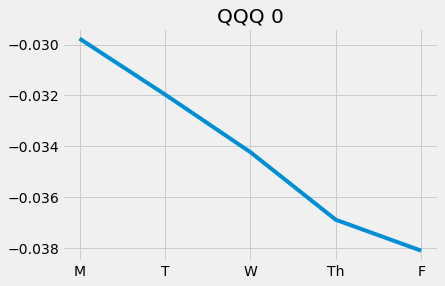

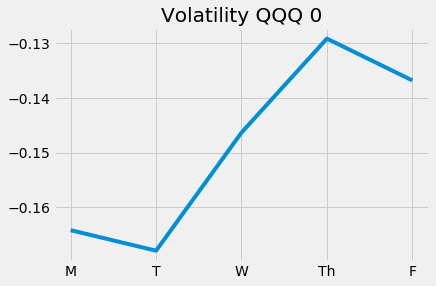

Epoch 2/5000
628/628 [==============================] - 1s 2ms/step - loss: 3.2889 - val_loss: 3.2219


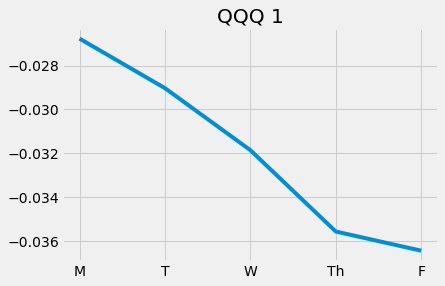

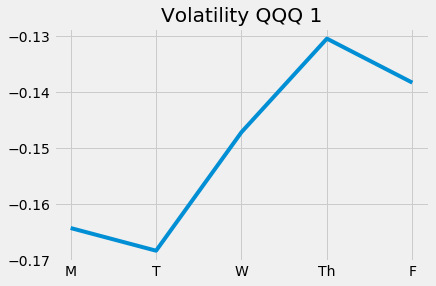

Epoch 3/5000
628/628 [==============================] - 1s 2ms/step - loss: 3.2346 - val_loss: 3.1926


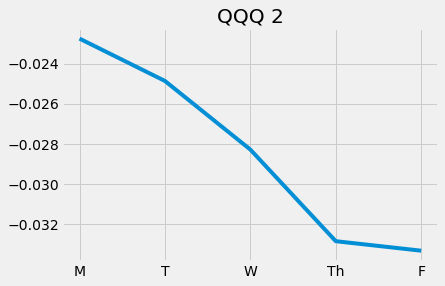

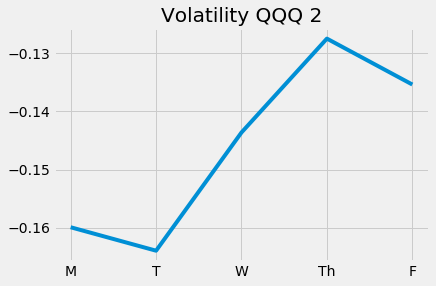

Epoch 4/5000
628/628 [==============================] - 1s 2ms/step - loss: 3.1890 - val_loss: 3.1586


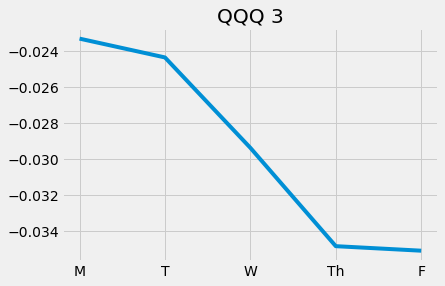

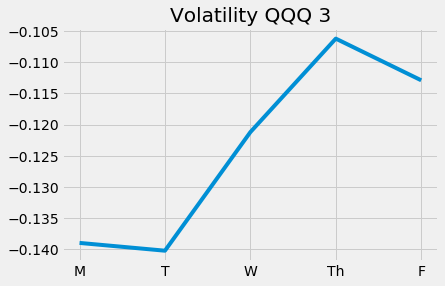

Epoch 5/5000
628/628 [==============================] - 1s 2ms/step - loss: 3.1373 - val_loss: 3.1359


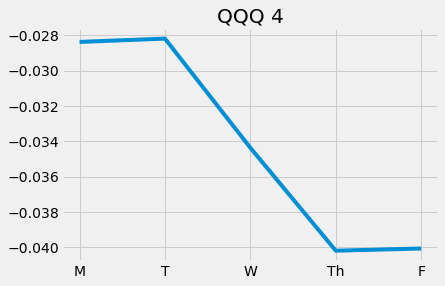

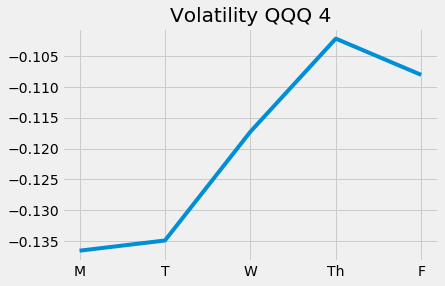

Epoch 6/5000
628/628 [==============================] - 1s 2ms/step - loss: 3.0920 - val_loss: 3.1027


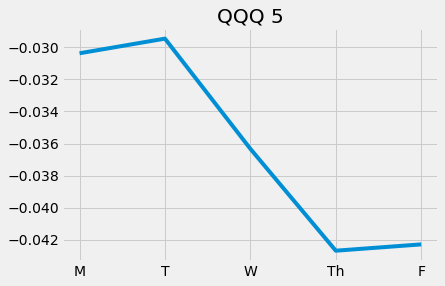

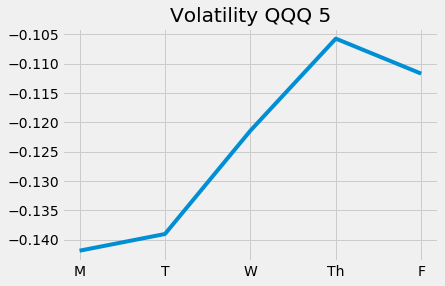

Epoch 7/5000
628/628 [==============================] - 1s 2ms/step - loss: 3.0468 - val_loss: 3.0712


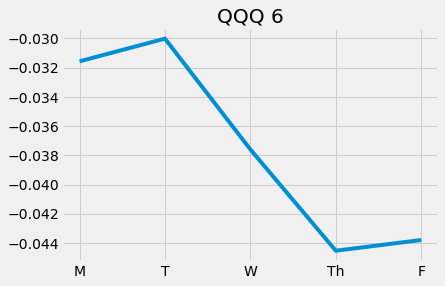

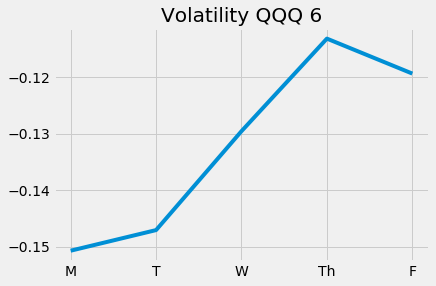

Epoch 8/5000
628/628 [==============================] - 1s 2ms/step - loss: 3.0021 - val_loss: 3.0476


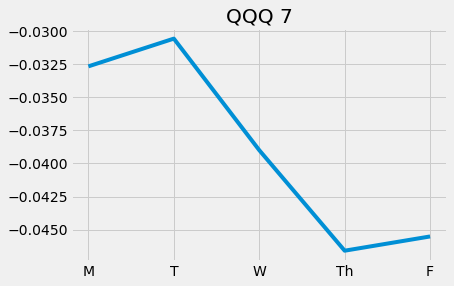

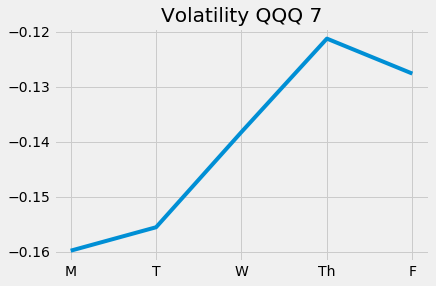

Epoch 9/5000
628/628 [==============================] - 1s 2ms/step - loss: 2.9560 - val_loss: 3.0202


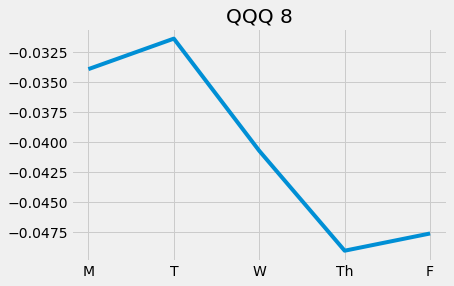

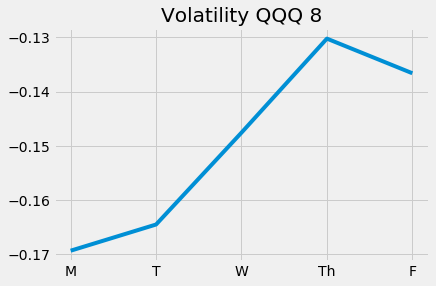

Epoch 10/5000
628/628 [==============================] - 2s 3ms/step - loss: 2.9308 - val_loss: 2.9703


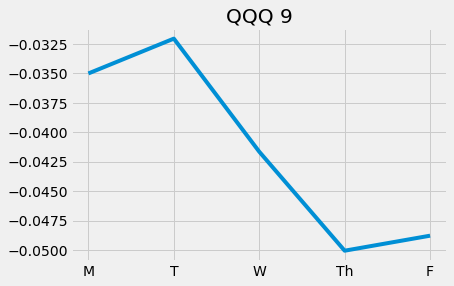

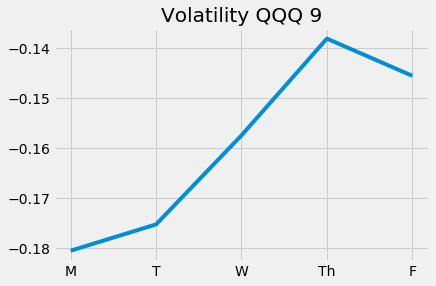

Epoch 11/5000
628/628 [==============================] - 1s 2ms/step - loss: 2.8709 - val_loss: 2.8992


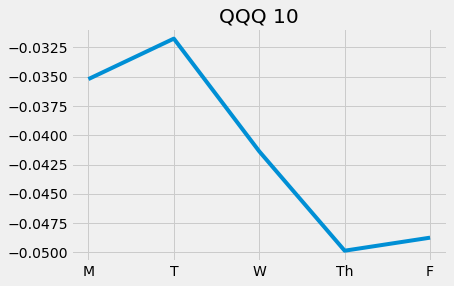

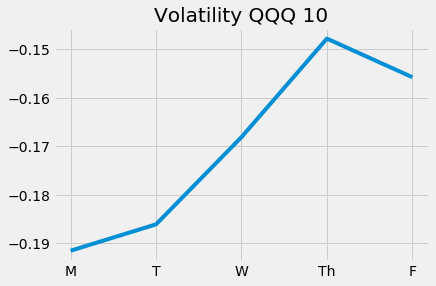

Epoch 12/5000
628/628 [==============================] - 1s 2ms/step - loss: 2.8319 - val_loss: 2.8630


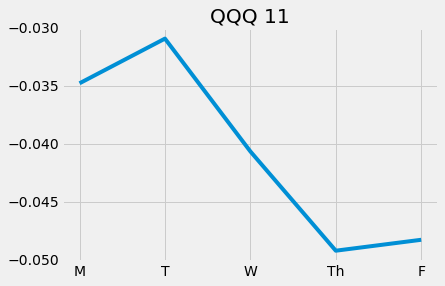

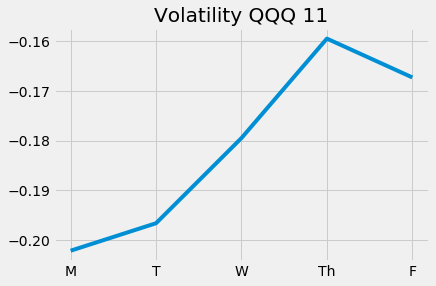

Epoch 13/5000
628/628 [==============================] - 1s 2ms/step - loss: 2.7911 - val_loss: 2.8482


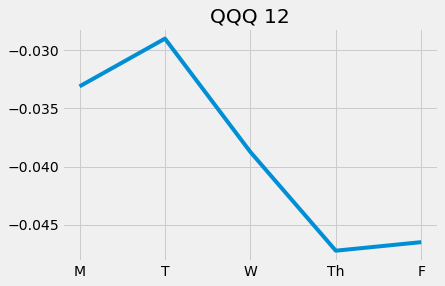

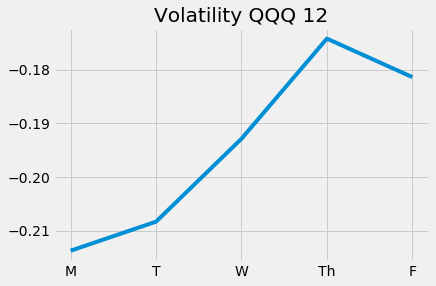

Epoch 14/5000
628/628 [==============================] - 1s 2ms/step - loss: 2.7530 - val_loss: 2.8007


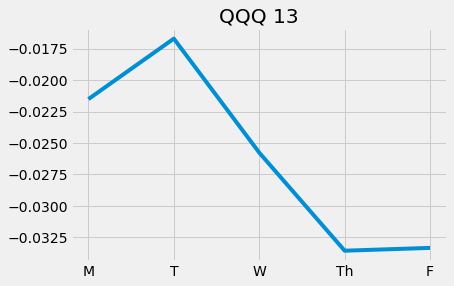

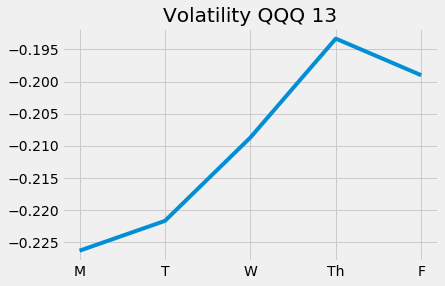

Epoch 15/5000
628/628 [==============================] - 1s 2ms/step - loss: 2.7338 - val_loss: 2.8374


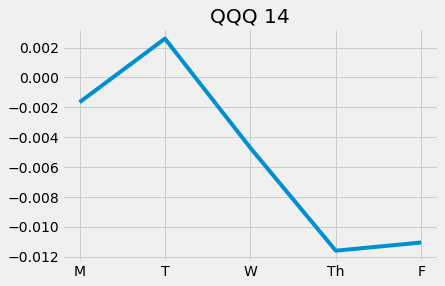

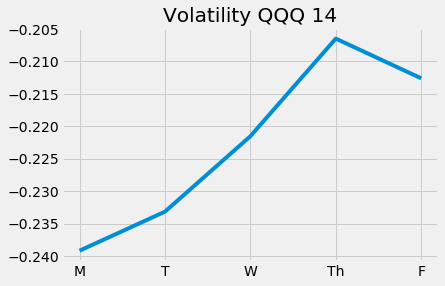

Epoch 16/5000
628/628 [==============================] - 1s 2ms/step - loss: 2.6888 - val_loss: 2.8190


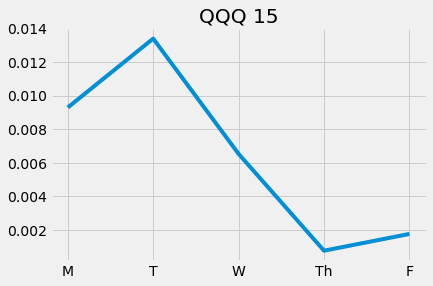

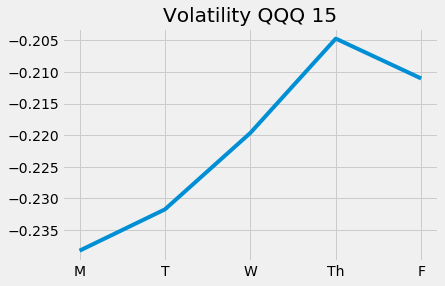

Epoch 17/5000
628/628 [==============================] - 1s 2ms/step - loss: 2.6654 - val_loss: 2.7565


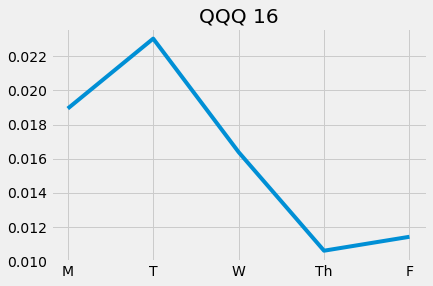

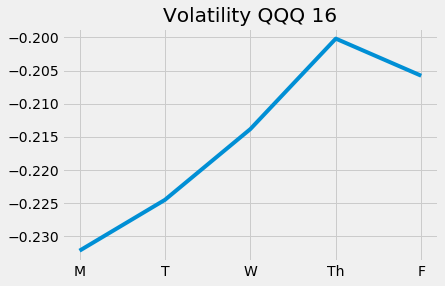

Epoch 18/5000
628/628 [==============================] - 1s 2ms/step - loss: 2.6260 - val_loss: 2.7099


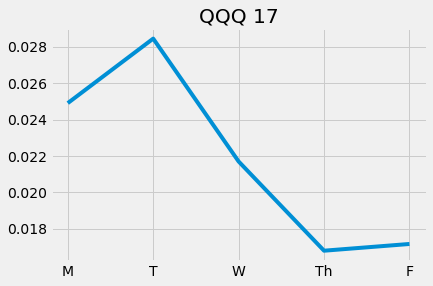

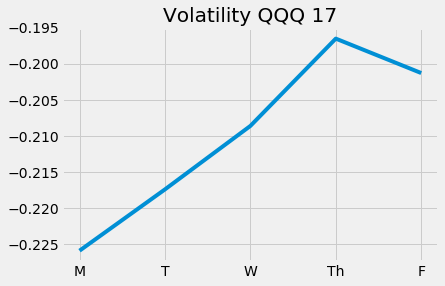

Epoch 19/5000
628/628 [==============================] - 1s 2ms/step - loss: 2.5911 - val_loss: 2.6416


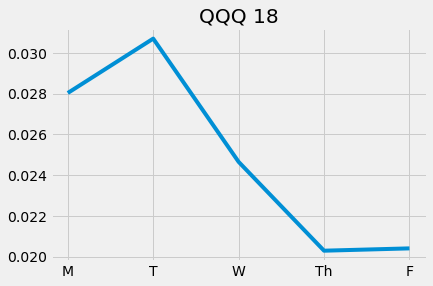

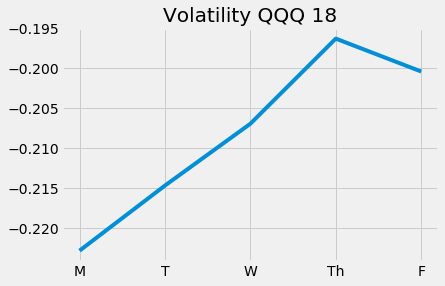

Epoch 20/5000
628/628 [==============================] - 1s 2ms/step - loss: 2.5667 - val_loss: 2.6096


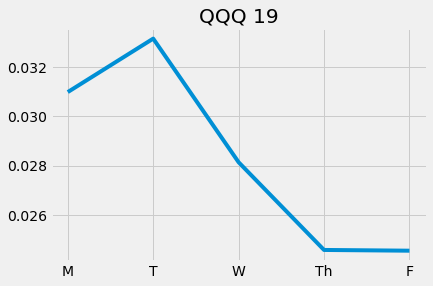

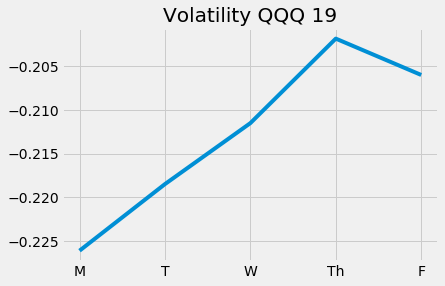

Epoch 21/5000
628/628 [==============================] - 1s 2ms/step - loss: 2.5333 - val_loss: 2.6236


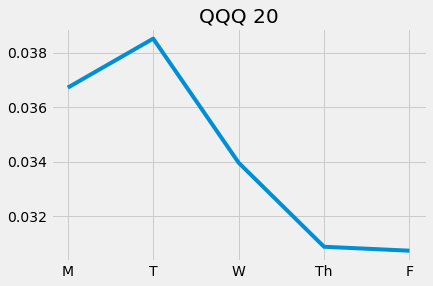

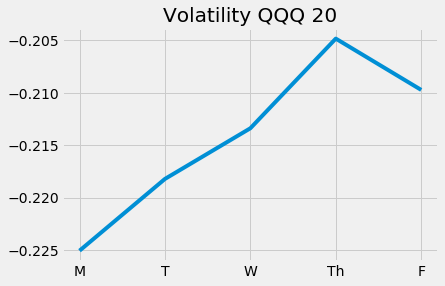

Epoch 22/5000
628/628 [==============================] - 1s 2ms/step - loss: 2.4948 - val_loss: 2.6195


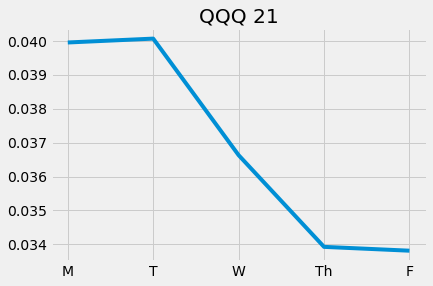

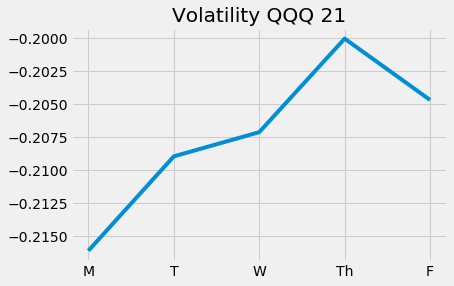

Epoch 23/5000
628/628 [==============================] - 1s 2ms/step - loss: 2.4603 - val_loss: 2.5959


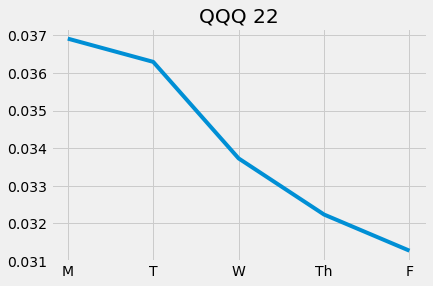

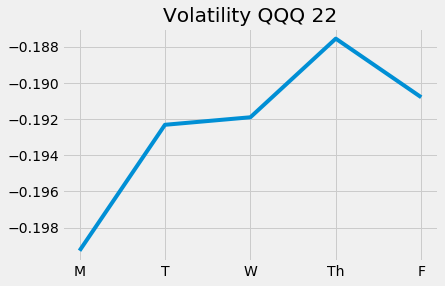

Epoch 24/5000
628/628 [==============================] - 1s 2ms/step - loss: 2.4625 - val_loss: 2.6169


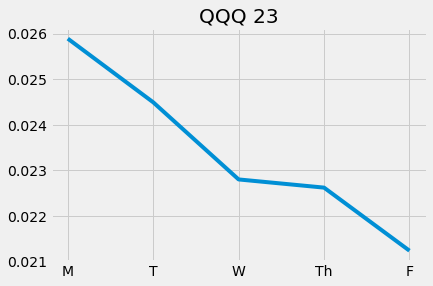

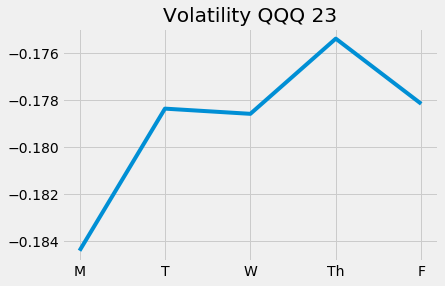

Epoch 25/5000
628/628 [==============================] - 1s 2ms/step - loss: 2.3981 - val_loss: 2.5787


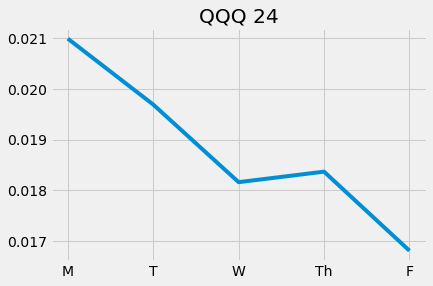

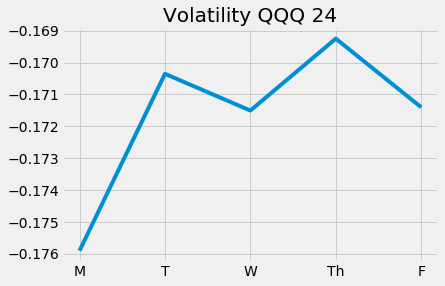

Epoch 26/5000
628/628 [==============================] - 1s 2ms/step - loss: 2.3668 - val_loss: 2.5107


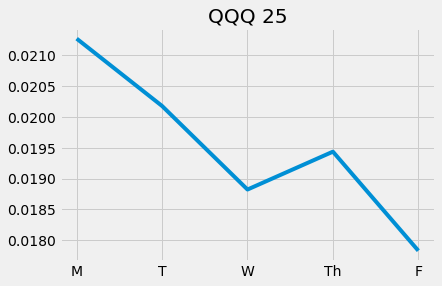

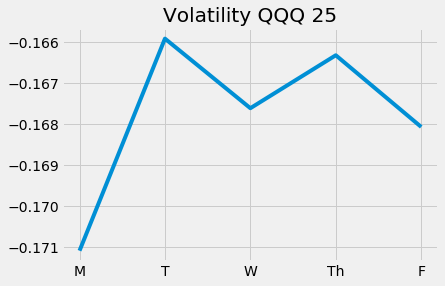

Epoch 27/5000
628/628 [==============================] - 1s 2ms/step - loss: 2.3358 - val_loss: 2.4813


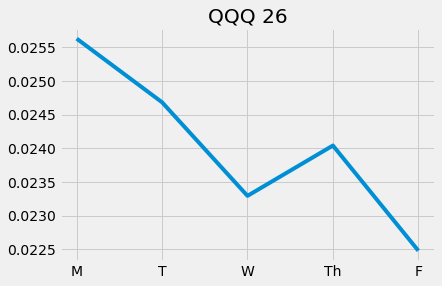

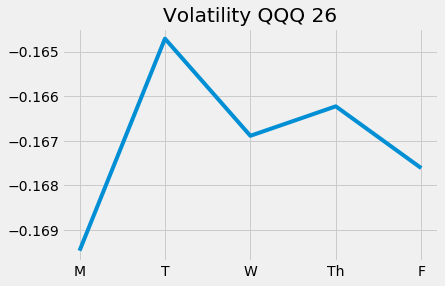

Epoch 28/5000
628/628 [==============================] - 1s 2ms/step - loss: 2.3095 - val_loss: 2.4575


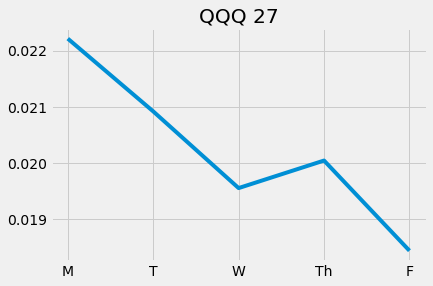

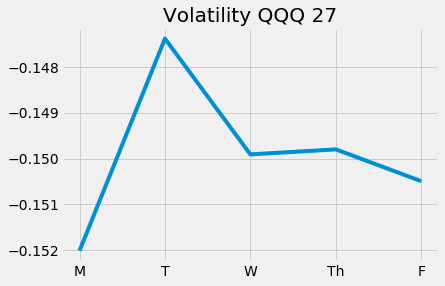

Epoch 29/5000
628/628 [==============================] - 1s 2ms/step - loss: 2.2880 - val_loss: 2.4686


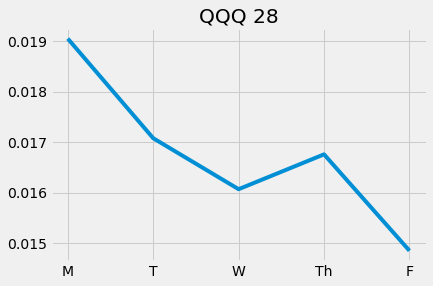

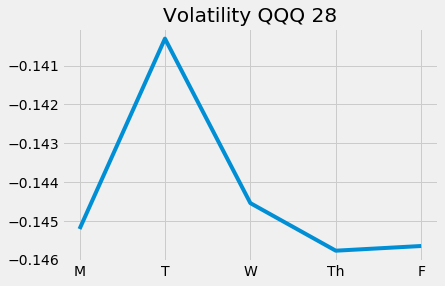

Epoch 30/5000
628/628 [==============================] - 1s 2ms/step - loss: 2.2552 - val_loss: 2.5232


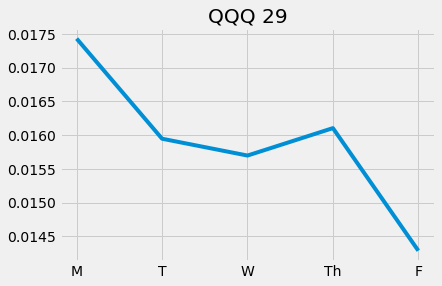

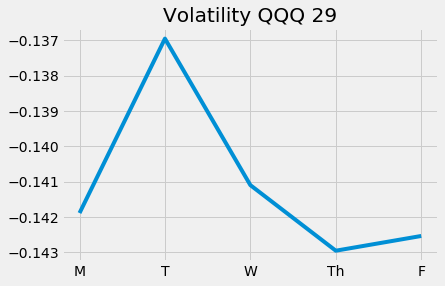

Epoch 31/5000
628/628 [==============================] - 1s 2ms/step - loss: 2.3175 - val_loss: 2.4261


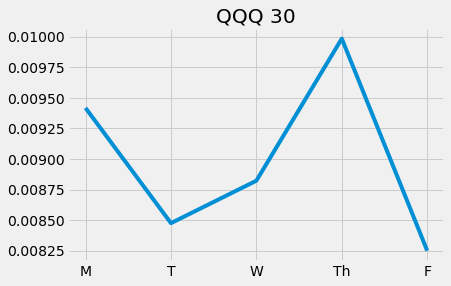

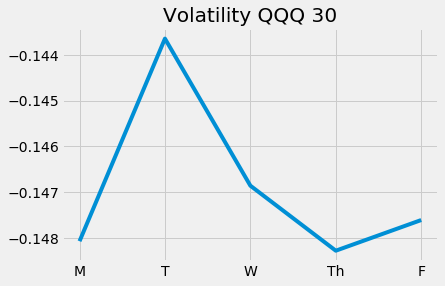

Epoch 32/5000
628/628 [==============================] - 1s 2ms/step - loss: 2.2367 - val_loss: 2.3322


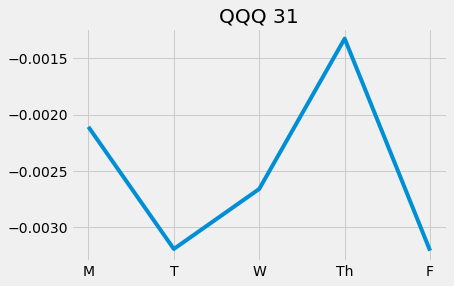

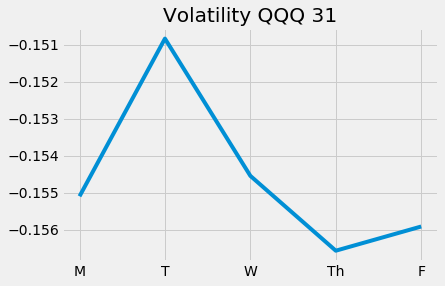

Epoch 33/5000
628/628 [==============================] - 1s 2ms/step - loss: 2.2359 - val_loss: 2.2868


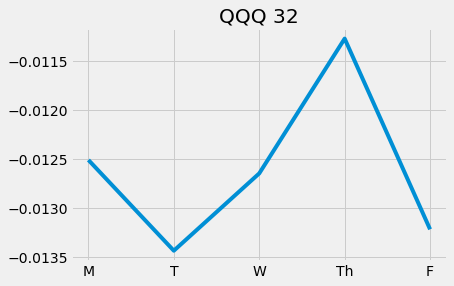

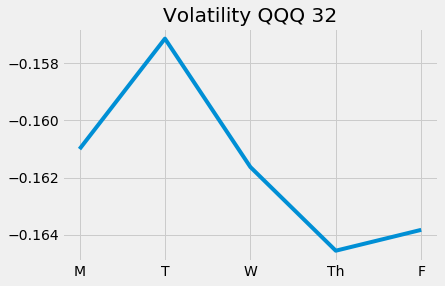

Epoch 34/5000
628/628 [==============================] - 1s 2ms/step - loss: 2.2155 - val_loss: 2.2215


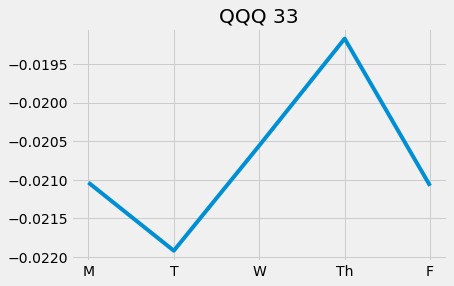

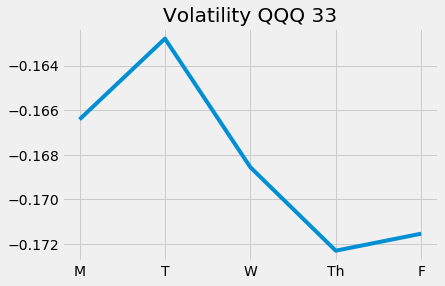

Epoch 35/5000
628/628 [==============================] - 1s 2ms/step - loss: 2.1765 - val_loss: 2.1250


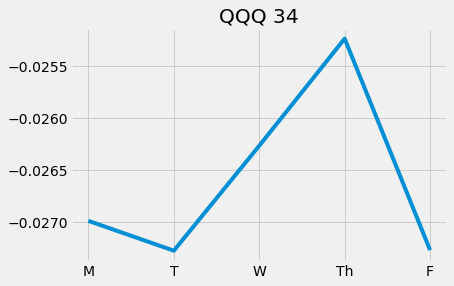

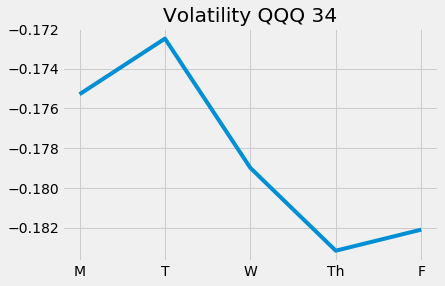

Epoch 36/5000
628/628 [==============================] - 1s 2ms/step - loss: 2.1390 - val_loss: 2.1555


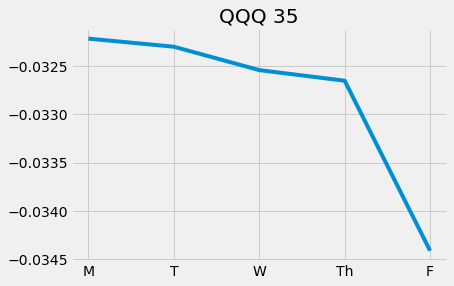

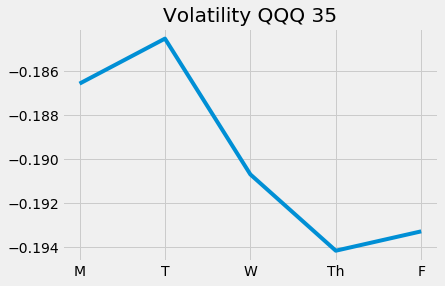

Epoch 37/5000
628/628 [==============================] - 1s 2ms/step - loss: 2.1003 - val_loss: 2.1981


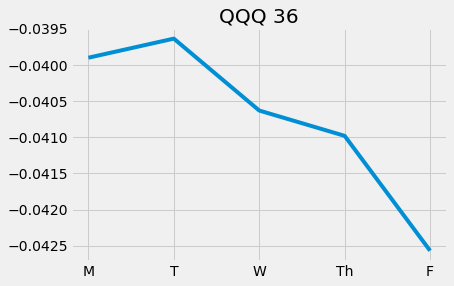

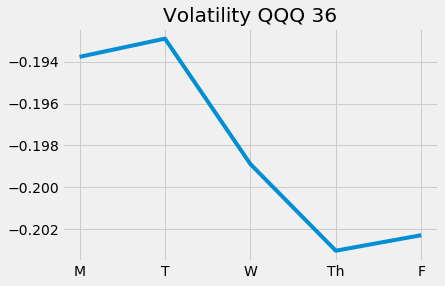

Epoch 38/5000
628/628 [==============================] - 2s 3ms/step - loss: 2.0918 - val_loss: 2.1767


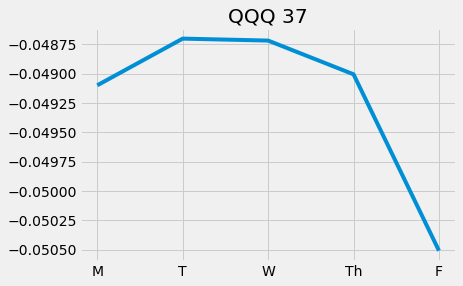

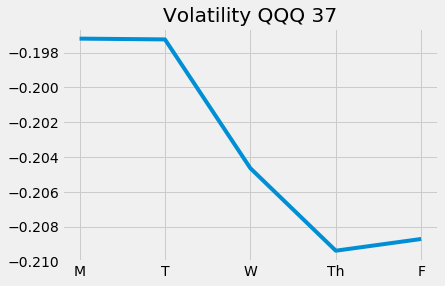

Epoch 39/5000
628/628 [==============================] - 1s 2ms/step - loss: 2.0629 - val_loss: 2.1558


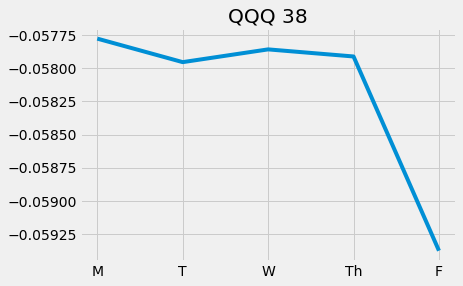

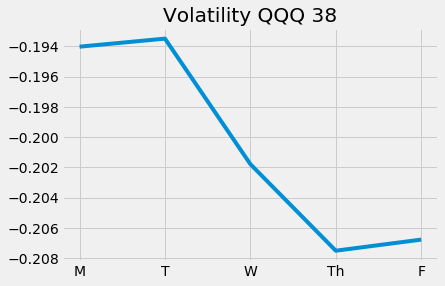

Epoch 40/5000
628/628 [==============================] - 1s 2ms/step - loss: 2.0288 - val_loss: 2.2301


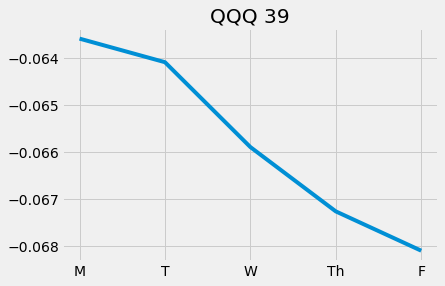

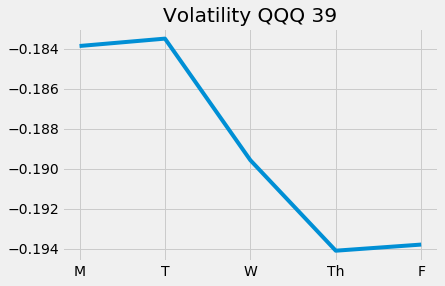

Epoch 41/5000
628/628 [==============================] - 1s 2ms/step - loss: 2.0047 - val_loss: 2.1927


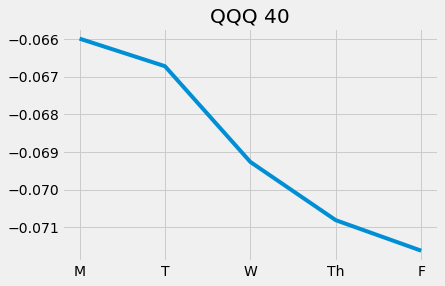

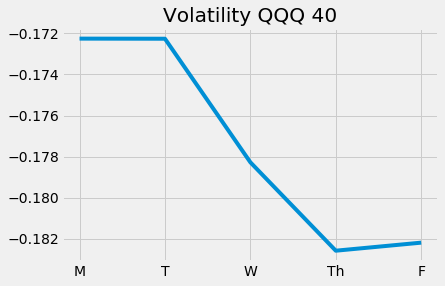

Epoch 42/5000
628/628 [==============================] - 1s 2ms/step - loss: 1.9808 - val_loss: 2.0479


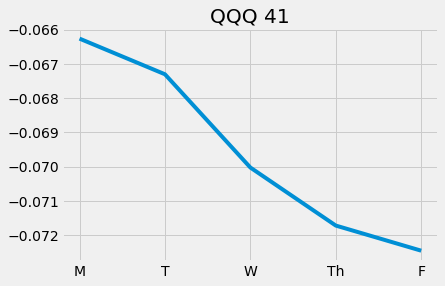

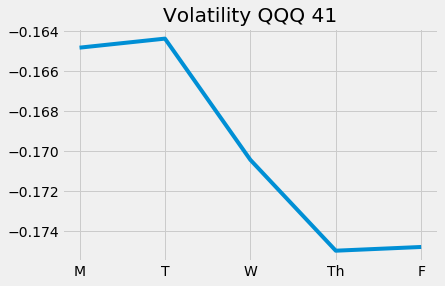

Epoch 43/5000
628/628 [==============================] - 1s 2ms/step - loss: 1.9633 - val_loss: 2.1133


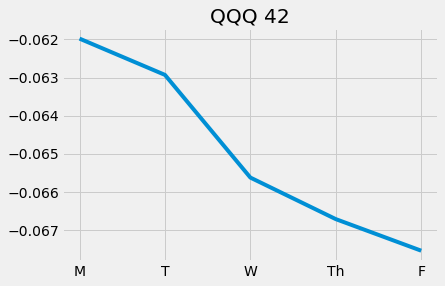

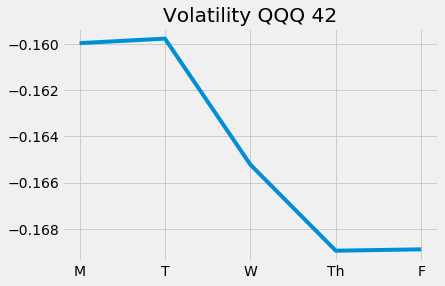

Epoch 44/5000
628/628 [==============================] - 1s 2ms/step - loss: 1.9465 - val_loss: 2.1108


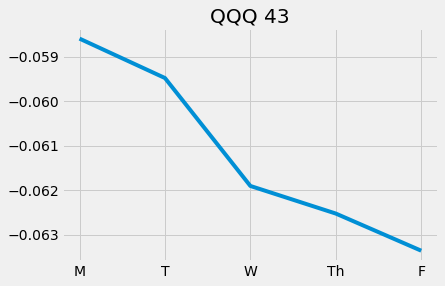

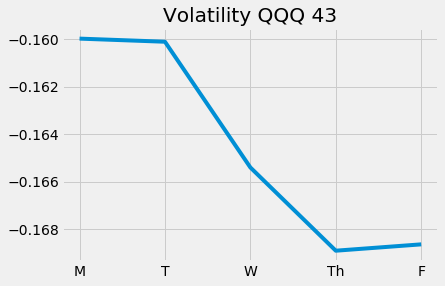

Epoch 45/5000
628/628 [==============================] - 1s 2ms/step - loss: 1.9257 - val_loss: 2.1267


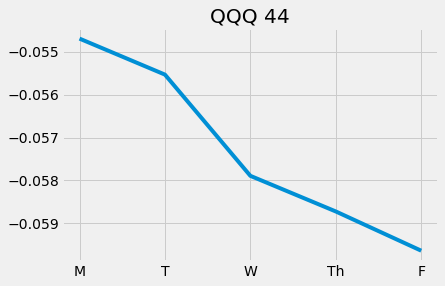

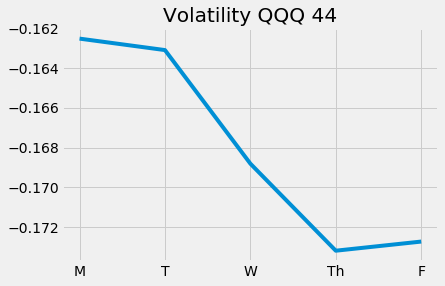

Epoch 46/5000
628/628 [==============================] - 1s 2ms/step - loss: 1.8872 - val_loss: 2.1759


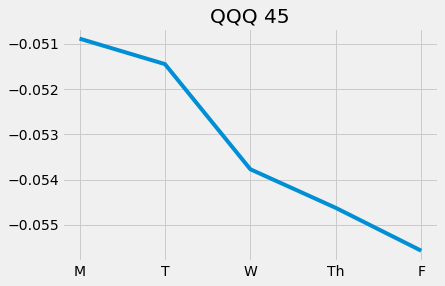

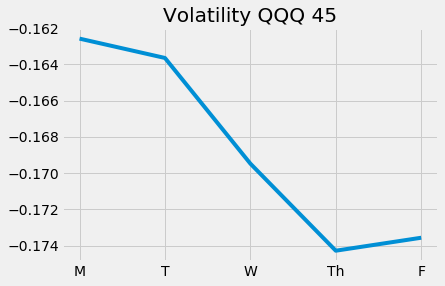

Epoch 47/5000
628/628 [==============================] - 1s 2ms/step - loss: 1.9016 - val_loss: 2.0428


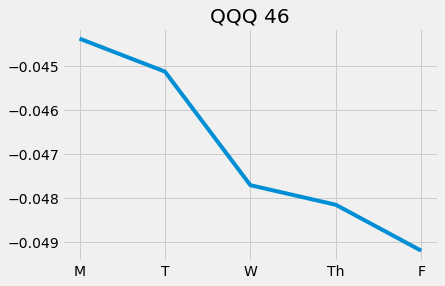

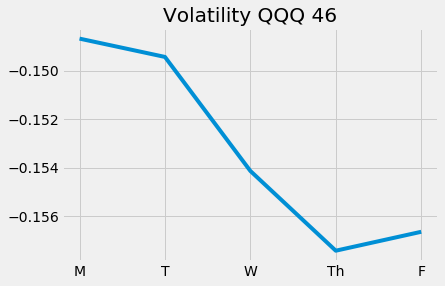

Epoch 48/5000
628/628 [==============================] - 1s 2ms/step - loss: 1.8529 - val_loss: 2.0123


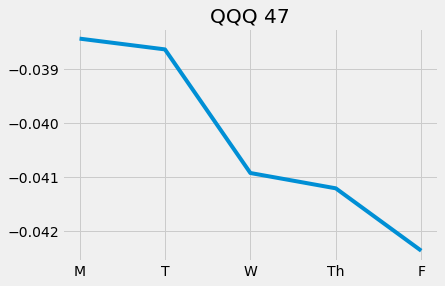

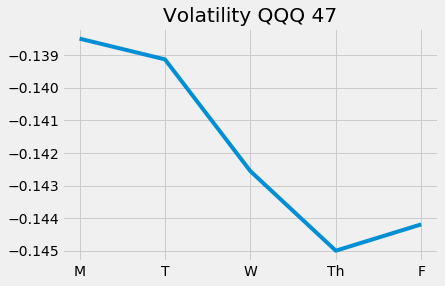

Epoch 49/5000
628/628 [==============================] - 1s 2ms/step - loss: 1.8450 - val_loss: 1.9949


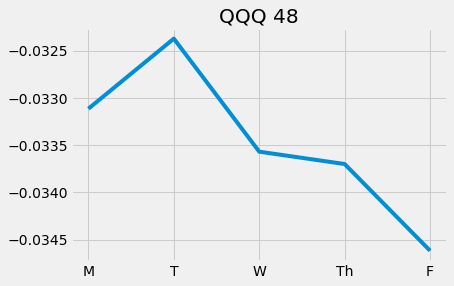

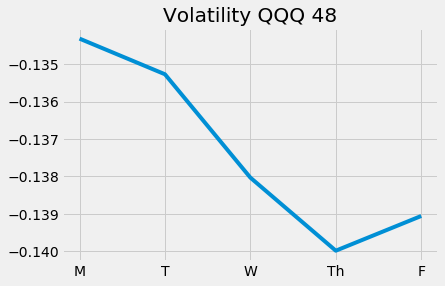

Epoch 50/5000
628/628 [==============================] - 1s 2ms/step - loss: 1.8217 - val_loss: 1.9886


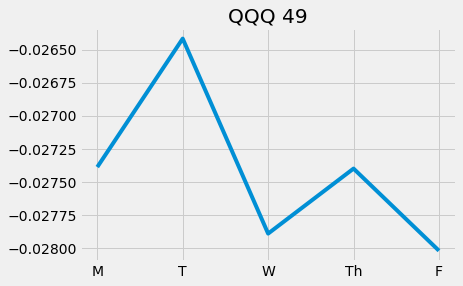

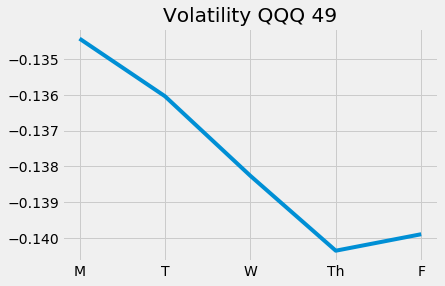

Epoch 51/5000
628/628 [==============================] - 1s 2ms/step - loss: 1.7884 - val_loss: 2.0501


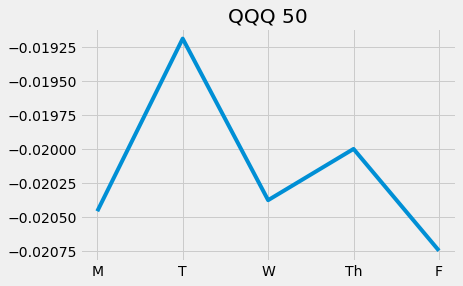

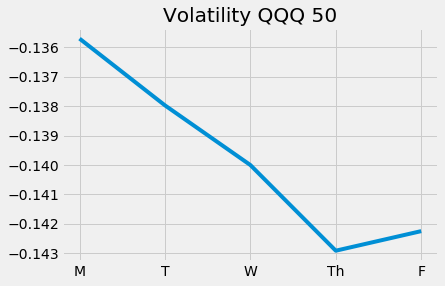

Epoch 52/5000
628/628 [==============================] - 1s 2ms/step - loss: 1.7487 - val_loss: 2.4535


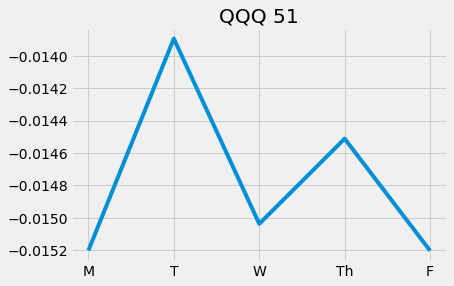

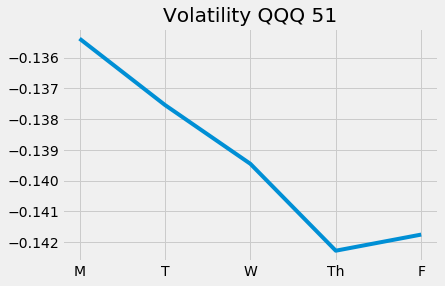

Epoch 53/5000
628/628 [==============================] - 1s 2ms/step - loss: 1.7579 - val_loss: 2.3341


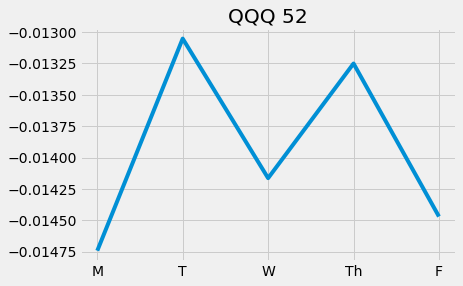

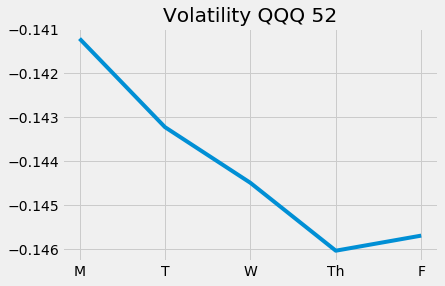

Epoch 54/5000
628/628 [==============================] - 1s 2ms/step - loss: 1.7426 - val_loss: 1.9629


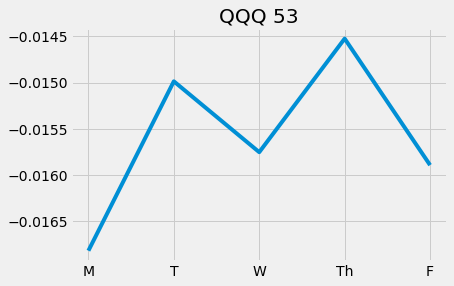

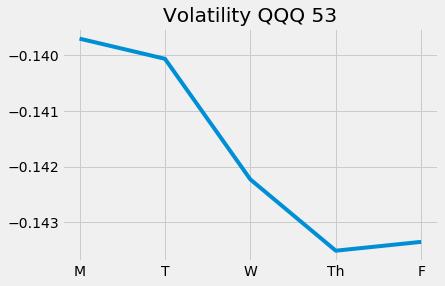

Epoch 55/5000
628/628 [==============================] - 1s 2ms/step - loss: 1.6875 - val_loss: 1.9512


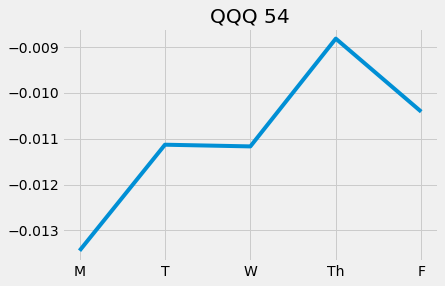

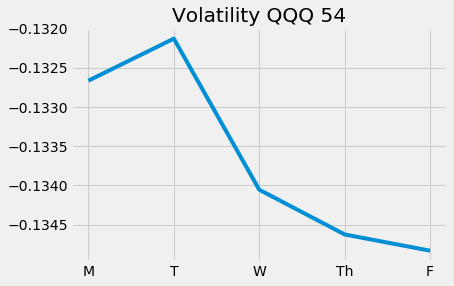

Epoch 56/5000
628/628 [==============================] - 1s 2ms/step - loss: 1.6705 - val_loss: 1.9694


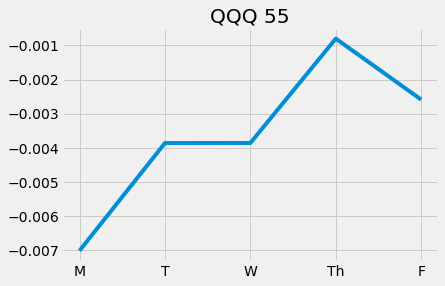

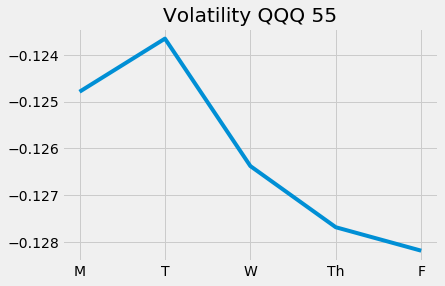

Epoch 57/5000
628/628 [==============================] - 1s 2ms/step - loss: 1.6705 - val_loss: 1.9702


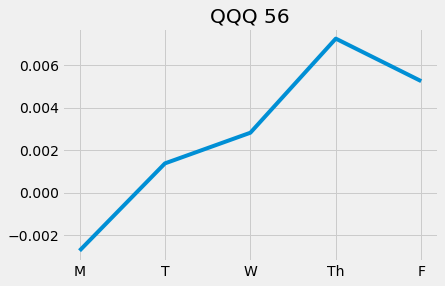

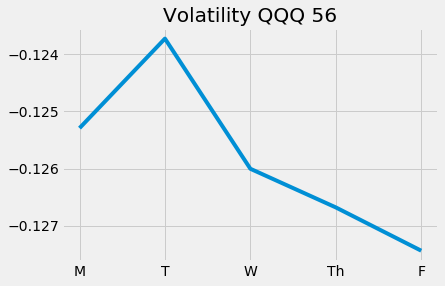

Epoch 58/5000
628/628 [==============================] - 1s 2ms/step - loss: 1.6501 - val_loss: 2.1225


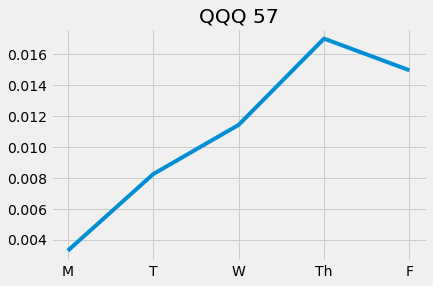

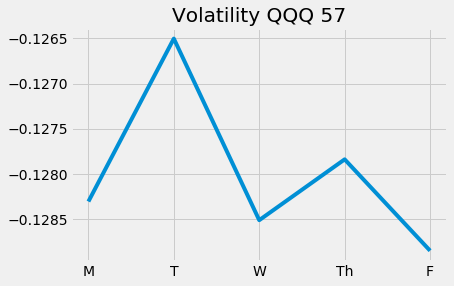

Epoch 59/5000
628/628 [==============================] - 1s 2ms/step - loss: 1.6394 - val_loss: 1.9761


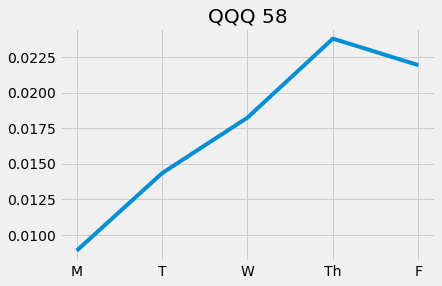

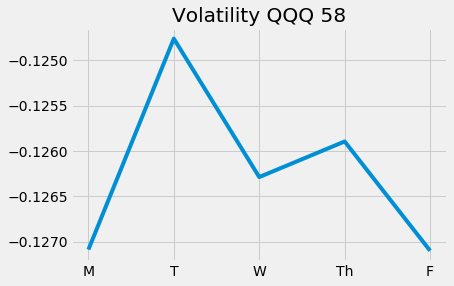

Epoch 60/5000
628/628 [==============================] - 1s 2ms/step - loss: 1.6028 - val_loss: 1.9445


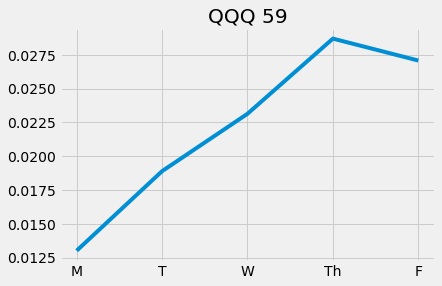

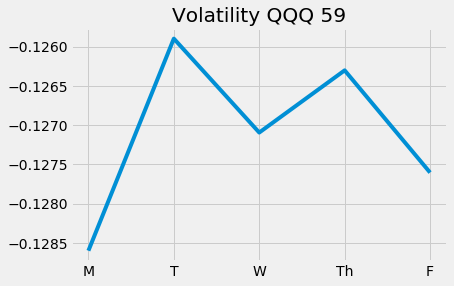

Epoch 61/5000
628/628 [==============================] - 1s 2ms/step - loss: 1.5954 - val_loss: 2.0464


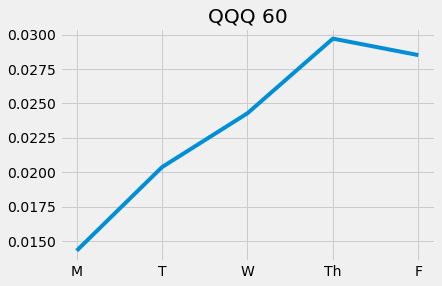

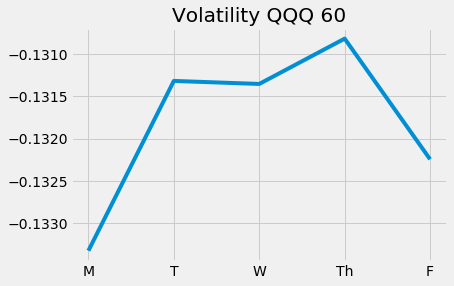

Epoch 62/5000
628/628 [==============================] - 1s 2ms/step - loss: 1.5677 - val_loss: 2.0851


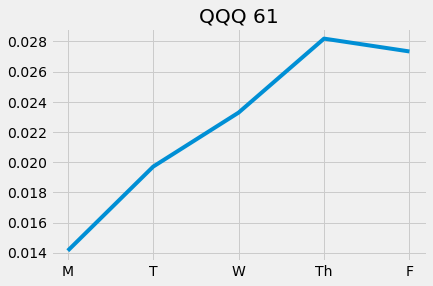

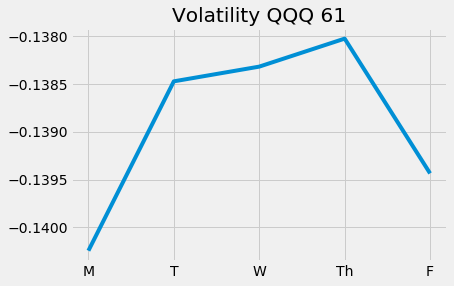

Epoch 63/5000
628/628 [==============================] - 1s 2ms/step - loss: 1.5440 - val_loss: 2.2288


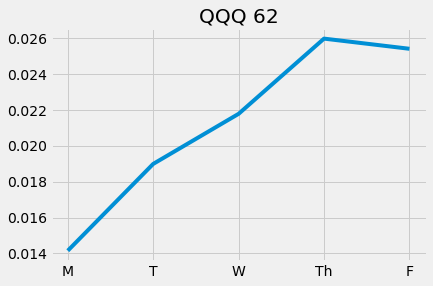

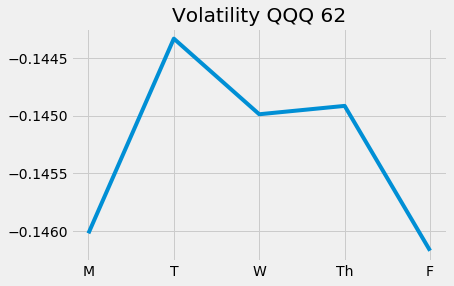

Epoch 64/5000
628/628 [==============================] - 1s 2ms/step - loss: 1.5294 - val_loss: 2.0225


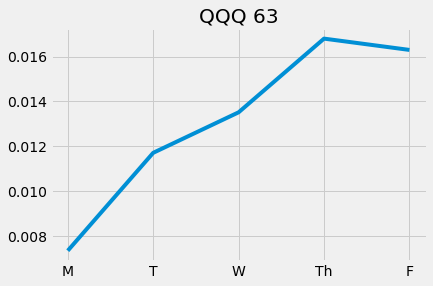

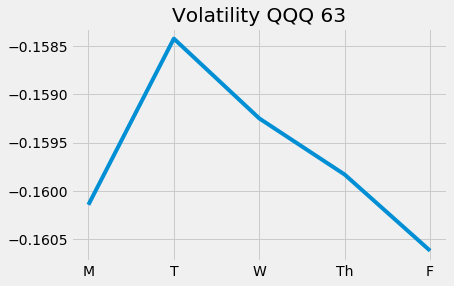

Epoch 65/5000
628/628 [==============================] - 1s 2ms/step - loss: 1.4978 - val_loss: 1.8976


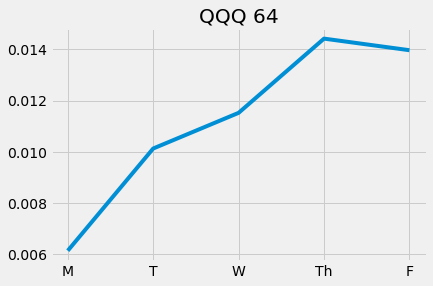

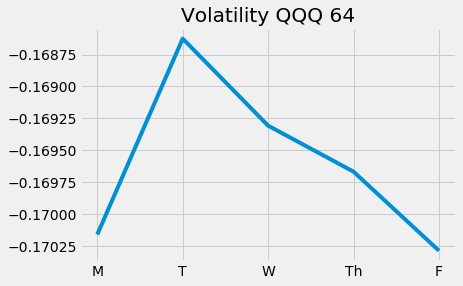

Epoch 66/5000
628/628 [==============================] - 1s 2ms/step - loss: 1.4893 - val_loss: 1.7975


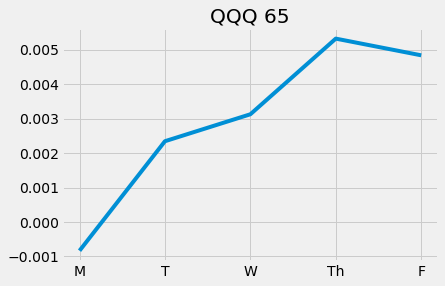

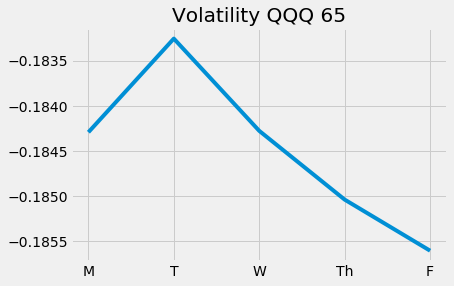

Epoch 67/5000
628/628 [==============================] - 1s 2ms/step - loss: 1.4680 - val_loss: 1.9606


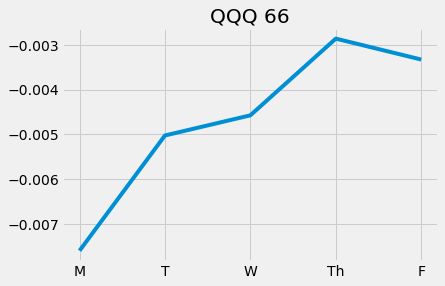

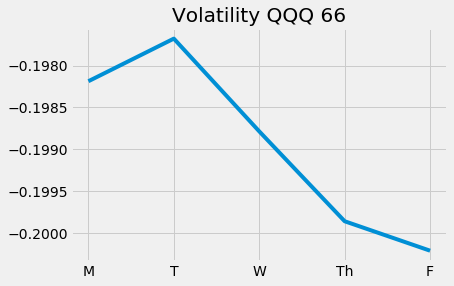

Epoch 68/5000
628/628 [==============================] - 1s 2ms/step - loss: 1.4522 - val_loss: 1.7468


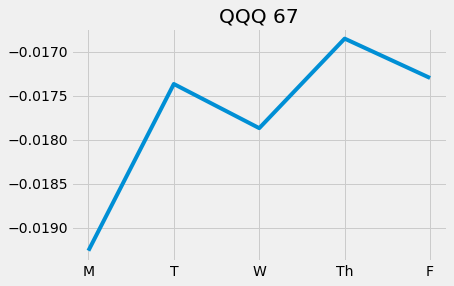

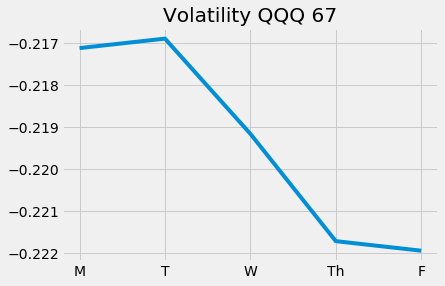

Epoch 69/5000
628/628 [==============================] - 1s 2ms/step - loss: 1.4715 - val_loss: 1.8059


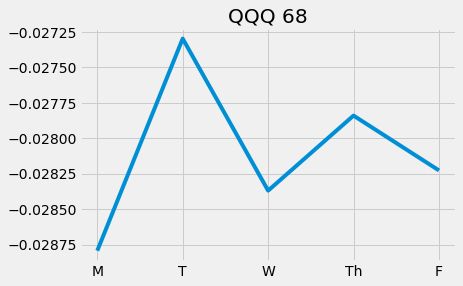

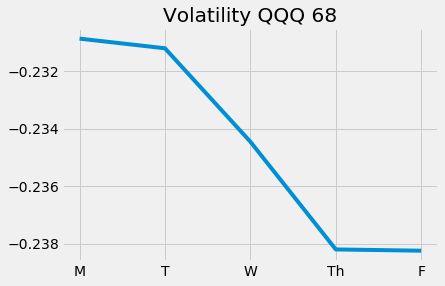

Epoch 70/5000
628/628 [==============================] - 1s 2ms/step - loss: 1.4387 - val_loss: 2.2614


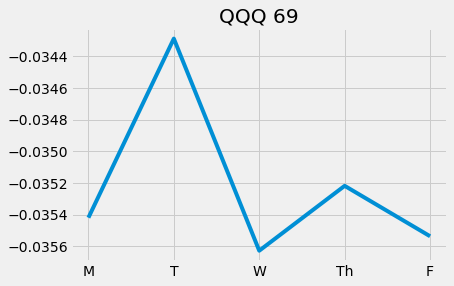

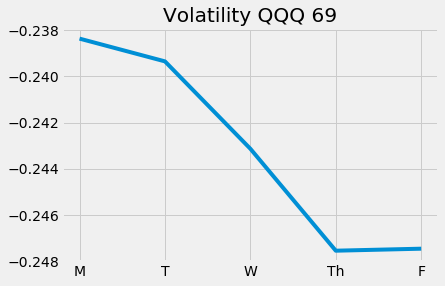

Epoch 71/5000
628/628 [==============================] - 1s 2ms/step - loss: 1.4795 - val_loss: 1.8722


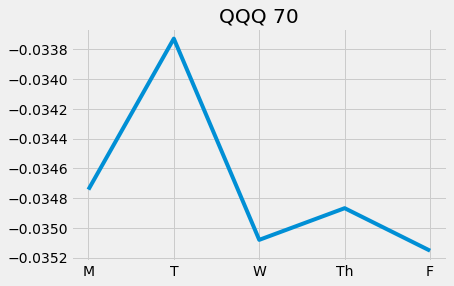

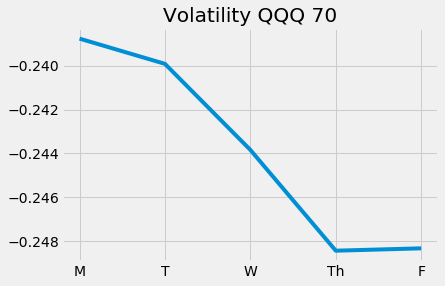

Epoch 72/5000
628/628 [==============================] - 1s 2ms/step - loss: 1.4262 - val_loss: 2.0824


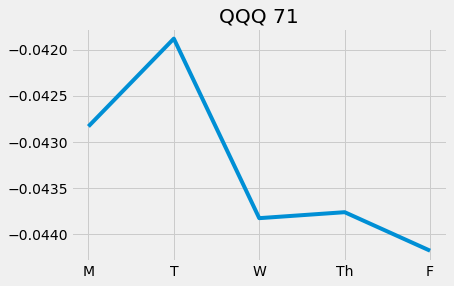

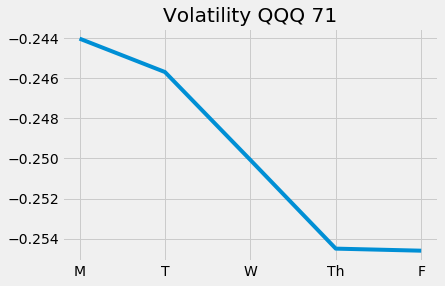

Epoch 73/5000
628/628 [==============================] - 1s 2ms/step - loss: 1.4377 - val_loss: 2.2188


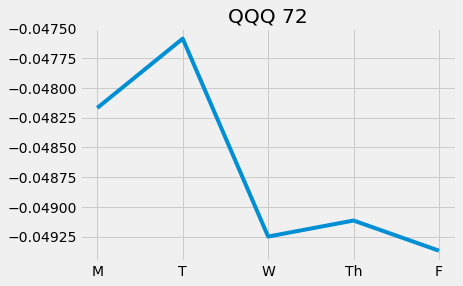

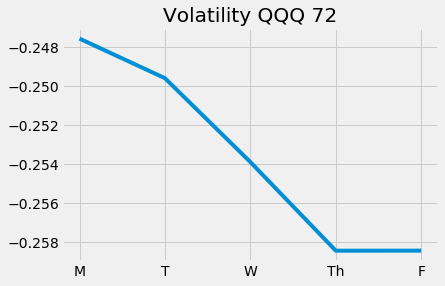

Epoch 74/5000
628/628 [==============================] - 1s 2ms/step - loss: 1.4204 - val_loss: 2.2425


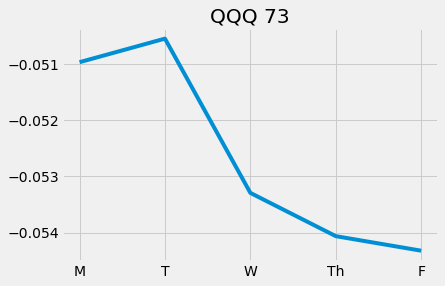

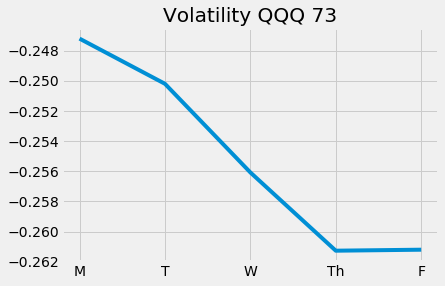

Epoch 75/5000
628/628 [==============================] - 1s 2ms/step - loss: 1.3843 - val_loss: 2.3013


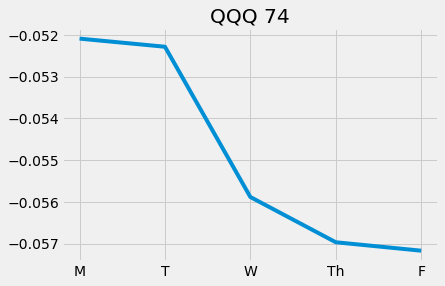

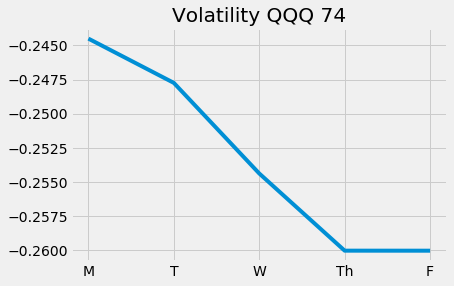

Epoch 76/5000
628/628 [==============================] - 1s 2ms/step - loss: 1.3620 - val_loss: 2.3755


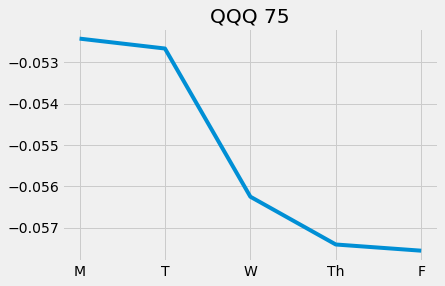

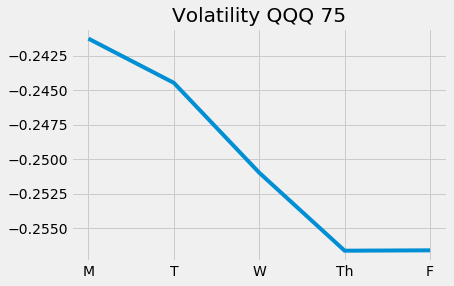

Epoch 77/5000
628/628 [==============================] - 1s 2ms/step - loss: 1.3476 - val_loss: 2.3057


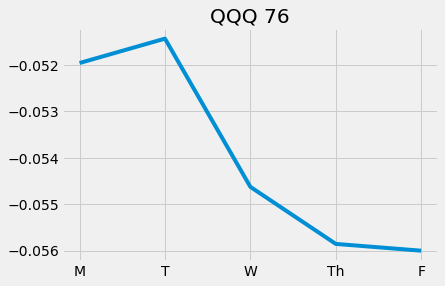

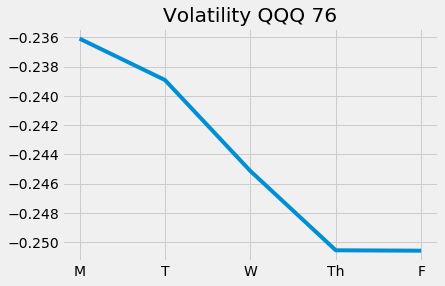

Epoch 78/5000
628/628 [==============================] - 1s 2ms/step - loss: 1.3321 - val_loss: 2.1519


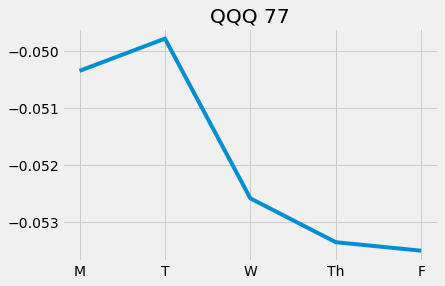

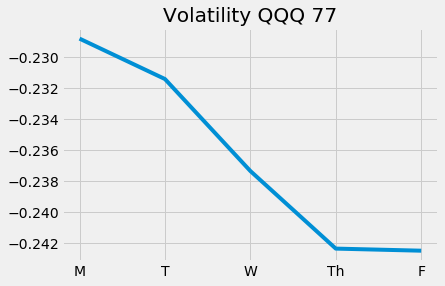

Epoch 79/5000
628/628 [==============================] - 1s 2ms/step - loss: 1.3226 - val_loss: 2.0605


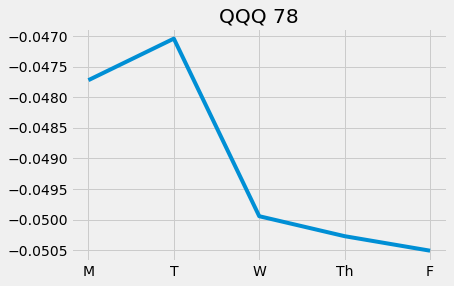

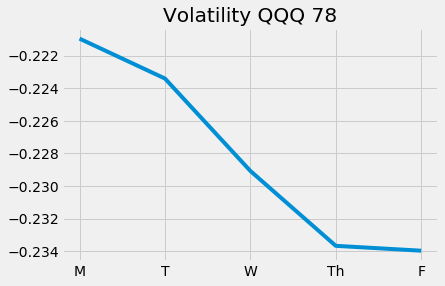

Epoch 80/5000
628/628 [==============================] - 1s 2ms/step - loss: 1.3142 - val_loss: 1.9690


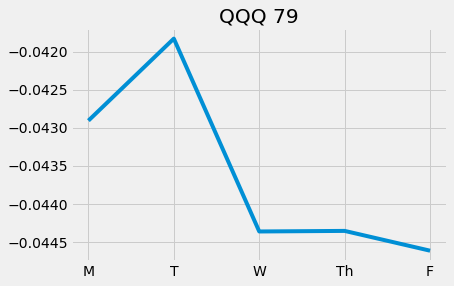

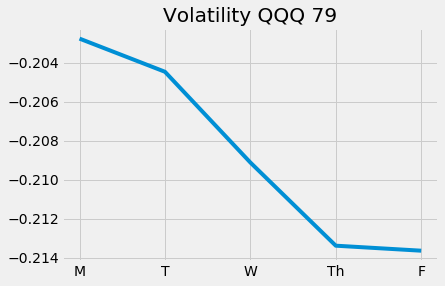

Epoch 81/5000
628/628 [==============================] - 1s 2ms/step - loss: 1.2923 - val_loss: 1.9247


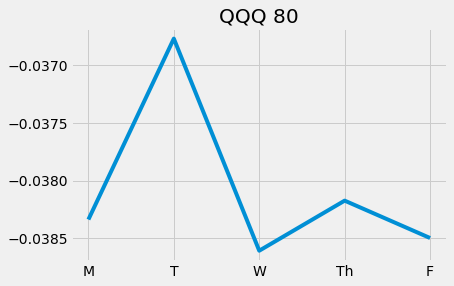

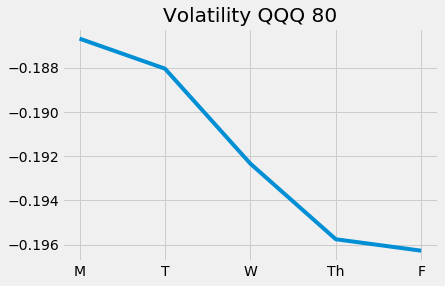

Epoch 82/5000
628/628 [==============================] - 1s 2ms/step - loss: 1.2791 - val_loss: 1.8836


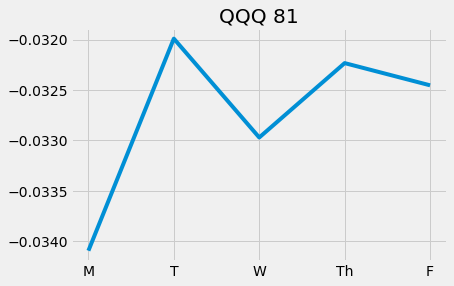

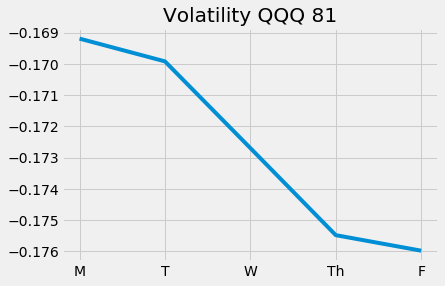

Epoch 83/5000
628/628 [==============================] - 1s 2ms/step - loss: 1.2735 - val_loss: 1.9674

Epoch 00083: ReduceLROnPlateau reducing learning rate to 0.0005000000237487257.


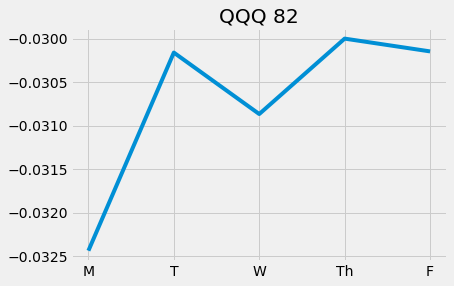

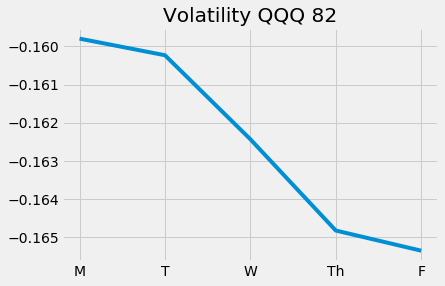

Epoch 84/5000
628/628 [==============================] - 1s 2ms/step - loss: 1.2442 - val_loss: 1.9467


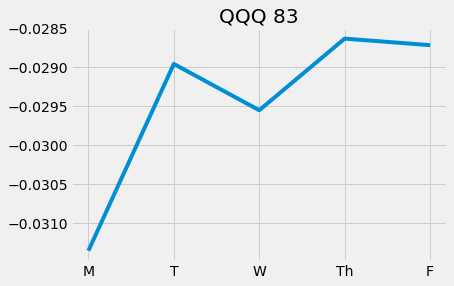

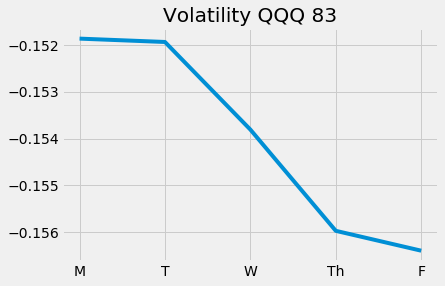

Epoch 85/5000
628/628 [==============================] - 1s 2ms/step - loss: 1.2384 - val_loss: 1.9503


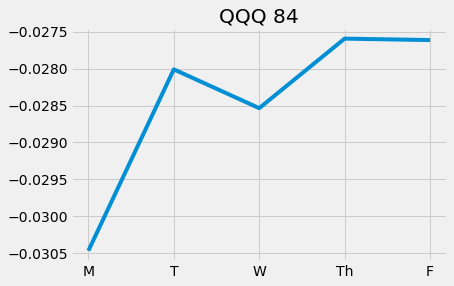

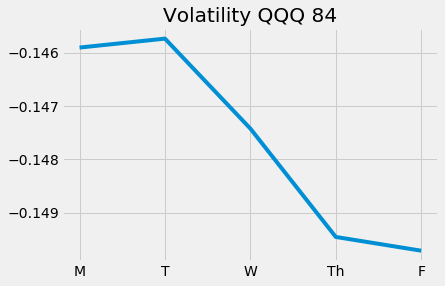

Epoch 86/5000
628/628 [==============================] - 1s 2ms/step - loss: 1.2428 - val_loss: 1.9829


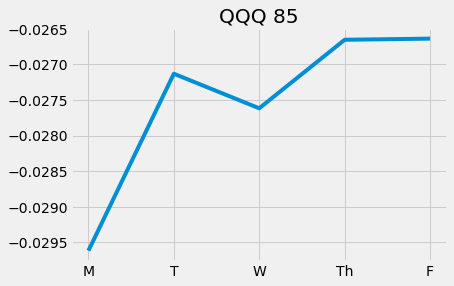

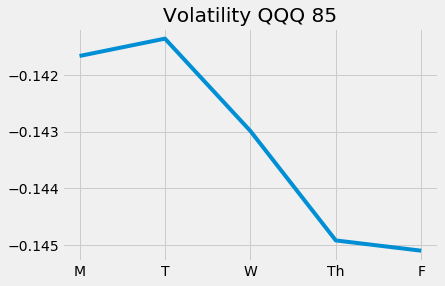

Epoch 87/5000
628/628 [==============================] - 1s 2ms/step - loss: 1.2299 - val_loss: 2.0109


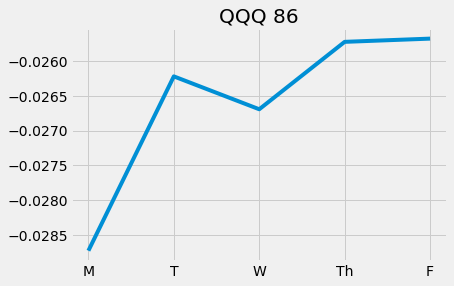

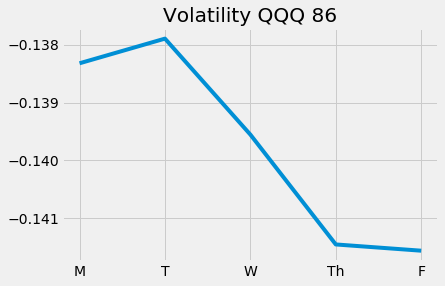

Epoch 88/5000
628/628 [==============================] - 1s 2ms/step - loss: 1.2270 - val_loss: 1.8696


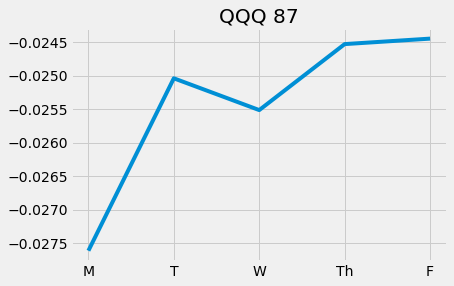

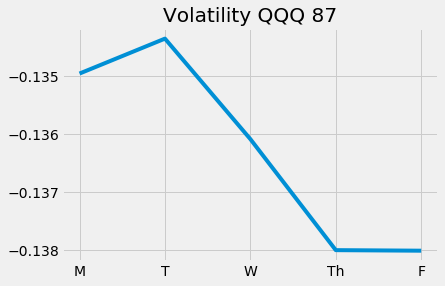

Epoch 89/5000
628/628 [==============================] - 1s 2ms/step - loss: 1.2144 - val_loss: 1.7620


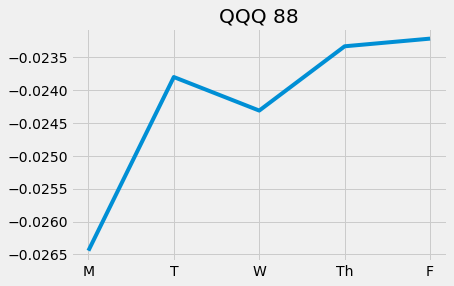

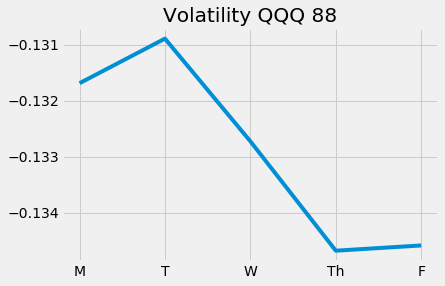

Epoch 90/5000
628/628 [==============================] - 1s 2ms/step - loss: 1.2137 - val_loss: 1.7123


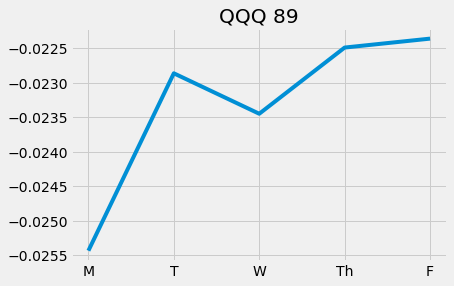

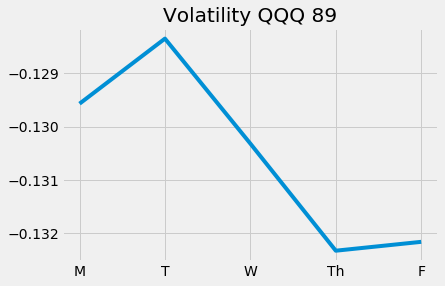

Epoch 91/5000
628/628 [==============================] - 1s 2ms/step - loss: 1.2074 - val_loss: 1.7160


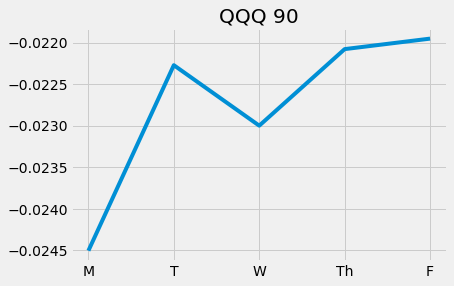

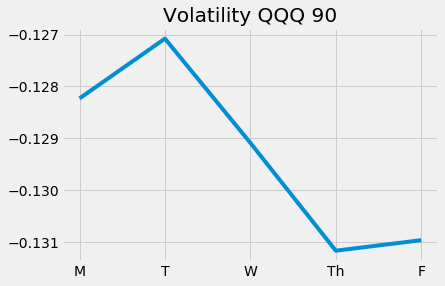

Epoch 92/5000
628/628 [==============================] - 1s 2ms/step - loss: 1.2027 - val_loss: 1.7249


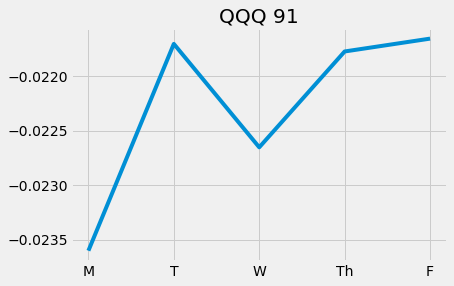

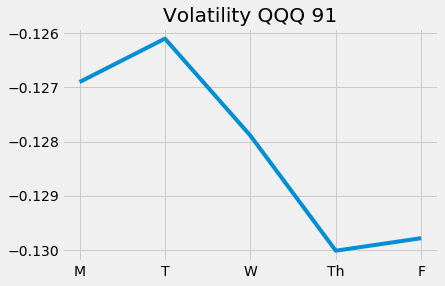

Epoch 93/5000
628/628 [==============================] - 1s 2ms/step - loss: 1.2008 - val_loss: 1.6743


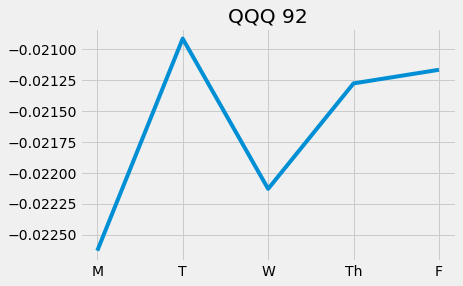

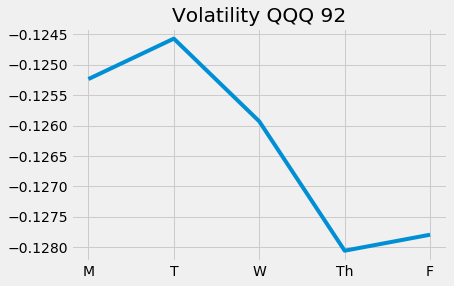

Epoch 94/5000
628/628 [==============================] - 1s 2ms/step - loss: 1.1945 - val_loss: 1.6411


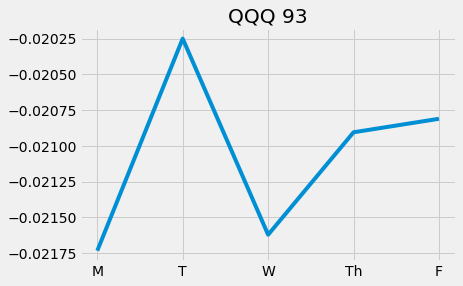

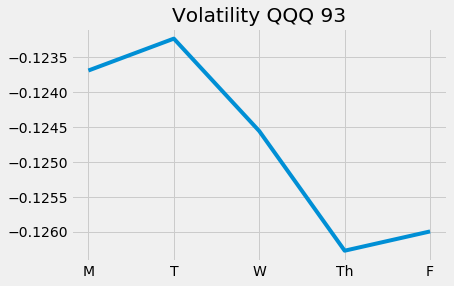

Epoch 95/5000
628/628 [==============================] - 1s 2ms/step - loss: 1.1871 - val_loss: 1.6975


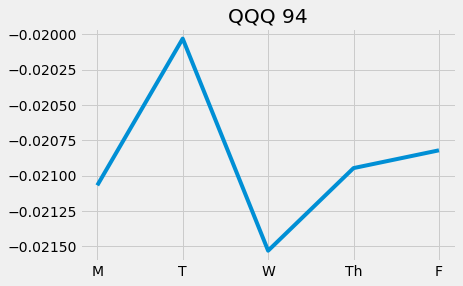

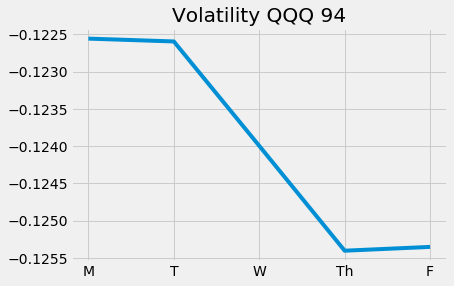

Epoch 96/5000
628/628 [==============================] - 1s 2ms/step - loss: 1.1780 - val_loss: 1.7401


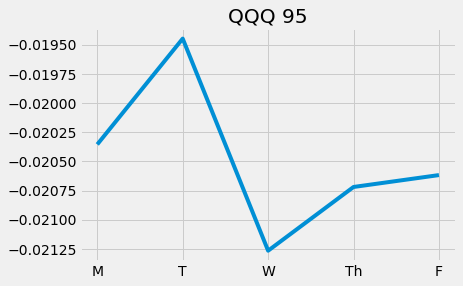

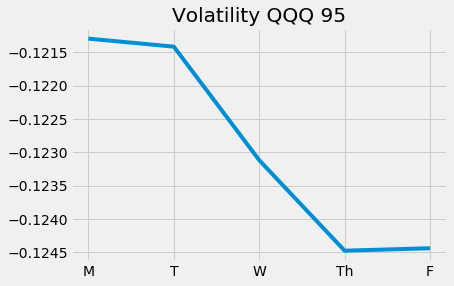

Epoch 97/5000
628/628 [==============================] - 1s 2ms/step - loss: 1.1710 - val_loss: 1.6962


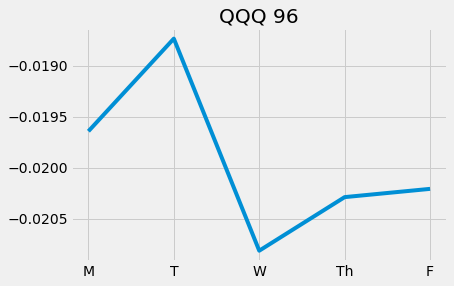

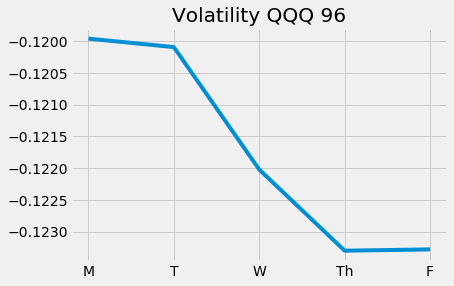

Epoch 98/5000
628/628 [==============================] - 1s 2ms/step - loss: 1.1710 - val_loss: 1.8478


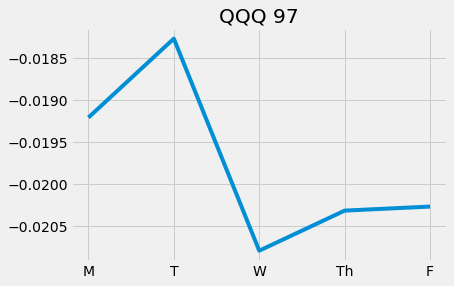

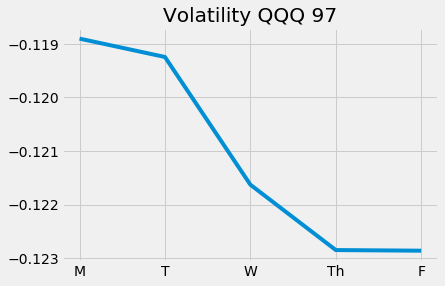

Epoch 99/5000
628/628 [==============================] - 1s 2ms/step - loss: 1.1572 - val_loss: 1.8032


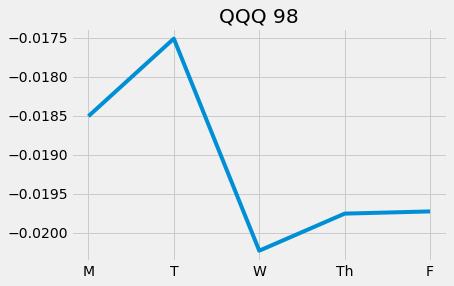

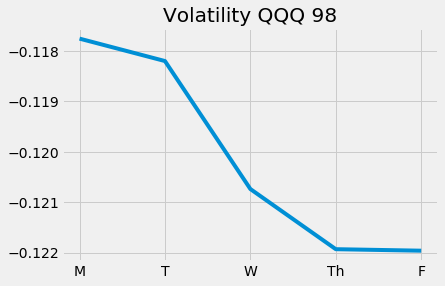

Epoch 100/5000
628/628 [==============================] - 1s 2ms/step - loss: 1.1593 - val_loss: 1.8525


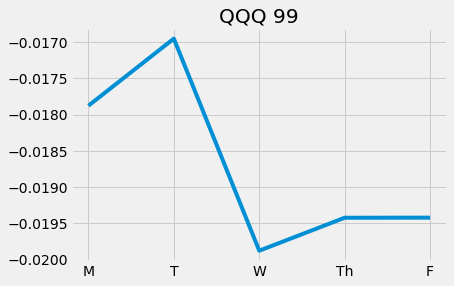

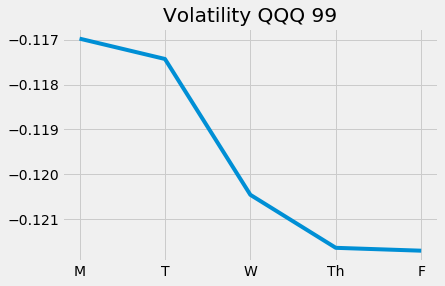

Epoch 101/5000
628/628 [==============================] - 1s 2ms/step - loss: 1.1524 - val_loss: 1.8227


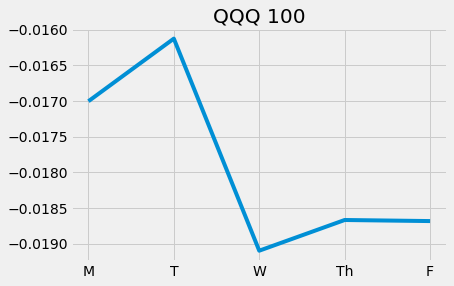

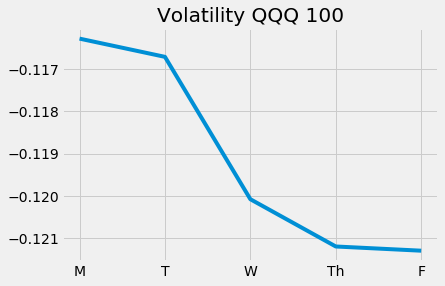

Epoch 102/5000
628/628 [==============================] - 1s 2ms/step - loss: 1.1425 - val_loss: 1.9237


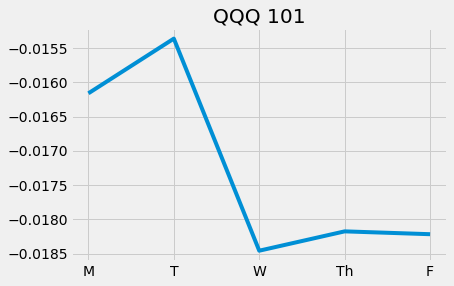

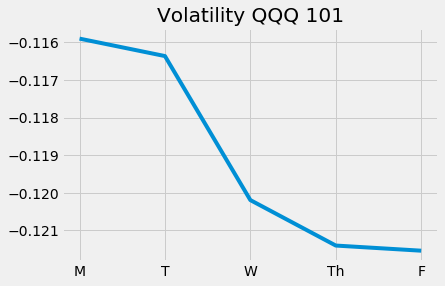

Epoch 103/5000
628/628 [==============================] - 1s 2ms/step - loss: 1.1398 - val_loss: 1.3168


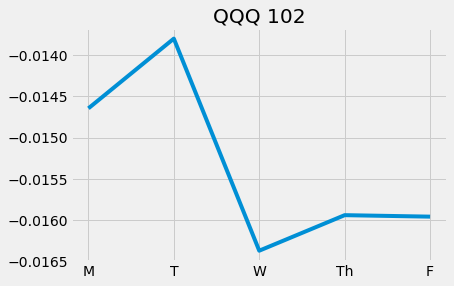

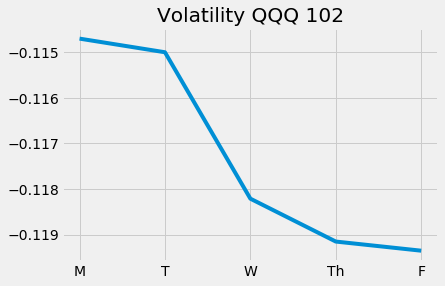

Epoch 104/5000
628/628 [==============================] - 1s 2ms/step - loss: 1.1447 - val_loss: 1.6848


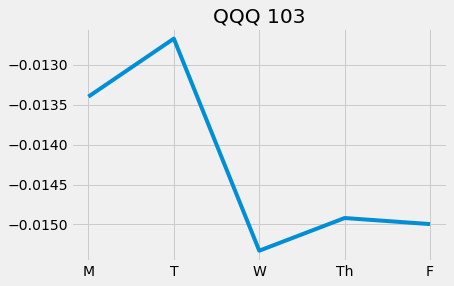

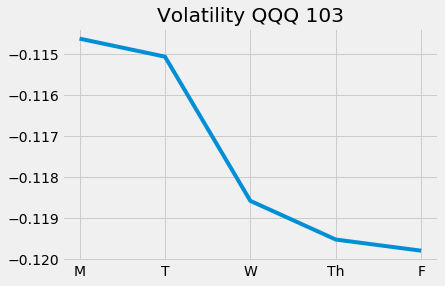

Epoch 105/5000
628/628 [==============================] - 1s 2ms/step - loss: 1.1291 - val_loss: 2.2470


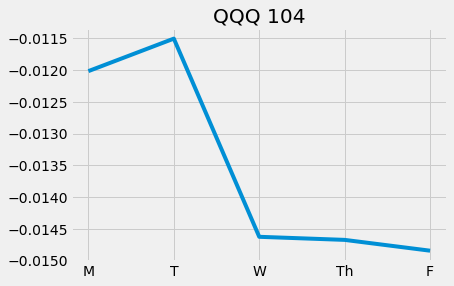

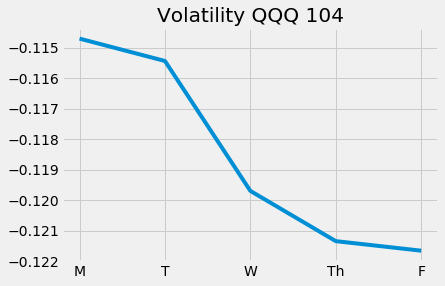

Epoch 106/5000
628/628 [==============================] - 1s 2ms/step - loss: 1.2706 - val_loss: 1.2530


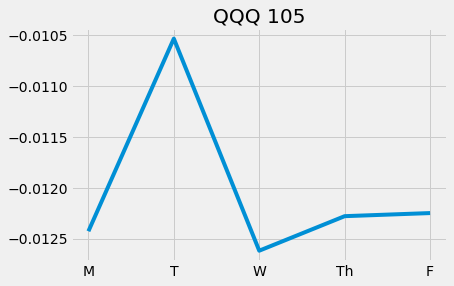

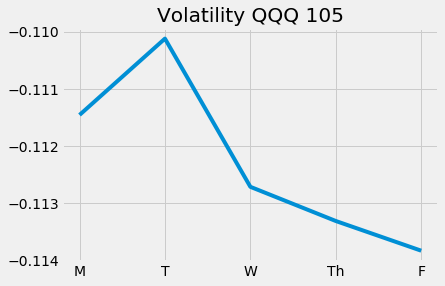

Epoch 107/5000
628/628 [==============================] - 1s 2ms/step - loss: 1.1736 - val_loss: 1.2324


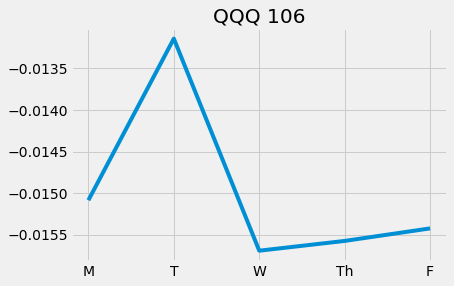

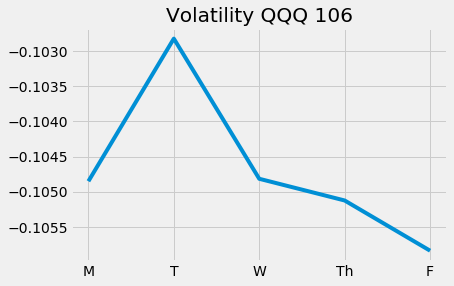

Epoch 108/5000
628/628 [==============================] - 1s 2ms/step - loss: 1.2008 - val_loss: 1.2403


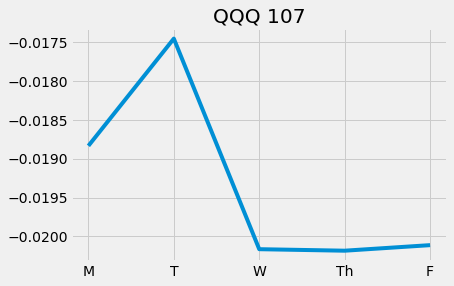

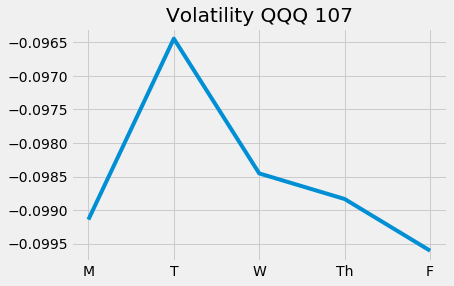

Epoch 109/5000
628/628 [==============================] - 1s 2ms/step - loss: 1.2633 - val_loss: 1.1994


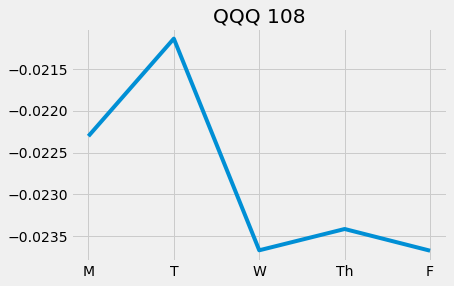

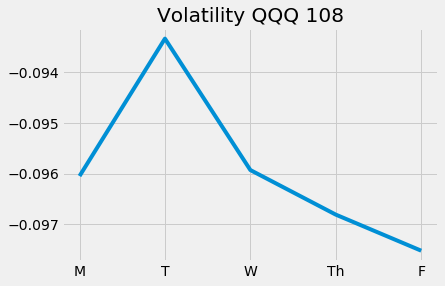

Epoch 110/5000
628/628 [==============================] - 1s 2ms/step - loss: 1.2150 - val_loss: 1.1758


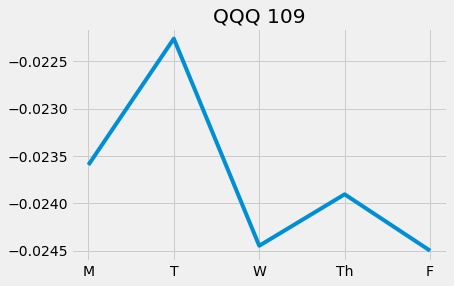

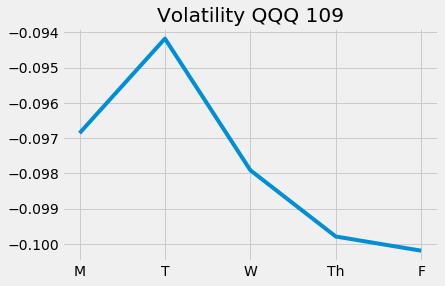

Epoch 111/5000
628/628 [==============================] - 1s 2ms/step - loss: 1.2198 - val_loss: 1.1604


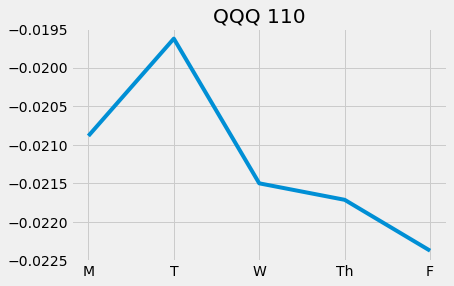

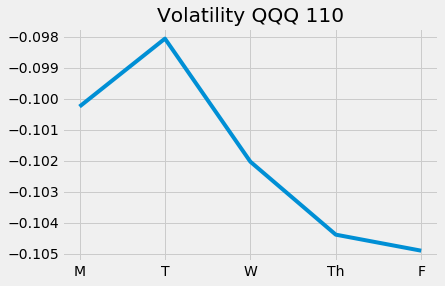

Epoch 112/5000
628/628 [==============================] - 1s 2ms/step - loss: 1.1977 - val_loss: 1.1753


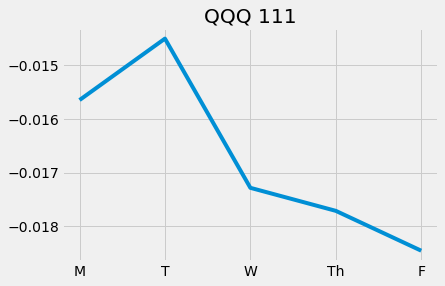

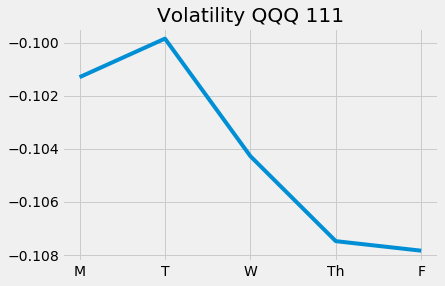

Epoch 113/5000
628/628 [==============================] - 2s 3ms/step - loss: 1.1996 - val_loss: 1.2158


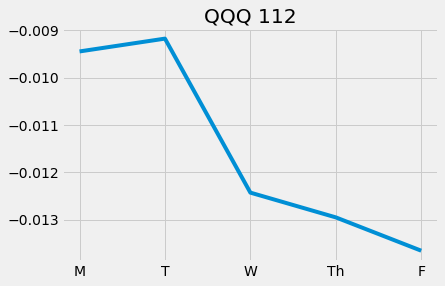

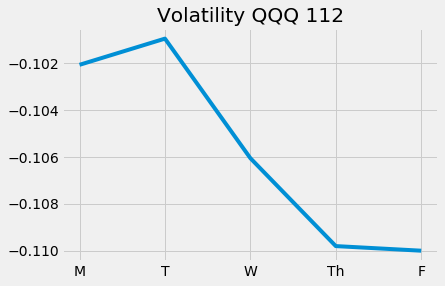

Epoch 114/5000
628/628 [==============================] - 2s 3ms/step - loss: 1.1980 - val_loss: 1.2533


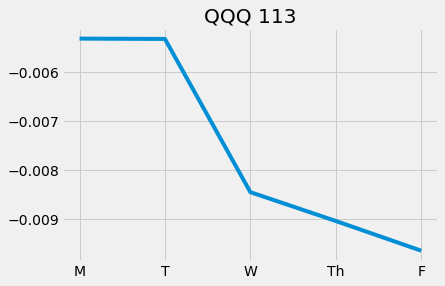

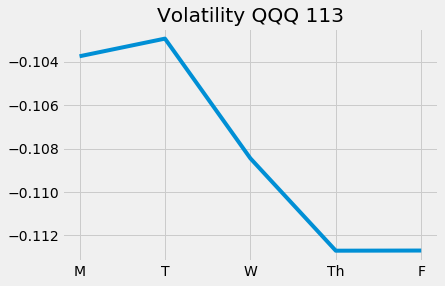

Epoch 115/5000
628/628 [==============================] - 1s 2ms/step - loss: 1.2076 - val_loss: 1.2770


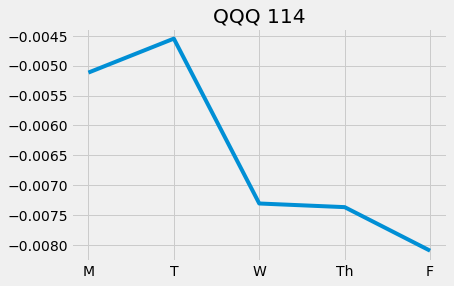

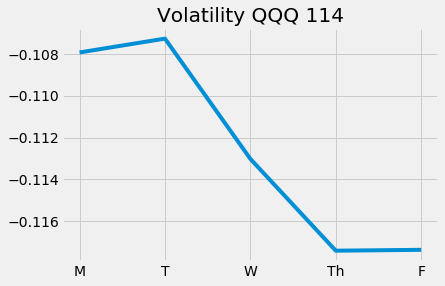

Epoch 116/5000
628/628 [==============================] - 1s 2ms/step - loss: 1.1929 - val_loss: 1.2932


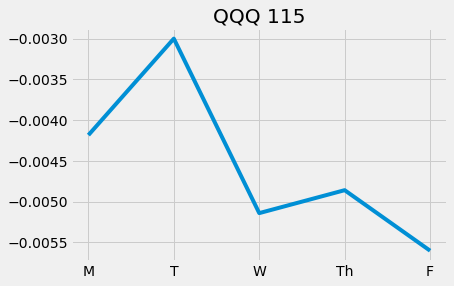

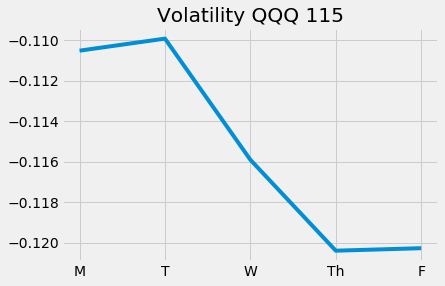

Epoch 117/5000
628/628 [==============================] - 2s 3ms/step - loss: 1.1905 - val_loss: 1.3041


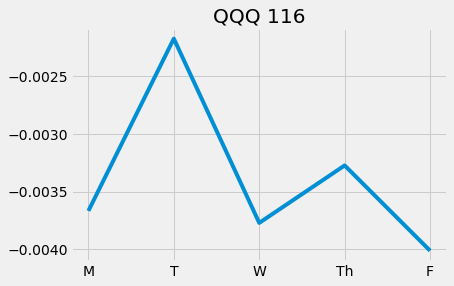

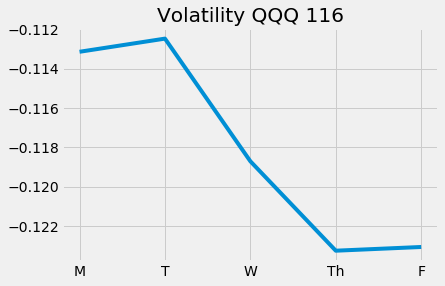

Epoch 118/5000
628/628 [==============================] - 1s 2ms/step - loss: 1.1653 - val_loss: 1.3056


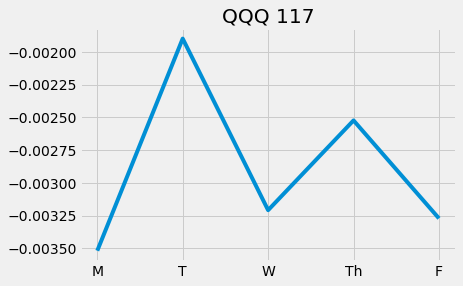

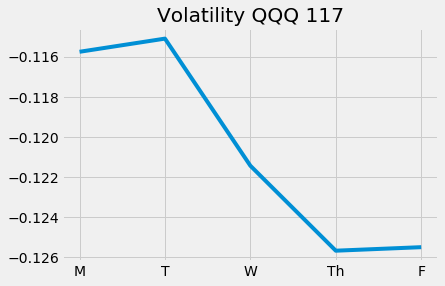

Epoch 119/5000
628/628 [==============================] - 1s 2ms/step - loss: 1.1392 - val_loss: 1.2963


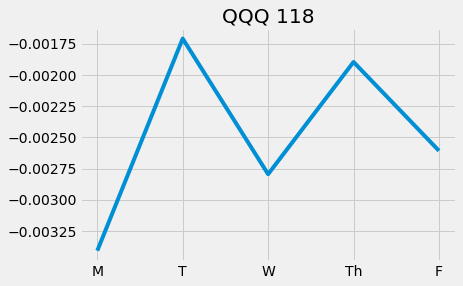

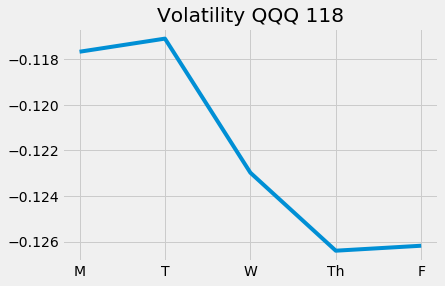

Epoch 120/5000
628/628 [==============================] - 1s 2ms/step - loss: 1.1225 - val_loss: 1.2917


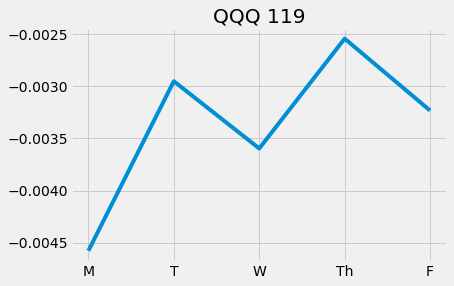

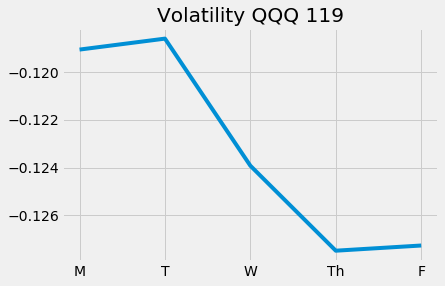

Epoch 121/5000
628/628 [==============================] - 1s 2ms/step - loss: 1.1470 - val_loss: 1.2914


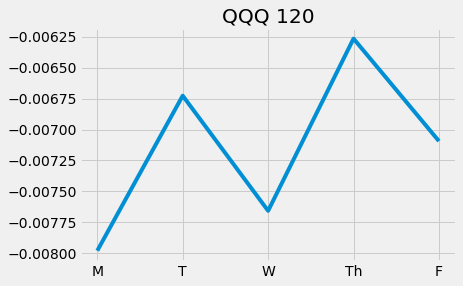

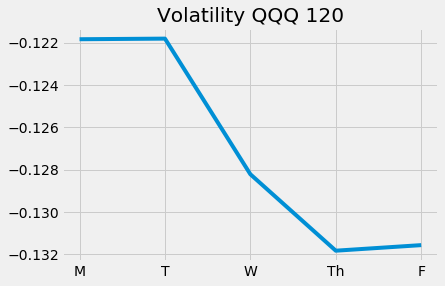

Epoch 122/5000
628/628 [==============================] - 1s 2ms/step - loss: 1.1146 - val_loss: 1.2944


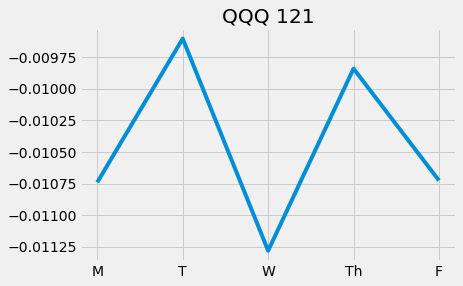

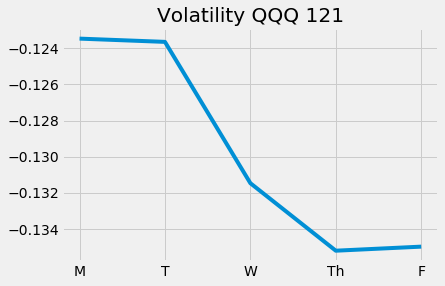

Epoch 123/5000
628/628 [==============================] - 1s 2ms/step - loss: 1.1013 - val_loss: 1.3012


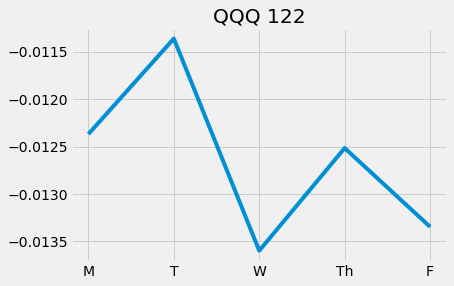

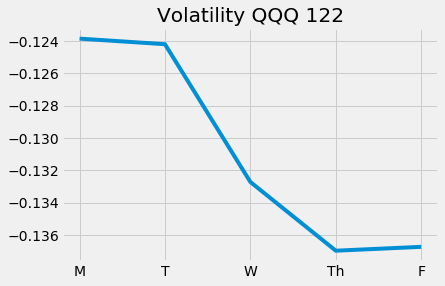

Epoch 124/5000
628/628 [==============================] - 1s 2ms/step - loss: 1.1091 - val_loss: 1.3193


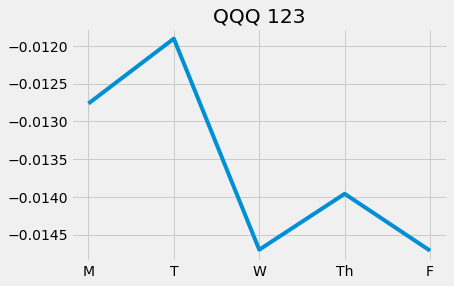

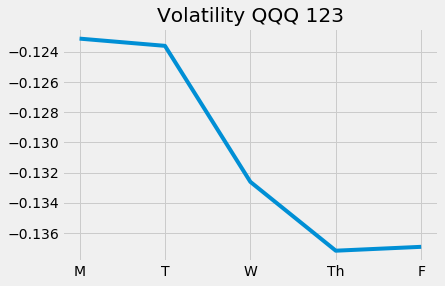

Epoch 125/5000
628/628 [==============================] - 1s 2ms/step - loss: 1.1018 - val_loss: 1.3772


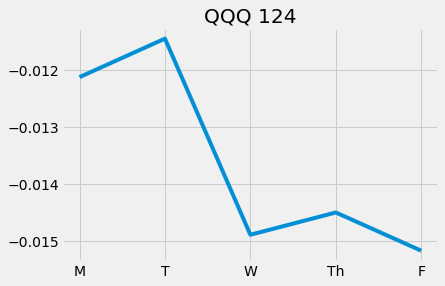

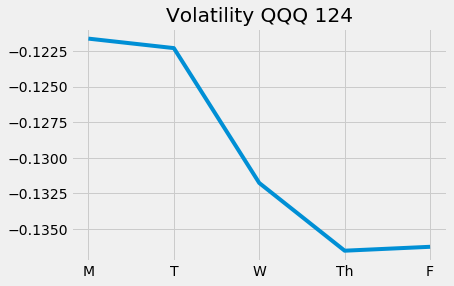

Epoch 126/5000
628/628 [==============================] - 1s 2ms/step - loss: 1.0907 - val_loss: 1.4849

Epoch 00126: ReduceLROnPlateau reducing learning rate to 0.0002500000118743628.


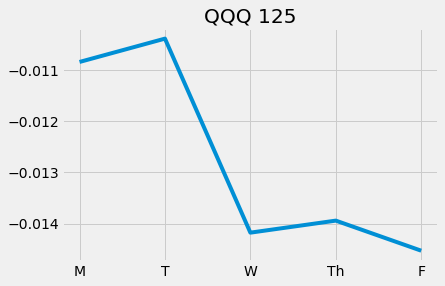

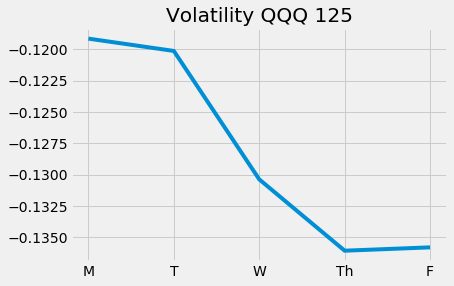

Epoch 127/5000
628/628 [==============================] - 1s 2ms/step - loss: 1.1003 - val_loss: 1.5150


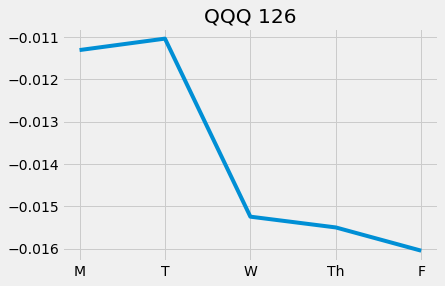

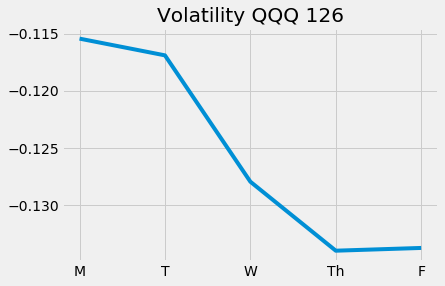

Epoch 128/5000
628/628 [==============================] - 1s 2ms/step - loss: 1.0954 - val_loss: 1.5235


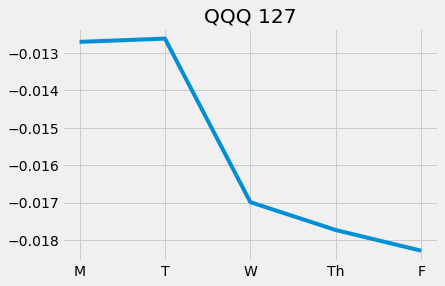

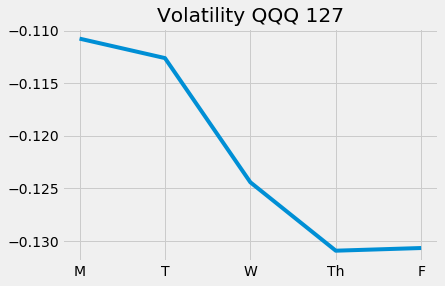

Epoch 129/5000
628/628 [==============================] - 1s 2ms/step - loss: 1.0786 - val_loss: 1.5121


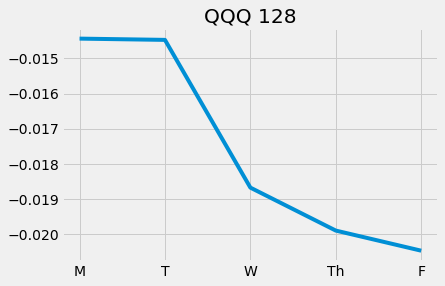

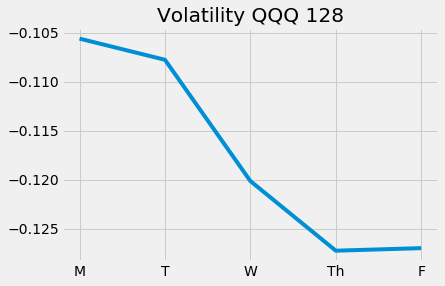

Epoch 130/5000
628/628 [==============================] - 1s 2ms/step - loss: 1.0747 - val_loss: 1.4745


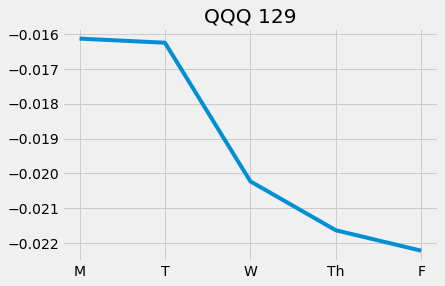

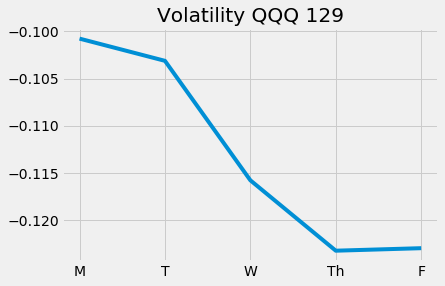

Epoch 131/5000
628/628 [==============================] - 1s 2ms/step - loss: 1.0774 - val_loss: 1.3980


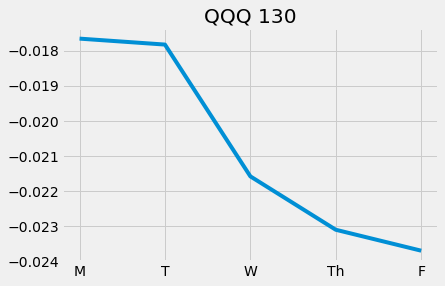

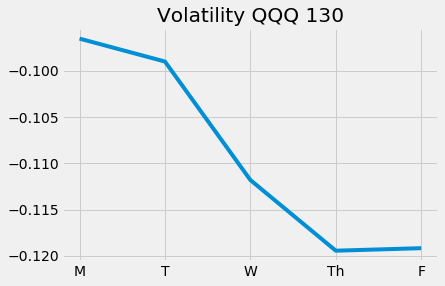

Epoch 132/5000
628/628 [==============================] - 1s 2ms/step - loss: 1.0737 - val_loss: 1.3070


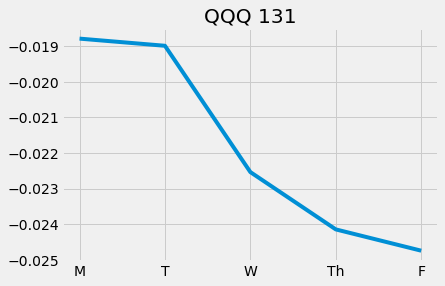

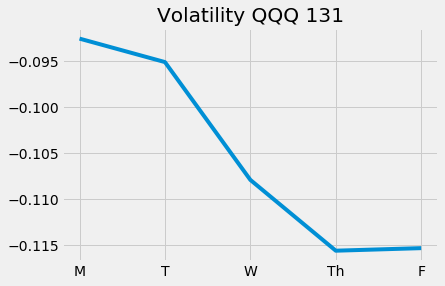

Epoch 133/5000
628/628 [==============================] - 1s 2ms/step - loss: 1.0613 - val_loss: 1.2428


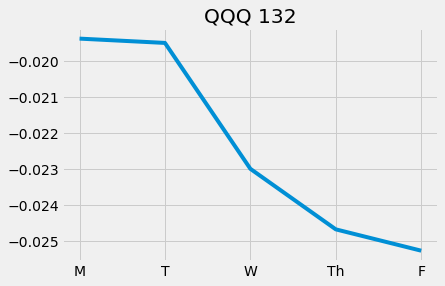

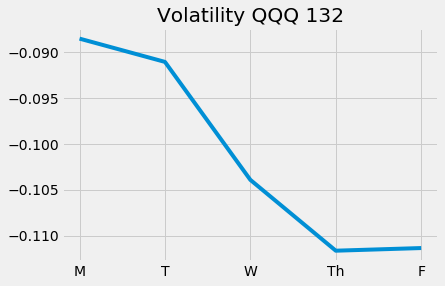

Epoch 134/5000
628/628 [==============================] - 1s 2ms/step - loss: 1.0683 - val_loss: 1.2087


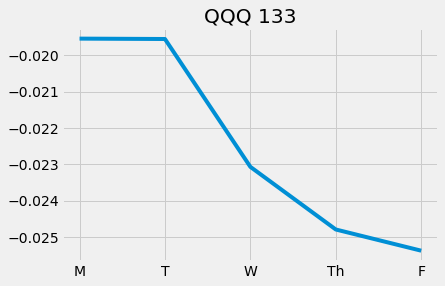

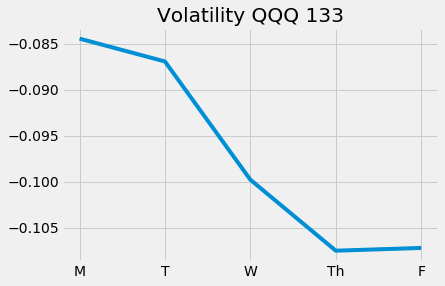

Epoch 135/5000
628/628 [==============================] - 1s 2ms/step - loss: 1.0620 - val_loss: 1.1921


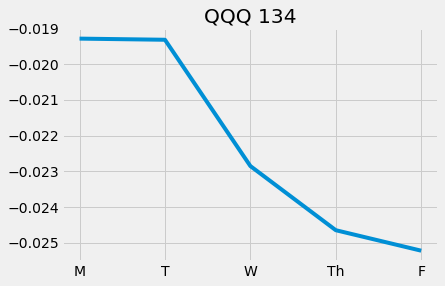

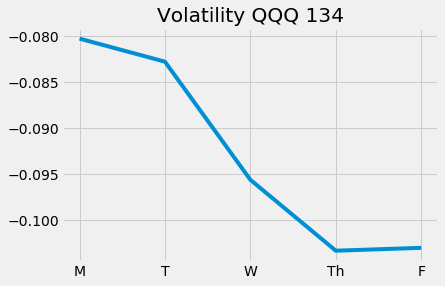

Epoch 136/5000
628/628 [==============================] - 1s 2ms/step - loss: 1.0595 - val_loss: 1.1844


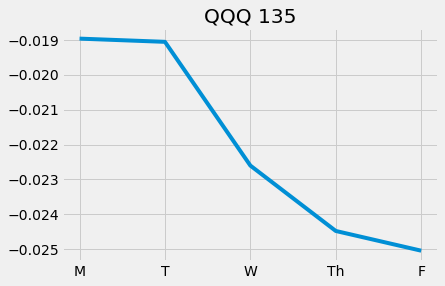

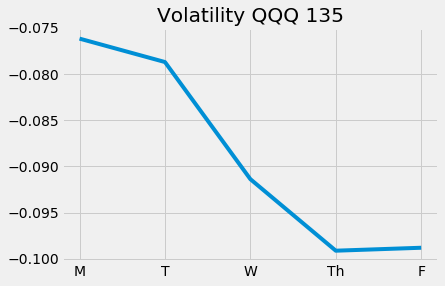

Epoch 137/5000
628/628 [==============================] - 1s 2ms/step - loss: 1.0554 - val_loss: 1.1815


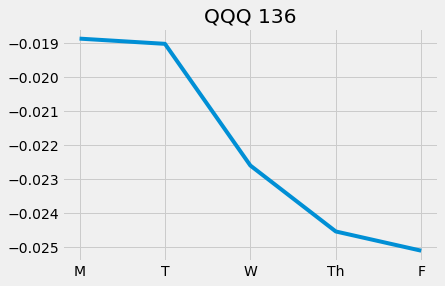

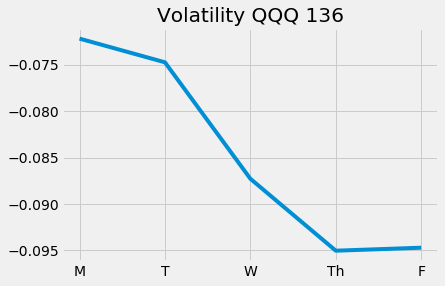

Epoch 138/5000
628/628 [==============================] - 1s 2ms/step - loss: 1.0531 - val_loss: 1.1806


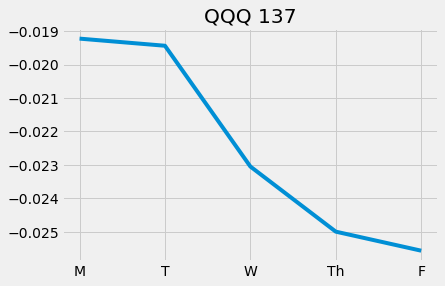

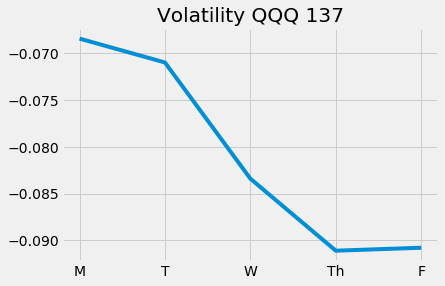

Epoch 139/5000
628/628 [==============================] - 1s 2ms/step - loss: 1.0537 - val_loss: 1.1810


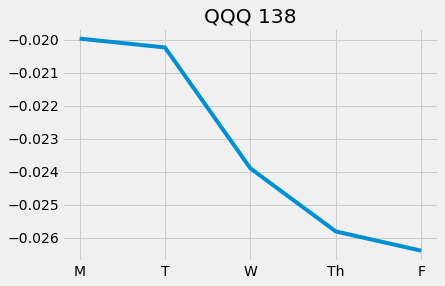

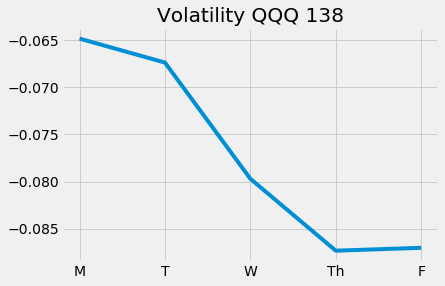

Epoch 140/5000
628/628 [==============================] - 1s 2ms/step - loss: 1.0451 - val_loss: 1.1835


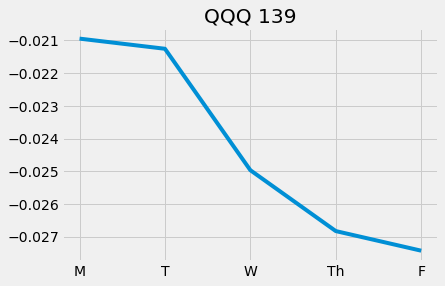

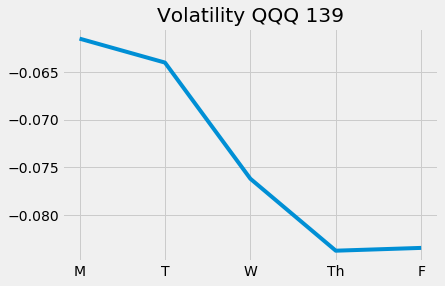

Epoch 141/5000
628/628 [==============================] - 1s 2ms/step - loss: 1.0409 - val_loss: 1.1948

Epoch 00141: ReduceLROnPlateau reducing learning rate to 0.0001250000059371814.


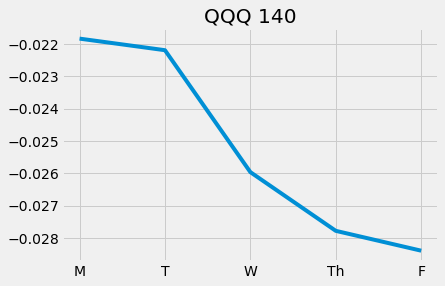

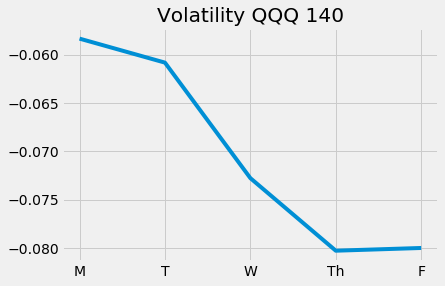

Epoch 142/5000
628/628 [==============================] - 1s 2ms/step - loss: 1.0478 - val_loss: 1.2063


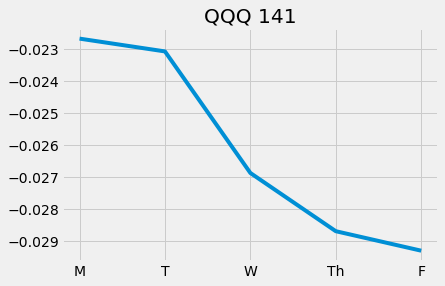

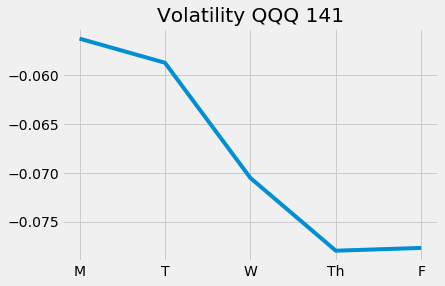

Epoch 143/5000
628/628 [==============================] - 1s 2ms/step - loss: 1.0436 - val_loss: 1.2253


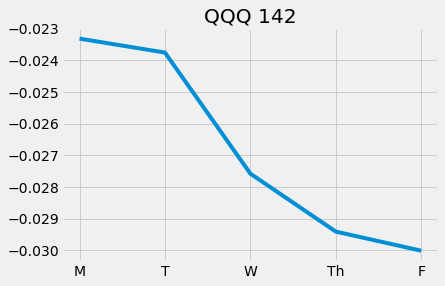

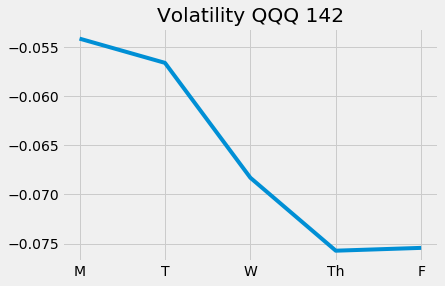

Epoch 144/5000
628/628 [==============================] - 1s 2ms/step - loss: 1.0459 - val_loss: 1.2514


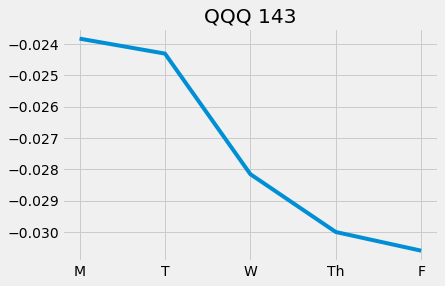

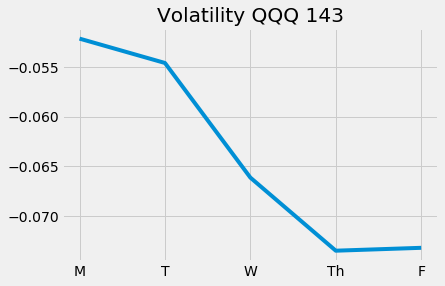

Epoch 145/5000
628/628 [==============================] - 1s 2ms/step - loss: 1.0353 - val_loss: 1.2779


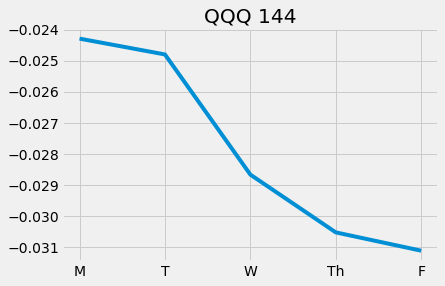

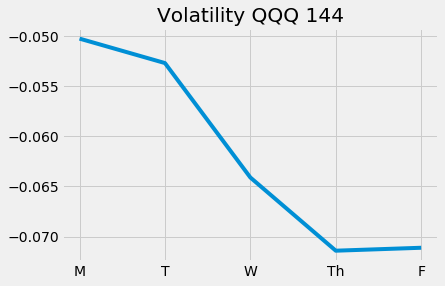

Epoch 146/5000
628/628 [==============================] - 1s 2ms/step - loss: 1.0403 - val_loss: 1.2854


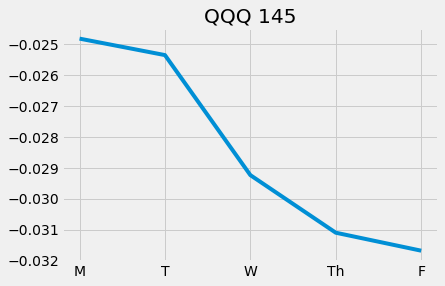

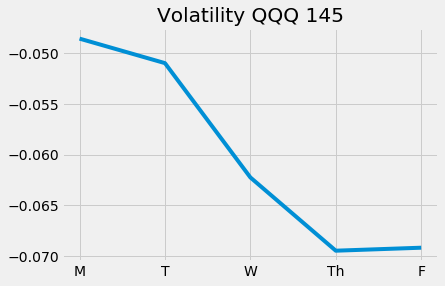

Epoch 147/5000
628/628 [==============================] - 1s 2ms/step - loss: 1.0358 - val_loss: 1.2648


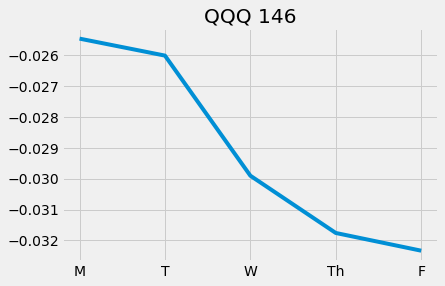

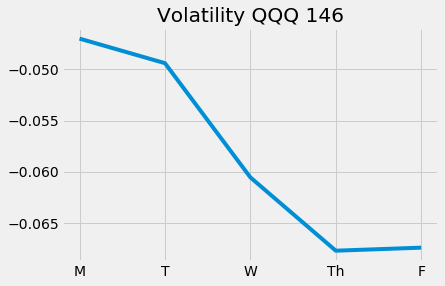

Epoch 148/5000
628/628 [==============================] - 1s 2ms/step - loss: 1.0379 - val_loss: 1.2296


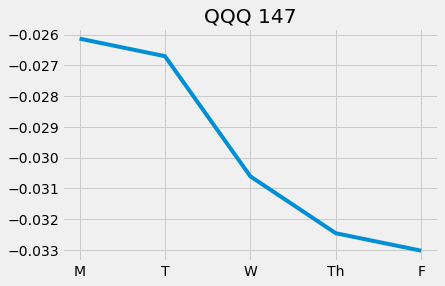

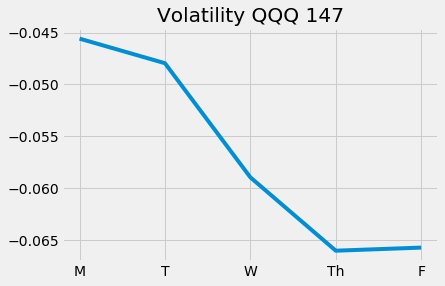

Epoch 149/5000
628/628 [==============================] - 1s 2ms/step - loss: 1.0311 - val_loss: 1.1906


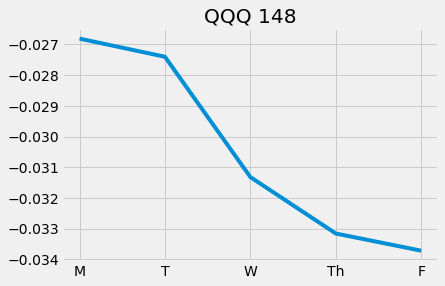

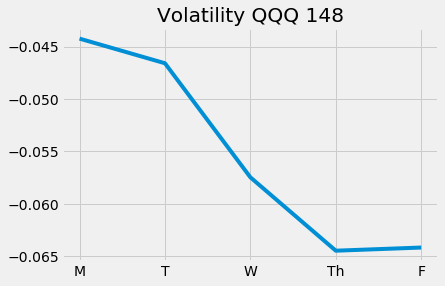

Epoch 150/5000
628/628 [==============================] - 1s 2ms/step - loss: 1.0294 - val_loss: 1.1648


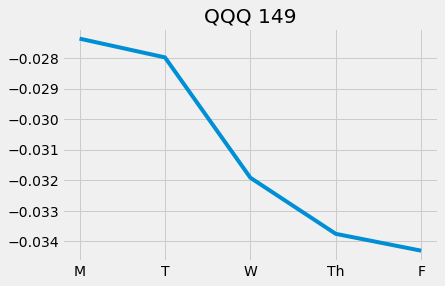

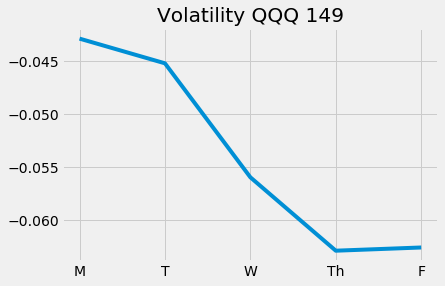

Epoch 151/5000
628/628 [==============================] - 1s 2ms/step - loss: 1.0368 - val_loss: 1.1513


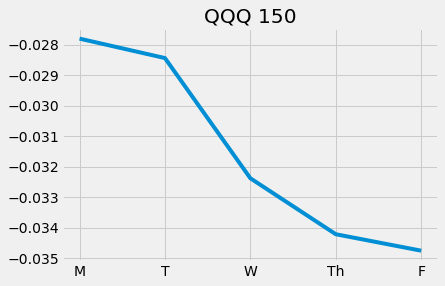

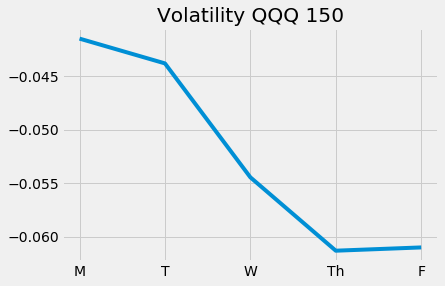

Epoch 152/5000
628/628 [==============================] - 1s 2ms/step - loss: 1.0271 - val_loss: 1.1429


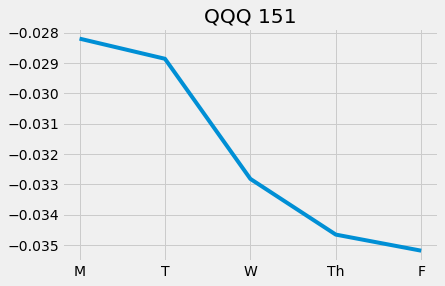

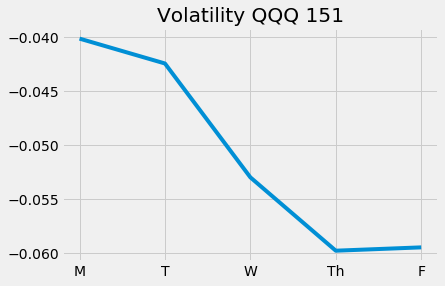

Epoch 153/5000
628/628 [==============================] - 2s 2ms/step - loss: 1.0315 - val_loss: 1.1370


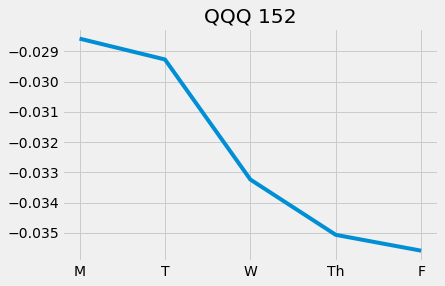

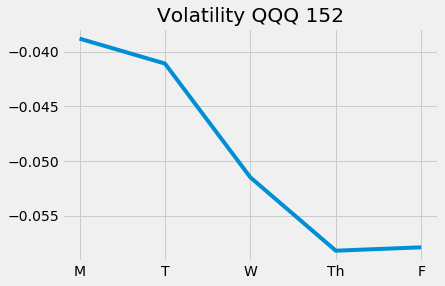

Epoch 154/5000
628/628 [==============================] - 1s 2ms/step - loss: 1.0319 - val_loss: 1.1310


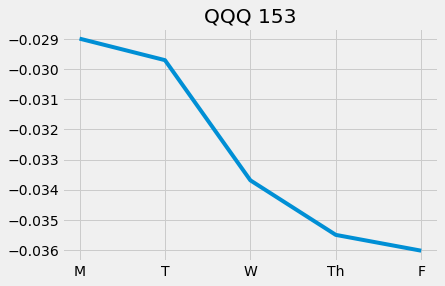

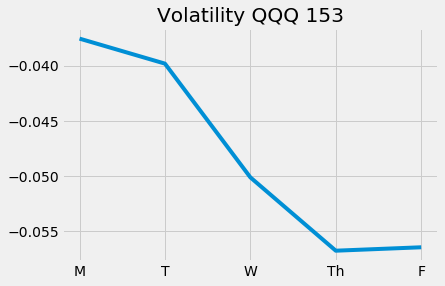

Epoch 155/5000
628/628 [==============================] - 1s 2ms/step - loss: 1.0187 - val_loss: 1.1249


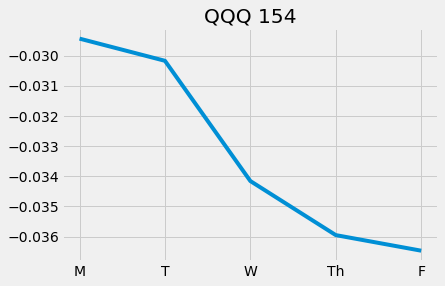

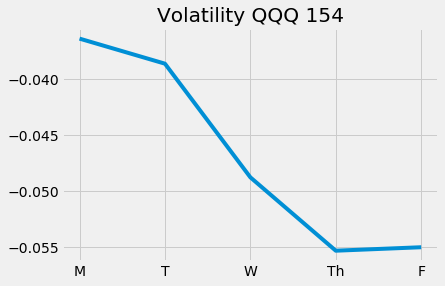

Epoch 156/5000
628/628 [==============================] - 1s 2ms/step - loss: 1.0284 - val_loss: 1.1152


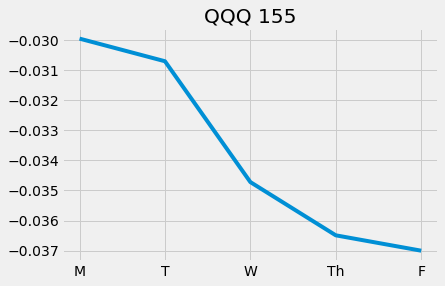

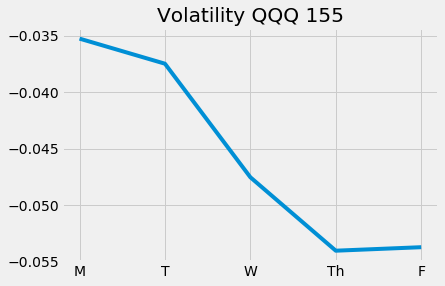

Epoch 157/5000
628/628 [==============================] - 1s 2ms/step - loss: 1.0263 - val_loss: 1.1027


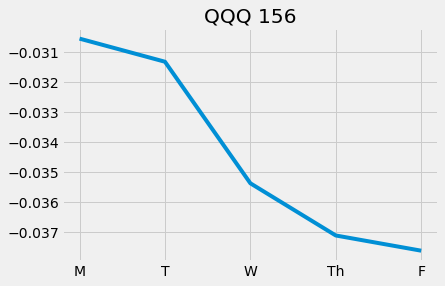

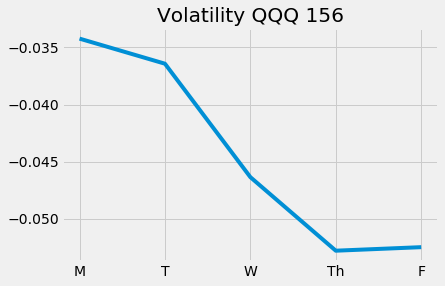

Epoch 158/5000
628/628 [==============================] - 1s 2ms/step - loss: 1.0207 - val_loss: 1.0928


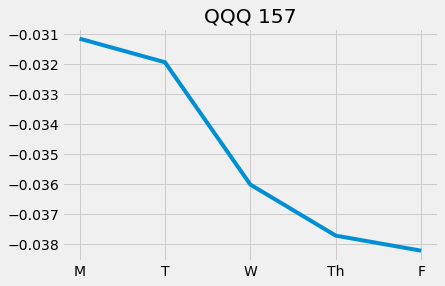

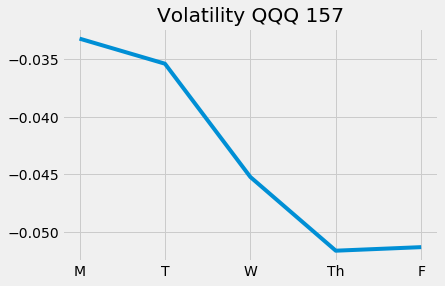

Epoch 159/5000
628/628 [==============================] - 1s 2ms/step - loss: 1.0289 - val_loss: 1.0858


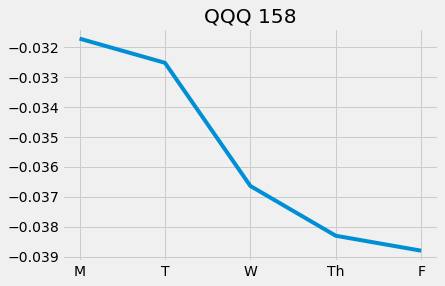

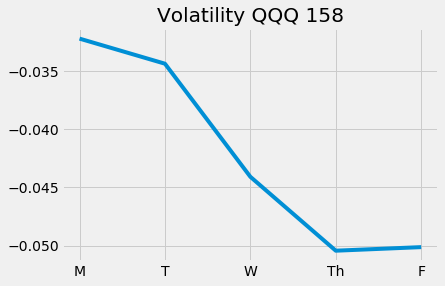

Epoch 160/5000
628/628 [==============================] - 1s 2ms/step - loss: 1.0282 - val_loss: 1.0843


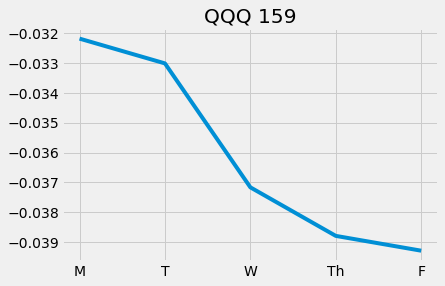

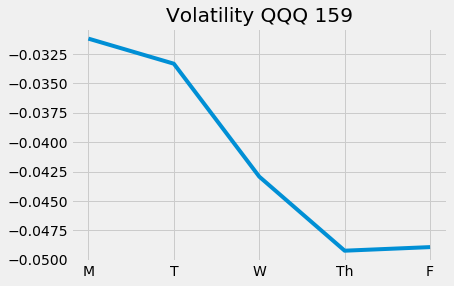

Epoch 161/5000
628/628 [==============================] - 1s 2ms/step - loss: 1.0235 - val_loss: 1.0871


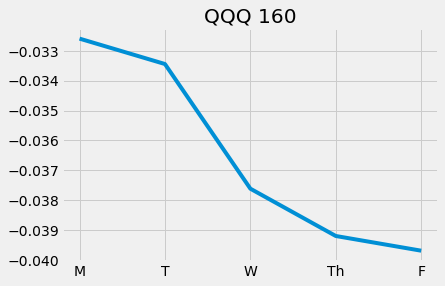

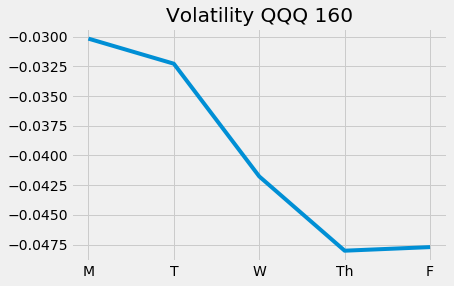

Epoch 162/5000
628/628 [==============================] - 1s 2ms/step - loss: 1.0224 - val_loss: 1.0955


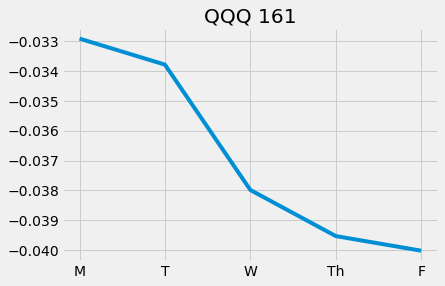

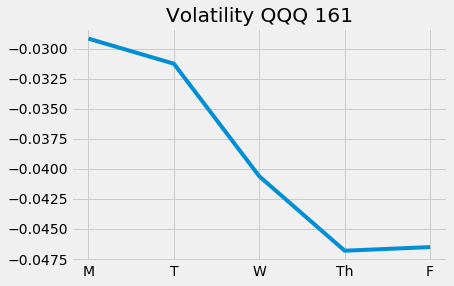

Epoch 163/5000
628/628 [==============================] - 1s 2ms/step - loss: 1.0353 - val_loss: 1.1139


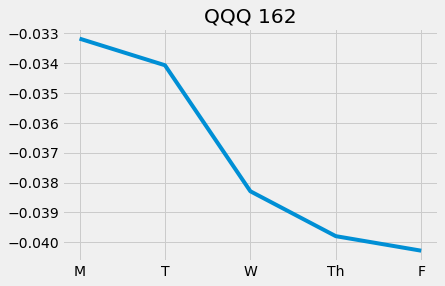

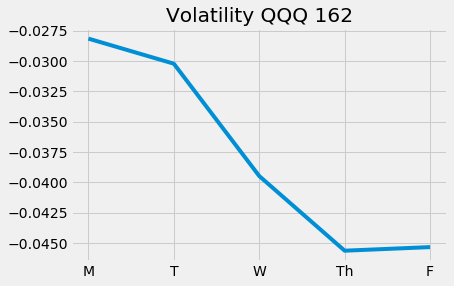

Epoch 164/5000
628/628 [==============================] - 1s 2ms/step - loss: 1.0225 - val_loss: 1.1379


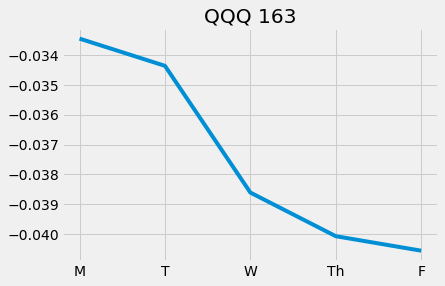

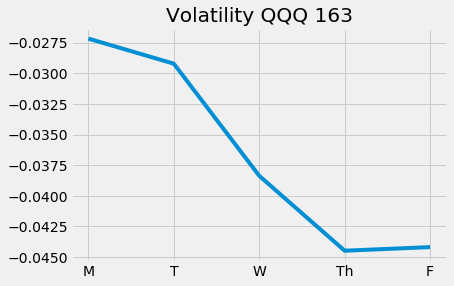

Epoch 165/5000
628/628 [==============================] - 1s 2ms/step - loss: 1.0116 - val_loss: 1.1474


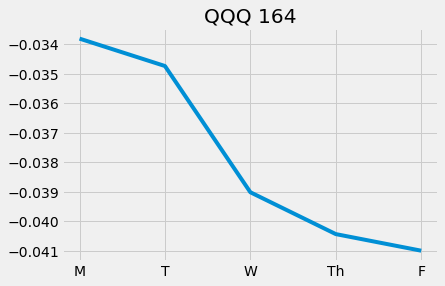

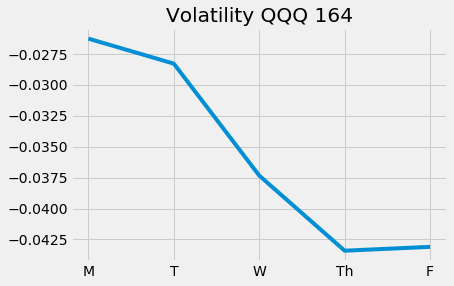

Epoch 166/5000
628/628 [==============================] - 1s 2ms/step - loss: 1.0181 - val_loss: 1.1529


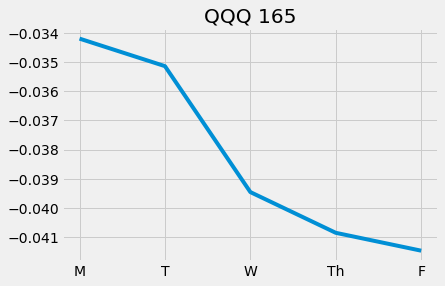

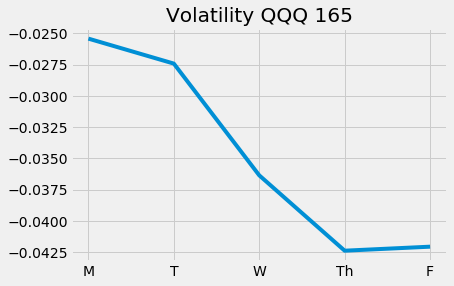

Epoch 167/5000
628/628 [==============================] - 1s 2ms/step - loss: 1.0179 - val_loss: 1.1574


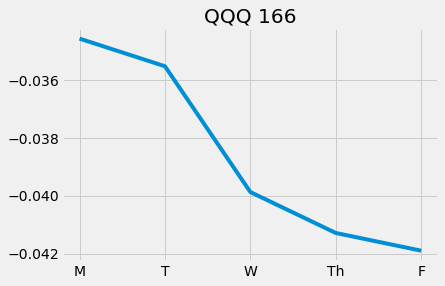

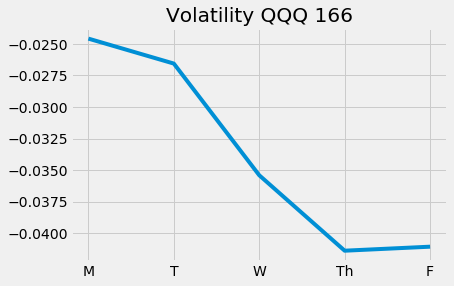

Epoch 168/5000
628/628 [==============================] - 1s 2ms/step - loss: 1.0176 - val_loss: 1.1654


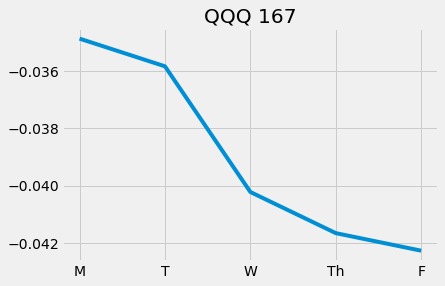

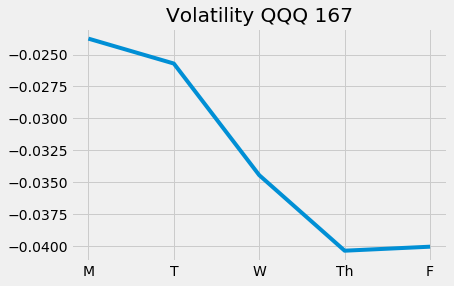

Epoch 169/5000
628/628 [==============================] - 1s 2ms/step - loss: 1.0109 - val_loss: 1.1830


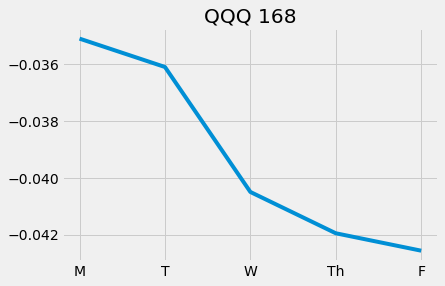

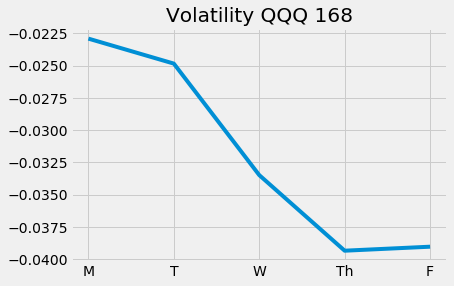

Epoch 170/5000
628/628 [==============================] - 1s 2ms/step - loss: 1.0137 - val_loss: 1.2195


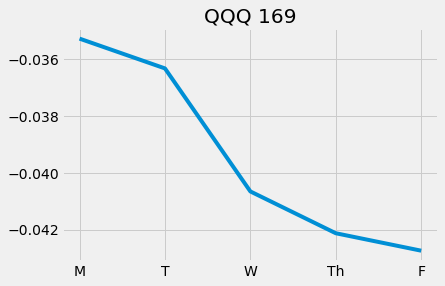

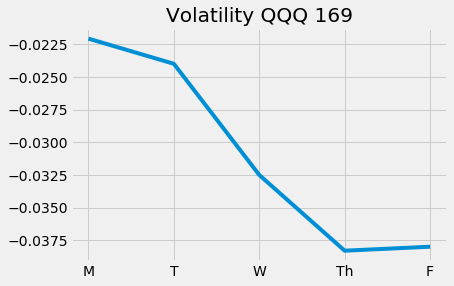

Epoch 171/5000
628/628 [==============================] - 1s 2ms/step - loss: 1.0136 - val_loss: 1.2492


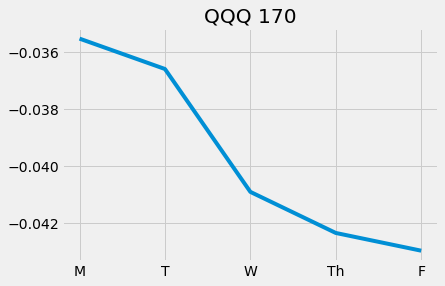

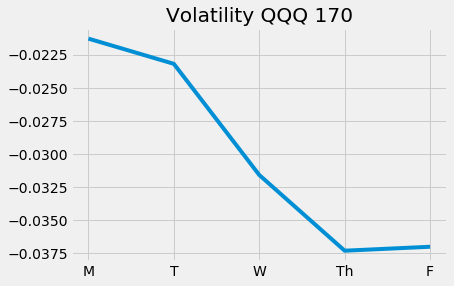

Epoch 172/5000
628/628 [==============================] - 1s 2ms/step - loss: 1.0152 - val_loss: 1.2718


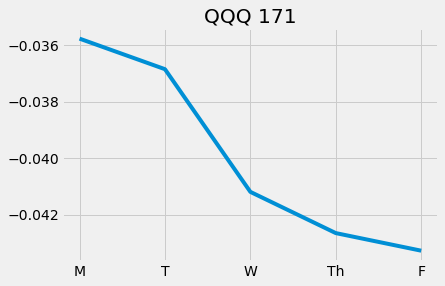

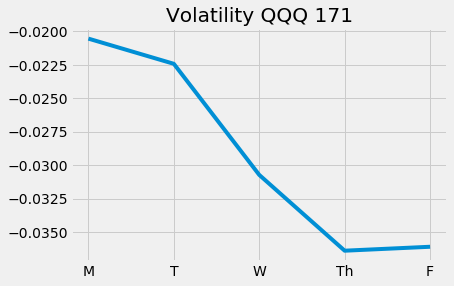

Epoch 173/5000
628/628 [==============================] - 1s 2ms/step - loss: 1.0140 - val_loss: 1.2986


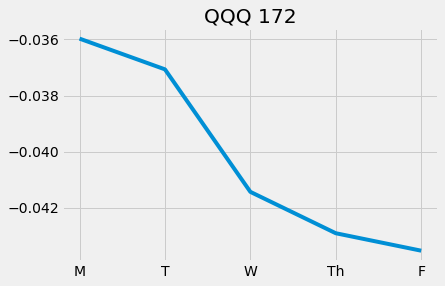

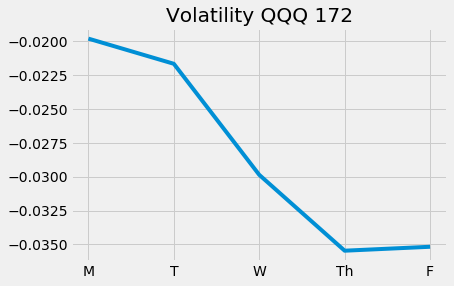

Epoch 174/5000
628/628 [==============================] - 1s 2ms/step - loss: 1.0055 - val_loss: 1.3050


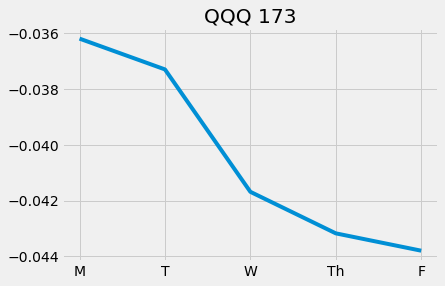

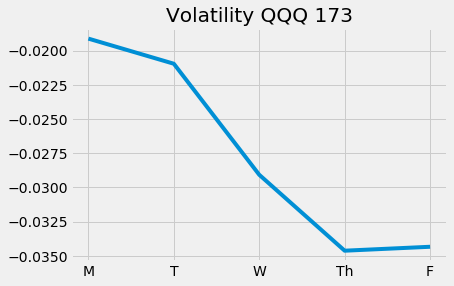

Epoch 175/5000
628/628 [==============================] - 1s 2ms/step - loss: 1.0059 - val_loss: 1.3007

Epoch 00175: ReduceLROnPlateau reducing learning rate to 6.25000029685907e-05.


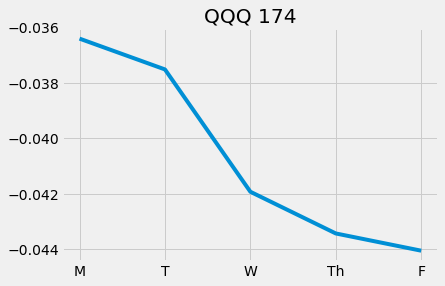

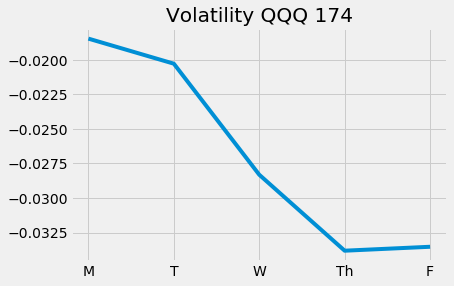

Epoch 176/5000
628/628 [==============================] - 1s 2ms/step - loss: 1.0080 - val_loss: 1.3023


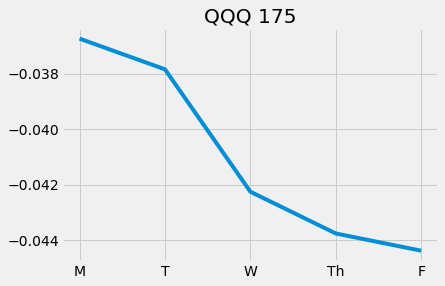

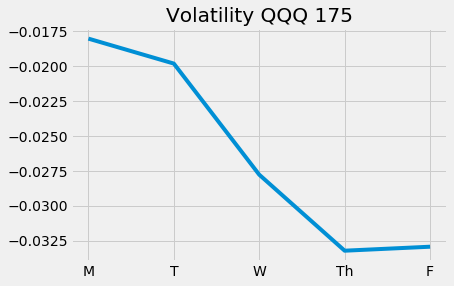

Epoch 177/5000
628/628 [==============================] - 1s 2ms/step - loss: 1.0098 - val_loss: 1.3031


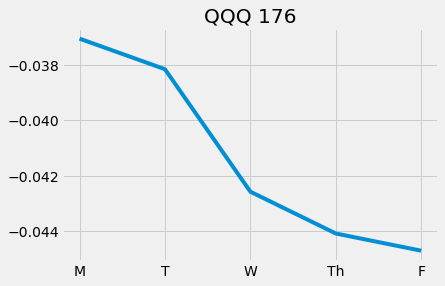

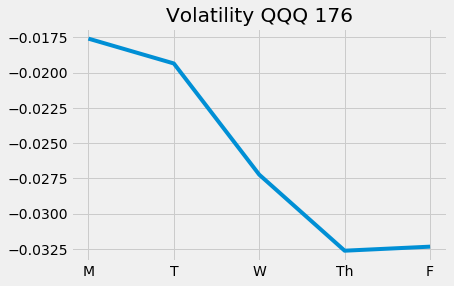

Epoch 178/5000
628/628 [==============================] - 1s 2ms/step - loss: 1.0049 - val_loss: 1.2980


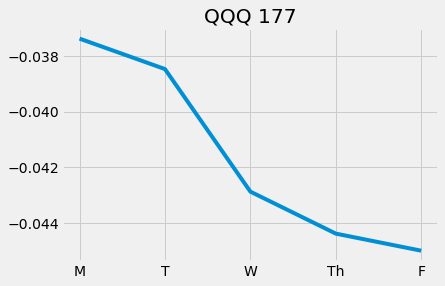

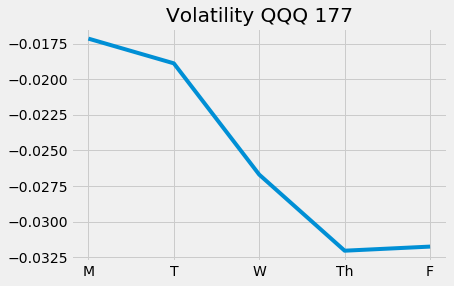

Epoch 179/5000
628/628 [==============================] - 1s 2ms/step - loss: 1.0146 - val_loss: 1.2930


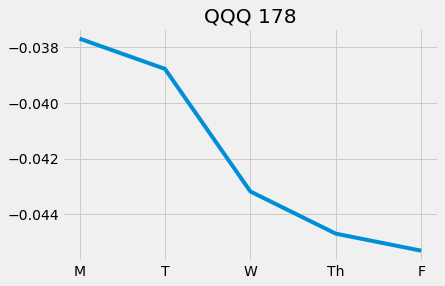

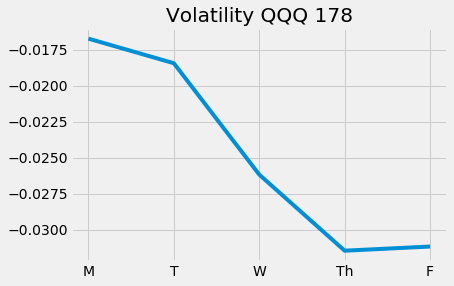

Epoch 180/5000
628/628 [==============================] - 1s 2ms/step - loss: 1.0058 - val_loss: 1.2971


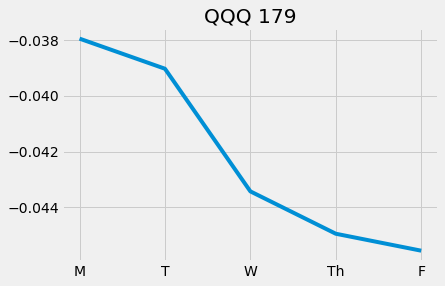

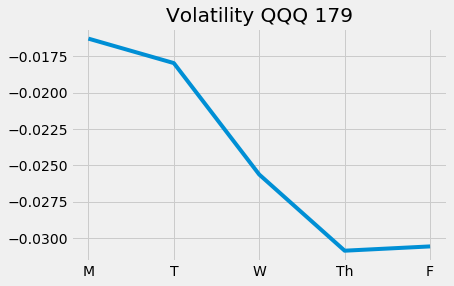

Epoch 181/5000
628/628 [==============================] - 1s 2ms/step - loss: 1.0058 - val_loss: 1.3016


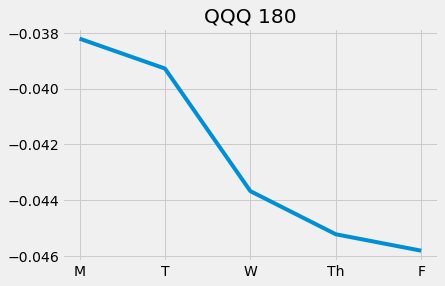

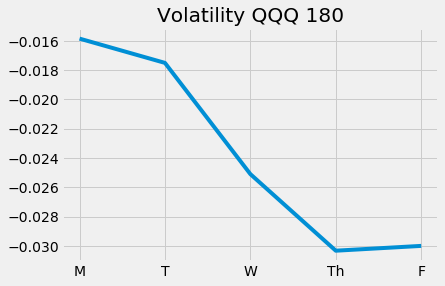

Epoch 182/5000
628/628 [==============================] - 1s 2ms/step - loss: 1.0100 - val_loss: 1.3166


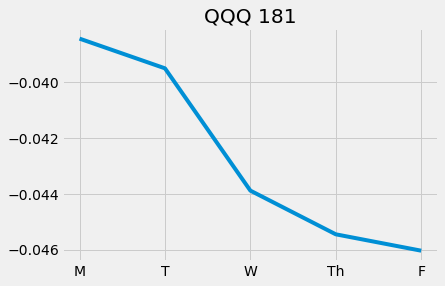

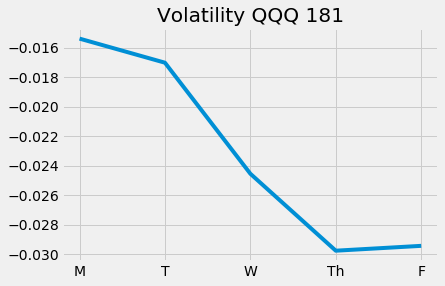

Epoch 183/5000
628/628 [==============================] - 1s 2ms/step - loss: 1.0027 - val_loss: 1.3171


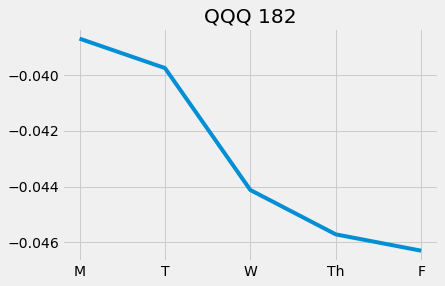

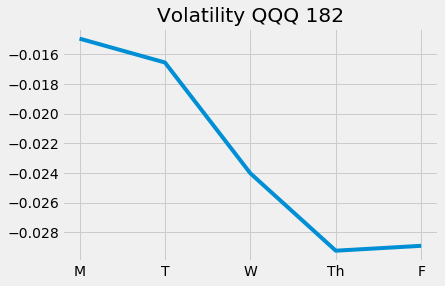

Epoch 184/5000
628/628 [==============================] - 1s 2ms/step - loss: 1.0033 - val_loss: 1.3040


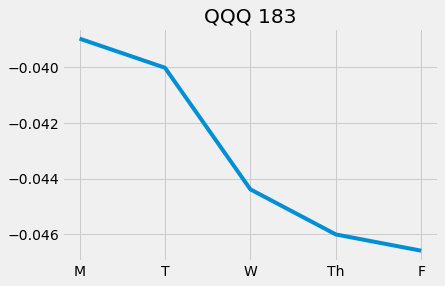

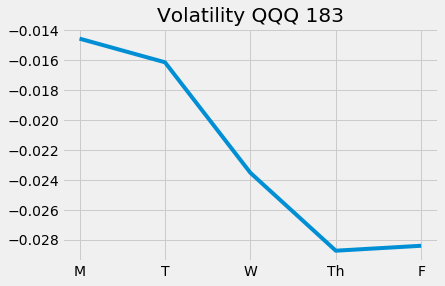

Epoch 185/5000
628/628 [==============================] - 1s 2ms/step - loss: 1.0046 - val_loss: 1.2906


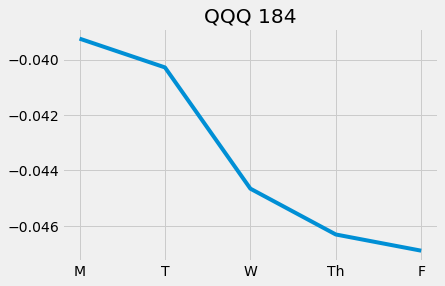

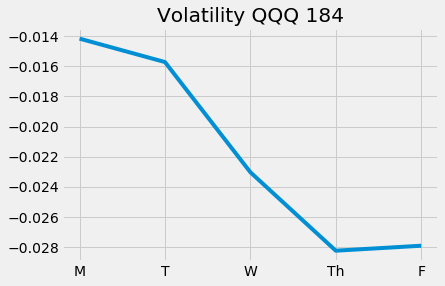

Epoch 186/5000
628/628 [==============================] - 1s 2ms/step - loss: 1.0024 - val_loss: 1.2821


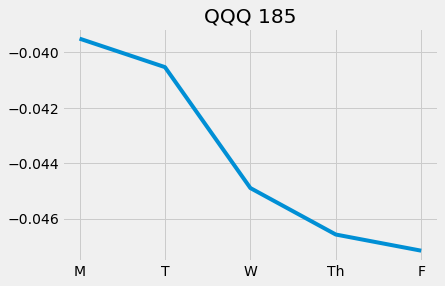

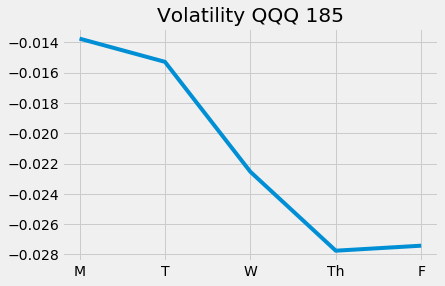

Epoch 187/5000
628/628 [==============================] - 1s 2ms/step - loss: 1.0043 - val_loss: 1.2776


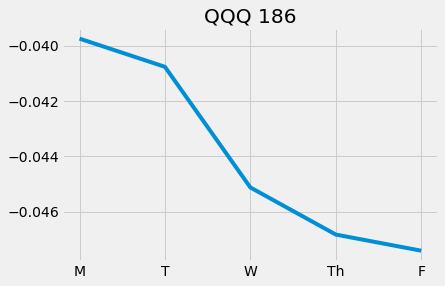

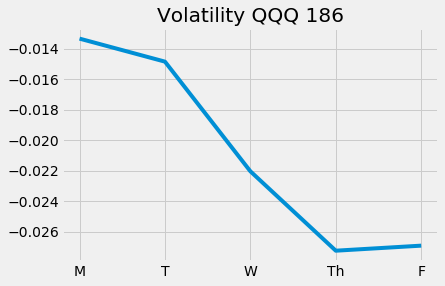

Epoch 188/5000
628/628 [==============================] - 1s 2ms/step - loss: 1.0018 - val_loss: 1.2726


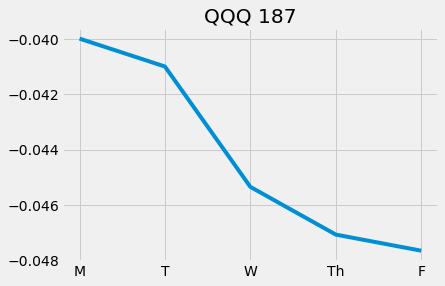

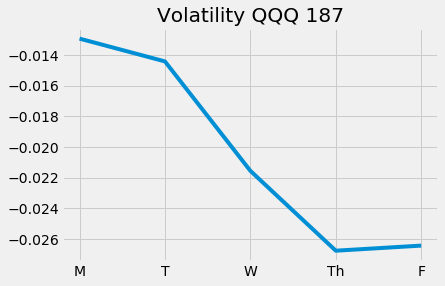

Epoch 189/5000
628/628 [==============================] - 1s 2ms/step - loss: 1.0023 - val_loss: 1.2664


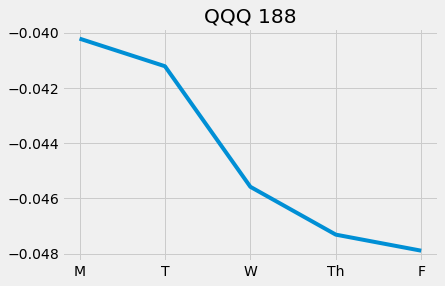

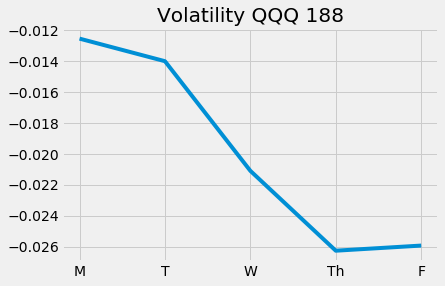

Epoch 190/5000
628/628 [==============================] - 1s 2ms/step - loss: 1.0098 - val_loss: 1.2712

Epoch 00190: ReduceLROnPlateau reducing learning rate to 3.125000148429535e-05.


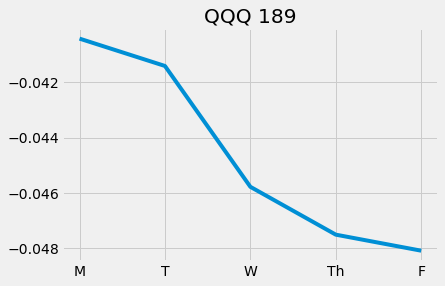

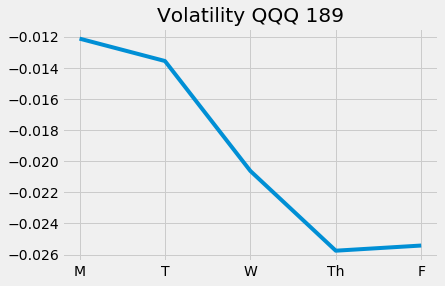

Epoch 191/5000
628/628 [==============================] - 1s 2ms/step - loss: 1.0014 - val_loss: 1.2739


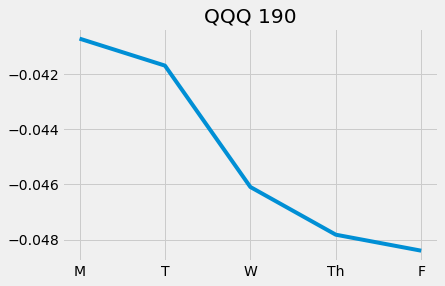

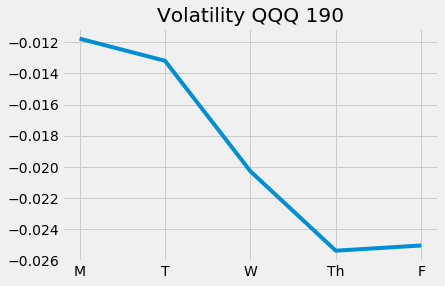

Epoch 192/5000
628/628 [==============================] - 1s 2ms/step - loss: 1.0014 - val_loss: 1.2794


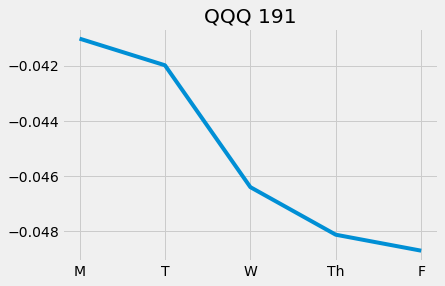

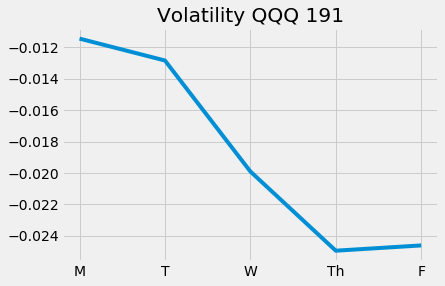

Epoch 193/5000
628/628 [==============================] - 1s 2ms/step - loss: 1.0001 - val_loss: 1.2826


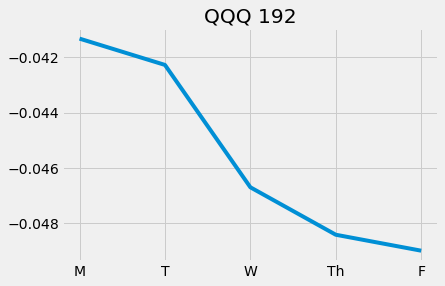

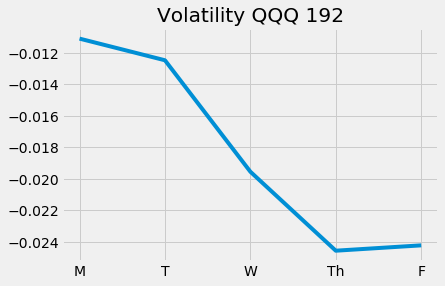

Epoch 194/5000
628/628 [==============================] - 1s 2ms/step - loss: 0.9969 - val_loss: 1.2884


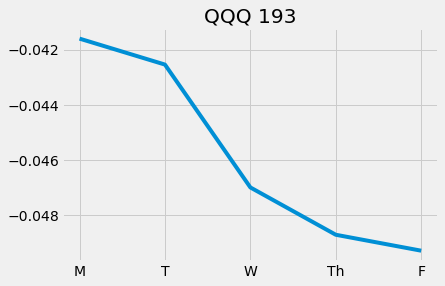

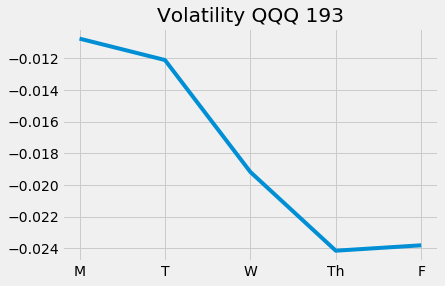

Epoch 195/5000
628/628 [==============================] - 1s 2ms/step - loss: 1.0053 - val_loss: 1.2922


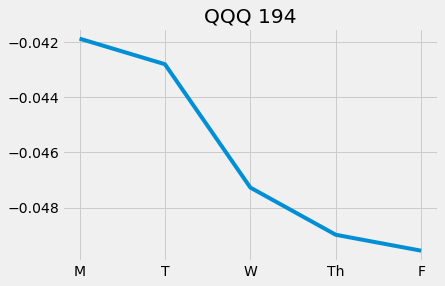

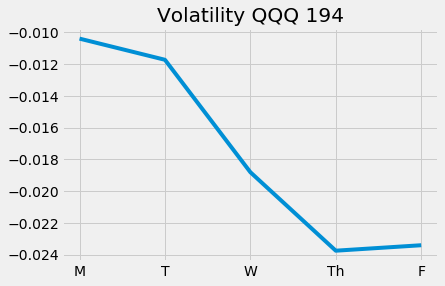

Epoch 196/5000
628/628 [==============================] - 1s 2ms/step - loss: 0.9980 - val_loss: 1.2937


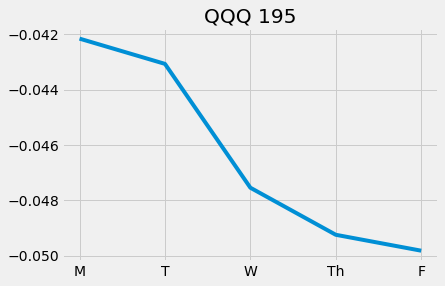

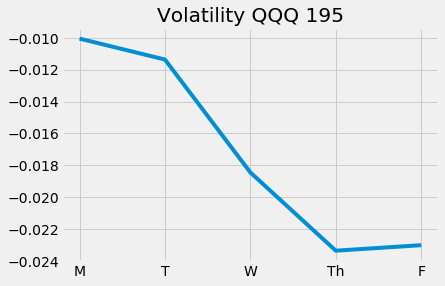

Epoch 197/5000
628/628 [==============================] - 1s 2ms/step - loss: 1.0022 - val_loss: 1.2938


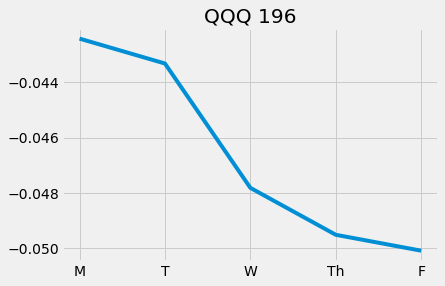

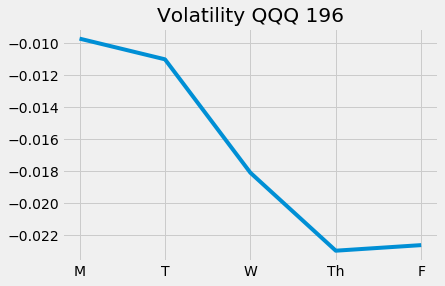

Epoch 198/5000
628/628 [==============================] - 2s 2ms/step - loss: 1.0028 - val_loss: 1.2912


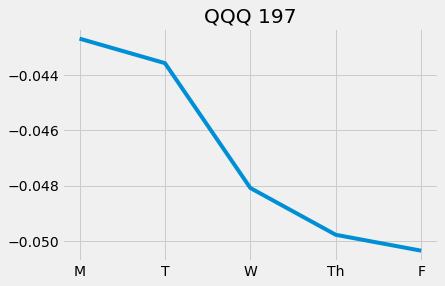

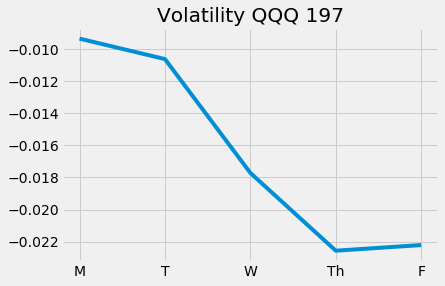

Epoch 199/5000
628/628 [==============================] - 1s 2ms/step - loss: 1.0002 - val_loss: 1.2876


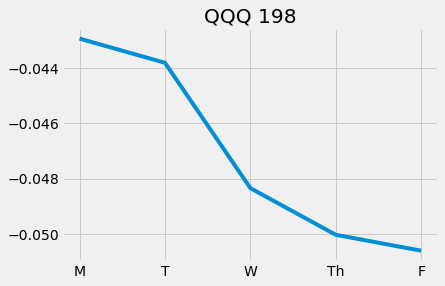

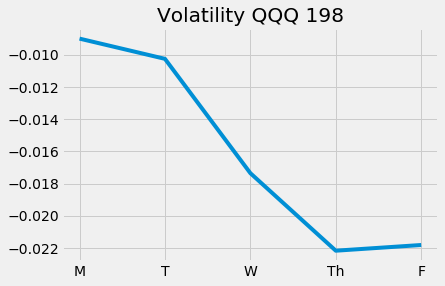

Epoch 200/5000
628/628 [==============================] - 2s 2ms/step - loss: 0.9988 - val_loss: 1.2835


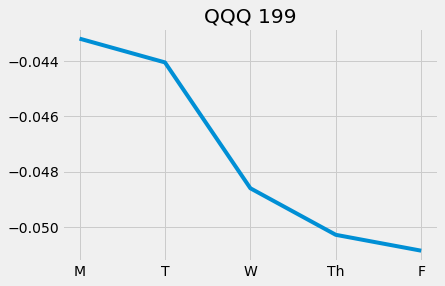

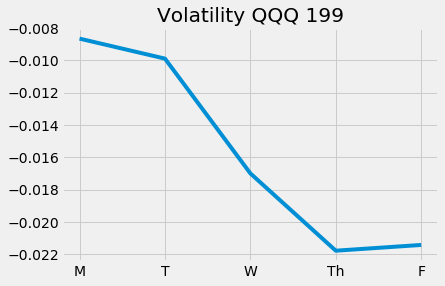

Epoch 201/5000
628/628 [==============================] - 1s 2ms/step - loss: 1.0070 - val_loss: 1.2766


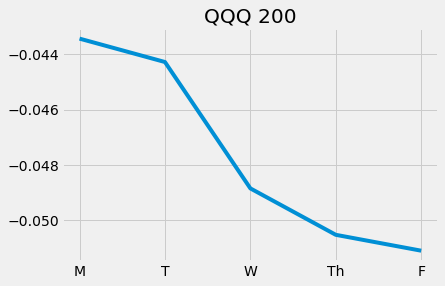

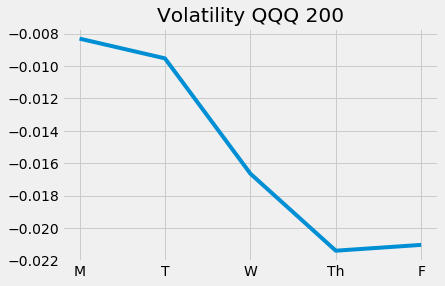

Epoch 202/5000
628/628 [==============================] - 1s 2ms/step - loss: 1.0023 - val_loss: 1.2695


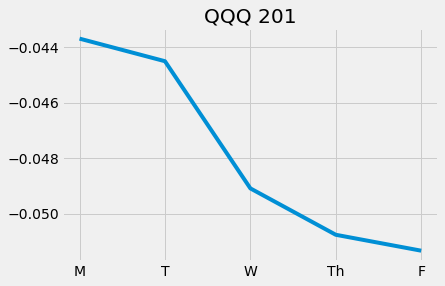

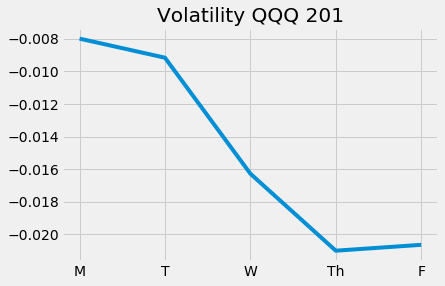

Epoch 203/5000
628/628 [==============================] - 1s 2ms/step - loss: 1.0033 - val_loss: 1.2644


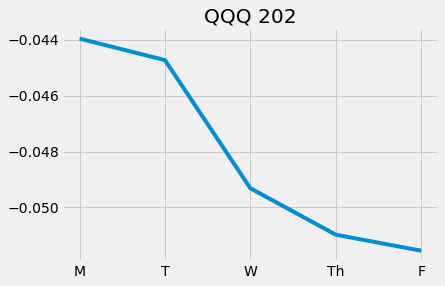

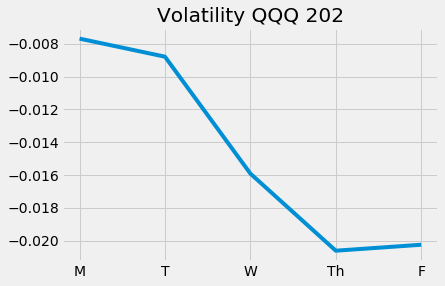

Epoch 204/5000
628/628 [==============================] - 2s 2ms/step - loss: 0.9985 - val_loss: 1.2627


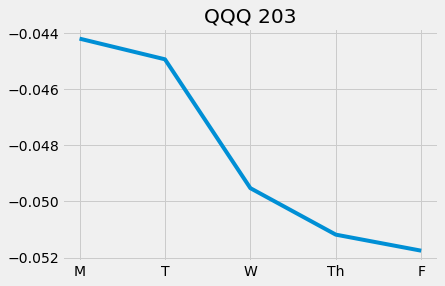

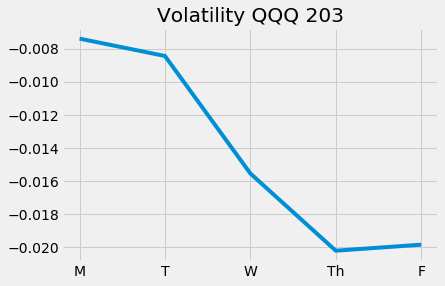

Epoch 205/5000
628/628 [==============================] - 2s 3ms/step - loss: 0.9967 - val_loss: 1.2594

Epoch 00205: ReduceLROnPlateau reducing learning rate to 1.5625000742147677e-05.


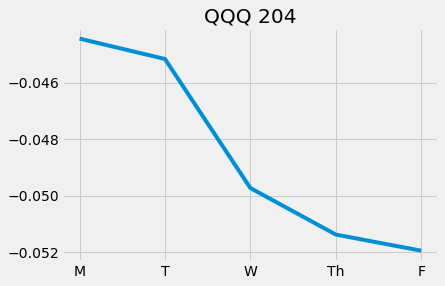

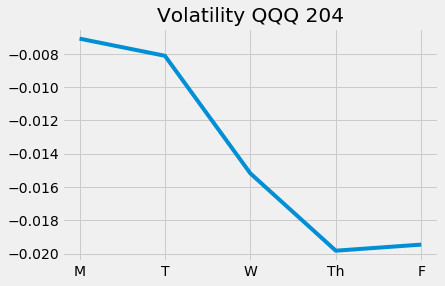

Epoch 206/5000
628/628 [==============================] - 1s 2ms/step - loss: 1.0072 - val_loss: 1.2614


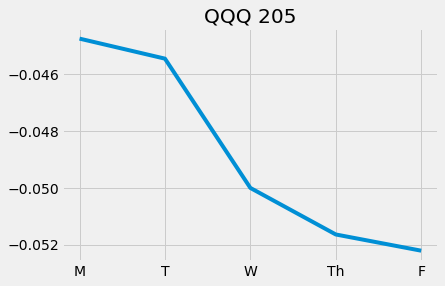

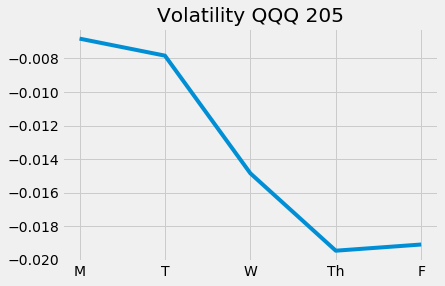

Epoch 207/5000
628/628 [==============================] - 1s 2ms/step - loss: 1.0042 - val_loss: 1.2648


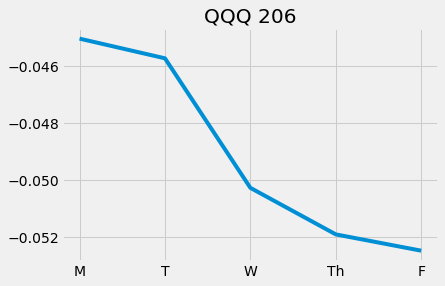

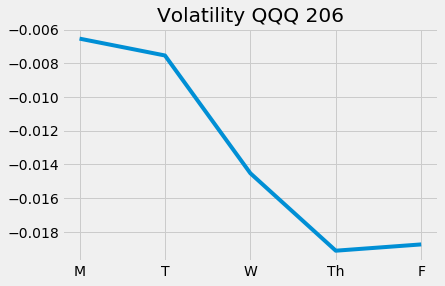

Epoch 208/5000
628/628 [==============================] - 2s 3ms/step - loss: 1.0029 - val_loss: 1.2675


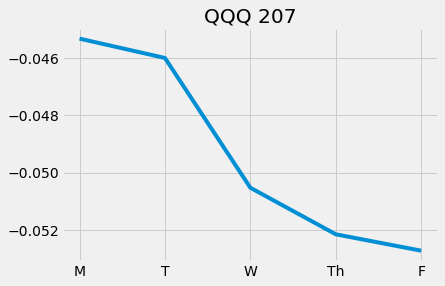

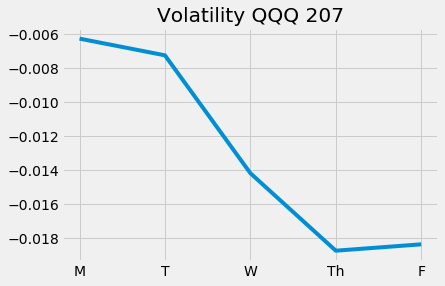

Epoch 209/5000
628/628 [==============================] - 2s 2ms/step - loss: 0.9996 - val_loss: 1.2688


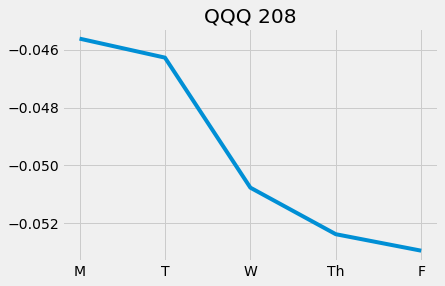

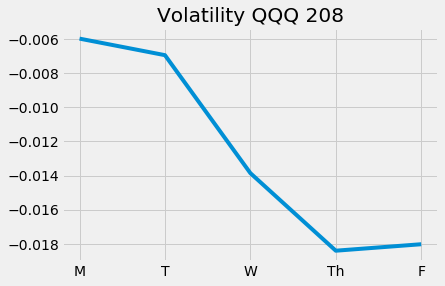

Epoch 210/5000
628/628 [==============================] - 1s 2ms/step - loss: 0.9939 - val_loss: 1.2699


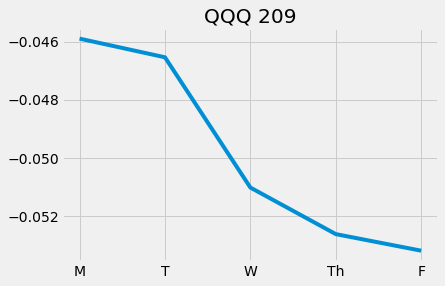

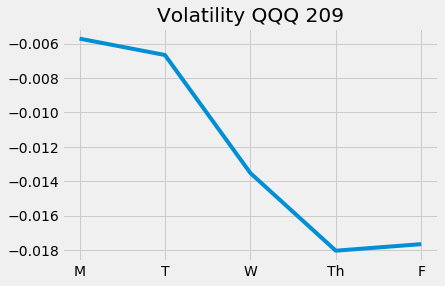

Epoch 211/5000
628/628 [==============================] - 2s 3ms/step - loss: 0.9978 - val_loss: 1.2710


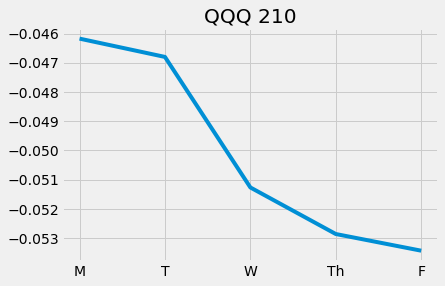

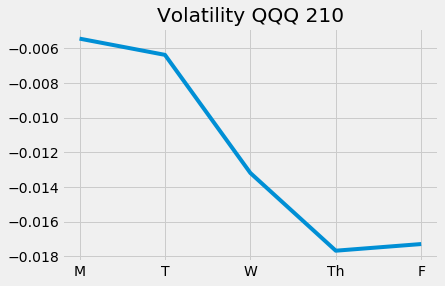

Epoch 212/5000
628/628 [==============================] - 1s 2ms/step - loss: 0.9933 - val_loss: 1.2731


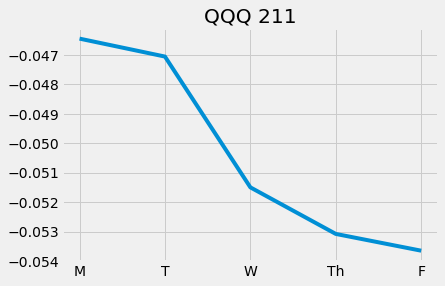

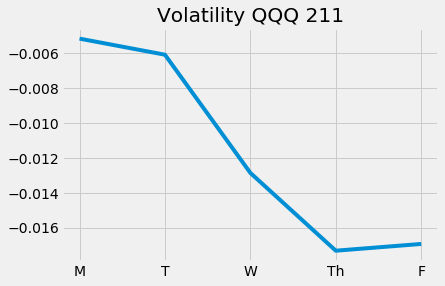

Epoch 213/5000
628/628 [==============================] - 1s 2ms/step - loss: 0.9950 - val_loss: 1.2750


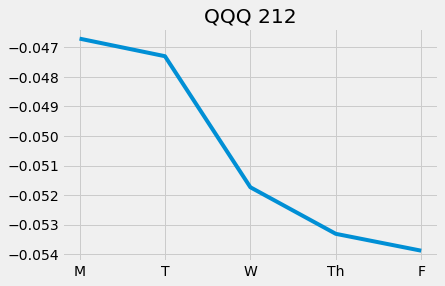

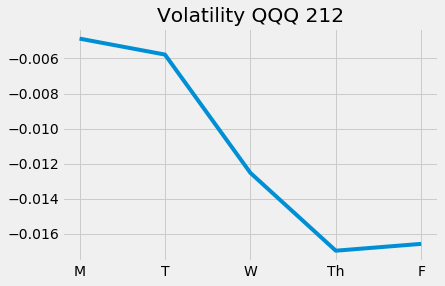

Epoch 214/5000
628/628 [==============================] - 1s 2ms/step - loss: 0.9975 - val_loss: 1.2762


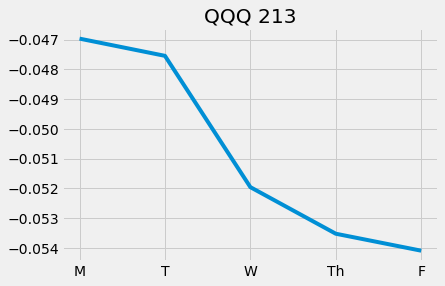

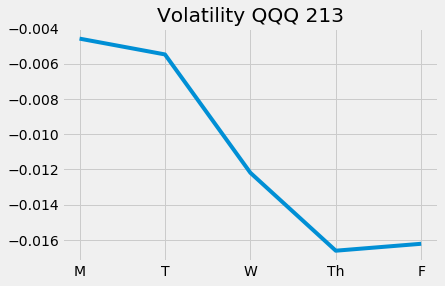

Epoch 215/5000
628/628 [==============================] - 2s 3ms/step - loss: 1.0040 - val_loss: 1.2731


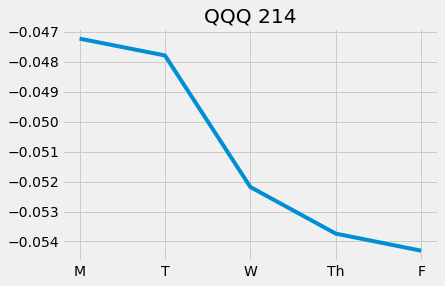

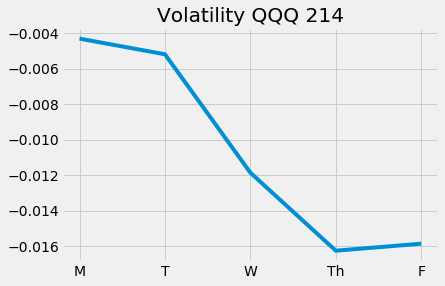

Epoch 216/5000
628/628 [==============================] - 2s 2ms/step - loss: 0.9980 - val_loss: 1.2652


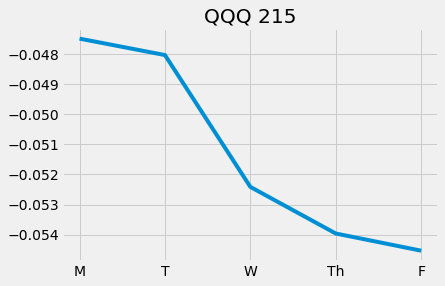

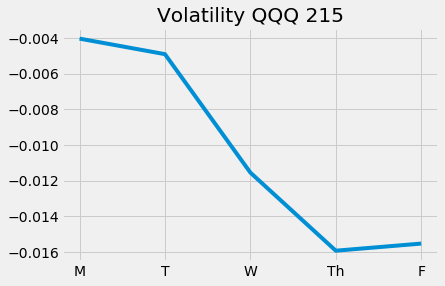

Epoch 217/5000
628/628 [==============================] - 1s 2ms/step - loss: 0.9960 - val_loss: 1.2563


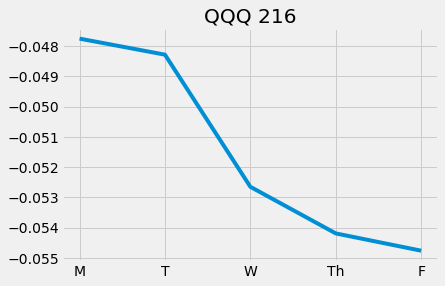

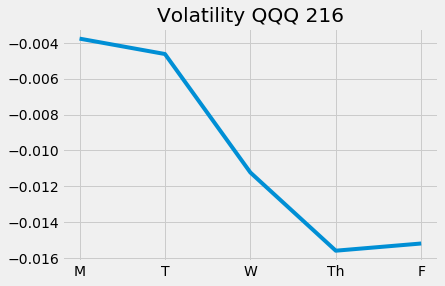

Epoch 218/5000
628/628 [==============================] - 2s 3ms/step - loss: 0.9998 - val_loss: 1.2500


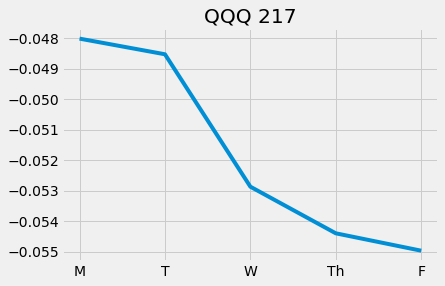

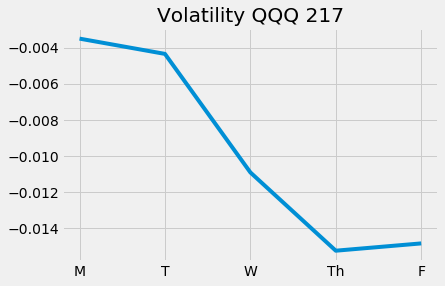

Epoch 219/5000
628/628 [==============================] - 1s 2ms/step - loss: 1.0005 - val_loss: 1.2438


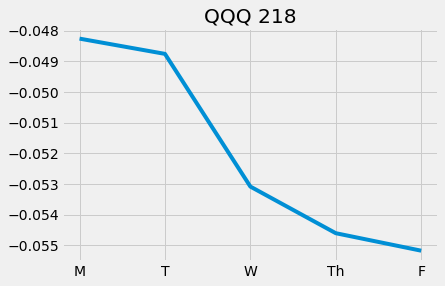

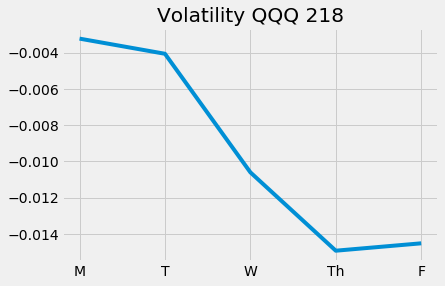

Epoch 220/5000
628/628 [==============================] - 1s 2ms/step - loss: 1.0026 - val_loss: 1.2400

Epoch 00220: ReduceLROnPlateau reducing learning rate to 7.812500371073838e-06.


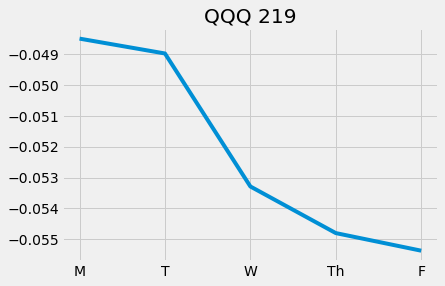

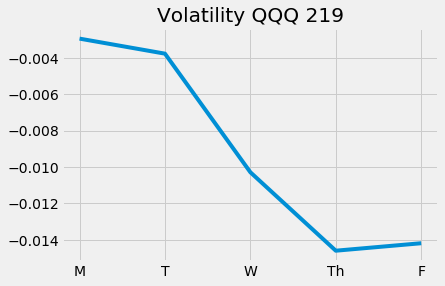

Epoch 221/5000
628/628 [==============================] - 1s 2ms/step - loss: 0.9926 - val_loss: 1.2393


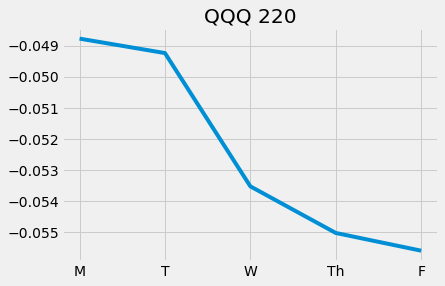

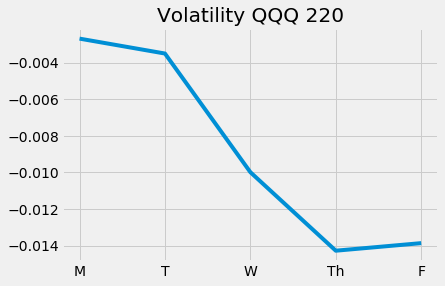

Epoch 222/5000
628/628 [==============================] - 1s 2ms/step - loss: 0.9958 - val_loss: 1.2382


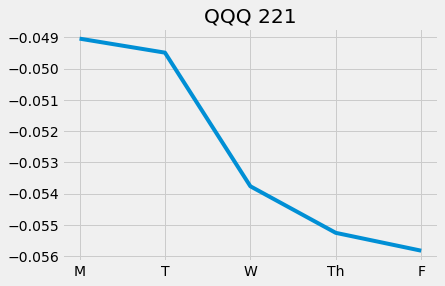

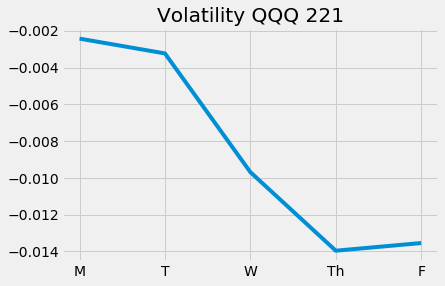

Epoch 223/5000
628/628 [==============================] - 1s 2ms/step - loss: 1.0023 - val_loss: 1.2383


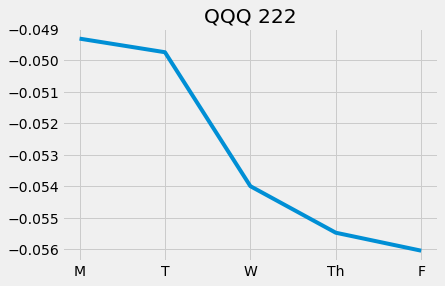

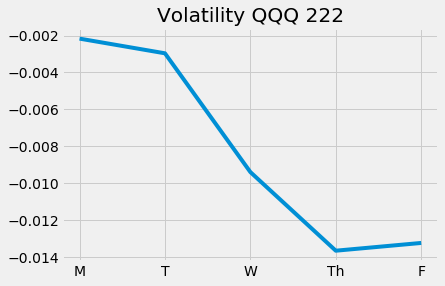

Epoch 224/5000
628/628 [==============================] - 1s 2ms/step - loss: 1.0009 - val_loss: 1.2400


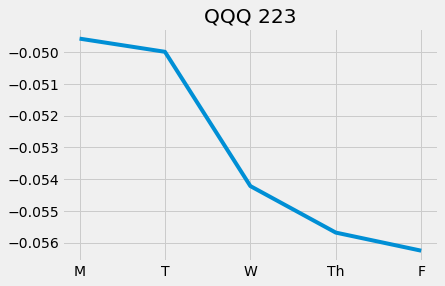

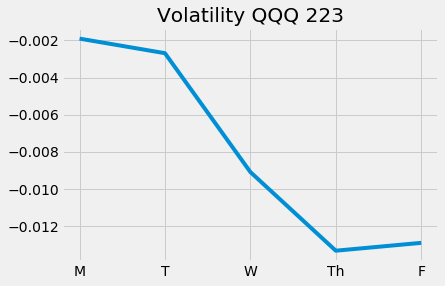

Epoch 225/5000
628/628 [==============================] - 1s 2ms/step - loss: 0.9998 - val_loss: 1.2424


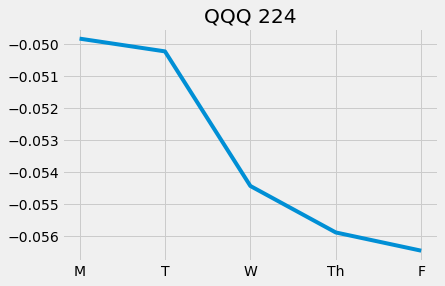

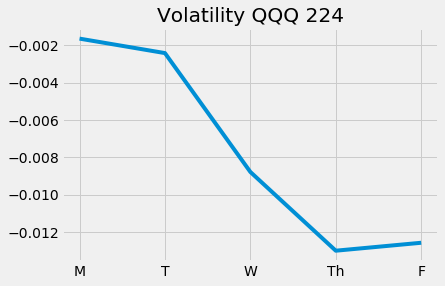

Epoch 226/5000
628/628 [==============================] - 1s 2ms/step - loss: 0.9963 - val_loss: 1.2466


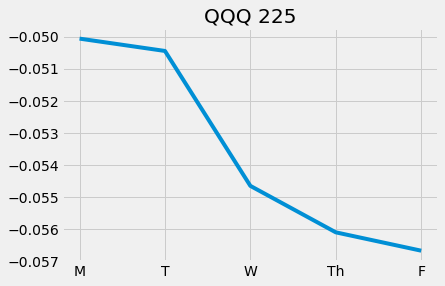

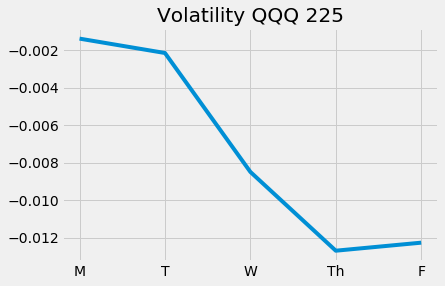

Epoch 227/5000
628/628 [==============================] - 1s 2ms/step - loss: 1.0014 - val_loss: 1.2510


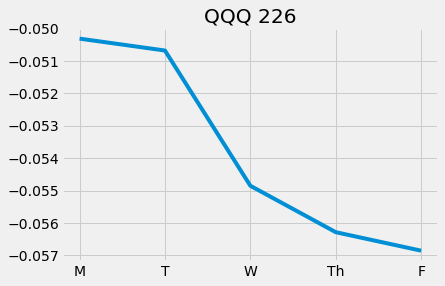

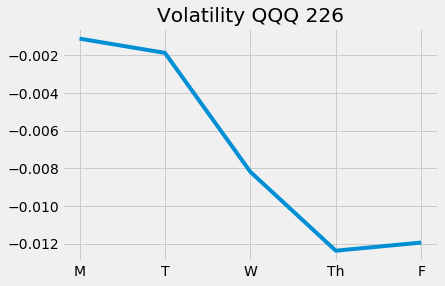

Epoch 228/5000
628/628 [==============================] - 1s 2ms/step - loss: 0.9973 - val_loss: 1.2540


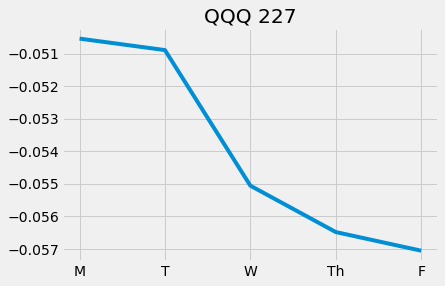

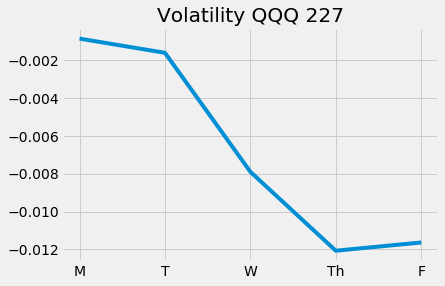

Epoch 229/5000
628/628 [==============================] - 1s 2ms/step - loss: 0.9943 - val_loss: 1.2573


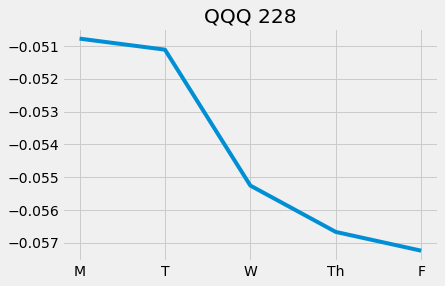

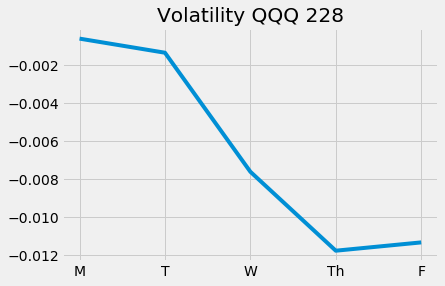

Epoch 230/5000
628/628 [==============================] - 1s 2ms/step - loss: 0.9969 - val_loss: 1.2591


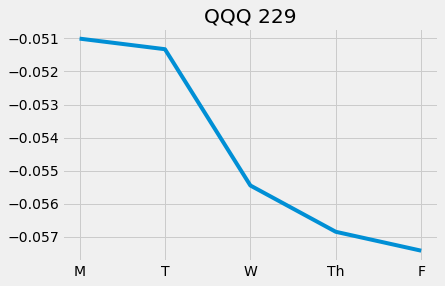

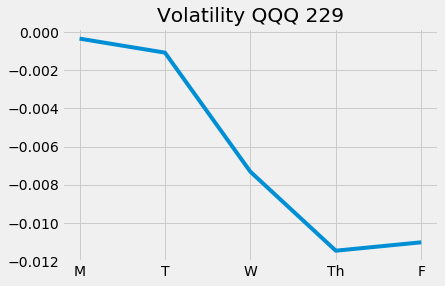

Epoch 231/5000
628/628 [==============================] - 1s 2ms/step - loss: 0.9993 - val_loss: 1.2590


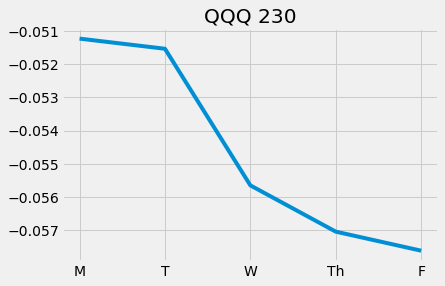

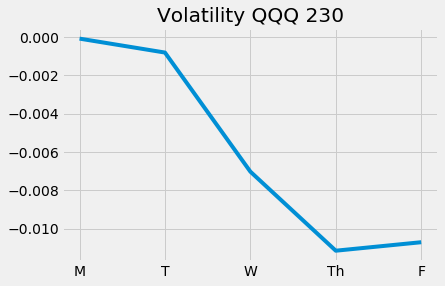

Epoch 232/5000
628/628 [==============================] - 1s 2ms/step - loss: 0.9940 - val_loss: 1.2575


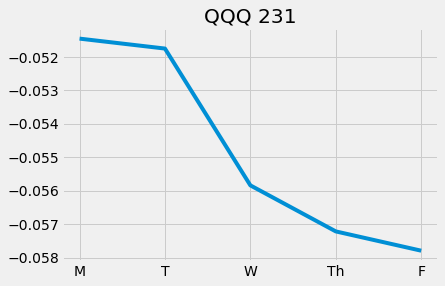

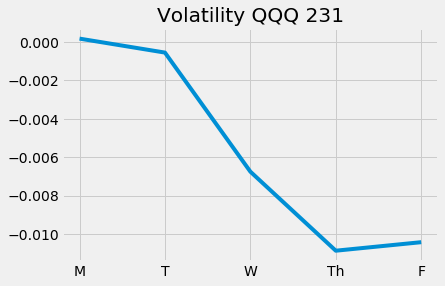

Epoch 233/5000
628/628 [==============================] - 1s 2ms/step - loss: 0.9969 - val_loss: 1.2556


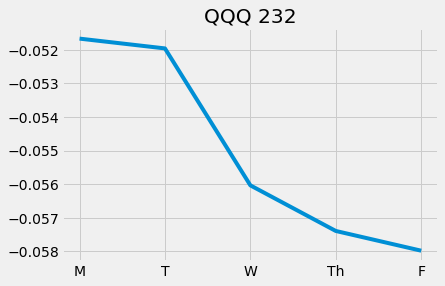

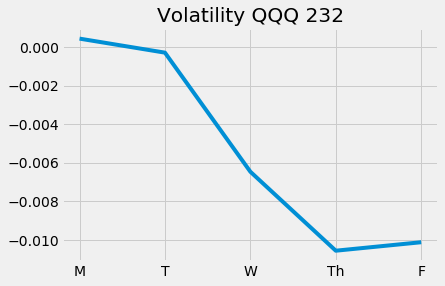

Epoch 234/5000
628/628 [==============================] - 1s 2ms/step - loss: 0.9992 - val_loss: 1.2537


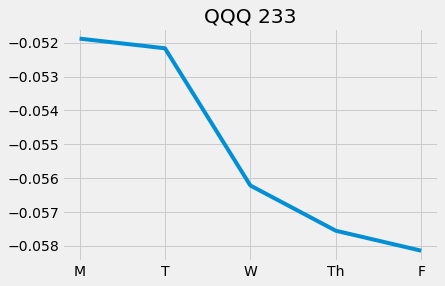

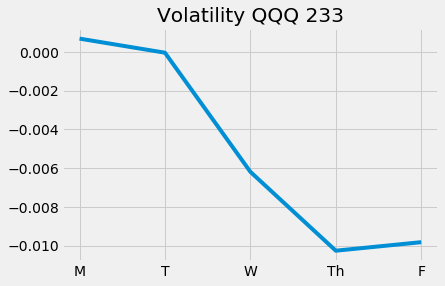

Epoch 235/5000
628/628 [==============================] - 1s 2ms/step - loss: 0.9998 - val_loss: 1.2522

Epoch 00235: ReduceLROnPlateau reducing learning rate to 3.906250185536919e-06.


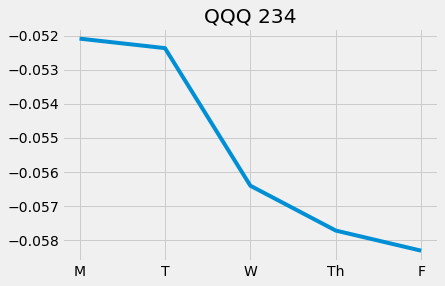

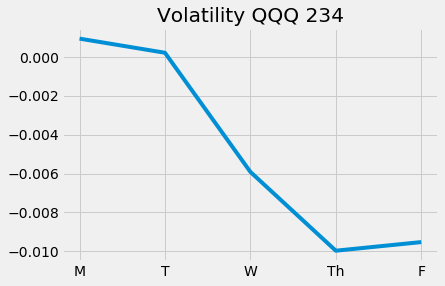

Epoch 236/5000
628/628 [==============================] - 1s 2ms/step - loss: 0.9968 - val_loss: 1.2503

Epoch 00236: ReduceLROnPlateau reducing learning rate to 1.9531250927684596e-06.


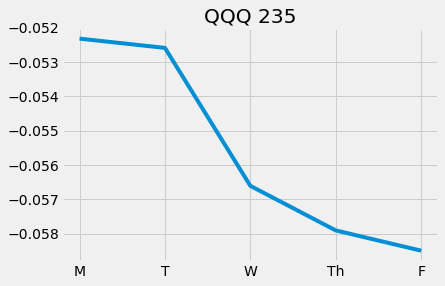

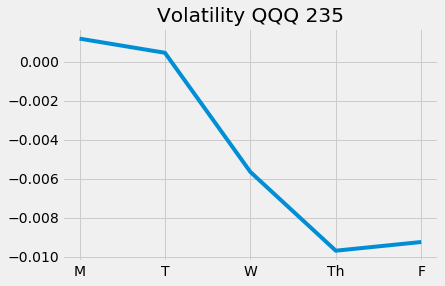

Epoch 237/5000
628/628 [==============================] - 1s 2ms/step - loss: 0.9934 - val_loss: 1.2479


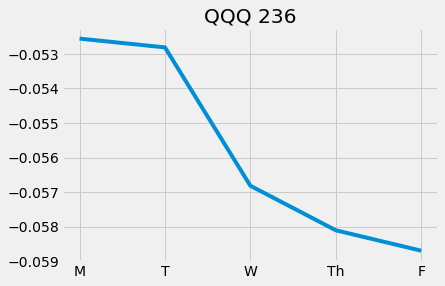

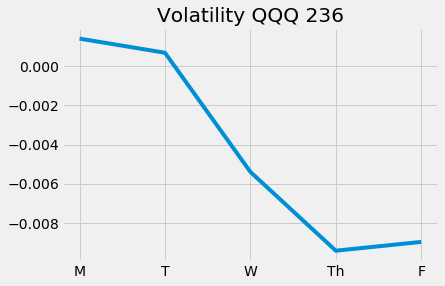

Epoch 238/5000
628/628 [==============================] - 1s 2ms/step - loss: 0.9976 - val_loss: 1.2454


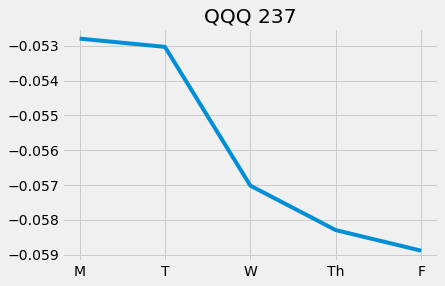

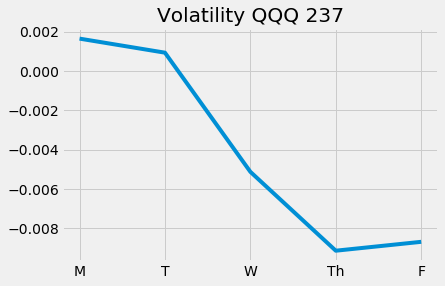

Epoch 239/5000
628/628 [==============================] - 1s 2ms/step - loss: 0.9980 - val_loss: 1.2429


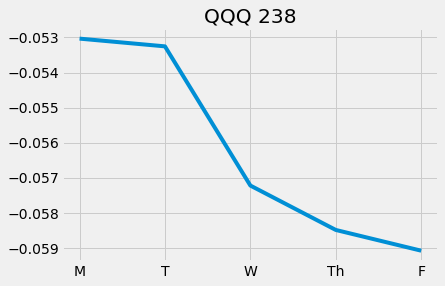

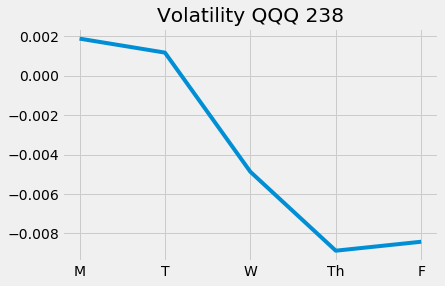

Epoch 240/5000
628/628 [==============================] - 1s 2ms/step - loss: 1.0006 - val_loss: 1.2407


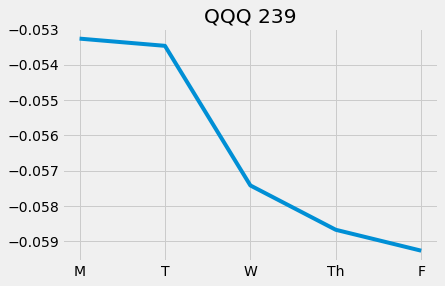

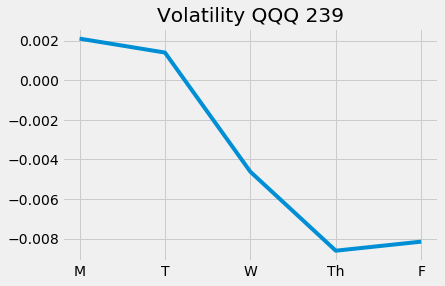

Epoch 241/5000
628/628 [==============================] - 1s 2ms/step - loss: 0.9987 - val_loss: 1.2384


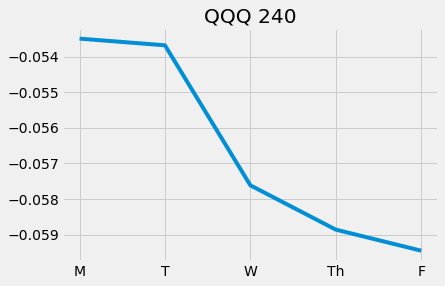

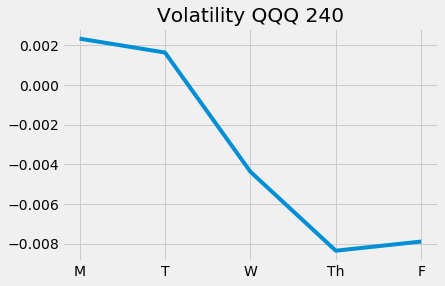

Epoch 242/5000
628/628 [==============================] - 1s 2ms/step - loss: 0.9975 - val_loss: 1.2364


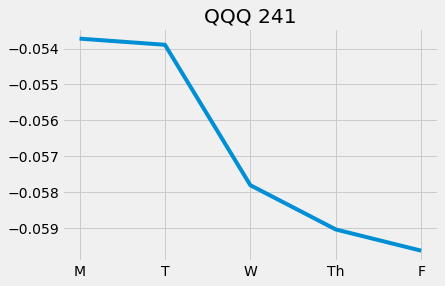

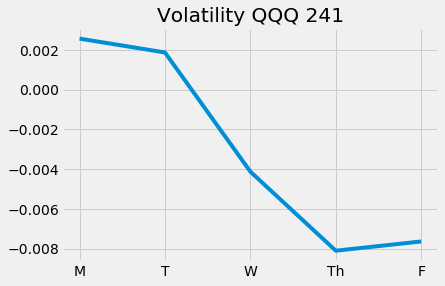

Epoch 243/5000
628/628 [==============================] - 1s 2ms/step - loss: 0.9941 - val_loss: 1.2342


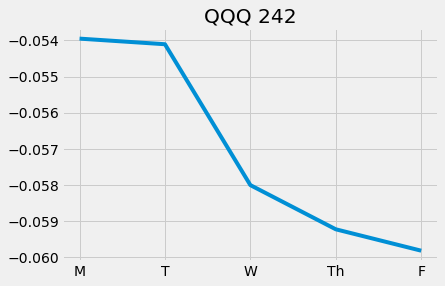

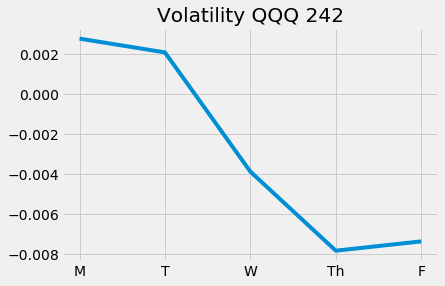

Epoch 244/5000
628/628 [==============================] - 1s 2ms/step - loss: 0.9945 - val_loss: 1.2317


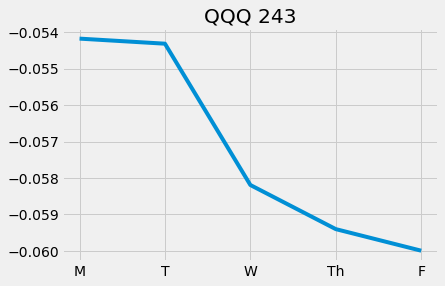

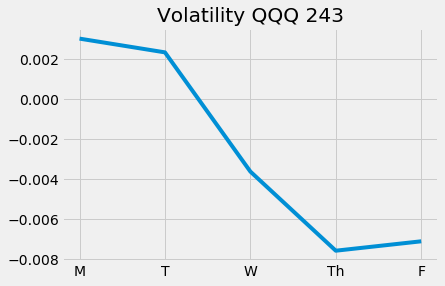

Epoch 245/5000
628/628 [==============================] - 1s 2ms/step - loss: 0.9898 - val_loss: 1.2292


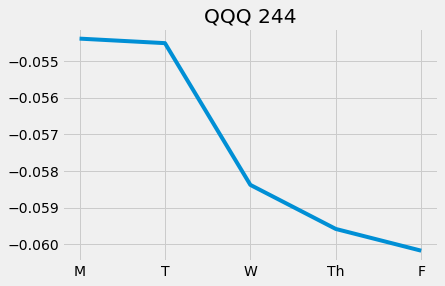

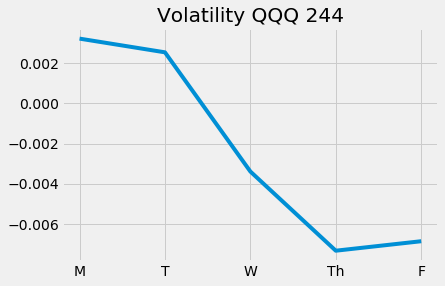

Epoch 246/5000
628/628 [==============================] - 1s 2ms/step - loss: 1.0013 - val_loss: 1.2267


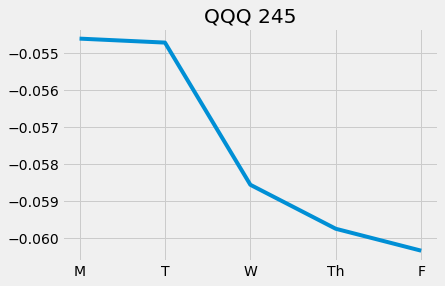

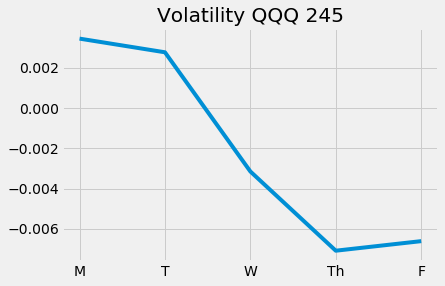

Epoch 247/5000
628/628 [==============================] - 1s 2ms/step - loss: 1.0023 - val_loss: 1.2241


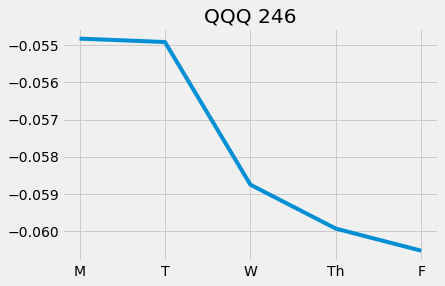

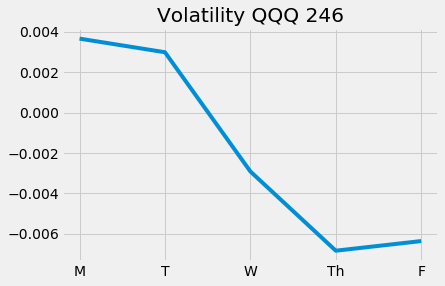

Epoch 248/5000
628/628 [==============================] - 1s 2ms/step - loss: 0.9960 - val_loss: 1.2218


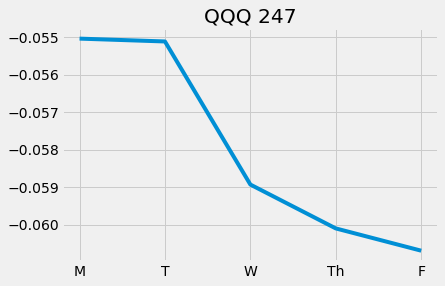

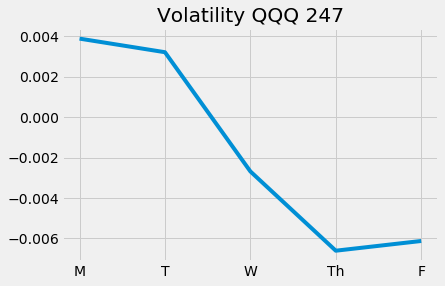

Epoch 249/5000
628/628 [==============================] - 1s 2ms/step - loss: 0.9988 - val_loss: 1.2200


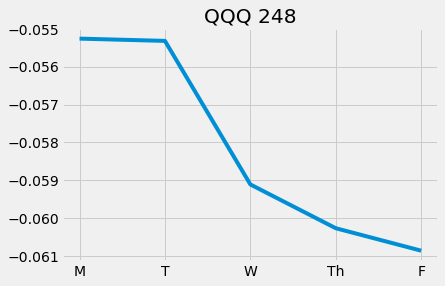

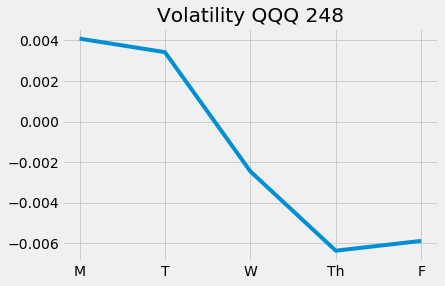

Epoch 250/5000
628/628 [==============================] - 1s 2ms/step - loss: 0.9928 - val_loss: 1.2180

Epoch 00250: ReduceLROnPlateau reducing learning rate to 9.765625463842298e-07.


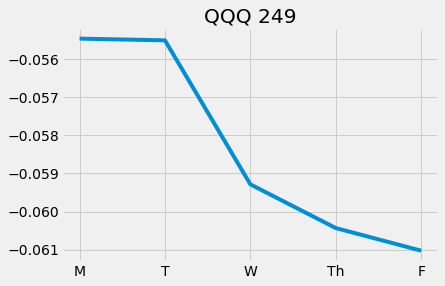

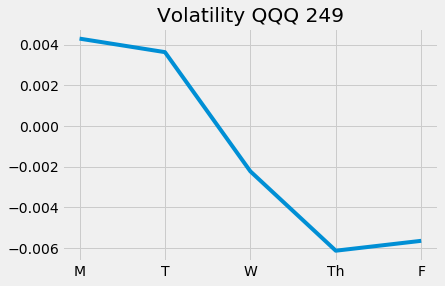

Epoch 251/5000
628/628 [==============================] - 1s 2ms/step - loss: 0.9985 - val_loss: 1.2165


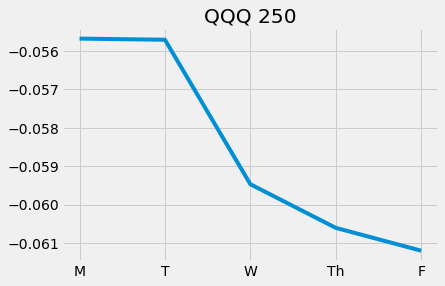

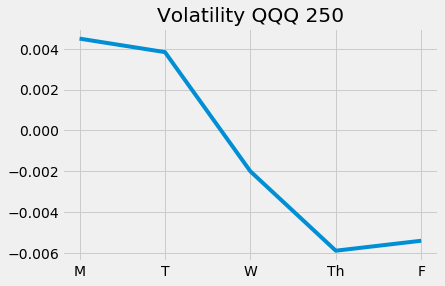

Epoch 252/5000
628/628 [==============================] - 1s 2ms/step - loss: 0.9949 - val_loss: 1.2149


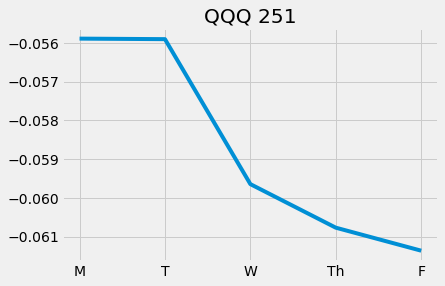

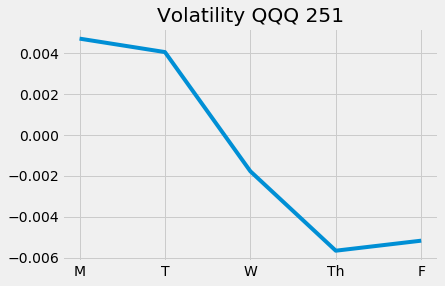

Epoch 253/5000
628/628 [==============================] - 1s 2ms/step - loss: 0.9968 - val_loss: 1.2134


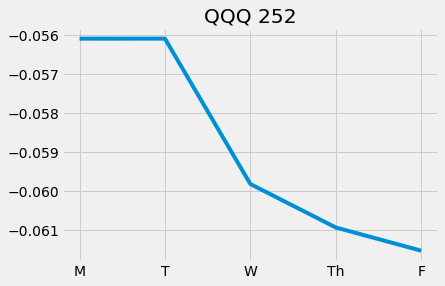

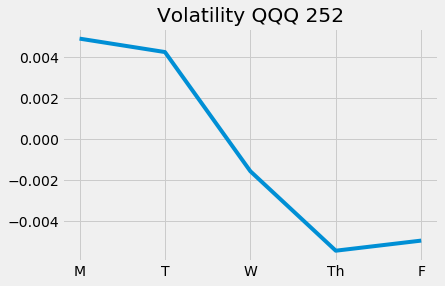

Epoch 254/5000
628/628 [==============================] - 1s 2ms/step - loss: 0.9954 - val_loss: 1.2120


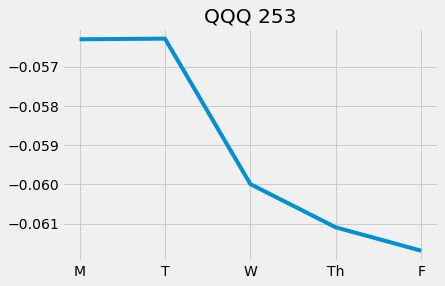

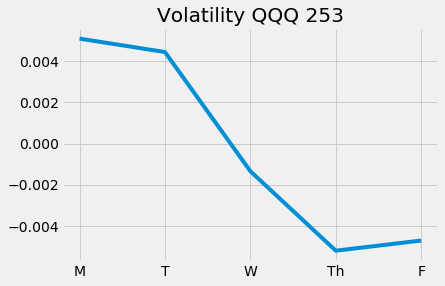

Epoch 255/5000
628/628 [==============================] - 1s 2ms/step - loss: 0.9954 - val_loss: 1.2105


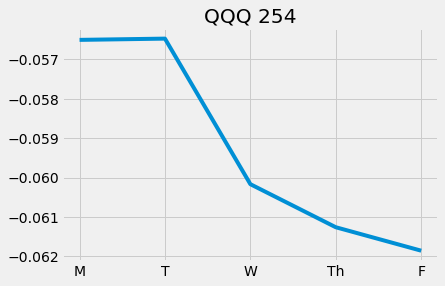

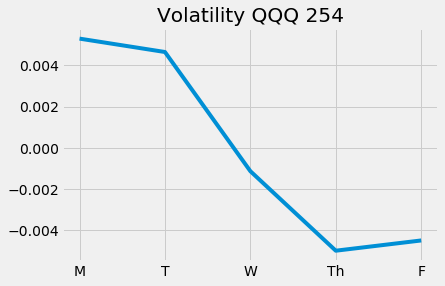

Epoch 256/5000
628/628 [==============================] - 1s 2ms/step - loss: 1.0018 - val_loss: 1.2091


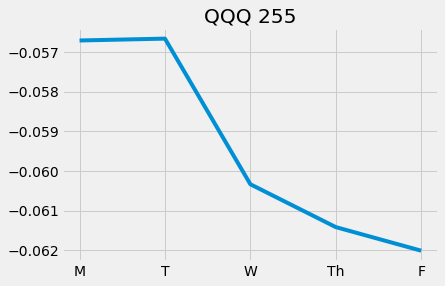

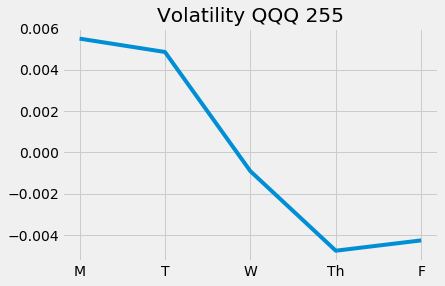

Epoch 257/5000
628/628 [==============================] - 1s 2ms/step - loss: 0.9920 - val_loss: 1.2077


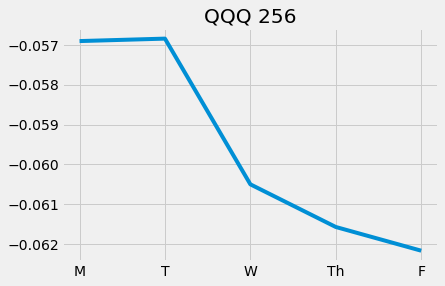

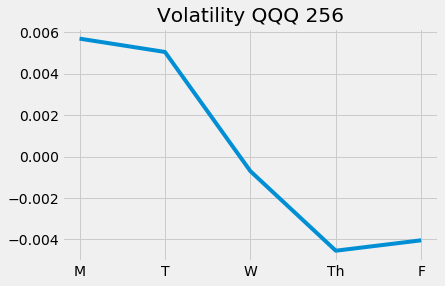

Epoch 258/5000
628/628 [==============================] - 1s 2ms/step - loss: 0.9971 - val_loss: 1.2064


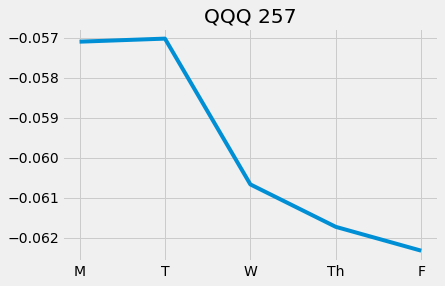

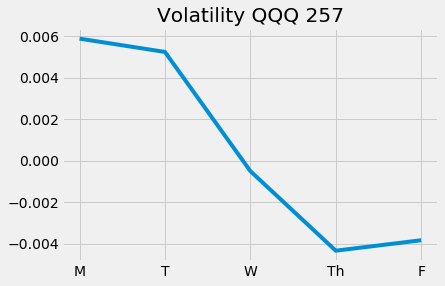

Epoch 259/5000
628/628 [==============================] - 1s 2ms/step - loss: 0.9908 - val_loss: 1.2051


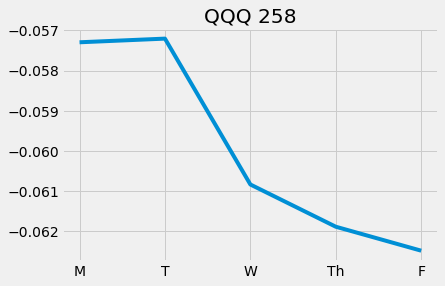

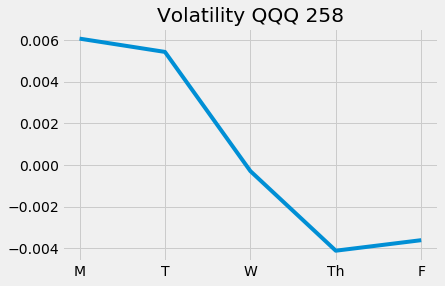

Epoch 260/5000
628/628 [==============================] - 1s 2ms/step - loss: 0.9984 - val_loss: 1.2037

Epoch 00260: ReduceLROnPlateau reducing learning rate to 4.882812731921149e-07.


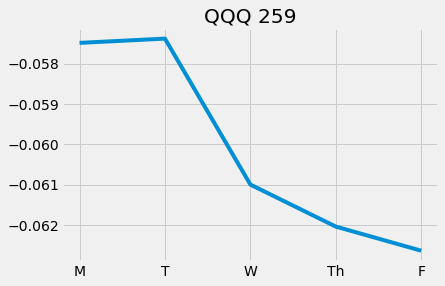

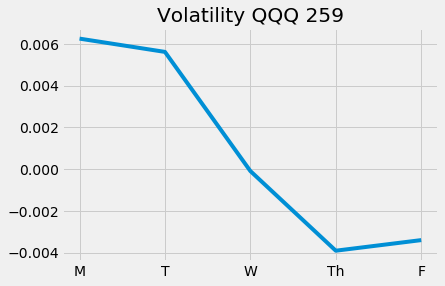

Epoch 261/5000
628/628 [==============================] - 1s 2ms/step - loss: 0.9888 - val_loss: 1.2025


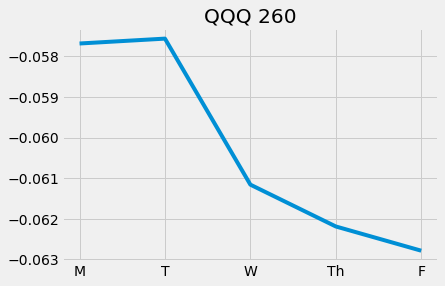

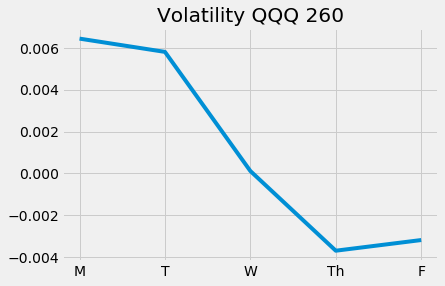

Epoch 262/5000
628/628 [==============================] - 1s 2ms/step - loss: 0.9997 - val_loss: 1.2013


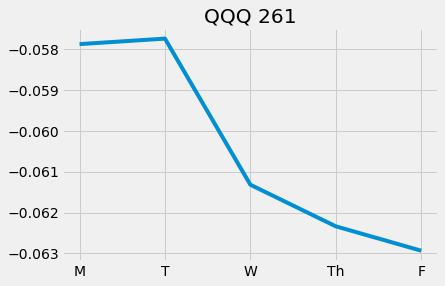

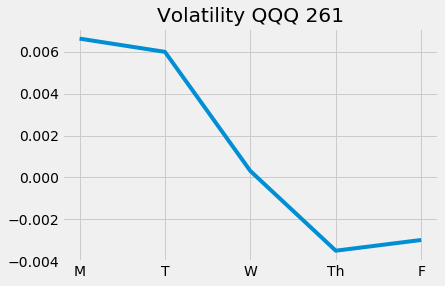

Epoch 263/5000
628/628 [==============================] - 1s 2ms/step - loss: 1.0038 - val_loss: 1.2001


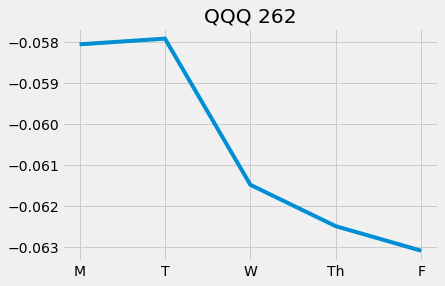

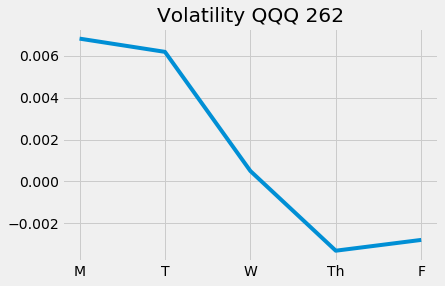

Epoch 264/5000
628/628 [==============================] - 1s 2ms/step - loss: 1.0034 - val_loss: 1.1989


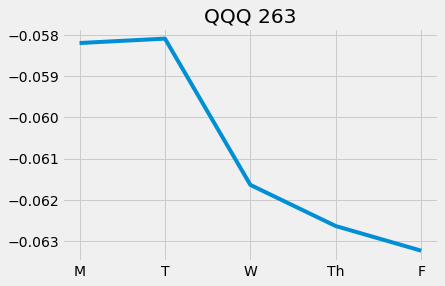

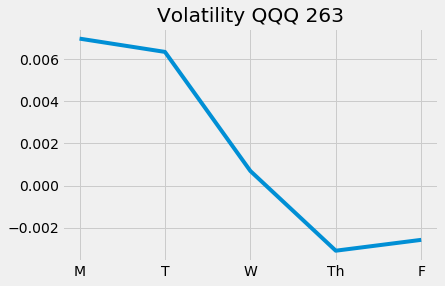

Epoch 265/5000
628/628 [==============================] - 1s 2ms/step - loss: 0.9970 - val_loss: 1.1977

Epoch 00265: ReduceLROnPlateau reducing learning rate to 2.4414063659605745e-07.


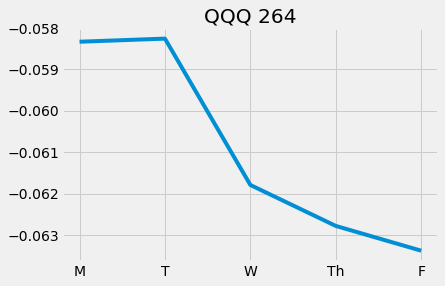

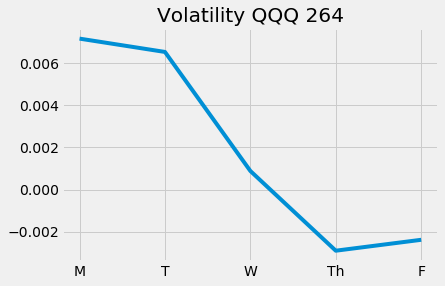

Epoch 266/5000
628/628 [==============================] - 1s 2ms/step - loss: 1.0018 - val_loss: 1.1966


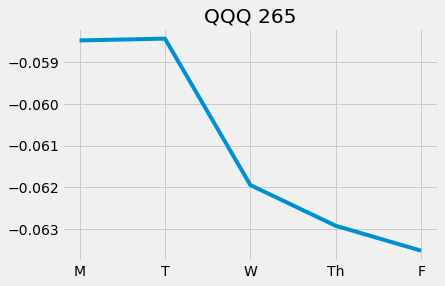

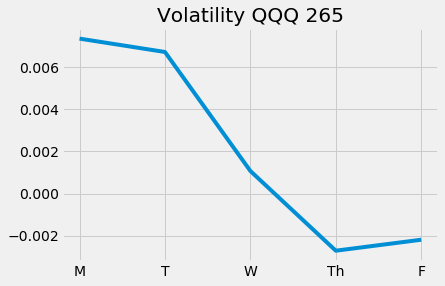

Epoch 267/5000
628/628 [==============================] - 1s 2ms/step - loss: 0.9982 - val_loss: 1.1956


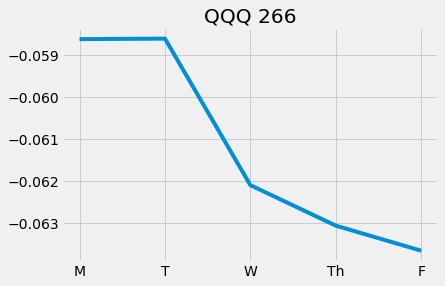

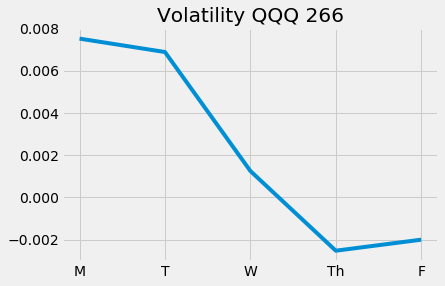

Epoch 268/5000
628/628 [==============================] - 1s 2ms/step - loss: 0.9938 - val_loss: 1.1945


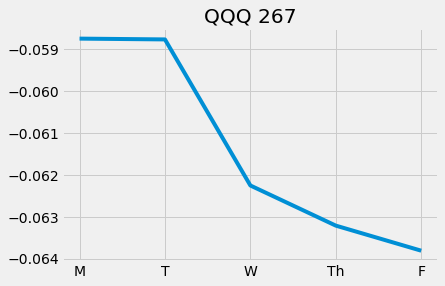

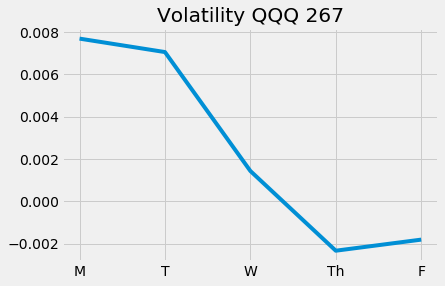

Epoch 269/5000
628/628 [==============================] - 1s 2ms/step - loss: 0.9959 - val_loss: 1.1934


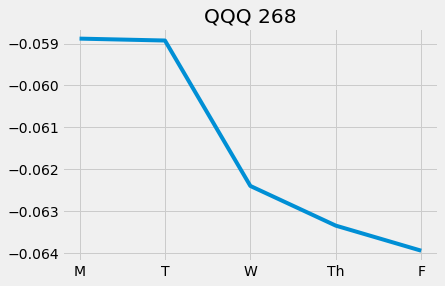

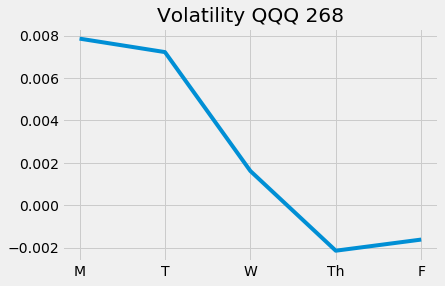

Epoch 270/5000
628/628 [==============================] - 1s 2ms/step - loss: 0.9968 - val_loss: 1.1924


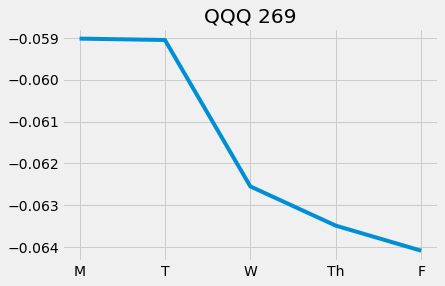

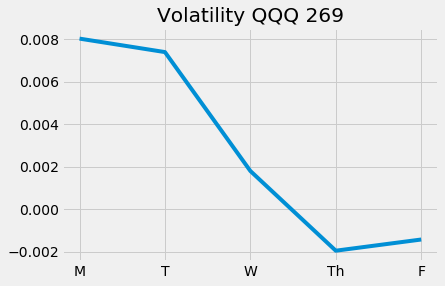

Epoch 271/5000
628/628 [==============================] - 1s 2ms/step - loss: 0.9882 - val_loss: 1.1913


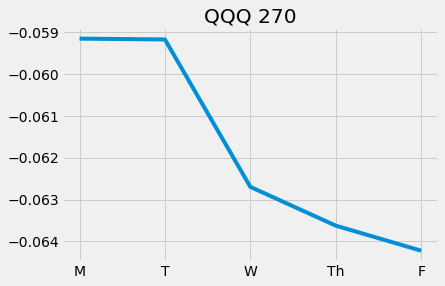

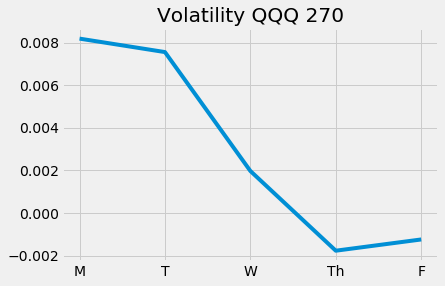

Epoch 272/5000
628/628 [==============================] - 1s 2ms/step - loss: 0.9958 - val_loss: 1.1903


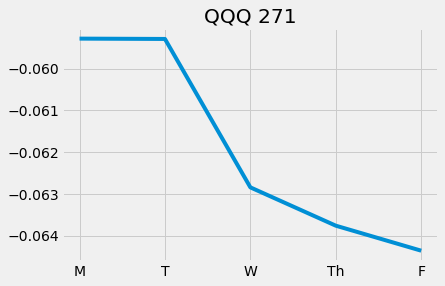

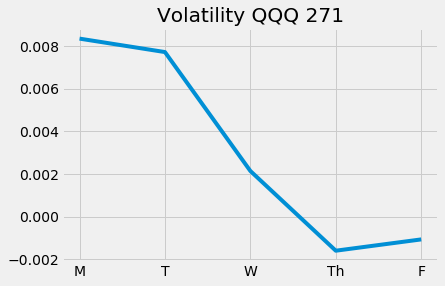

Epoch 273/5000
628/628 [==============================] - 1s 2ms/step - loss: 0.9975 - val_loss: 1.1893


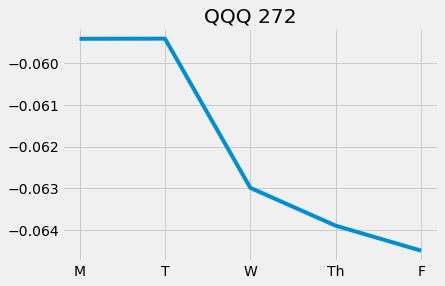

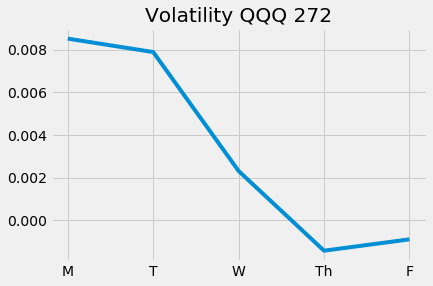

Epoch 274/5000
628/628 [==============================] - 1s 2ms/step - loss: 0.9955 - val_loss: 1.1883


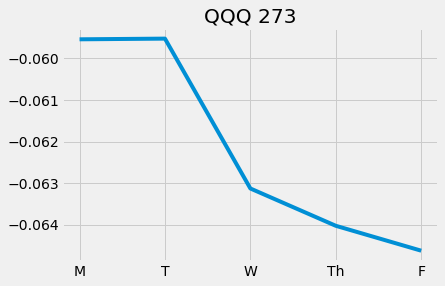

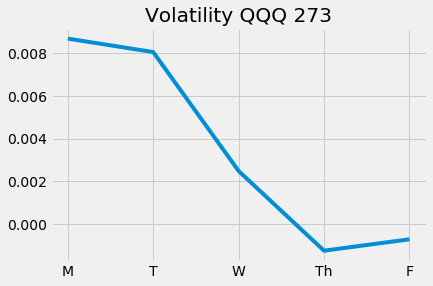

Epoch 275/5000
628/628 [==============================] - 1s 2ms/step - loss: 0.9948 - val_loss: 1.1873


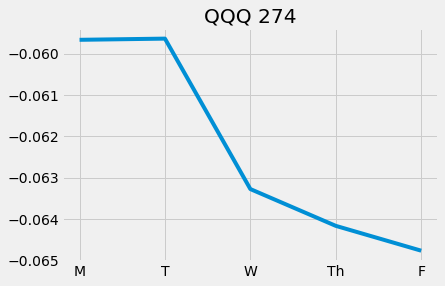

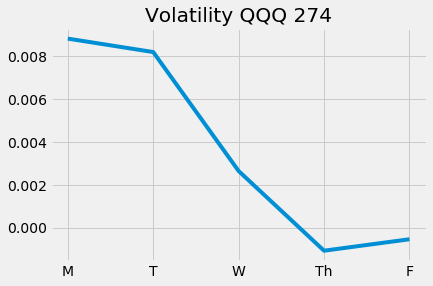

Epoch 276/5000
628/628 [==============================] - 1s 2ms/step - loss: 0.9989 - val_loss: 1.1863


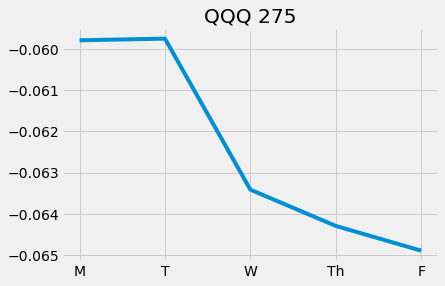

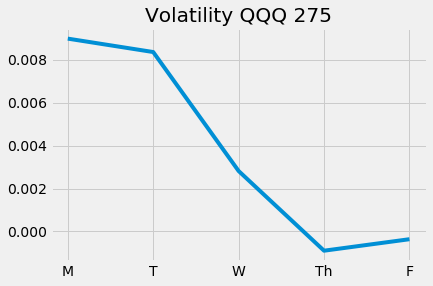

Epoch 277/5000
628/628 [==============================] - 1s 2ms/step - loss: 0.9955 - val_loss: 1.1853


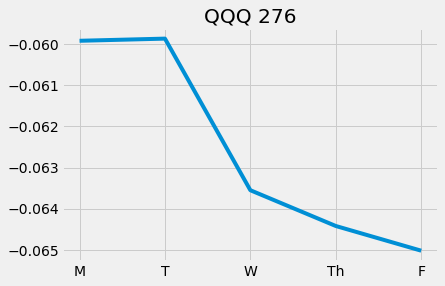

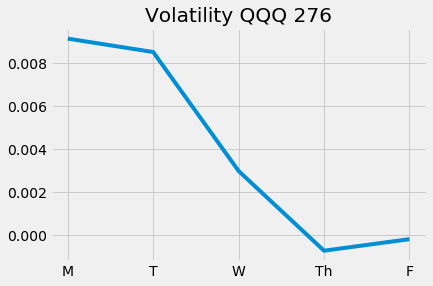

Epoch 278/5000
628/628 [==============================] - 1s 2ms/step - loss: 0.9955 - val_loss: 1.1843


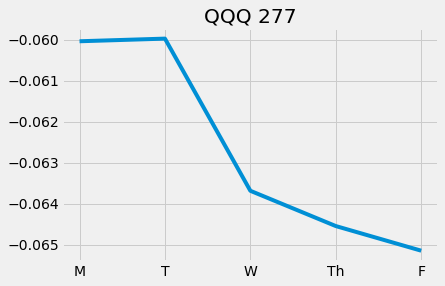

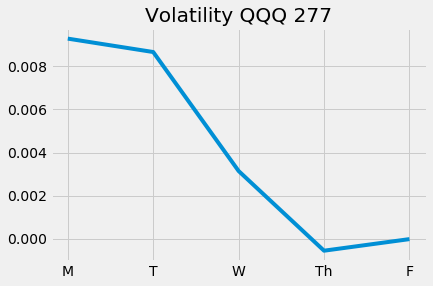

Epoch 279/5000
628/628 [==============================] - 1s 2ms/step - loss: 0.9942 - val_loss: 1.1834


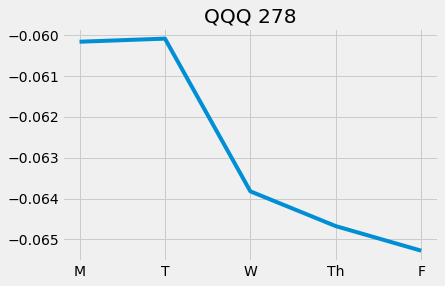

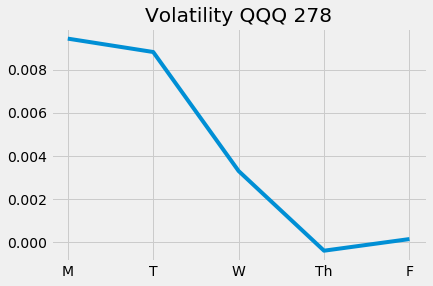

Epoch 280/5000
628/628 [==============================] - 1s 2ms/step - loss: 0.9957 - val_loss: 1.1824

Epoch 00280: ReduceLROnPlateau reducing learning rate to 1.2207031829802872e-07.


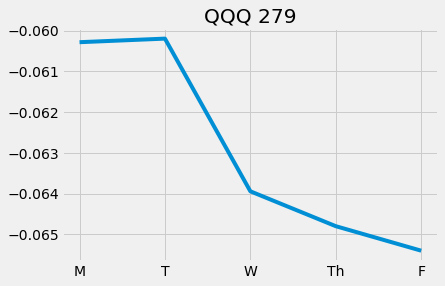

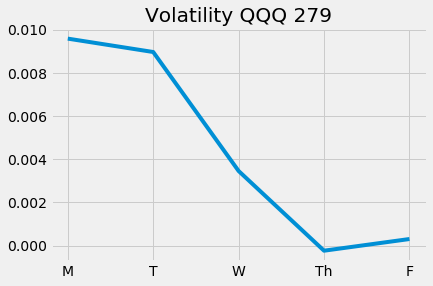

Epoch 281/5000
628/628 [==============================] - 1s 2ms/step - loss: 0.9972 - val_loss: 1.1815


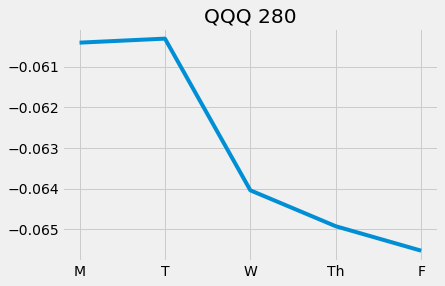

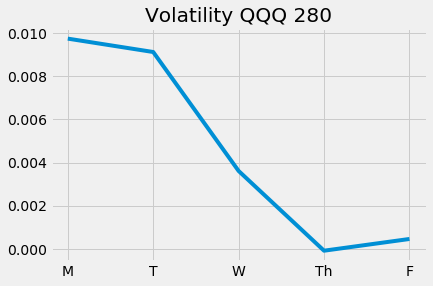

Epoch 282/5000
628/628 [==============================] - 1s 2ms/step - loss: 0.9930 - val_loss: 1.1806


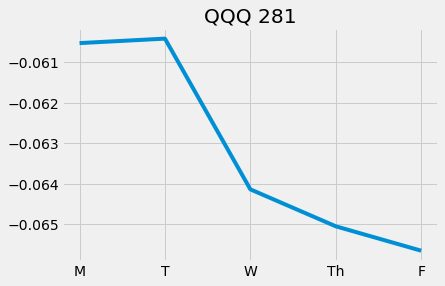

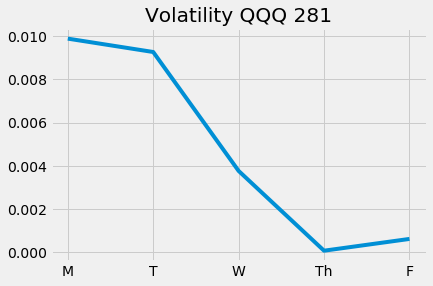

Epoch 283/5000
628/628 [==============================] - 1s 2ms/step - loss: 0.9951 - val_loss: 1.1797


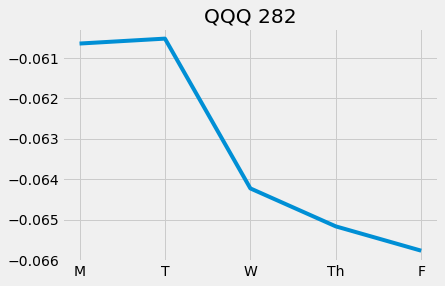

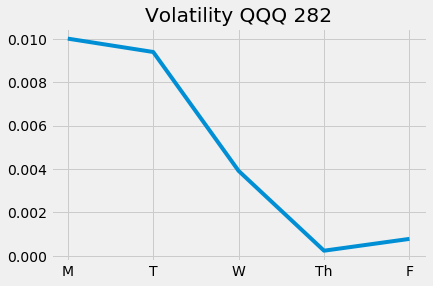

Epoch 284/5000
628/628 [==============================] - 1s 2ms/step - loss: 0.9949 - val_loss: 1.1789


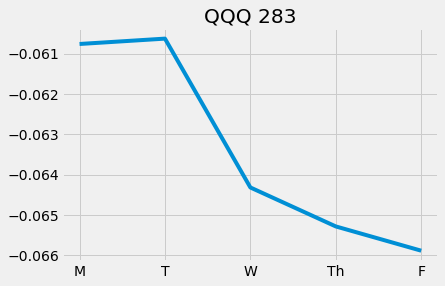

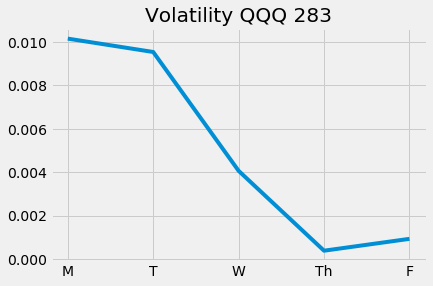

Epoch 285/5000
628/628 [==============================] - 1s 2ms/step - loss: 0.9973 - val_loss: 1.1781


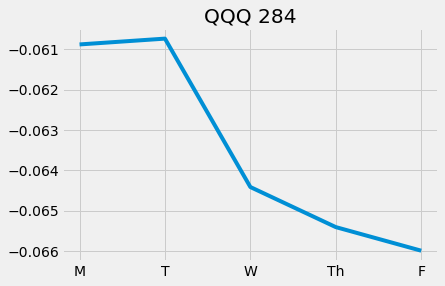

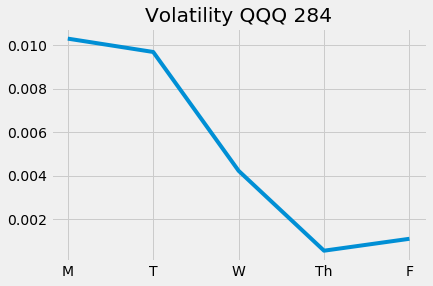

Epoch 286/5000
628/628 [==============================] - 1s 2ms/step - loss: 0.9944 - val_loss: 1.1773

Epoch 00286: ReduceLROnPlateau reducing learning rate to 6.103515914901436e-08.


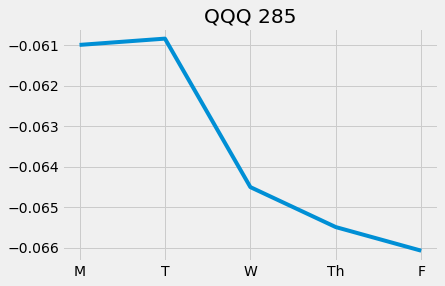

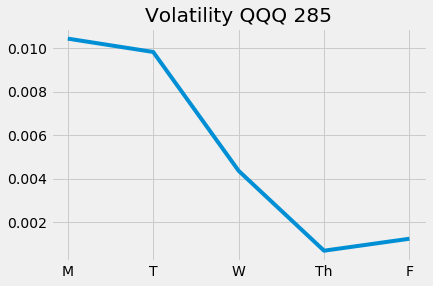

Epoch 287/5000
628/628 [==============================] - 1s 2ms/step - loss: 0.9947 - val_loss: 1.1765


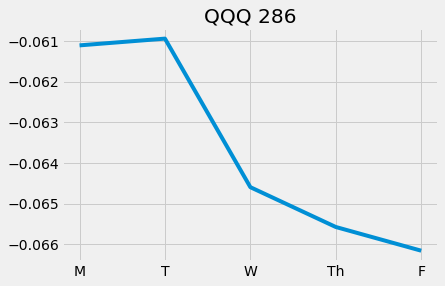

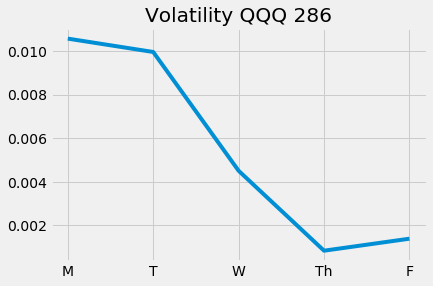

Epoch 288/5000
628/628 [==============================] - 1s 2ms/step - loss: 0.9984 - val_loss: 1.1757


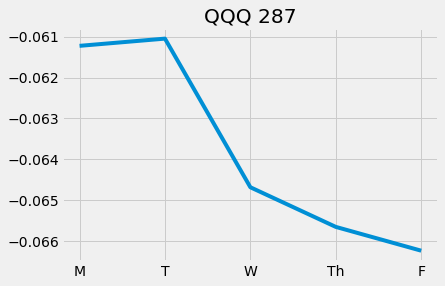

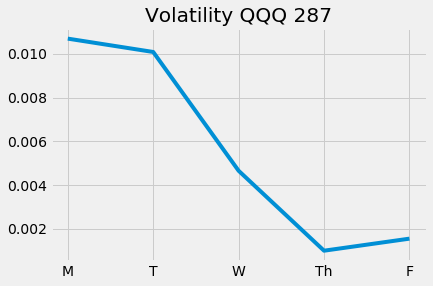

Epoch 289/5000
628/628 [==============================] - 1s 2ms/step - loss: 0.9982 - val_loss: 1.1750


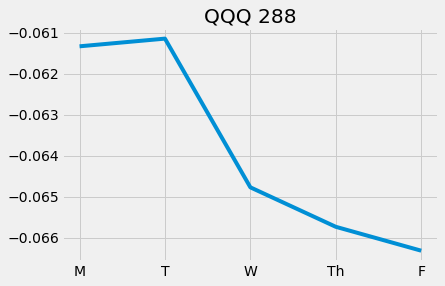

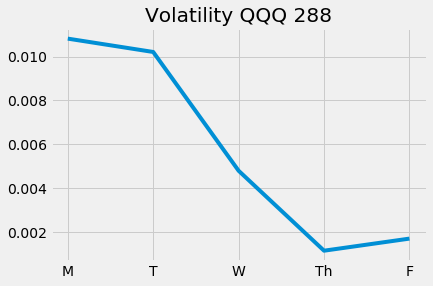

Epoch 290/5000
628/628 [==============================] - 1s 2ms/step - loss: 1.0002 - val_loss: 1.1742


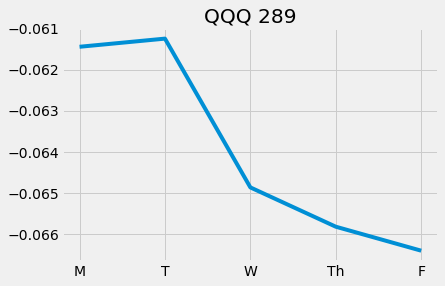

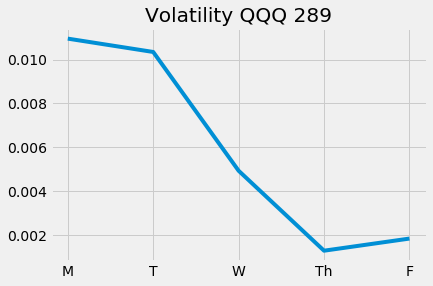

Epoch 291/5000
628/628 [==============================] - 1s 2ms/step - loss: 0.9999 - val_loss: 1.1735


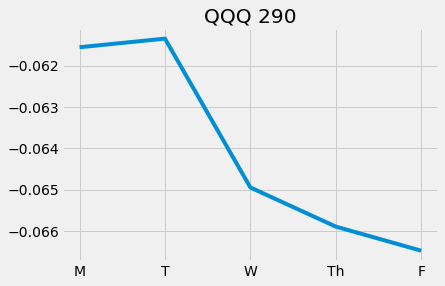

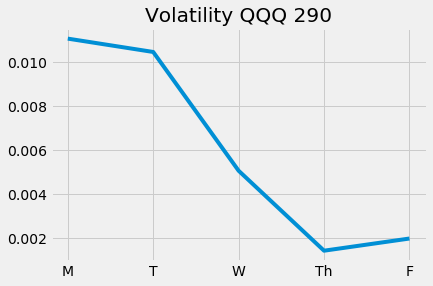

Epoch 292/5000
628/628 [==============================] - 1s 2ms/step - loss: 0.9987 - val_loss: 1.1727


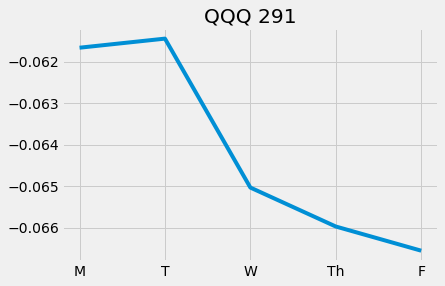

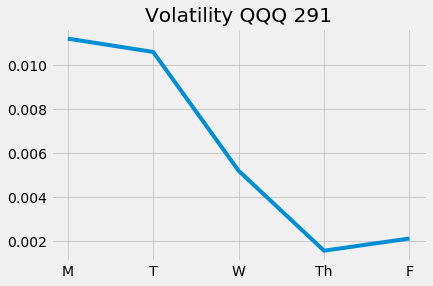

Epoch 293/5000
628/628 [==============================] - 1s 2ms/step - loss: 0.9936 - val_loss: 1.1720


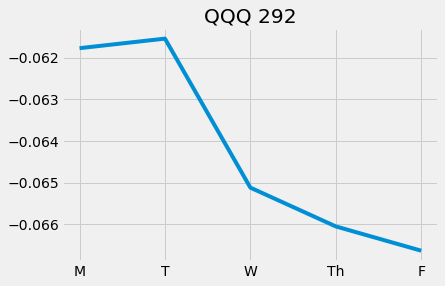

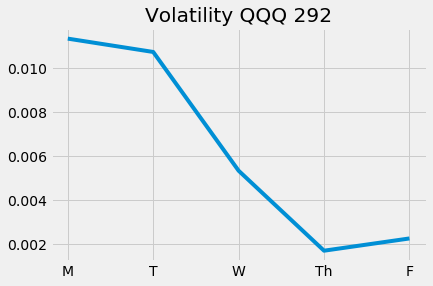

Epoch 294/5000
628/628 [==============================] - 1s 2ms/step - loss: 0.9965 - val_loss: 1.1713


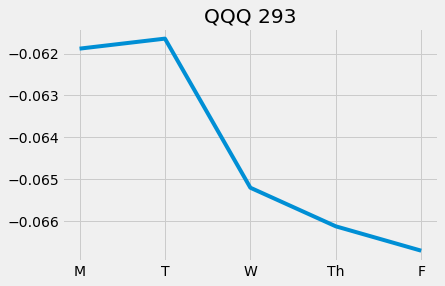

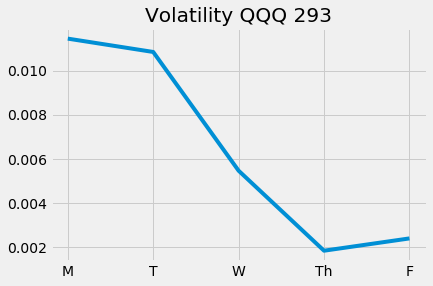

Epoch 295/5000
628/628 [==============================] - 1s 2ms/step - loss: 0.9930 - val_loss: 1.1706

Epoch 00295: ReduceLROnPlateau reducing learning rate to 3.051757957450718e-08.


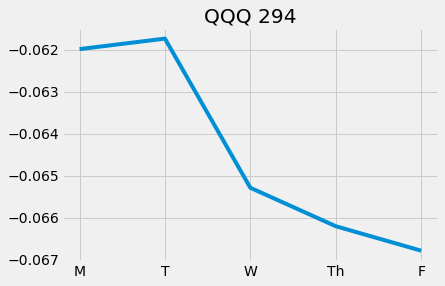

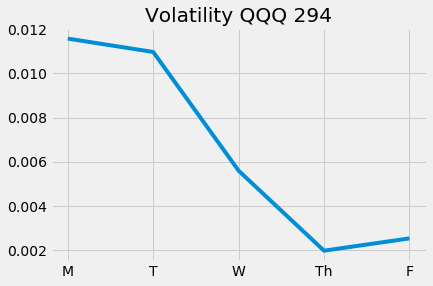

Epoch 296/5000
628/628 [==============================] - 1s 2ms/step - loss: 0.9953 - val_loss: 1.1699


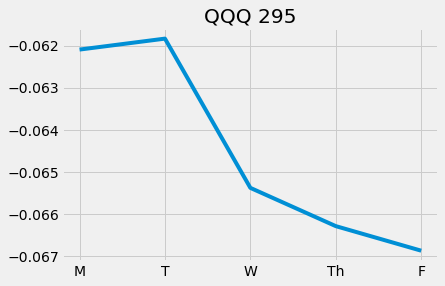

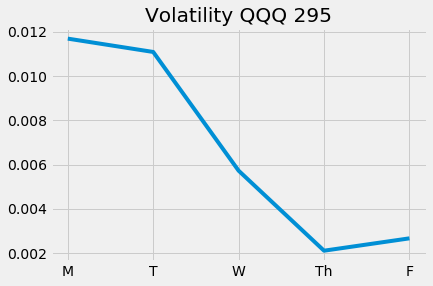

Epoch 297/5000
628/628 [==============================] - 1s 2ms/step - loss: 1.0017 - val_loss: 1.1692


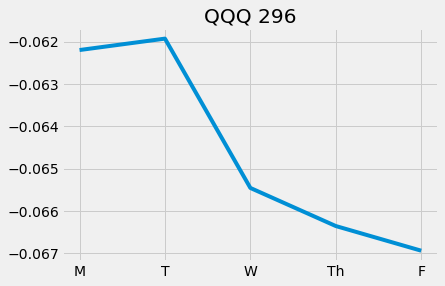

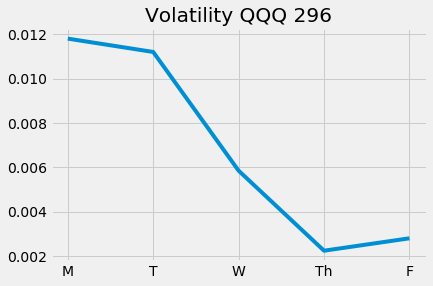

Epoch 298/5000
628/628 [==============================] - 1s 2ms/step - loss: 0.9976 - val_loss: 1.1685


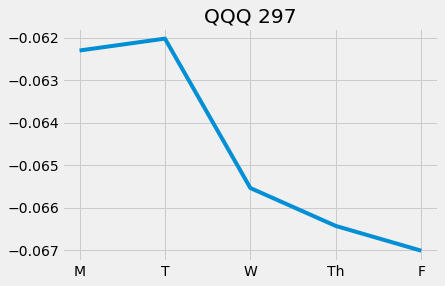

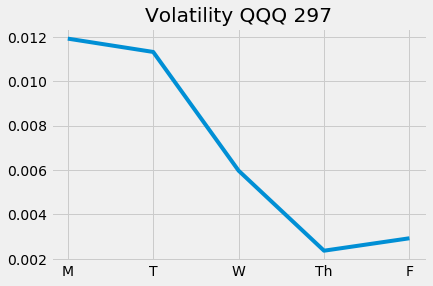

Epoch 299/5000
628/628 [==============================] - 1s 2ms/step - loss: 0.9941 - val_loss: 1.1679


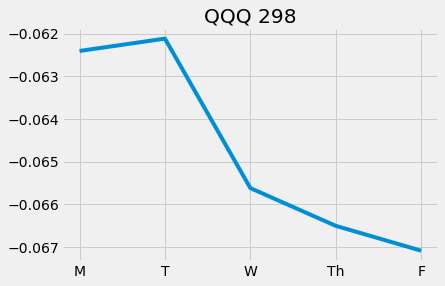

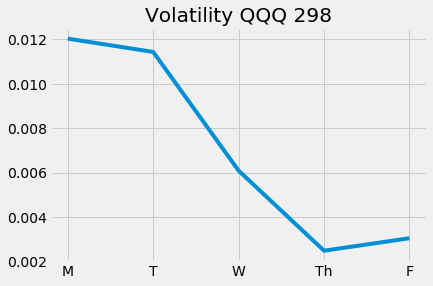

Epoch 300/5000
628/628 [==============================] - 1s 2ms/step - loss: 0.9945 - val_loss: 1.1672


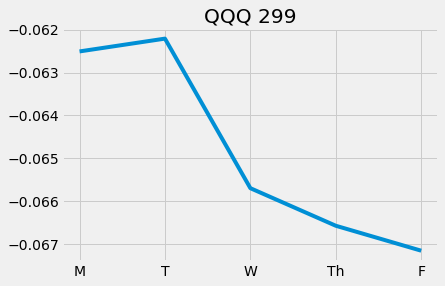

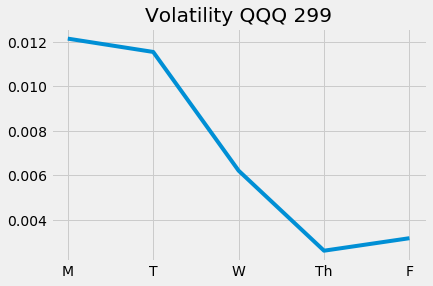

Epoch 301/5000
628/628 [==============================] - 1s 2ms/step - loss: 0.9950 - val_loss: 1.1666

Epoch 00301: ReduceLROnPlateau reducing learning rate to 1.525878978725359e-08.


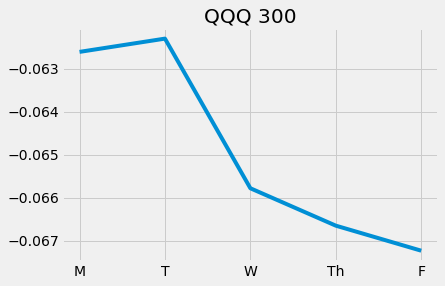

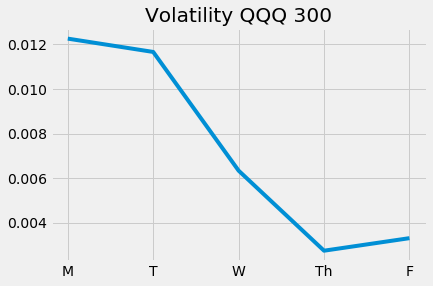

Epoch 302/5000
628/628 [==============================] - 1s 2ms/step - loss: 0.9945 - val_loss: 1.1659


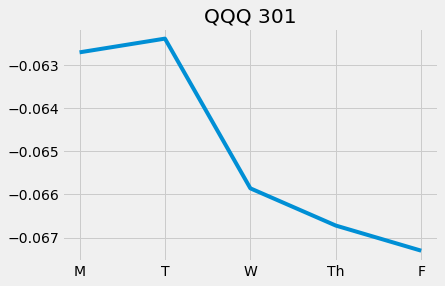

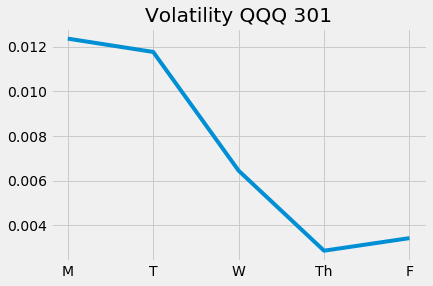

Epoch 303/5000
628/628 [==============================] - 1s 2ms/step - loss: 1.0004 - val_loss: 1.1653


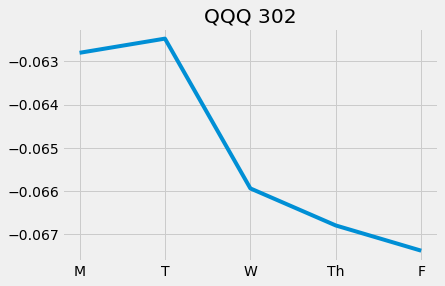

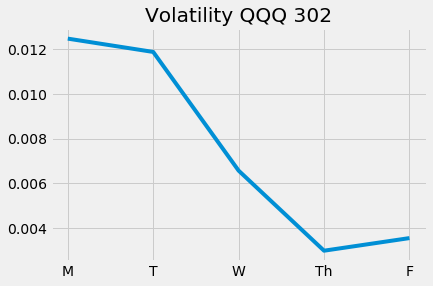

Epoch 304/5000
628/628 [==============================] - 1s 2ms/step - loss: 0.9977 - val_loss: 1.1646


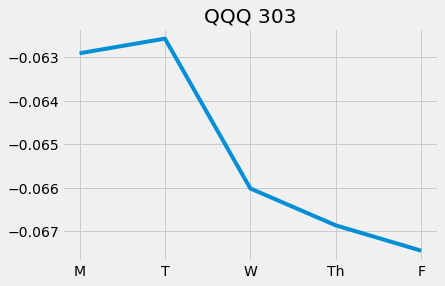

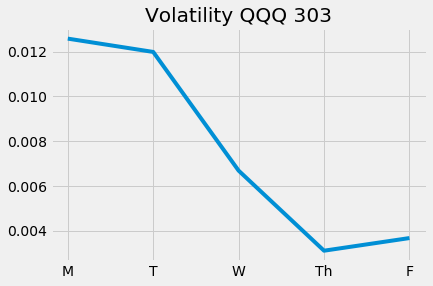

Epoch 305/5000
628/628 [==============================] - 1s 2ms/step - loss: 0.9942 - val_loss: 1.1640


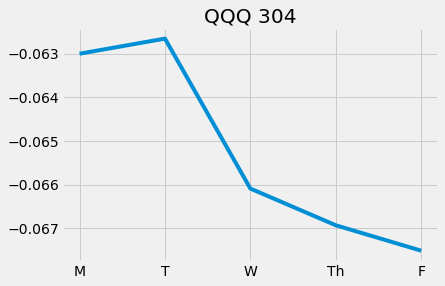

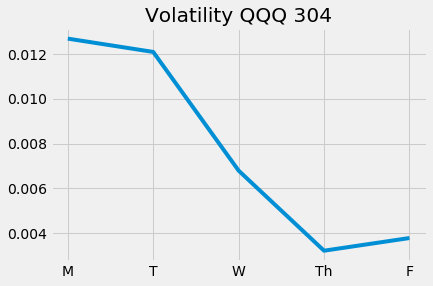

Epoch 306/5000
628/628 [==============================] - 1s 2ms/step - loss: 0.9963 - val_loss: 1.1634


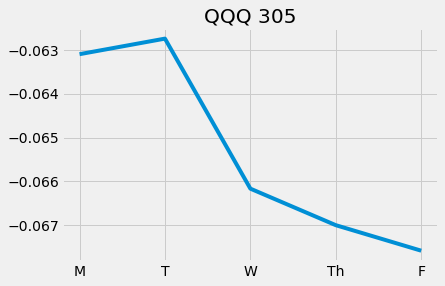

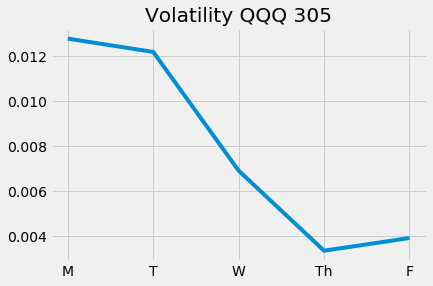

Epoch 307/5000
628/628 [==============================] - 1s 2ms/step - loss: 0.9940 - val_loss: 1.1628


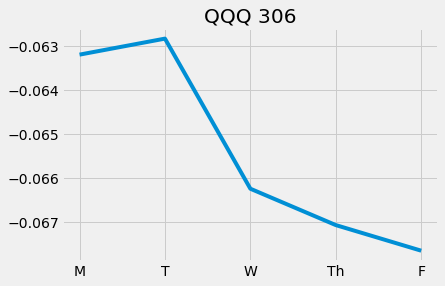

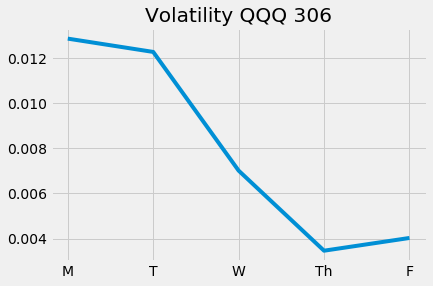

Epoch 308/5000
628/628 [==============================] - 1s 2ms/step - loss: 0.9950 - val_loss: 1.1622


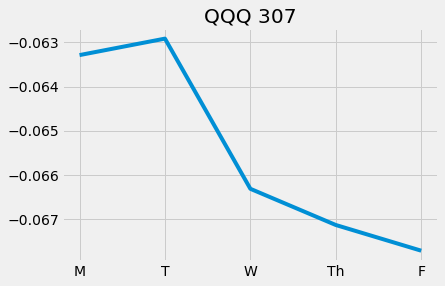

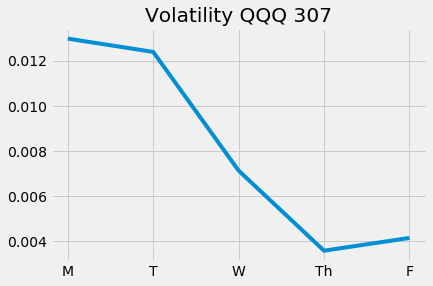

Epoch 309/5000
628/628 [==============================] - 1s 2ms/step - loss: 0.9981 - val_loss: 1.1616


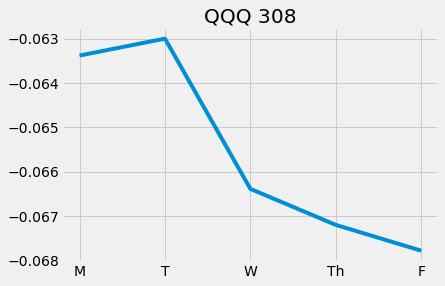

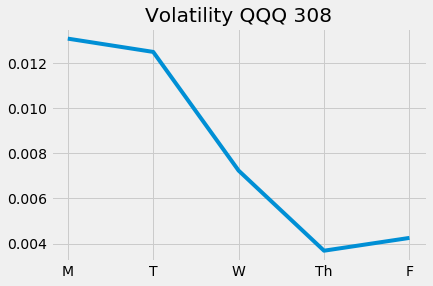

Epoch 310/5000
628/628 [==============================] - 1s 2ms/step - loss: 1.0001 - val_loss: 1.1611

Epoch 00310: ReduceLROnPlateau reducing learning rate to 7.629394893626795e-09.


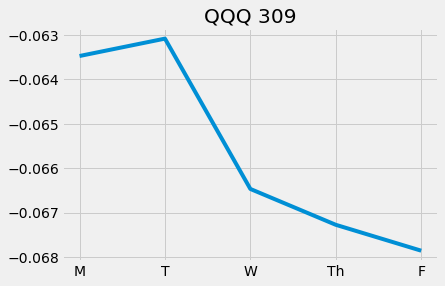

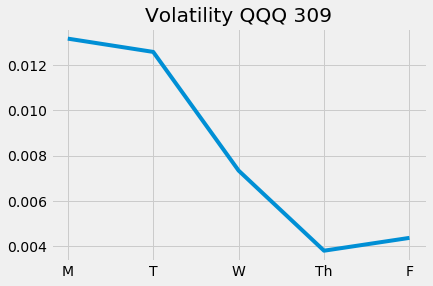

Epoch 311/5000
628/628 [==============================] - 1s 2ms/step - loss: 0.9997 - val_loss: 1.1605


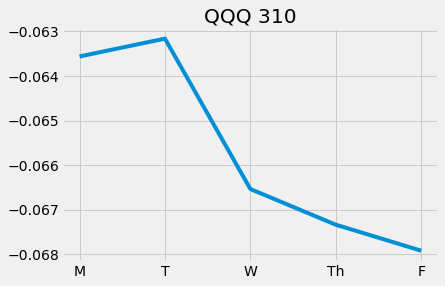

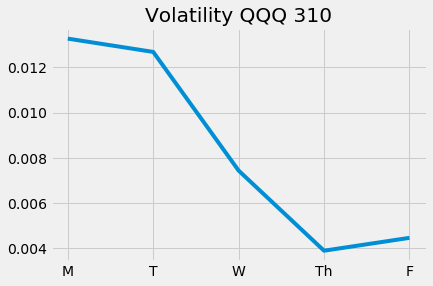

Epoch 312/5000
628/628 [==============================] - 1s 2ms/step - loss: 0.9975 - val_loss: 1.1599


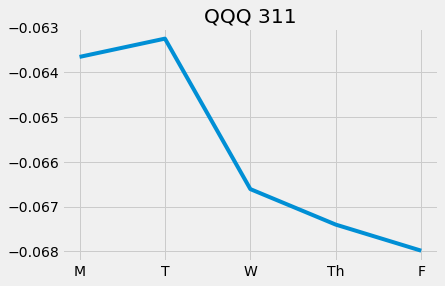

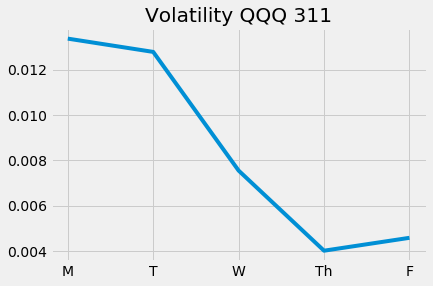

Epoch 313/5000
628/628 [==============================] - 1s 2ms/step - loss: 0.9944 - val_loss: 1.1594


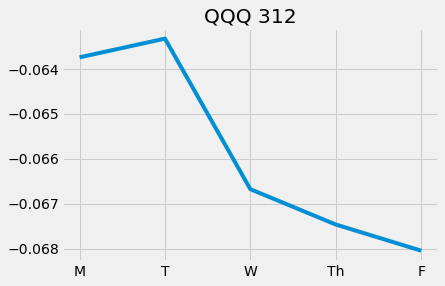

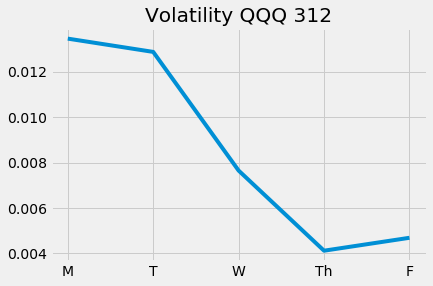

Epoch 314/5000
628/628 [==============================] - 1s 2ms/step - loss: 1.0019 - val_loss: 1.1589


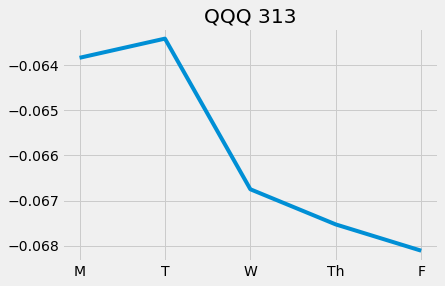

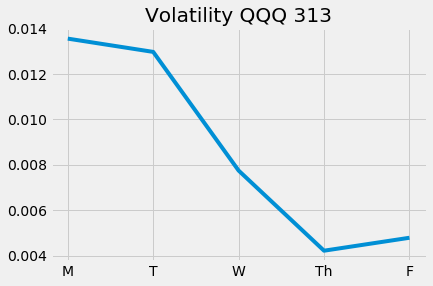

Epoch 315/5000
628/628 [==============================] - 1s 2ms/step - loss: 0.9911 - val_loss: 1.1583


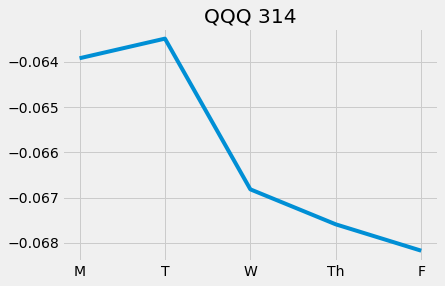

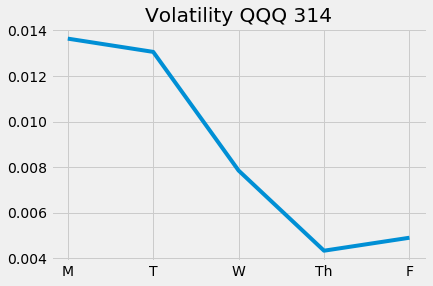

Epoch 316/5000
628/628 [==============================] - 1s 2ms/step - loss: 0.9917 - val_loss: 1.1578

Epoch 00316: ReduceLROnPlateau reducing learning rate to 3.814697446813398e-09.


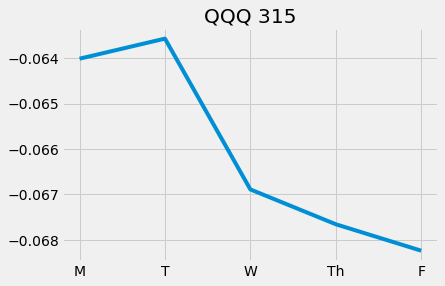

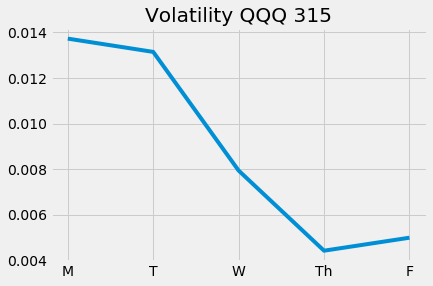

Epoch 317/5000
628/628 [==============================] - 1s 2ms/step - loss: 1.0005 - val_loss: 1.1573


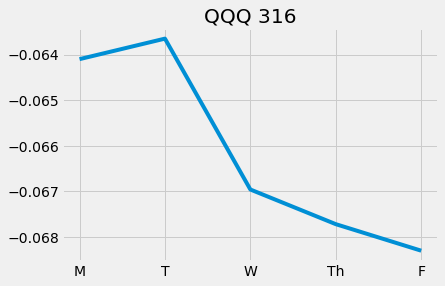

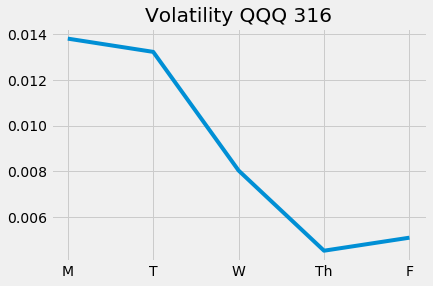

Epoch 318/5000
628/628 [==============================] - 1s 2ms/step - loss: 0.9992 - val_loss: 1.1568


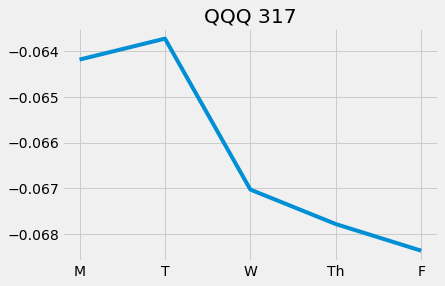

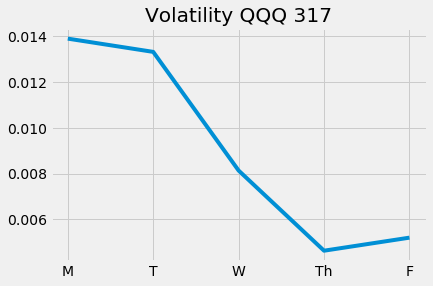

Epoch 319/5000
628/628 [==============================] - 1s 2ms/step - loss: 0.9959 - val_loss: 1.1563


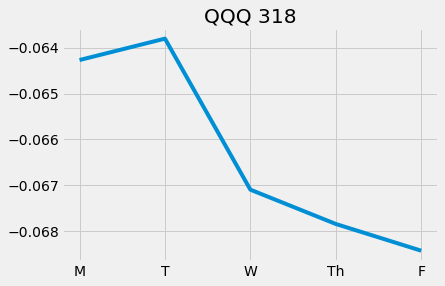

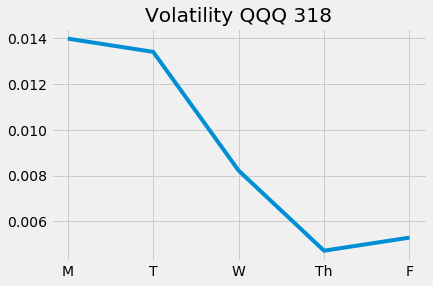

Epoch 320/5000
628/628 [==============================] - 1s 2ms/step - loss: 0.9968 - val_loss: 1.1558


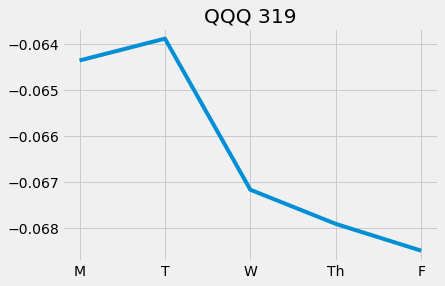

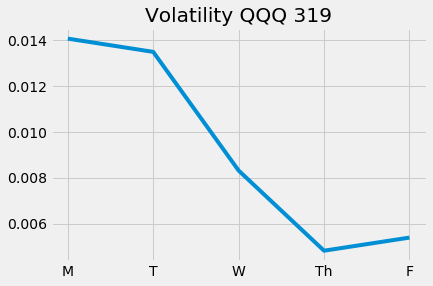

Epoch 321/5000
628/628 [==============================] - 1s 2ms/step - loss: 0.9978 - val_loss: 1.1553


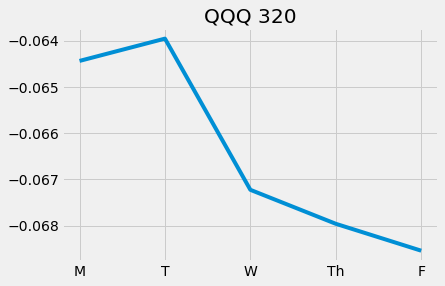

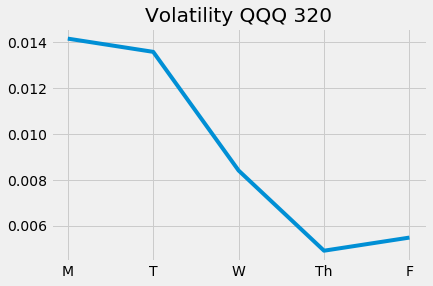

Epoch 322/5000
628/628 [==============================] - 1s 2ms/step - loss: 1.0022 - val_loss: 1.1548


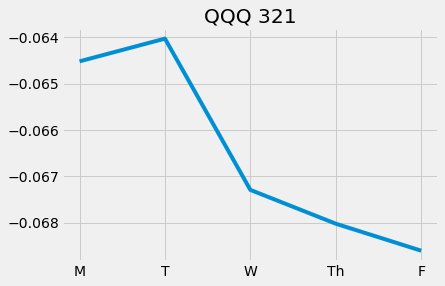

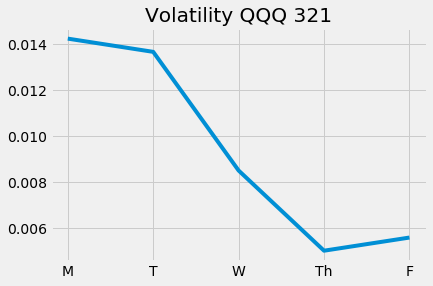

Epoch 323/5000
628/628 [==============================] - 1s 2ms/step - loss: 1.0020 - val_loss: 1.1543


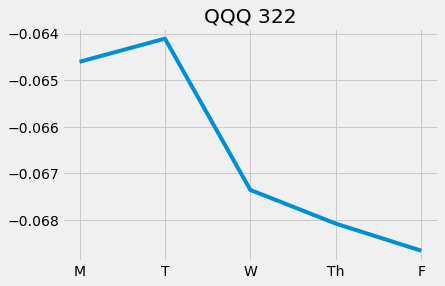

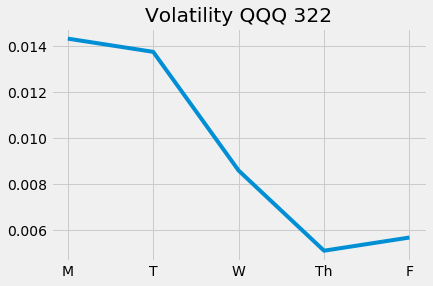

Epoch 324/5000
628/628 [==============================] - 1s 2ms/step - loss: 1.0008 - val_loss: 1.1538


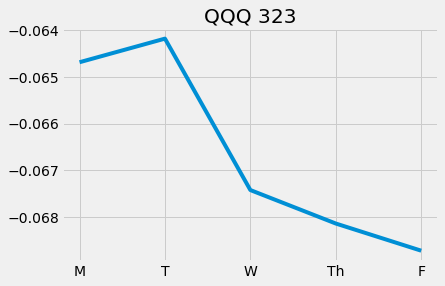

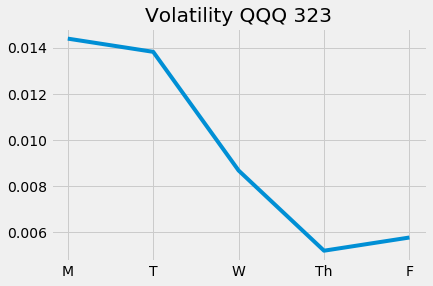

Epoch 325/5000
628/628 [==============================] - 1s 2ms/step - loss: 0.9955 - val_loss: 1.1534

Epoch 00325: ReduceLROnPlateau reducing learning rate to 1.907348723406699e-09.


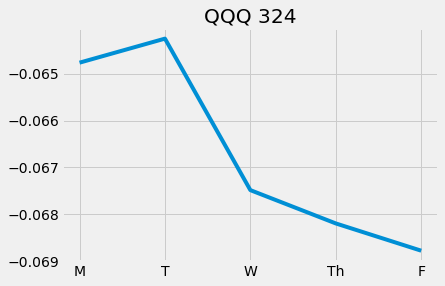

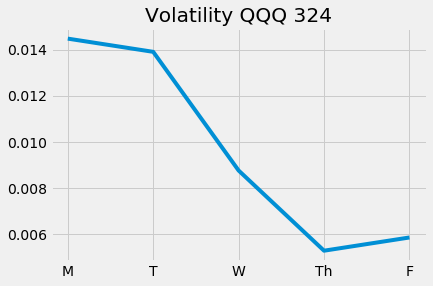

Epoch 326/5000
628/628 [==============================] - 1s 2ms/step - loss: 0.9956 - val_loss: 1.1529


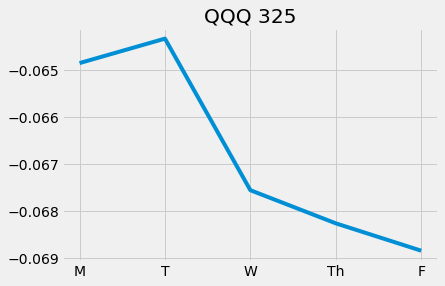

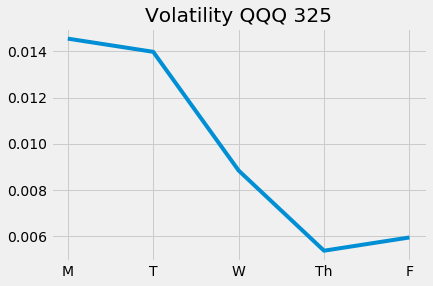

Epoch 327/5000
628/628 [==============================] - 1s 2ms/step - loss: 1.0022 - val_loss: 1.1525


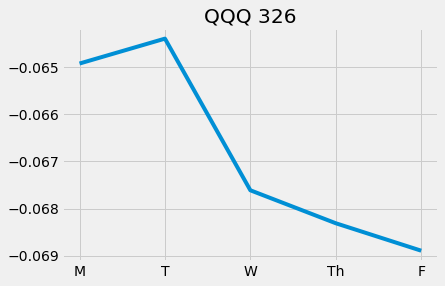

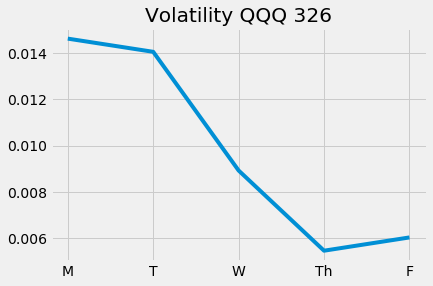

Epoch 328/5000
628/628 [==============================] - 1s 2ms/step - loss: 0.9969 - val_loss: 1.1520


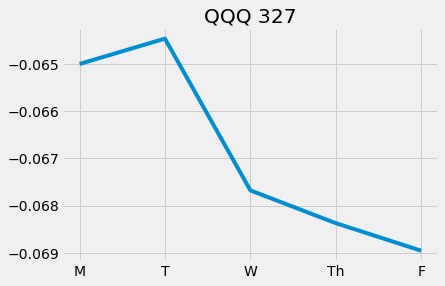

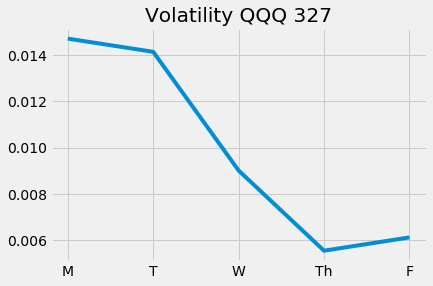

Epoch 329/5000
628/628 [==============================] - 1s 2ms/step - loss: 0.9993 - val_loss: 1.1516


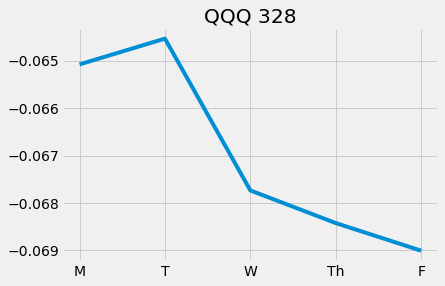

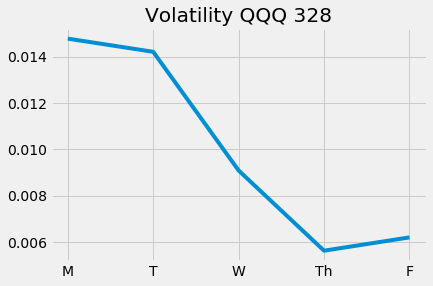

Epoch 330/5000
628/628 [==============================] - 1s 2ms/step - loss: 1.0002 - val_loss: 1.1511


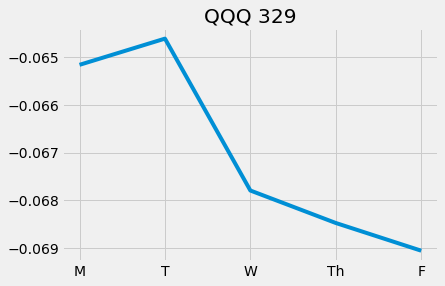

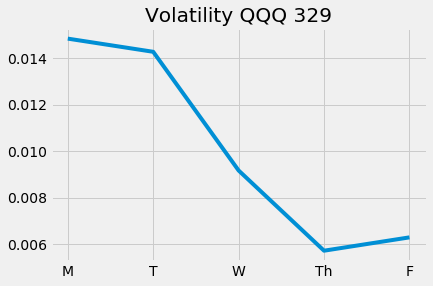

Epoch 331/5000
628/628 [==============================] - 1s 2ms/step - loss: 0.9943 - val_loss: 1.1507

Epoch 00331: ReduceLROnPlateau reducing learning rate to 9.536743617033494e-10.


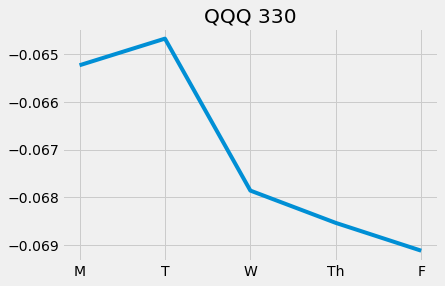

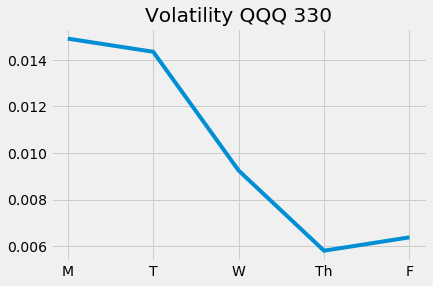

Epoch 332/5000
628/628 [==============================] - 1s 2ms/step - loss: 0.9990 - val_loss: 1.1503


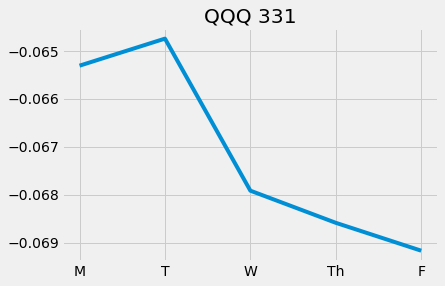

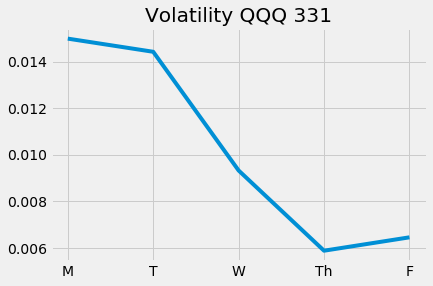

Epoch 333/5000
628/628 [==============================] - 1s 2ms/step - loss: 0.9923 - val_loss: 1.1499


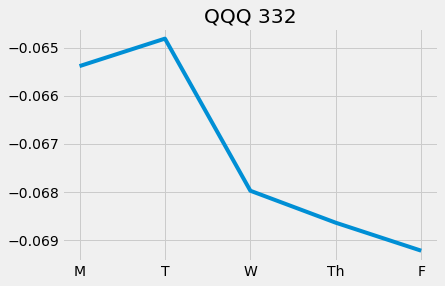

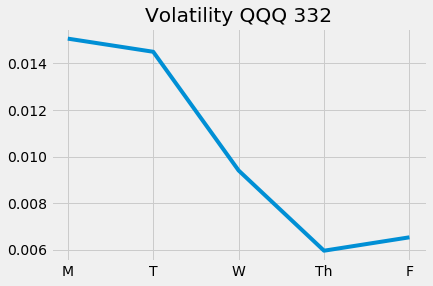

Epoch 334/5000
628/628 [==============================] - 1s 2ms/step - loss: 0.9978 - val_loss: 1.1495


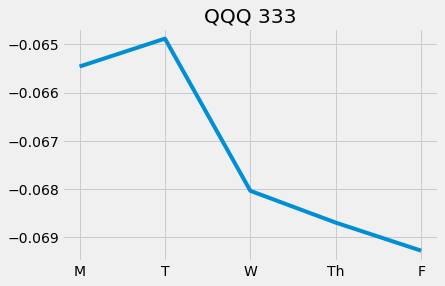

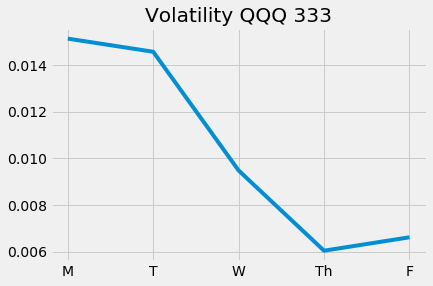

Epoch 335/5000
628/628 [==============================] - 1s 2ms/step - loss: 0.9964 - val_loss: 1.1491


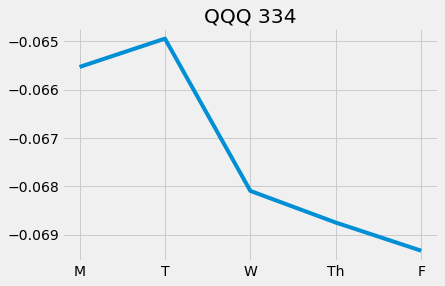

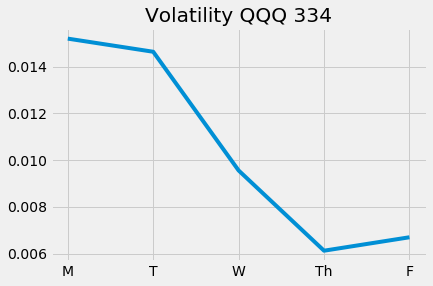

Epoch 336/5000
628/628 [==============================] - 1s 2ms/step - loss: 0.9955 - val_loss: 1.1487


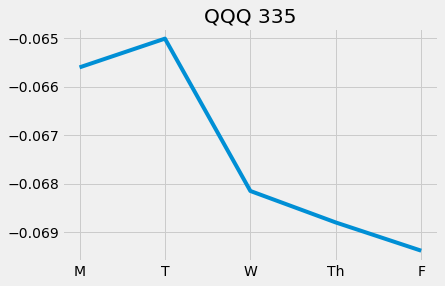

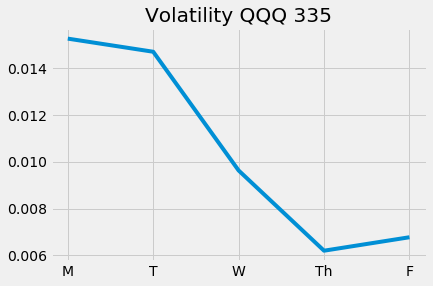

Epoch 337/5000
628/628 [==============================] - 1s 2ms/step - loss: 0.9969 - val_loss: 1.1483


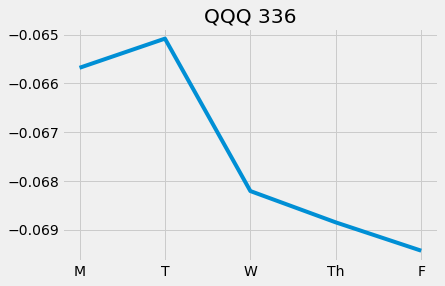

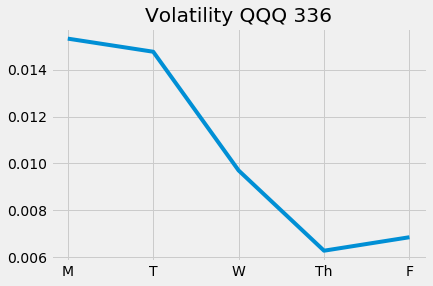

Epoch 338/5000
628/628 [==============================] - 1s 2ms/step - loss: 0.9994 - val_loss: 1.1479


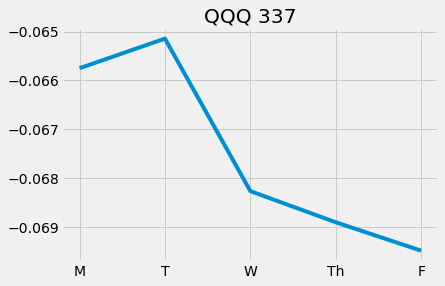

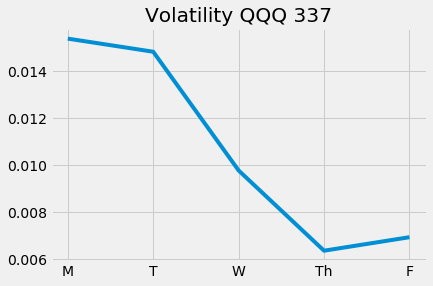

Epoch 339/5000
628/628 [==============================] - 1s 2ms/step - loss: 0.9981 - val_loss: 1.1475


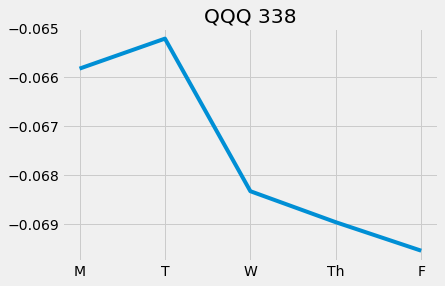

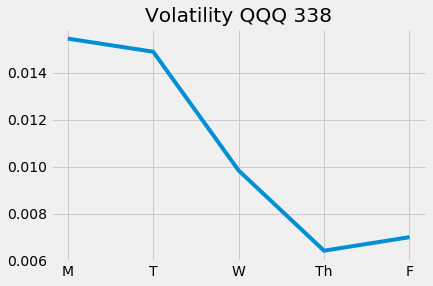

Epoch 340/5000
628/628 [==============================] - 1s 2ms/step - loss: 0.9927 - val_loss: 1.1471

Epoch 00340: ReduceLROnPlateau reducing learning rate to 4.768371808516747e-10.


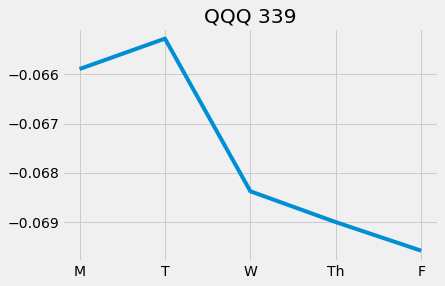

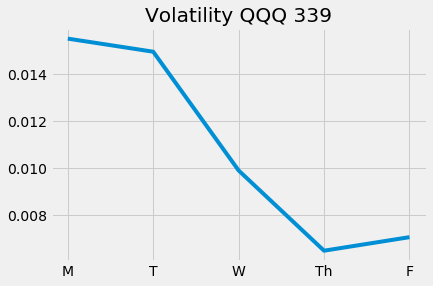

Epoch 341/5000
628/628 [==============================] - 1s 2ms/step - loss: 0.9955 - val_loss: 1.1468


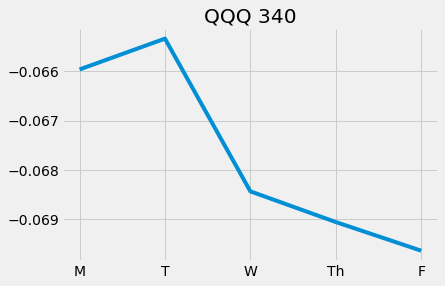

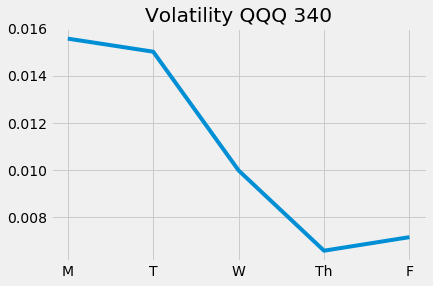

Epoch 342/5000
628/628 [==============================] - 1s 2ms/step - loss: 0.9937 - val_loss: 1.1464


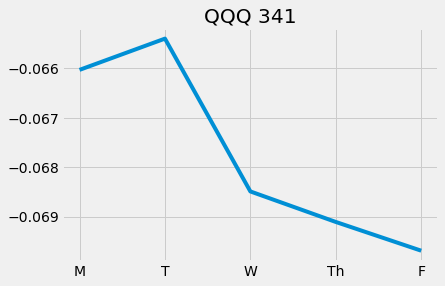

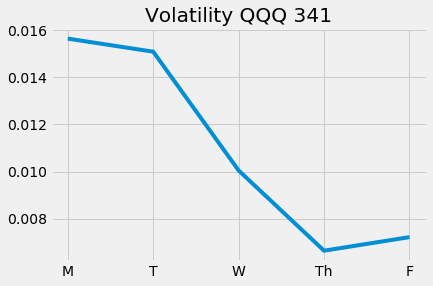

Epoch 343/5000
628/628 [==============================] - 1s 2ms/step - loss: 1.0033 - val_loss: 1.1460


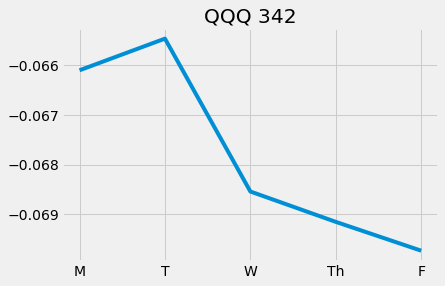

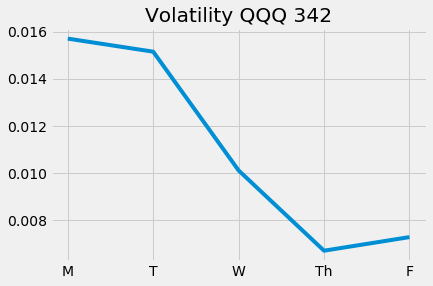

Epoch 344/5000
628/628 [==============================] - 1s 2ms/step - loss: 0.9997 - val_loss: 1.1457


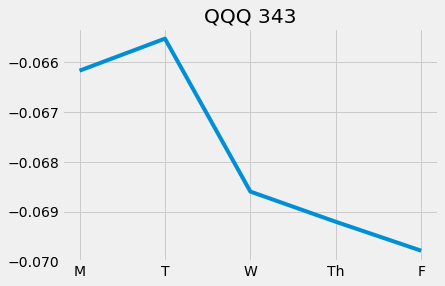

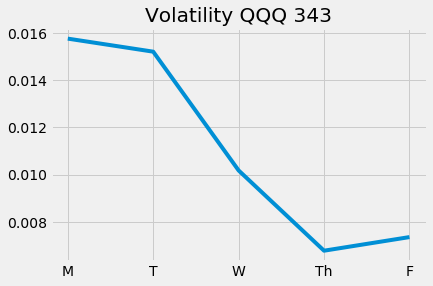

Epoch 345/5000
628/628 [==============================] - 1s 2ms/step - loss: 1.0030 - val_loss: 1.1453


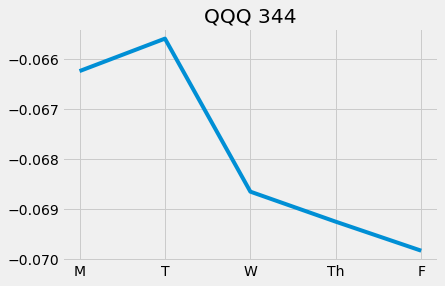

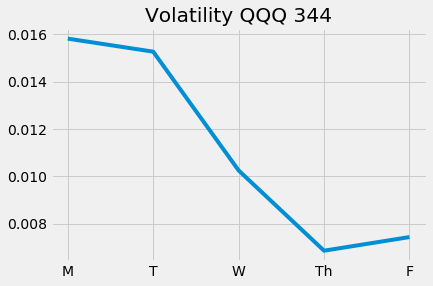

Epoch 346/5000
628/628 [==============================] - 1s 2ms/step - loss: 0.9953 - val_loss: 1.1450

Epoch 00346: ReduceLROnPlateau reducing learning rate to 2.3841859042583735e-10.


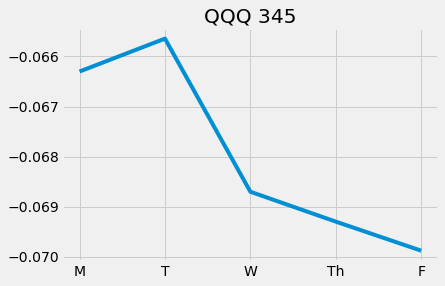

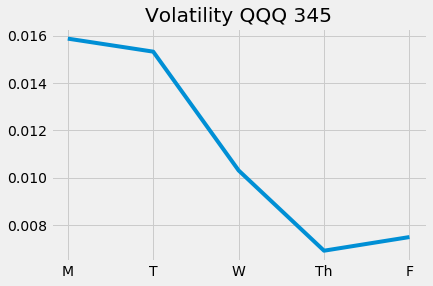

Epoch 347/5000
628/628 [==============================] - 1s 2ms/step - loss: 0.9951 - val_loss: 1.1446


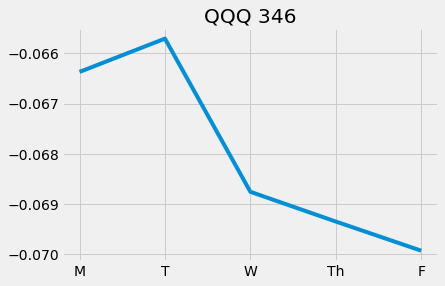

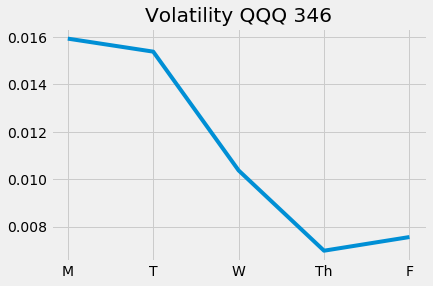

Epoch 348/5000
628/628 [==============================] - 1s 2ms/step - loss: 0.9968 - val_loss: 1.1443


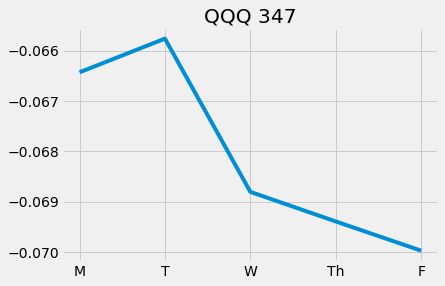

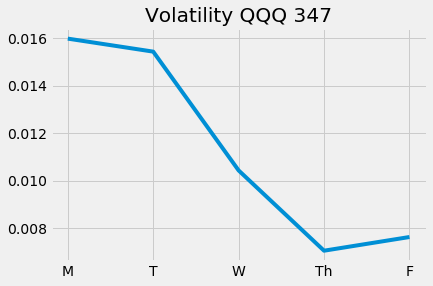

Epoch 349/5000
628/628 [==============================] - 1s 2ms/step - loss: 0.9977 - val_loss: 1.1440


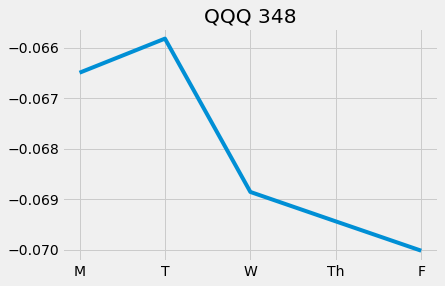

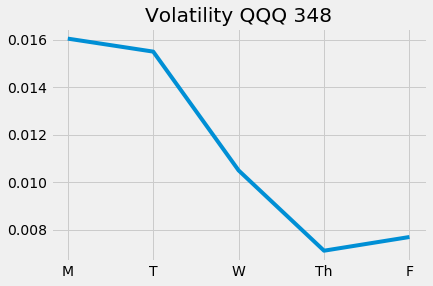

Epoch 350/5000
628/628 [==============================] - 2s 3ms/step - loss: 1.0001 - val_loss: 1.1436


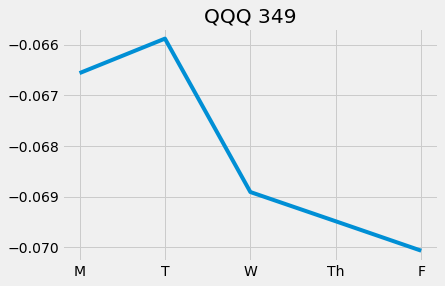

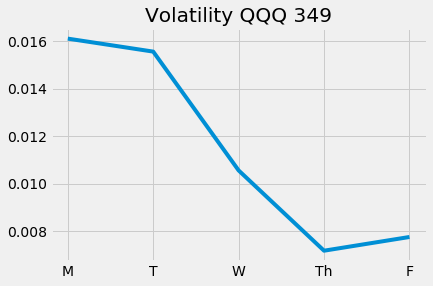

Epoch 351/5000
628/628 [==============================] - 2s 3ms/step - loss: 0.9958 - val_loss: 1.1433


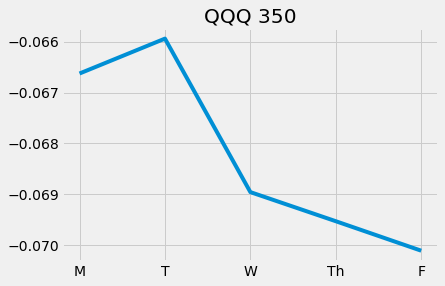

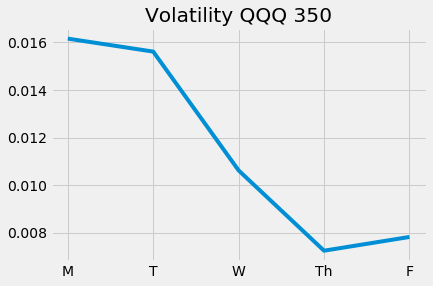

Epoch 352/5000
628/628 [==============================] - 2s 3ms/step - loss: 0.9975 - val_loss: 1.1430


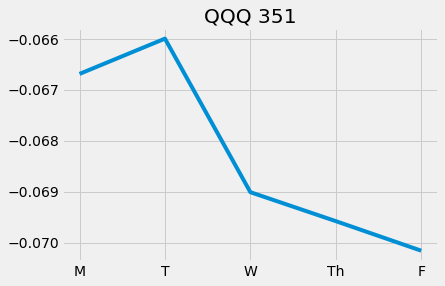

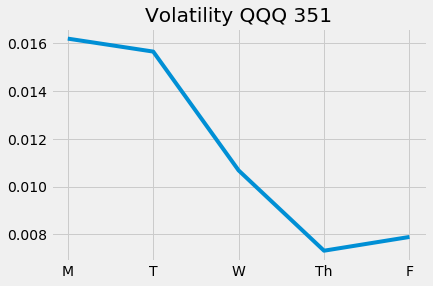

Epoch 353/5000
628/628 [==============================] - 1s 2ms/step - loss: 0.9977 - val_loss: 1.1427


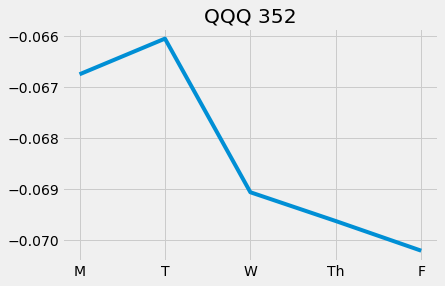

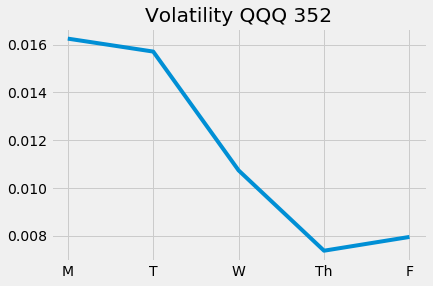

Epoch 354/5000
628/628 [==============================] - 1s 2ms/step - loss: 0.9995 - val_loss: 1.1424


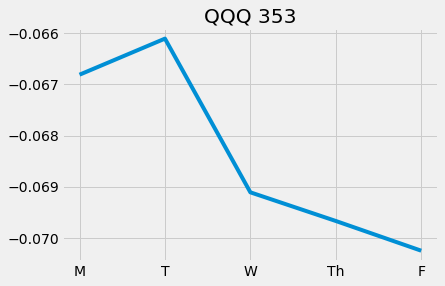

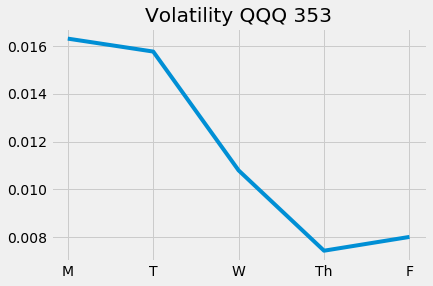

Epoch 355/5000
628/628 [==============================] - 2s 2ms/step - loss: 0.9918 - val_loss: 1.1421

Epoch 00355: ReduceLROnPlateau reducing learning rate to 1.1920929521291868e-10.


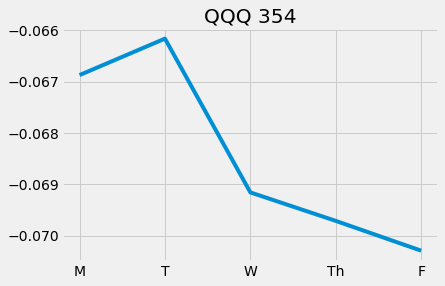

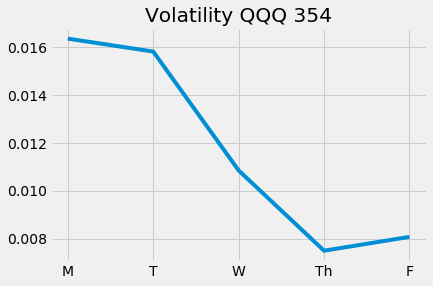

Epoch 356/5000
628/628 [==============================] - 1s 2ms/step - loss: 0.9968 - val_loss: 1.1418


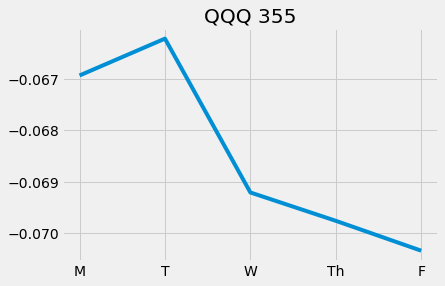

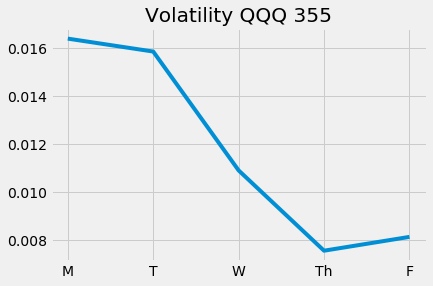

Epoch 357/5000
628/628 [==============================] - 1s 2ms/step - loss: 0.9995 - val_loss: 1.1415


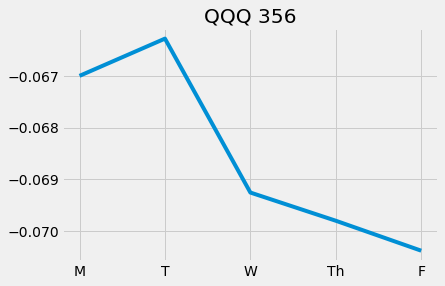

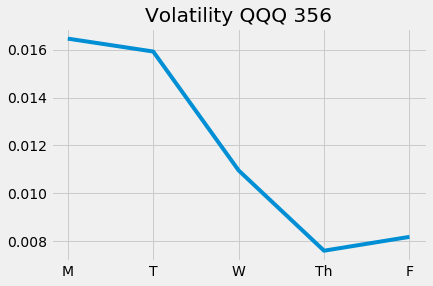

Epoch 358/5000
628/628 [==============================] - 1s 2ms/step - loss: 0.9988 - val_loss: 1.1412


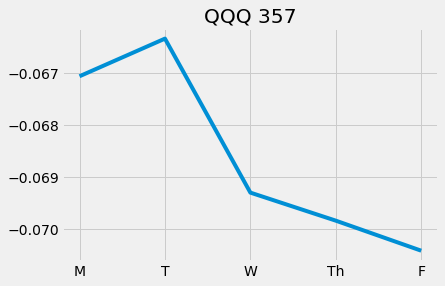

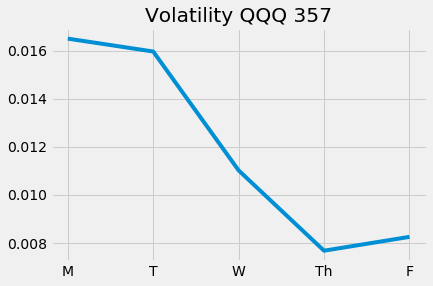

Epoch 359/5000
628/628 [==============================] - 1s 2ms/step - loss: 0.9946 - val_loss: 1.1409


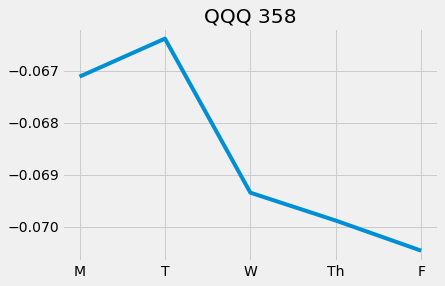

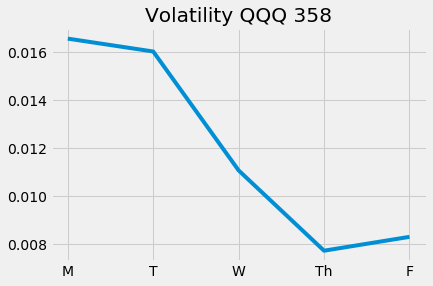

Epoch 360/5000
628/628 [==============================] - 1s 2ms/step - loss: 0.9974 - val_loss: 1.1406


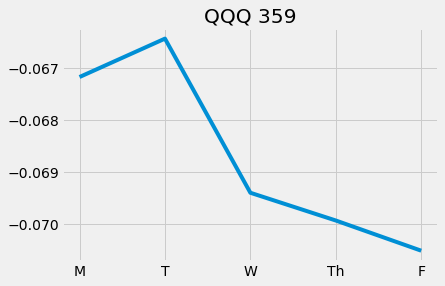

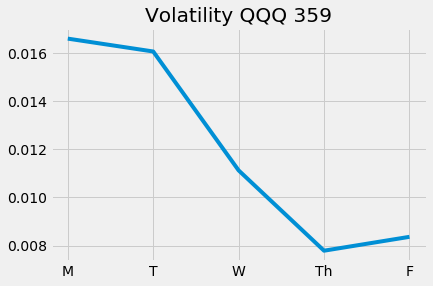

Epoch 361/5000
628/628 [==============================] - 1s 2ms/step - loss: 0.9922 - val_loss: 1.1403

Epoch 00361: ReduceLROnPlateau reducing learning rate to 5.960464760645934e-11.


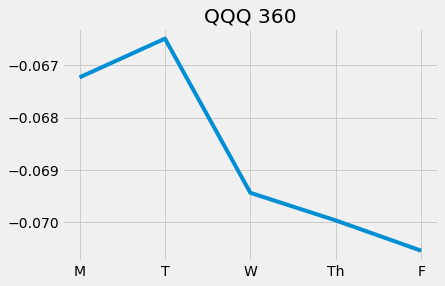

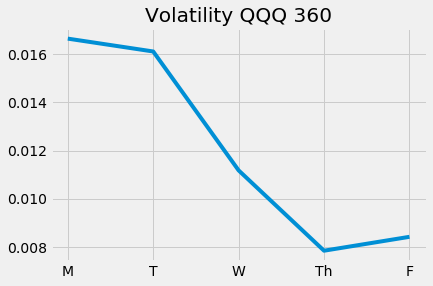

Epoch 362/5000
628/628 [==============================] - 1s 2ms/step - loss: 0.9971 - val_loss: 1.1400


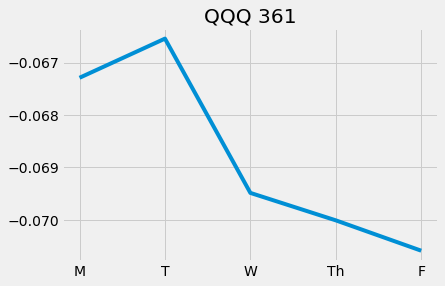

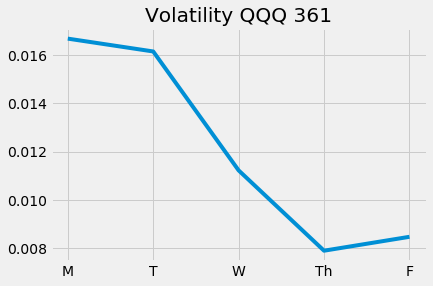

Epoch 363/5000
628/628 [==============================] - 1s 2ms/step - loss: 0.9953 - val_loss: 1.1398


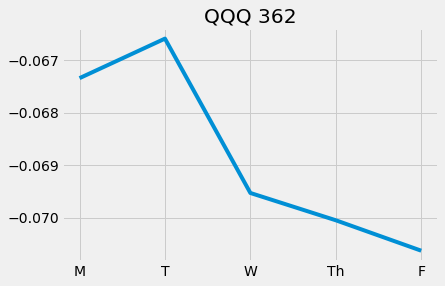

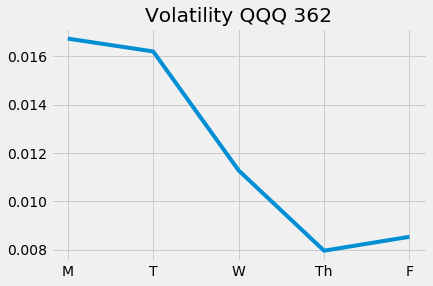

Epoch 364/5000
628/628 [==============================] - 1s 2ms/step - loss: 1.0010 - val_loss: 1.1395


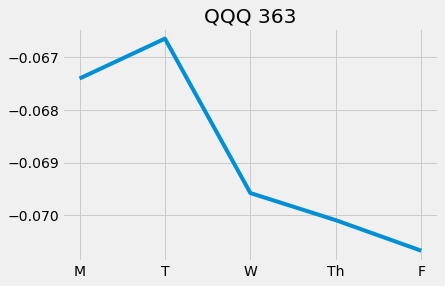

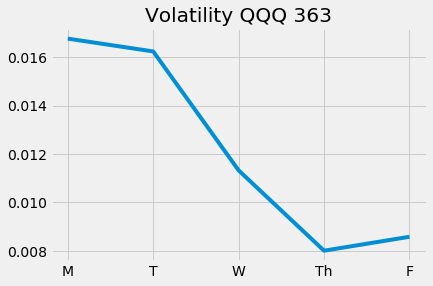

Epoch 365/5000
628/628 [==============================] - 1s 2ms/step - loss: 0.9973 - val_loss: 1.1392


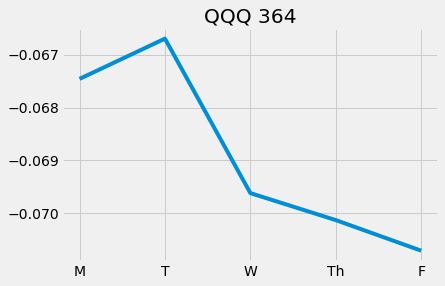

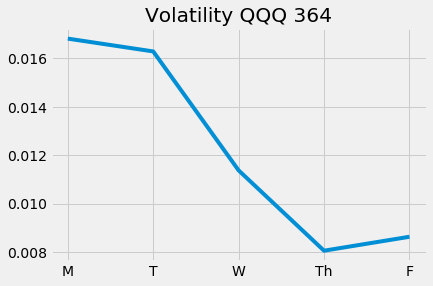

Epoch 366/5000
628/628 [==============================] - 1s 2ms/step - loss: 0.9970 - val_loss: 1.1389


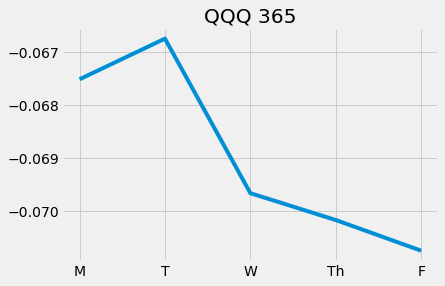

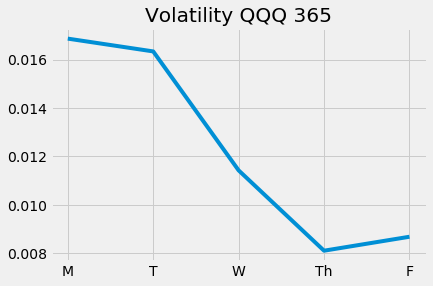

Epoch 367/5000
628/628 [==============================] - 1s 2ms/step - loss: 0.9990 - val_loss: 1.1387


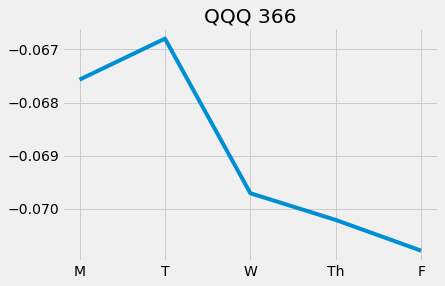

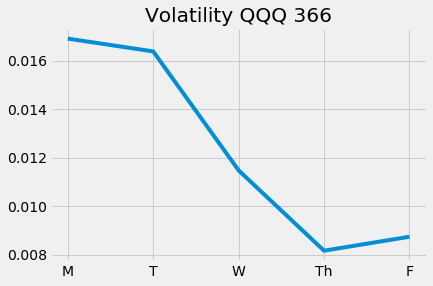

Epoch 368/5000
628/628 [==============================] - 1s 2ms/step - loss: 1.0012 - val_loss: 1.1384


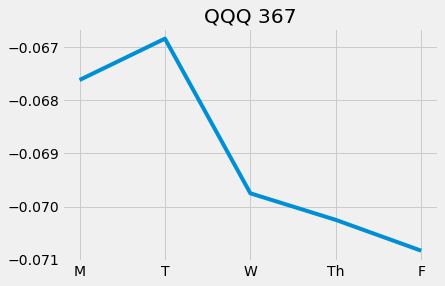

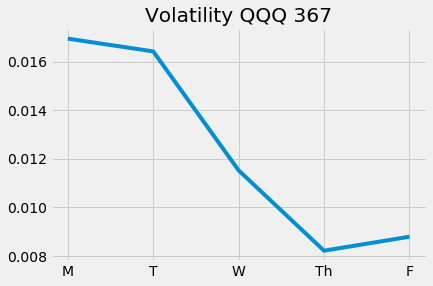

Epoch 369/5000
628/628 [==============================] - 1s 2ms/step - loss: 0.9902 - val_loss: 1.1382


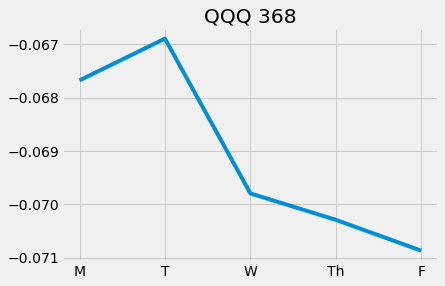

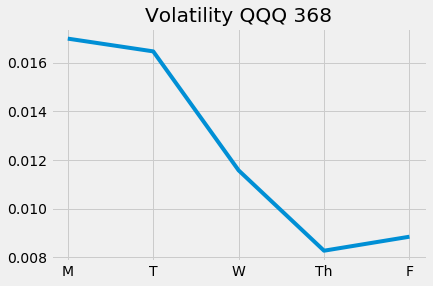

Epoch 370/5000
628/628 [==============================] - 1s 2ms/step - loss: 0.9948 - val_loss: 1.1379

Epoch 00370: ReduceLROnPlateau reducing learning rate to 2.980232380322967e-11.


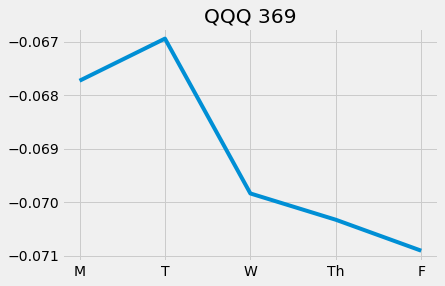

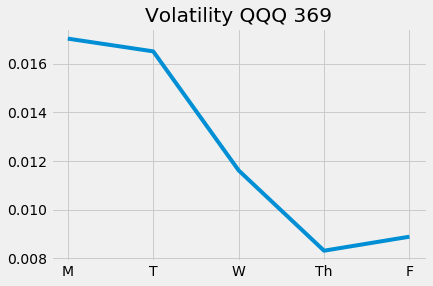

Epoch 371/5000
628/628 [==============================] - 1s 2ms/step - loss: 0.9938 - val_loss: 1.1377


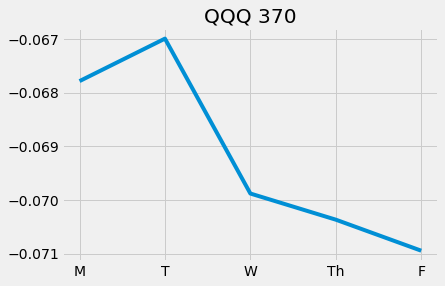

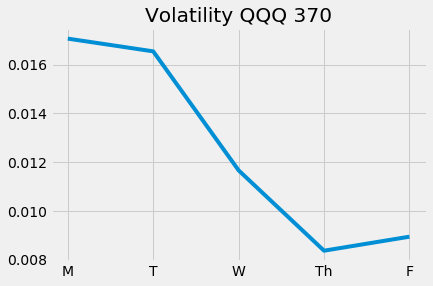

Epoch 372/5000
628/628 [==============================] - 1s 2ms/step - loss: 1.0014 - val_loss: 1.1374


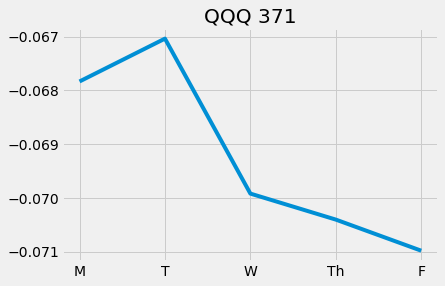

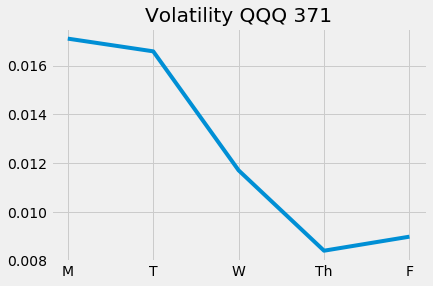

Epoch 373/5000
628/628 [==============================] - 1s 2ms/step - loss: 0.9929 - val_loss: 1.1372


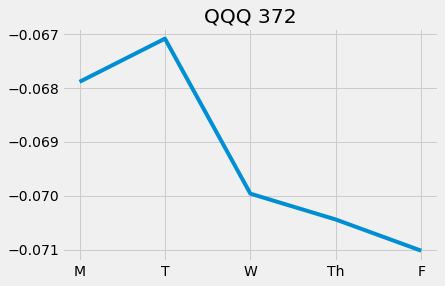

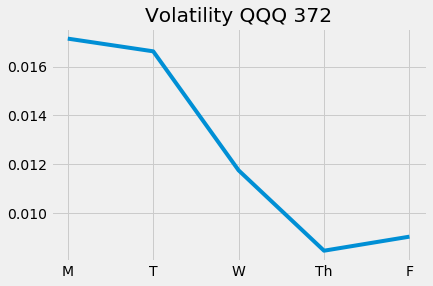

Epoch 374/5000
628/628 [==============================] - 1s 2ms/step - loss: 1.0025 - val_loss: 1.1370


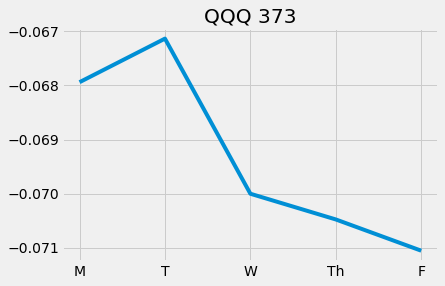

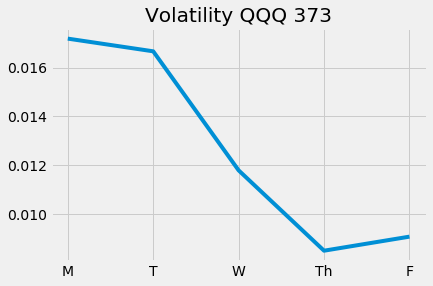

Epoch 375/5000
628/628 [==============================] - 1s 2ms/step - loss: 0.9940 - val_loss: 1.1367


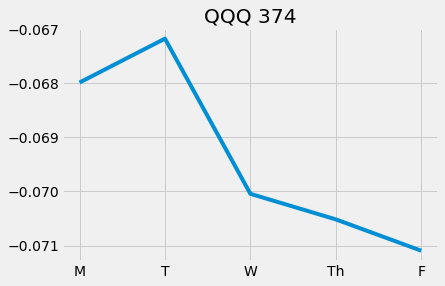

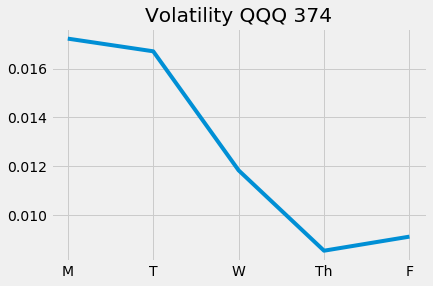

Epoch 376/5000
628/628 [==============================] - 1s 2ms/step - loss: 0.9961 - val_loss: 1.1365

Epoch 00376: ReduceLROnPlateau reducing learning rate to 1.4901161901614834e-11.


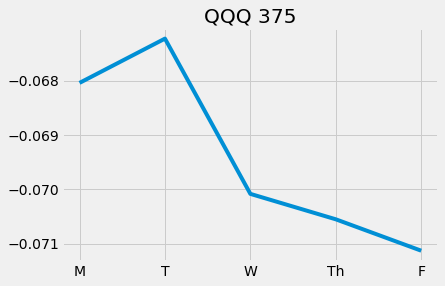

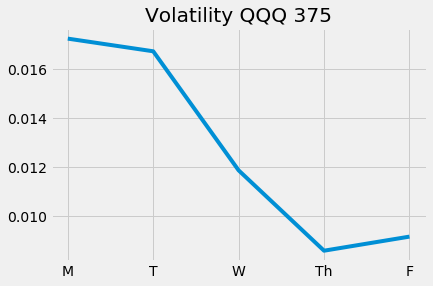

Epoch 377/5000
628/628 [==============================] - 1s 2ms/step - loss: 0.9967 - val_loss: 1.1363


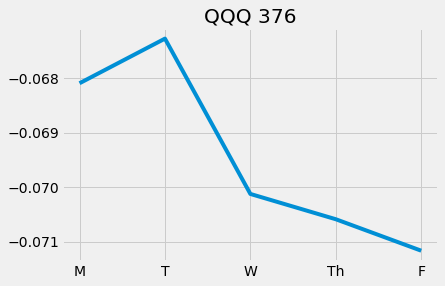

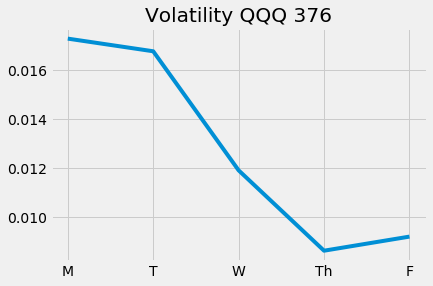

Epoch 378/5000
628/628 [==============================] - 1s 2ms/step - loss: 0.9969 - val_loss: 1.1360


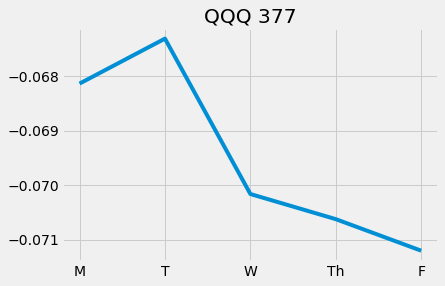

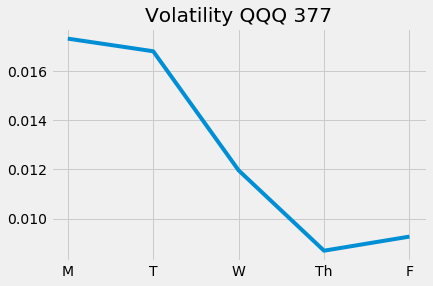

Epoch 379/5000
628/628 [==============================] - 1s 2ms/step - loss: 0.9968 - val_loss: 1.1358


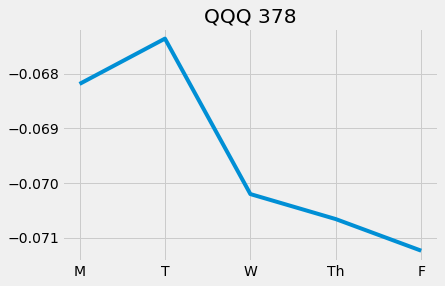

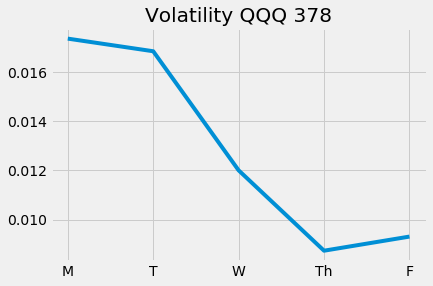

Epoch 380/5000
628/628 [==============================] - 1s 2ms/step - loss: 1.0014 - val_loss: 1.1356


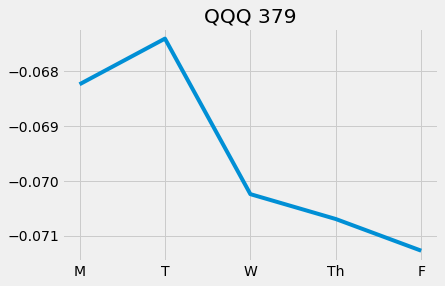

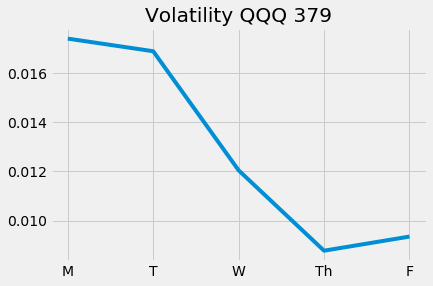

Epoch 381/5000
628/628 [==============================] - 1s 2ms/step - loss: 0.9986 - val_loss: 1.1354


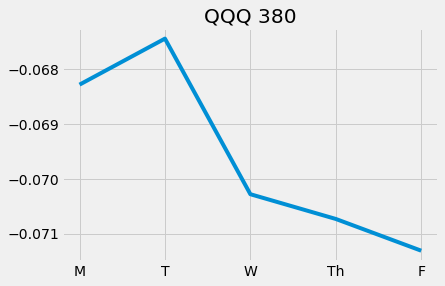

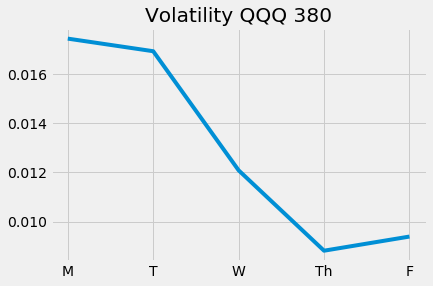

Epoch 382/5000
628/628 [==============================] - 1s 2ms/step - loss: 1.0008 - val_loss: 1.1352


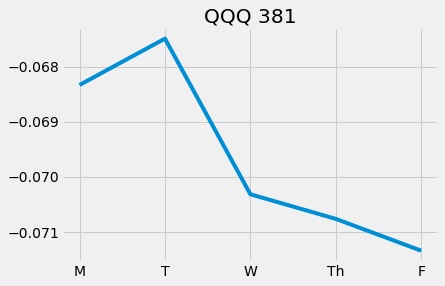

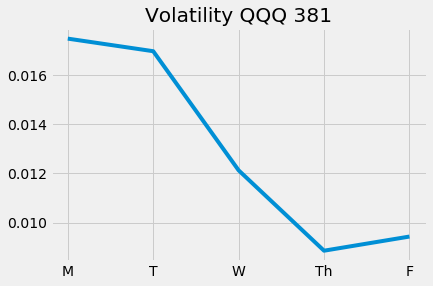

Epoch 383/5000
628/628 [==============================] - 1s 2ms/step - loss: 0.9955 - val_loss: 1.1349


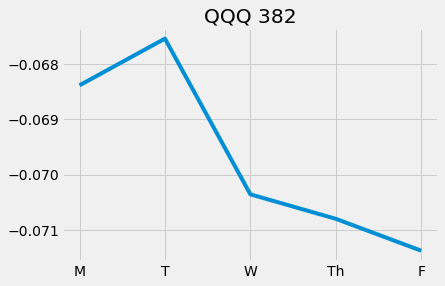

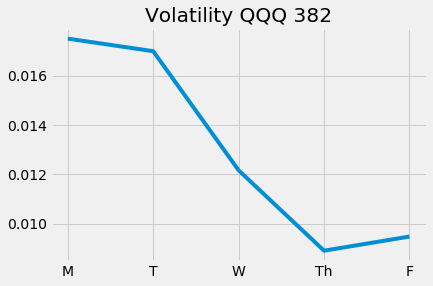

Epoch 384/5000
628/628 [==============================] - 1s 2ms/step - loss: 0.9987 - val_loss: 1.1347


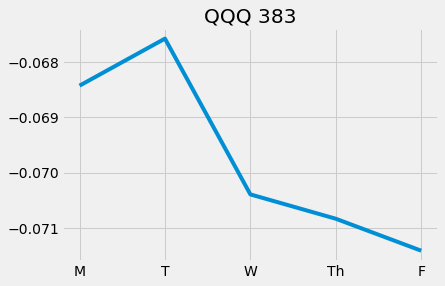

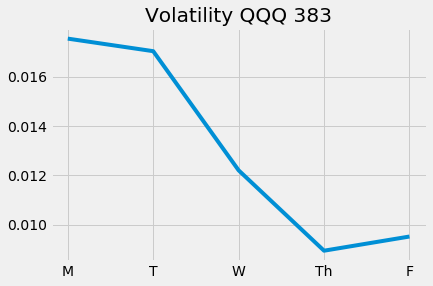

Epoch 385/5000
628/628 [==============================] - 1s 2ms/step - loss: 0.9953 - val_loss: 1.1345

Epoch 00385: ReduceLROnPlateau reducing learning rate to 7.450580950807417e-12.


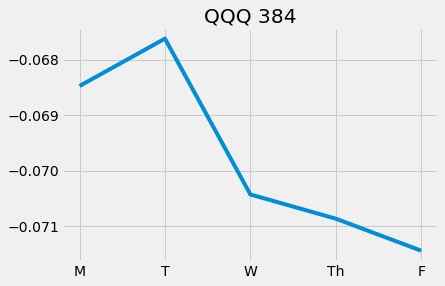

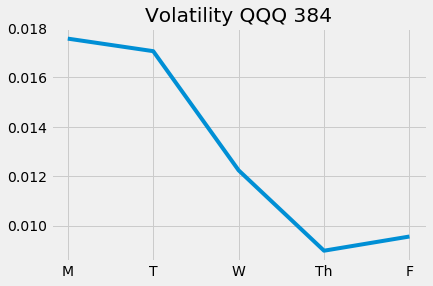

Epoch 386/5000
628/628 [==============================] - 1s 2ms/step - loss: 0.9920 - val_loss: 1.1343


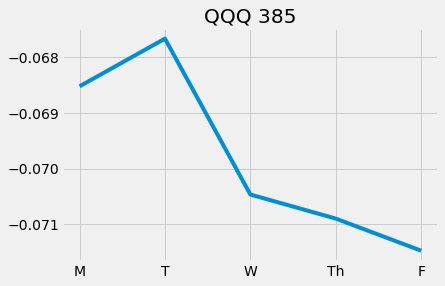

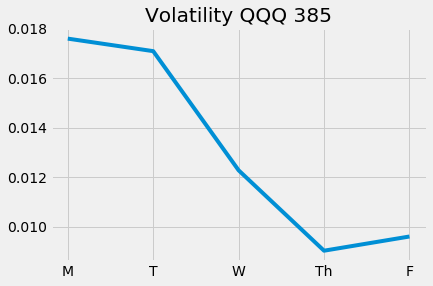

Epoch 387/5000
628/628 [==============================] - 1s 2ms/step - loss: 0.9983 - val_loss: 1.1341


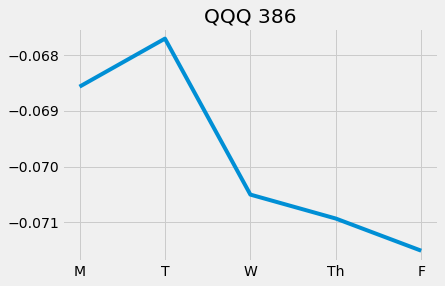

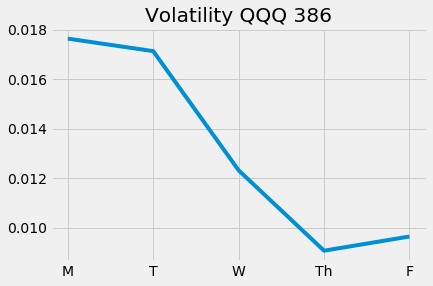

Epoch 388/5000
628/628 [==============================] - 1s 2ms/step - loss: 0.9935 - val_loss: 1.1339


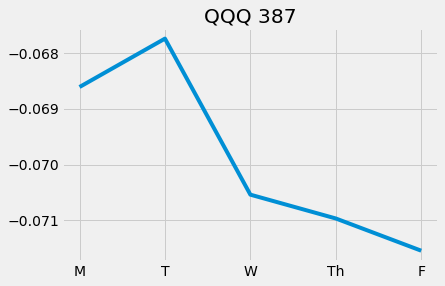

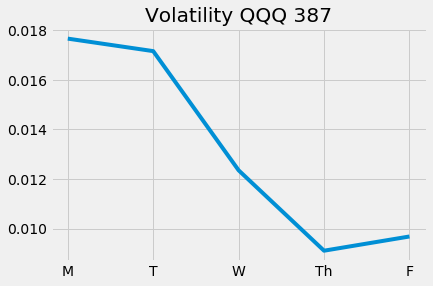

Epoch 389/5000
628/628 [==============================] - 1s 2ms/step - loss: 1.0007 - val_loss: 1.1337


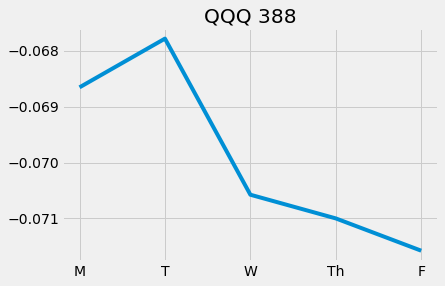

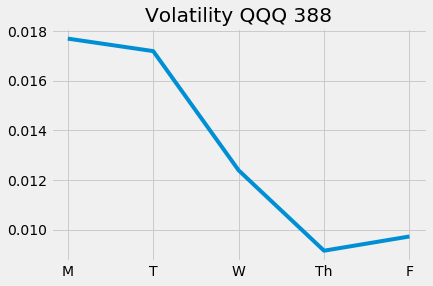

Epoch 390/5000
628/628 [==============================] - 1s 2ms/step - loss: 0.9928 - val_loss: 1.1335


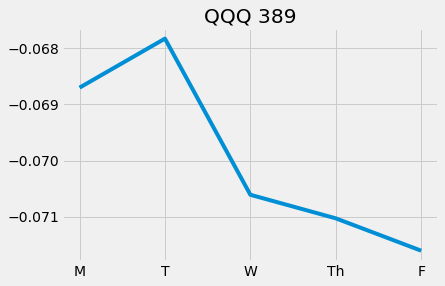

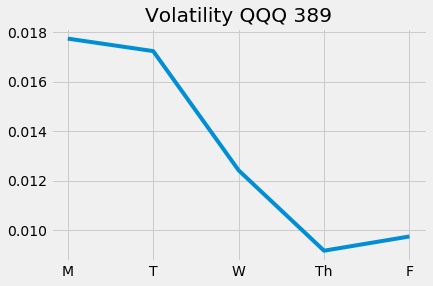

Epoch 391/5000
628/628 [==============================] - 1s 2ms/step - loss: 1.0011 - val_loss: 1.1333

Epoch 00391: ReduceLROnPlateau reducing learning rate to 3.725290475403709e-12.


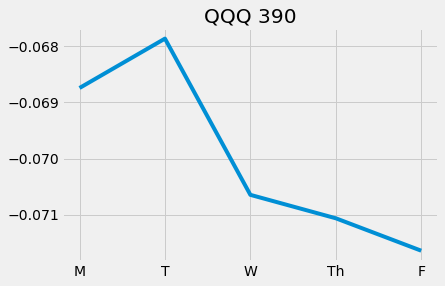

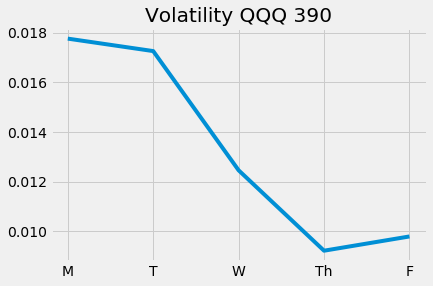

Epoch 392/5000
628/628 [==============================] - 1s 2ms/step - loss: 1.0007 - val_loss: 1.1332


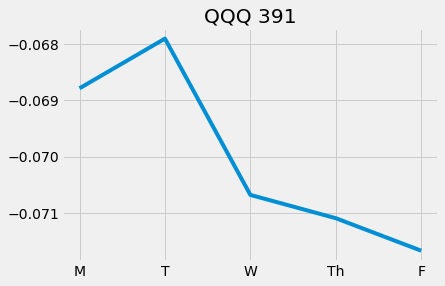

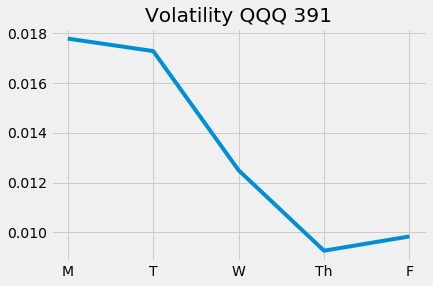

Epoch 393/5000
628/628 [==============================] - 1s 2ms/step - loss: 1.0010 - val_loss: 1.1330


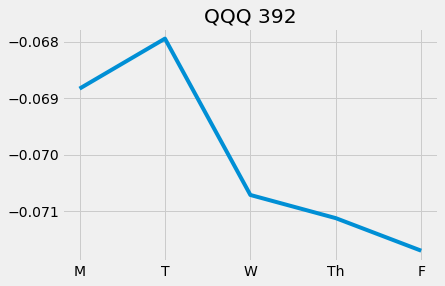

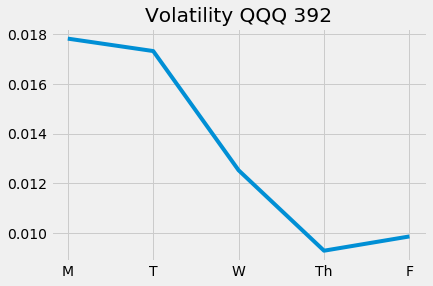

Epoch 394/5000
628/628 [==============================] - 1s 2ms/step - loss: 0.9946 - val_loss: 1.1328


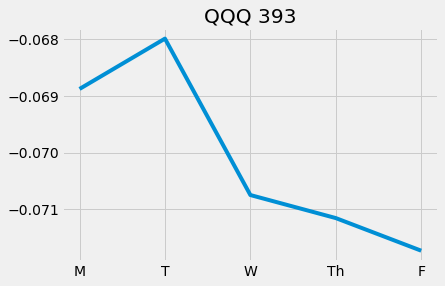

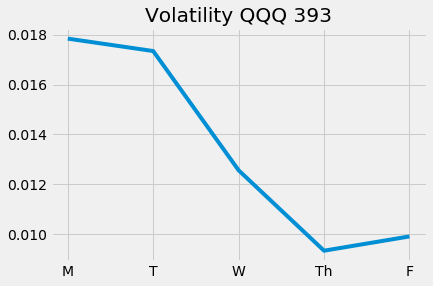

Epoch 395/5000
628/628 [==============================] - 1s 2ms/step - loss: 0.9918 - val_loss: 1.1326


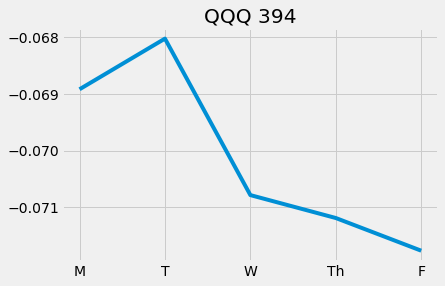

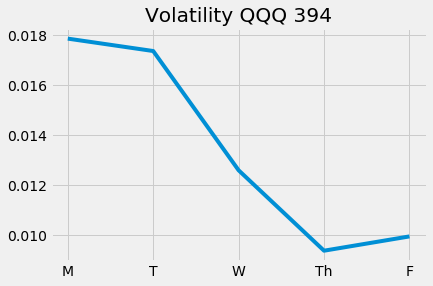

Epoch 396/5000
628/628 [==============================] - 1s 2ms/step - loss: 0.9980 - val_loss: 1.1324


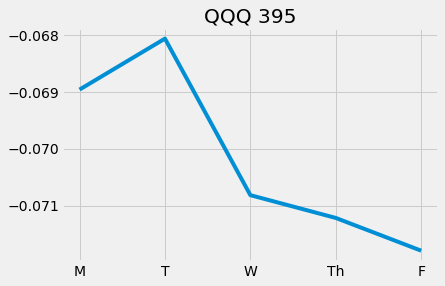

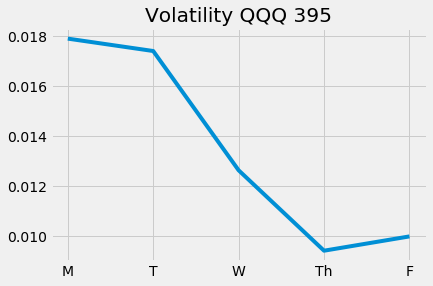

Epoch 397/5000
628/628 [==============================] - 1s 2ms/step - loss: 0.9918 - val_loss: 1.1322


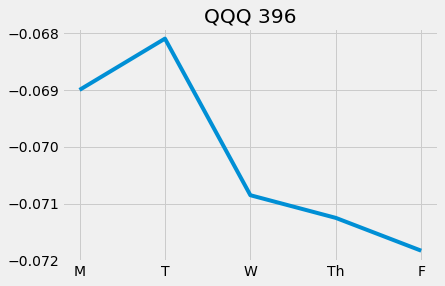

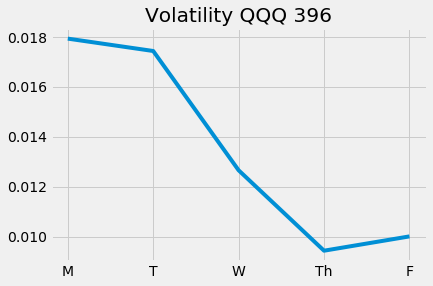

Epoch 398/5000
628/628 [==============================] - 1s 2ms/step - loss: 0.9947 - val_loss: 1.1321


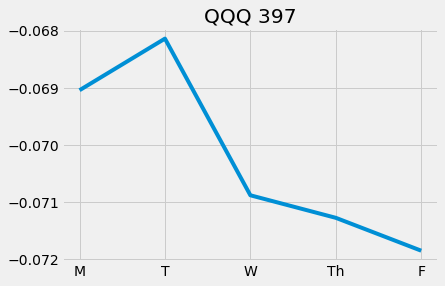

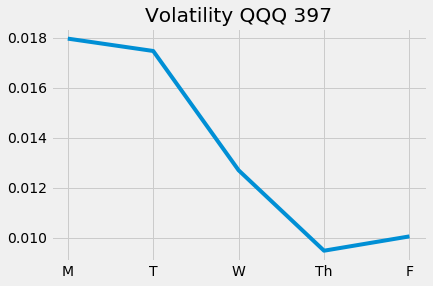

Epoch 399/5000
628/628 [==============================] - 1s 2ms/step - loss: 0.9963 - val_loss: 1.1319


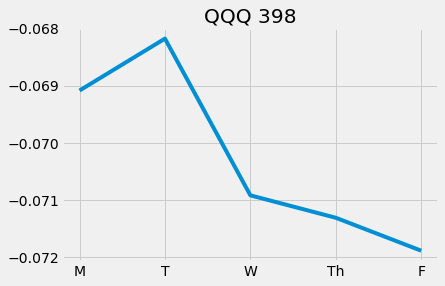

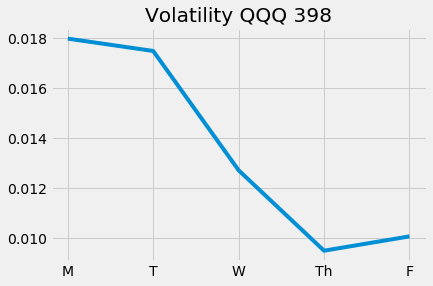

Epoch 400/5000
628/628 [==============================] - 1s 2ms/step - loss: 0.9993 - val_loss: 1.1317

Epoch 00400: ReduceLROnPlateau reducing learning rate to 1.8626452377018543e-12.


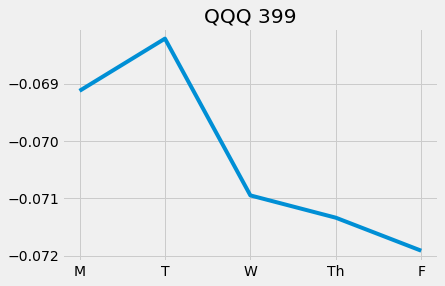

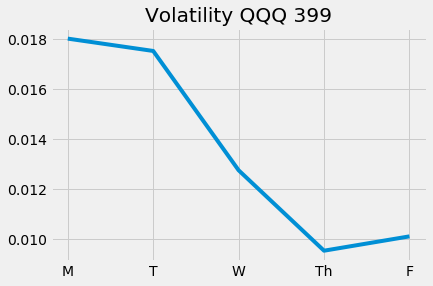

Epoch 401/5000
628/628 [==============================] - 1s 2ms/step - loss: 0.9994 - val_loss: 1.1316


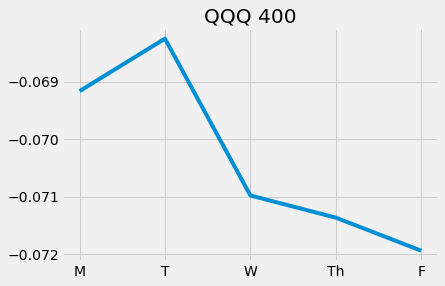

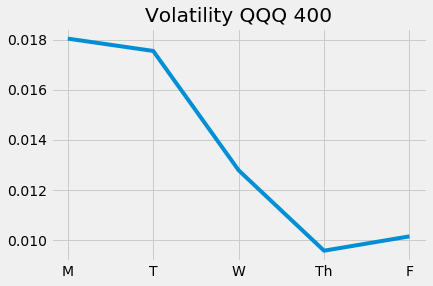

Epoch 402/5000
628/628 [==============================] - 1s 2ms/step - loss: 0.9905 - val_loss: 1.1314


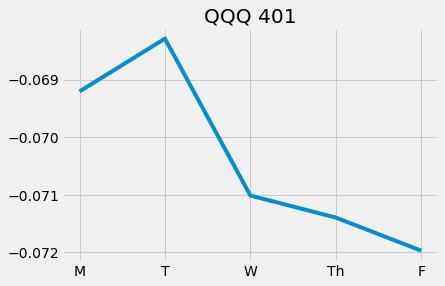

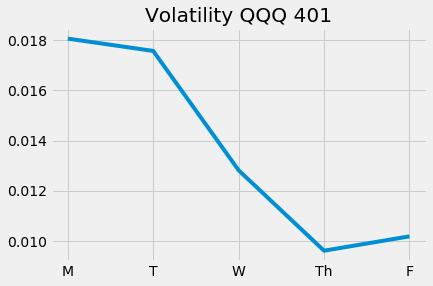

Epoch 403/5000
628/628 [==============================] - 1s 2ms/step - loss: 0.9945 - val_loss: 1.1312


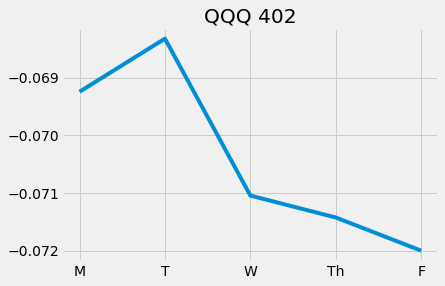

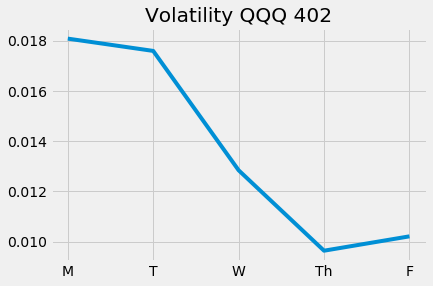

Epoch 404/5000
628/628 [==============================] - 1s 2ms/step - loss: 0.9913 - val_loss: 1.1311


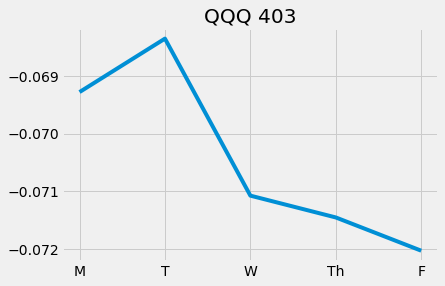

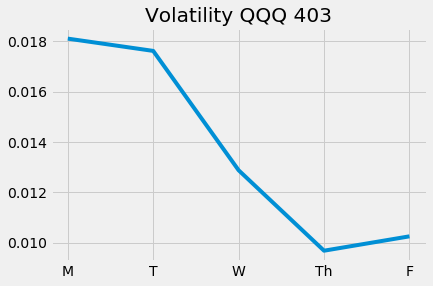

Epoch 405/5000
628/628 [==============================] - 1s 2ms/step - loss: 0.9982 - val_loss: 1.1309


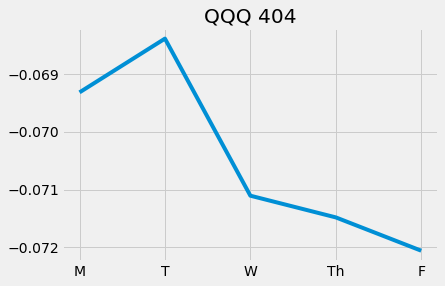

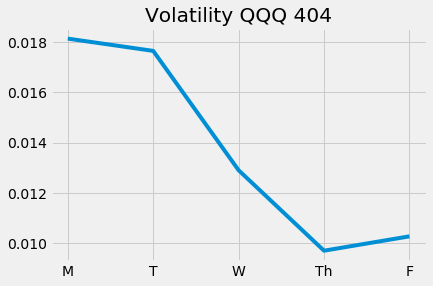

Epoch 406/5000
628/628 [==============================] - 1s 2ms/step - loss: 0.9885 - val_loss: 1.1307

Epoch 00406: ReduceLROnPlateau reducing learning rate to 9.313226188509272e-13.


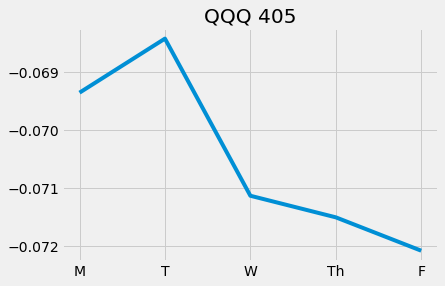

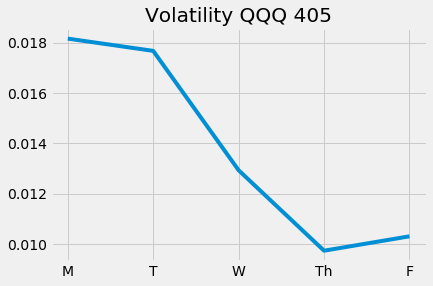

Epoch 407/5000
628/628 [==============================] - 1s 2ms/step - loss: 0.9968 - val_loss: 1.1306


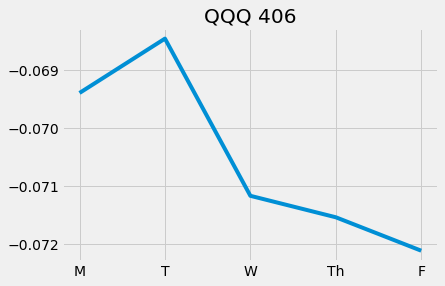

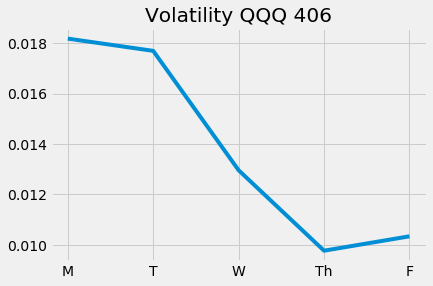

Epoch 408/5000
628/628 [==============================] - 1s 2ms/step - loss: 0.9951 - val_loss: 1.1304


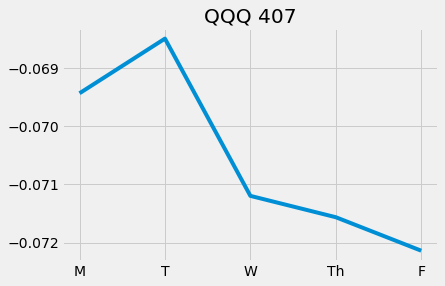

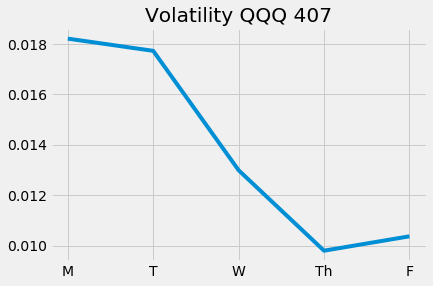

Epoch 409/5000
628/628 [==============================] - 1s 2ms/step - loss: 0.9983 - val_loss: 1.1303


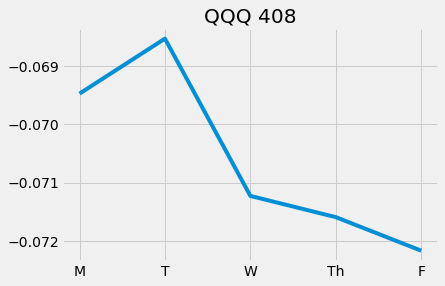

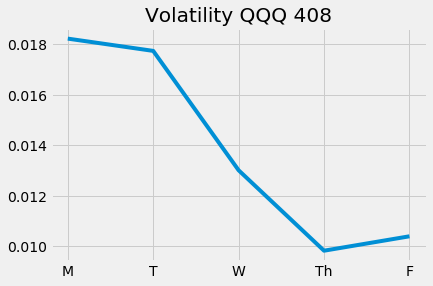

Epoch 410/5000
628/628 [==============================] - 1s 2ms/step - loss: 0.9995 - val_loss: 1.1301


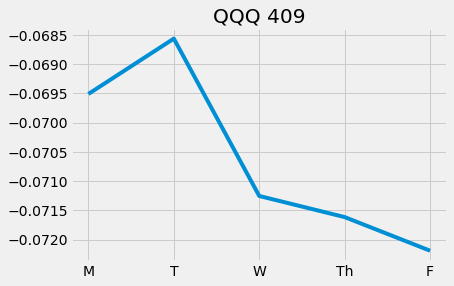

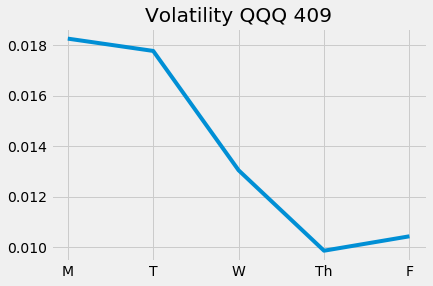

Epoch 411/5000
628/628 [==============================] - 1s 2ms/step - loss: 0.9961 - val_loss: 1.1300


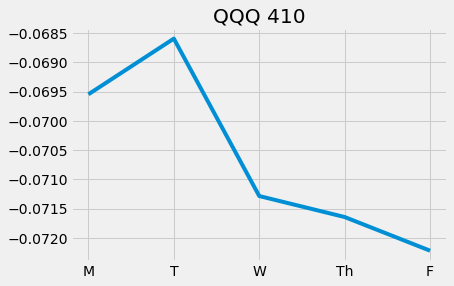

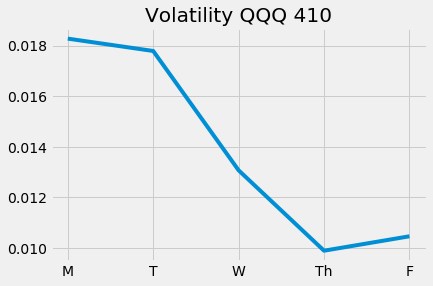

Epoch 412/5000
628/628 [==============================] - 1s 2ms/step - loss: 1.0028 - val_loss: 1.1298


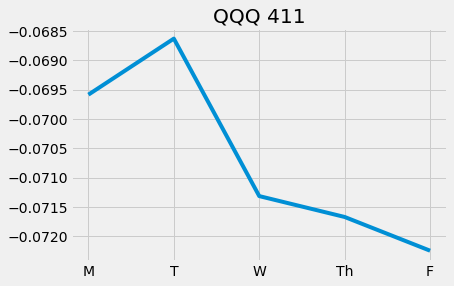

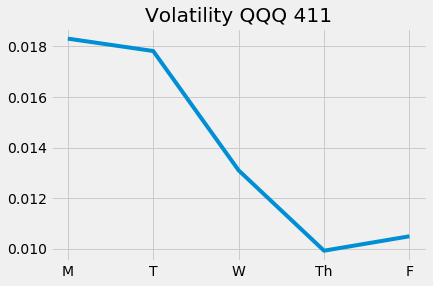

Epoch 413/5000
628/628 [==============================] - 1s 2ms/step - loss: 0.9976 - val_loss: 1.1297


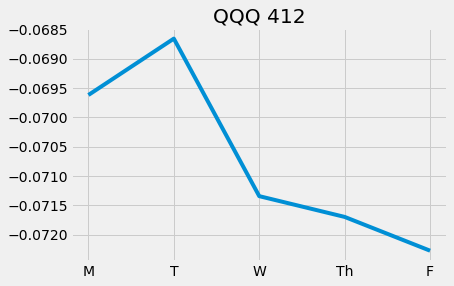

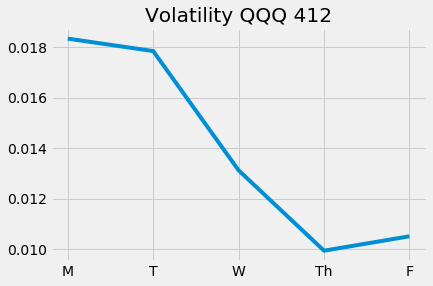

Epoch 414/5000
628/628 [==============================] - 1s 2ms/step - loss: 0.9951 - val_loss: 1.1295


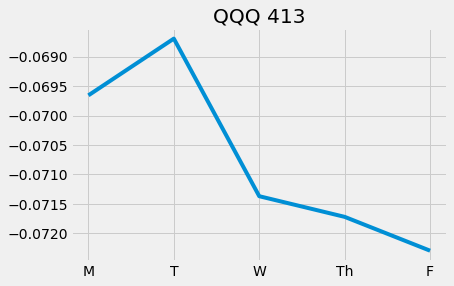

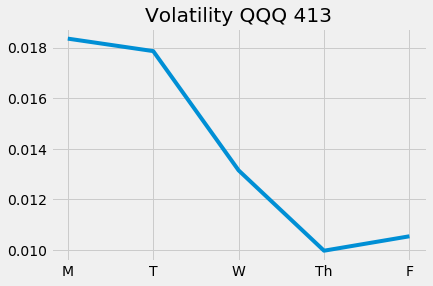

Epoch 415/5000
628/628 [==============================] - 1s 2ms/step - loss: 0.9922 - val_loss: 1.1294

Epoch 00415: ReduceLROnPlateau reducing learning rate to 4.656613094254636e-13.


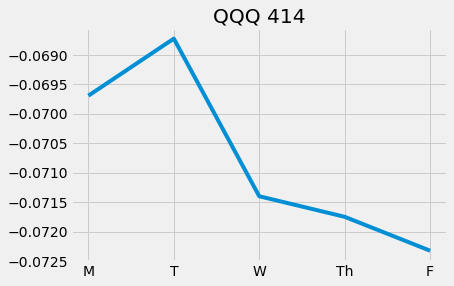

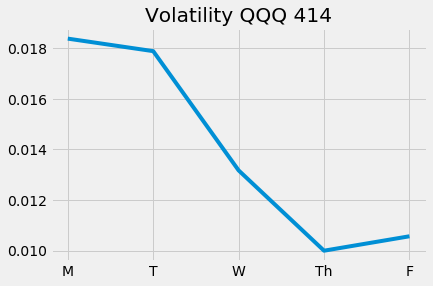

Epoch 416/5000
628/628 [==============================] - 1s 2ms/step - loss: 0.9961 - val_loss: 1.1293


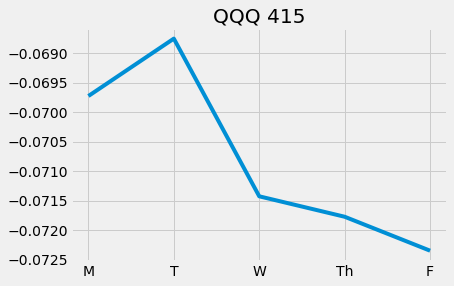

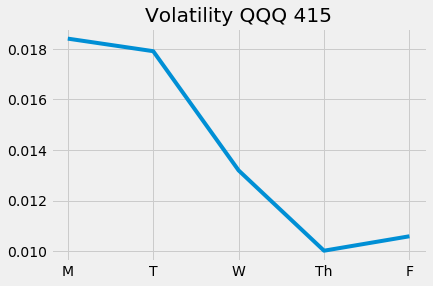

Epoch 417/5000
628/628 [==============================] - 1s 2ms/step - loss: 1.0056 - val_loss: 1.1291


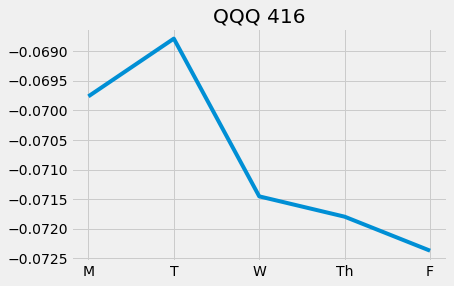

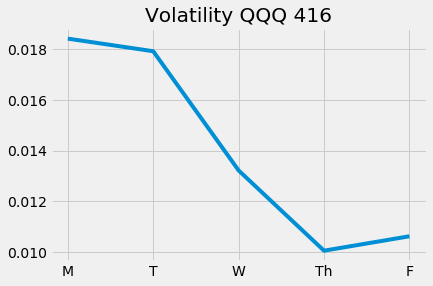

Epoch 418/5000
628/628 [==============================] - 1s 2ms/step - loss: 0.9930 - val_loss: 1.1290


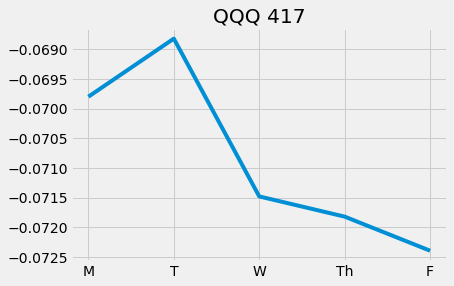

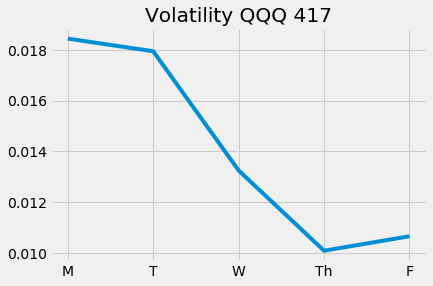

Epoch 419/5000
628/628 [==============================] - 1s 2ms/step - loss: 0.9982 - val_loss: 1.1289


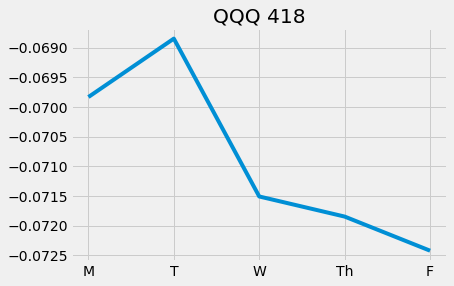

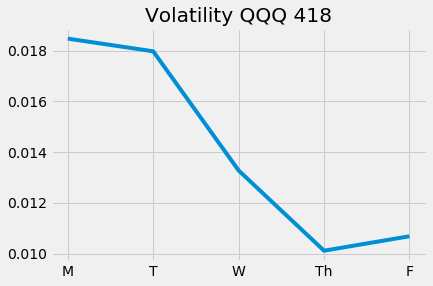

Epoch 420/5000
628/628 [==============================] - 1s 2ms/step - loss: 0.9939 - val_loss: 1.1287


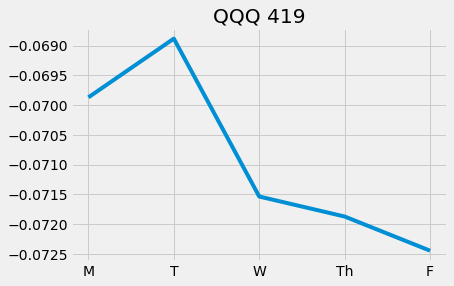

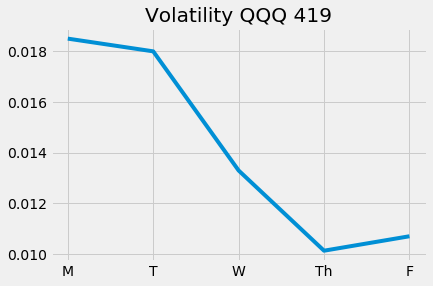

Epoch 421/5000
628/628 [==============================] - 1s 2ms/step - loss: 0.9981 - val_loss: 1.1286

Epoch 00421: ReduceLROnPlateau reducing learning rate to 2.328306547127318e-13.


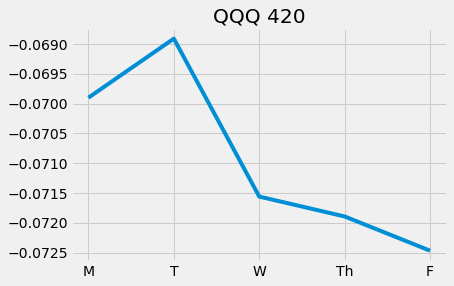

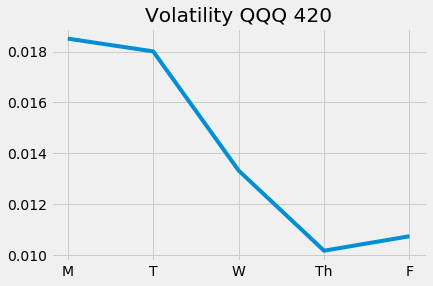

Epoch 422/5000
628/628 [==============================] - 1s 2ms/step - loss: 0.9977 - val_loss: 1.1285


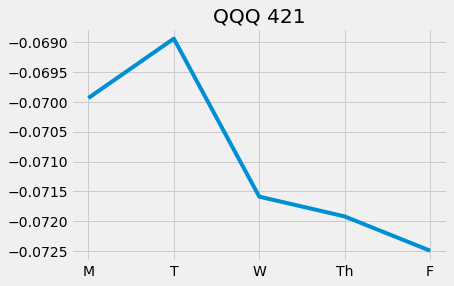

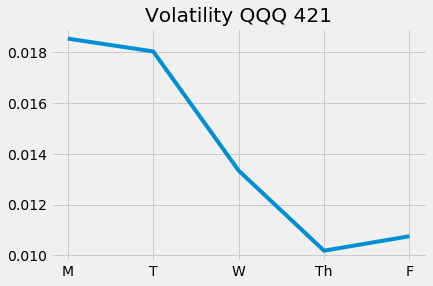

Epoch 423/5000
628/628 [==============================] - 2s 3ms/step - loss: 0.9974 - val_loss: 1.1283


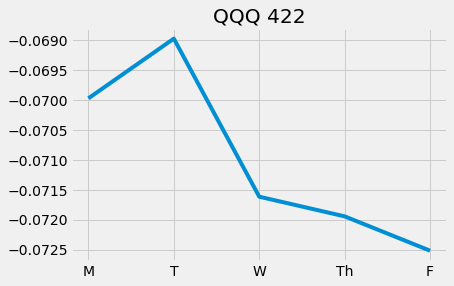

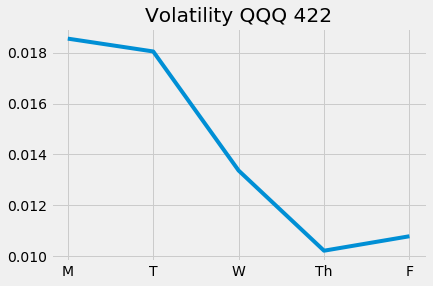

Epoch 424/5000
628/628 [==============================] - 1s 2ms/step - loss: 0.9907 - val_loss: 1.1282


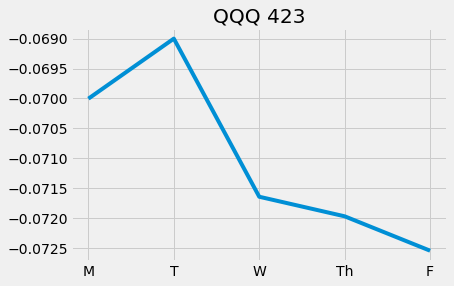

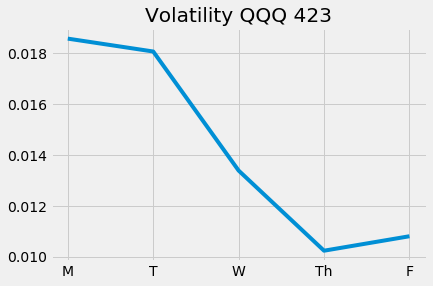

Epoch 425/5000
628/628 [==============================] - 2s 3ms/step - loss: 0.9963 - val_loss: 1.1281


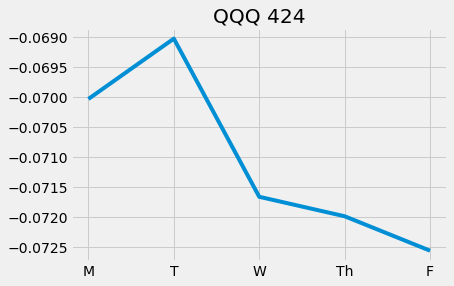

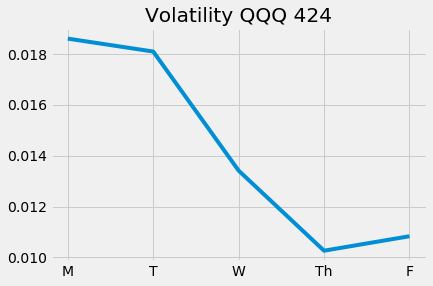

Epoch 426/5000
628/628 [==============================] - 2s 2ms/step - loss: 0.9941 - val_loss: 1.1280


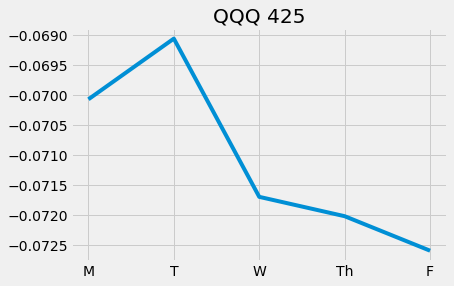

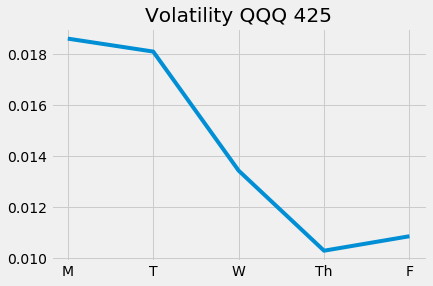

Epoch 427/5000
628/628 [==============================] - 1s 2ms/step - loss: 0.9972 - val_loss: 1.1278


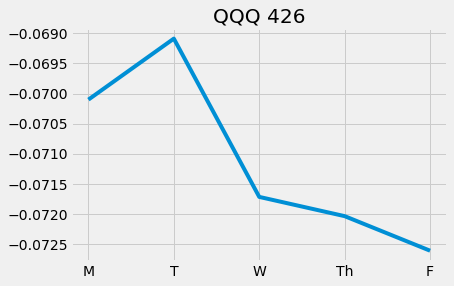

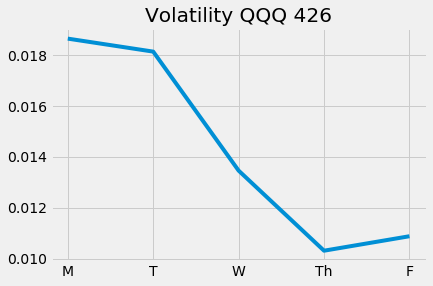

Epoch 428/5000
628/628 [==============================] - 2s 3ms/step - loss: 0.9990 - val_loss: 1.1277


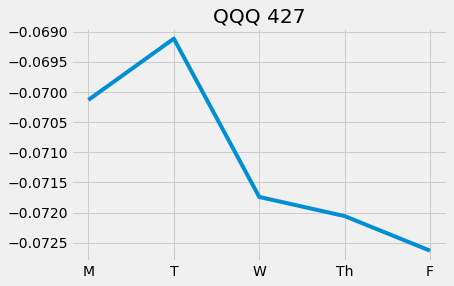

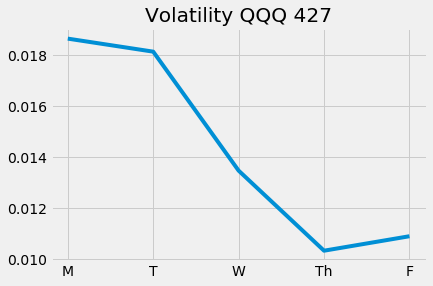

Epoch 429/5000
628/628 [==============================] - 2s 3ms/step - loss: 0.9936 - val_loss: 1.1276


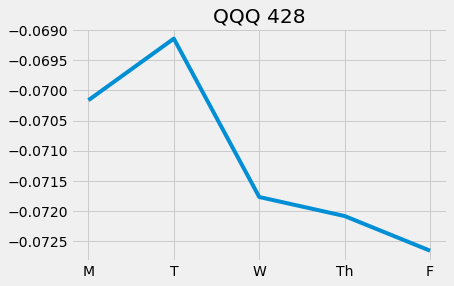

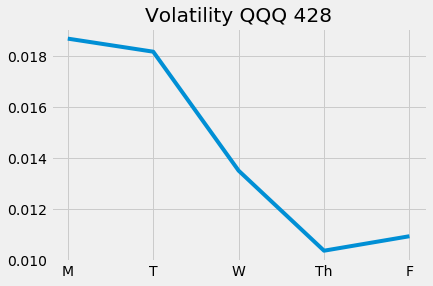

Epoch 430/5000
628/628 [==============================] - 2s 2ms/step - loss: 0.9991 - val_loss: 1.1275

Epoch 00430: ReduceLROnPlateau reducing learning rate to 1.164153273563659e-13.


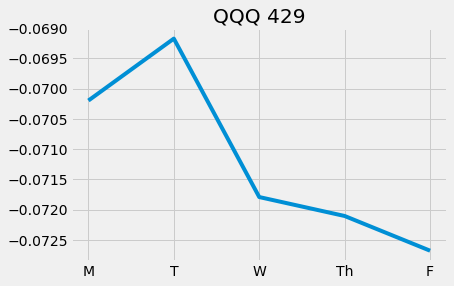

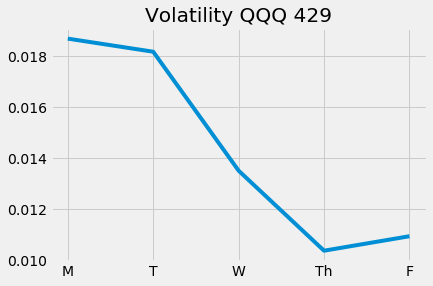

Epoch 431/5000
628/628 [==============================] - 2s 3ms/step - loss: 0.9918 - val_loss: 1.1274


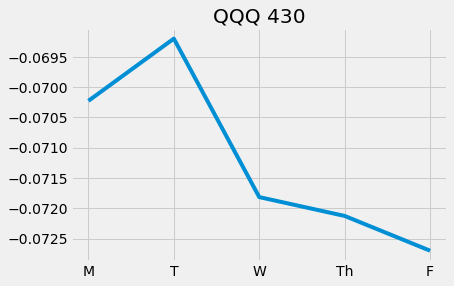

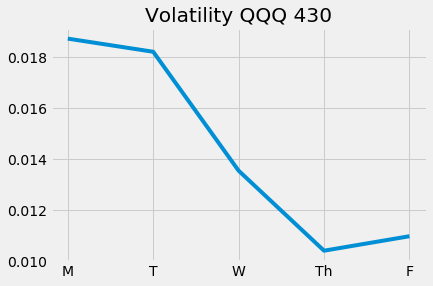

Epoch 432/5000
628/628 [==============================] - 1s 2ms/step - loss: 0.9935 - val_loss: 1.1272


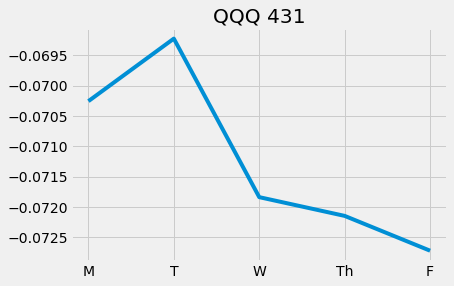

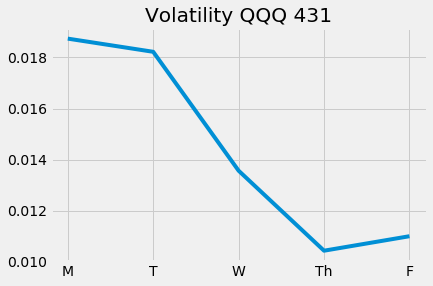

Epoch 433/5000
628/628 [==============================] - 2s 3ms/step - loss: 0.9991 - val_loss: 1.1271


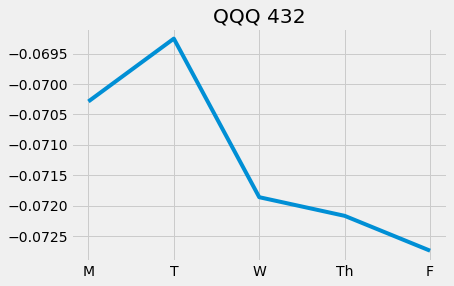

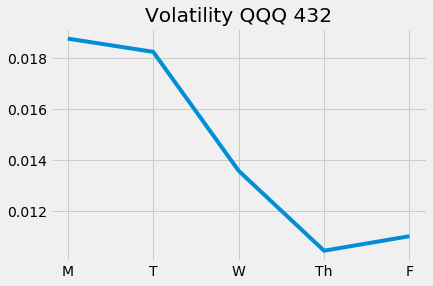

Epoch 434/5000
628/628 [==============================] - 1s 2ms/step - loss: 0.9939 - val_loss: 1.1270


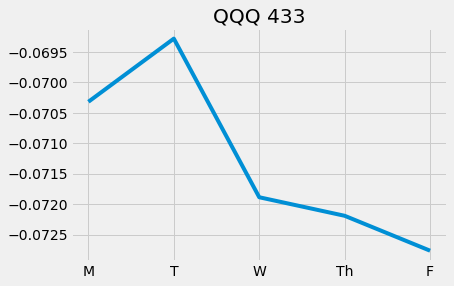

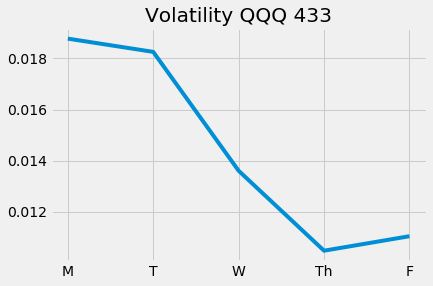

Epoch 435/5000
628/628 [==============================] - 1s 2ms/step - loss: 1.0040 - val_loss: 1.1269


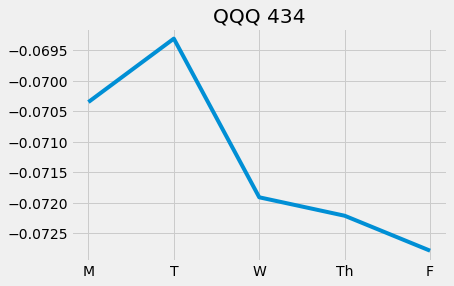

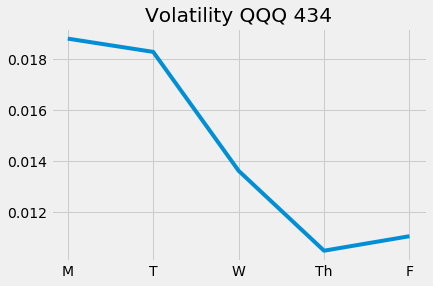

Epoch 436/5000
628/628 [==============================] - 1s 2ms/step - loss: 0.9932 - val_loss: 1.1268

Epoch 00436: ReduceLROnPlateau reducing learning rate to 5.820766367818295e-14.


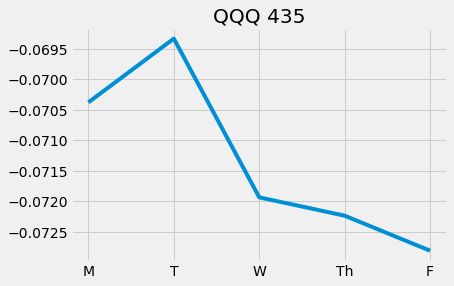

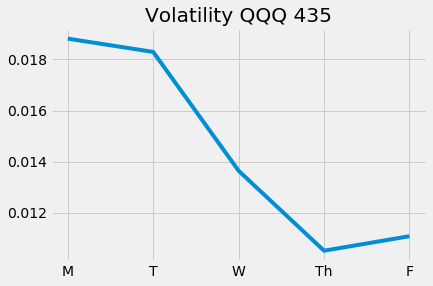

Epoch 437/5000
628/628 [==============================] - 1s 2ms/step - loss: 0.9992 - val_loss: 1.1267


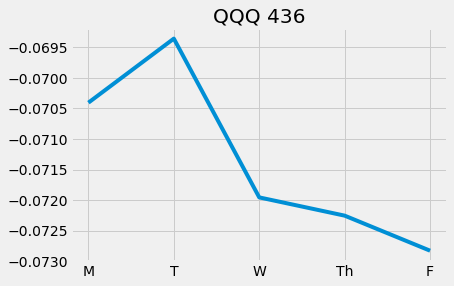

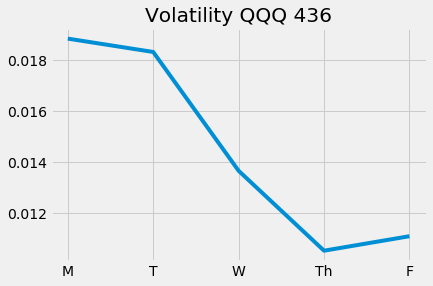

Epoch 438/5000
628/628 [==============================] - 1s 2ms/step - loss: 0.9955 - val_loss: 1.1266


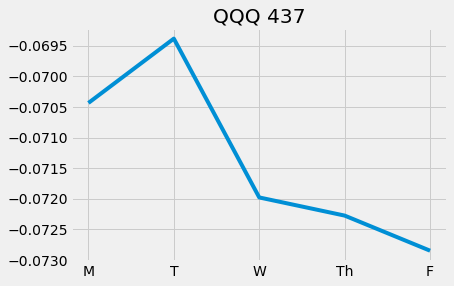

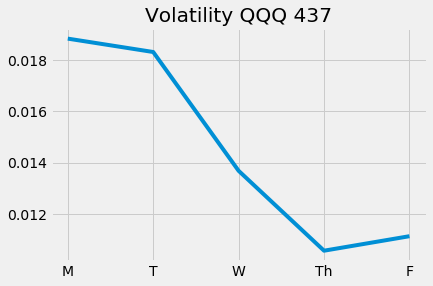

Epoch 439/5000
628/628 [==============================] - 1s 2ms/step - loss: 0.9968 - val_loss: 1.1265


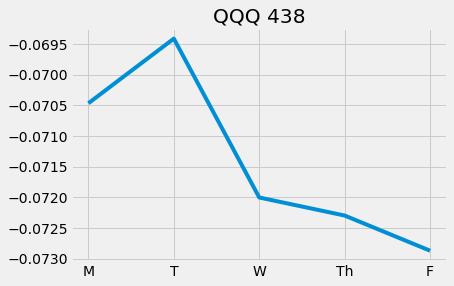

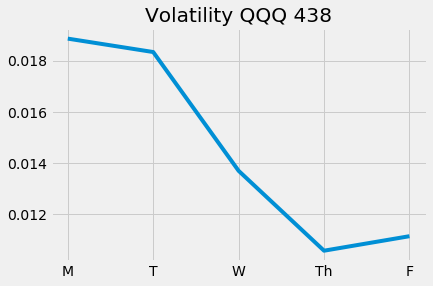

Epoch 440/5000
628/628 [==============================] - 1s 2ms/step - loss: 0.9968 - val_loss: 1.1264


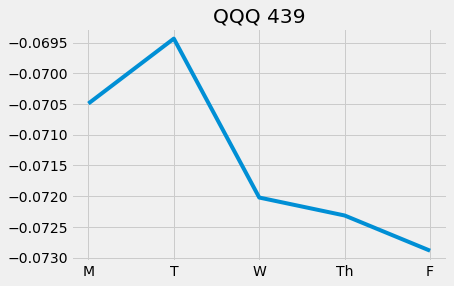

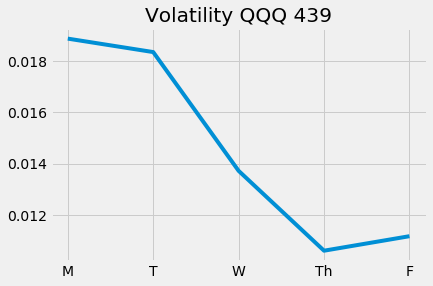

Epoch 441/5000
628/628 [==============================] - 1s 2ms/step - loss: 0.9963 - val_loss: 1.1263


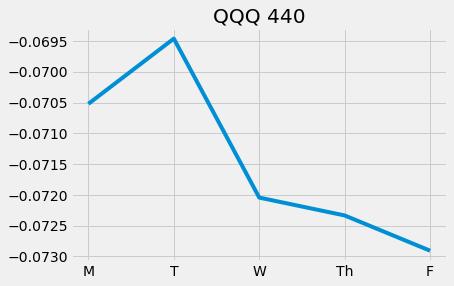

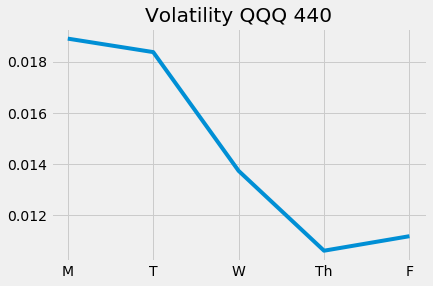

Epoch 442/5000
628/628 [==============================] - 1s 2ms/step - loss: 1.0018 - val_loss: 1.1262


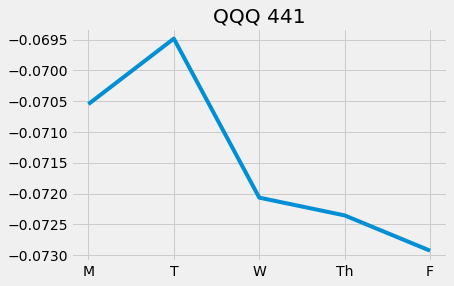

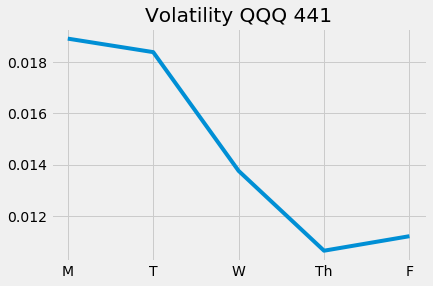

Epoch 443/5000
628/628 [==============================] - 1s 2ms/step - loss: 0.9968 - val_loss: 1.1261


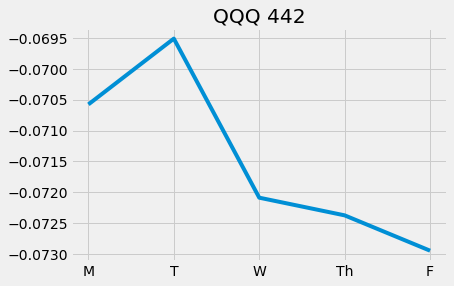

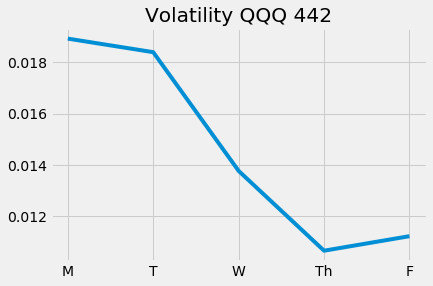

Epoch 444/5000
628/628 [==============================] - 1s 2ms/step - loss: 0.9970 - val_loss: 1.1260


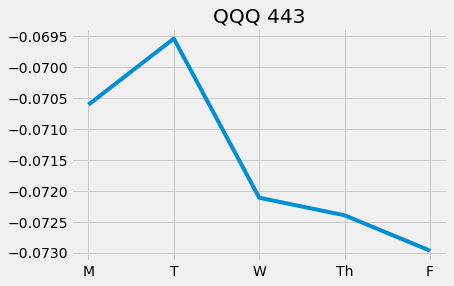

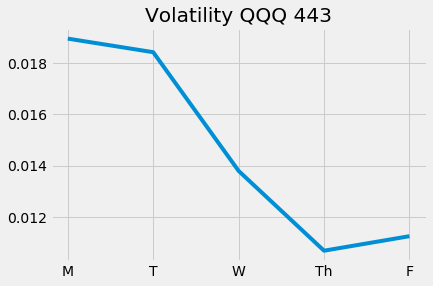

Epoch 445/5000
628/628 [==============================] - 1s 2ms/step - loss: 0.9959 - val_loss: 1.1259

Epoch 00445: ReduceLROnPlateau reducing learning rate to 2.9103831839091474e-14.


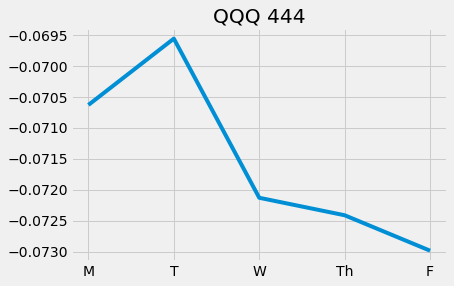

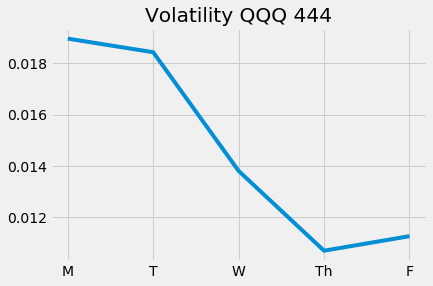

Epoch 446/5000
628/628 [==============================] - 1s 2ms/step - loss: 1.0015 - val_loss: 1.1258


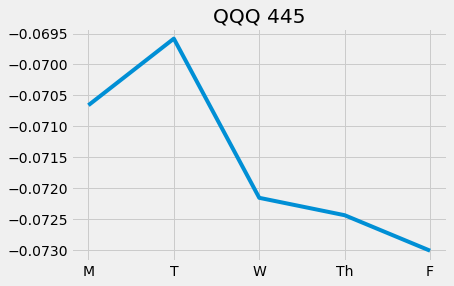

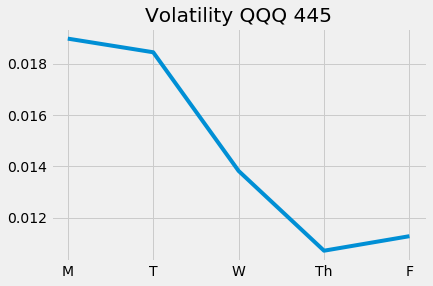

Epoch 447/5000
628/628 [==============================] - 1s 2ms/step - loss: 0.9964 - val_loss: 1.1257


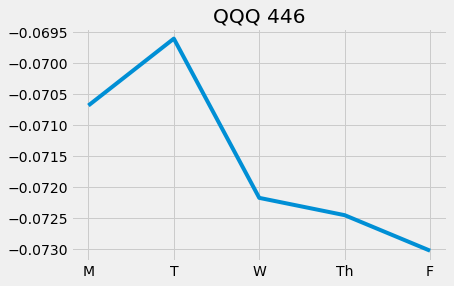

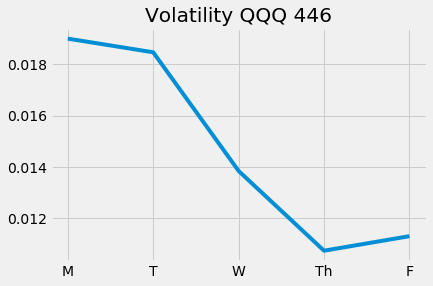

Epoch 448/5000
628/628 [==============================] - 1s 2ms/step - loss: 0.9992 - val_loss: 1.1256


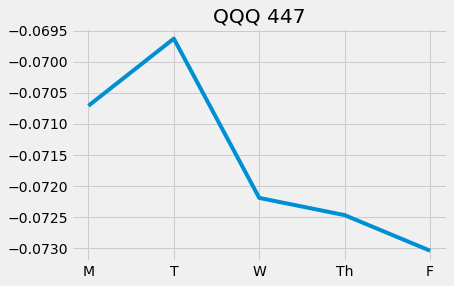

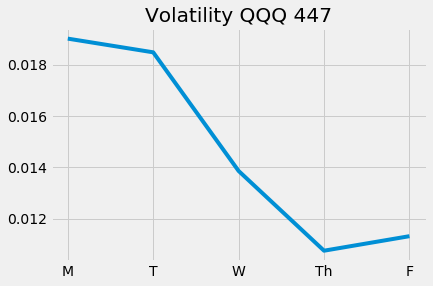

Epoch 449/5000
628/628 [==============================] - 1s 2ms/step - loss: 0.9972 - val_loss: 1.1255


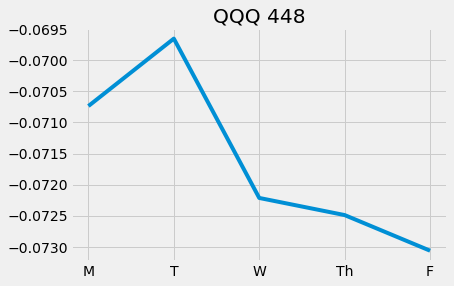

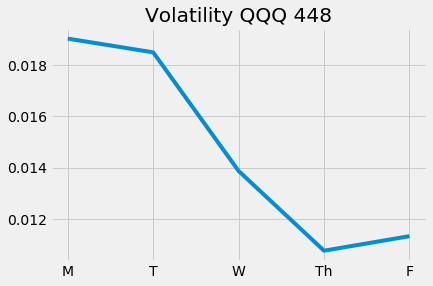

Epoch 450/5000
628/628 [==============================] - 1s 2ms/step - loss: 1.0017 - val_loss: 1.1254


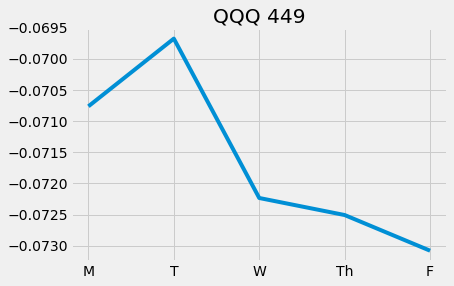

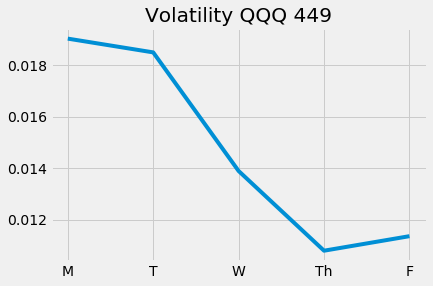

Epoch 451/5000
628/628 [==============================] - 1s 2ms/step - loss: 0.9979 - val_loss: 1.1253

Epoch 00451: ReduceLROnPlateau reducing learning rate to 1.4551915919545737e-14.


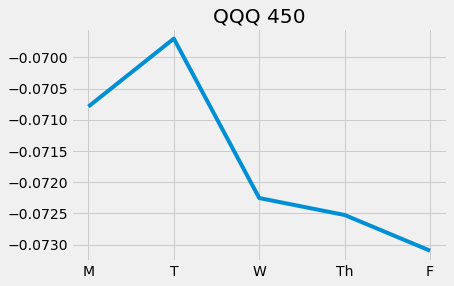

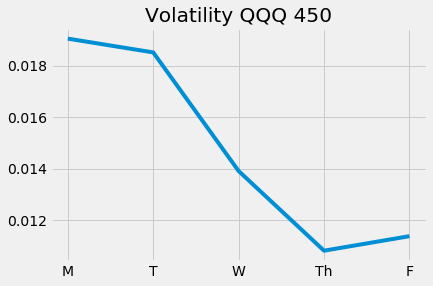

Epoch 452/5000
628/628 [==============================] - 1s 2ms/step - loss: 0.9943 - val_loss: 1.1252


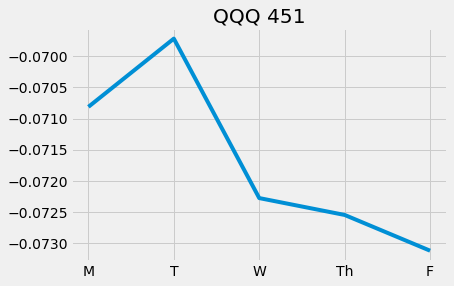

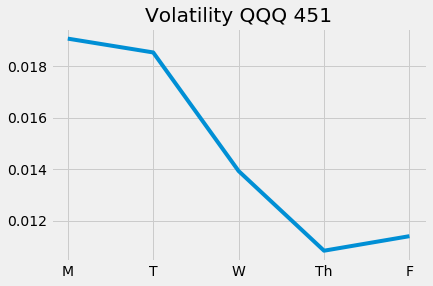

Epoch 453/5000
628/628 [==============================] - 1s 2ms/step - loss: 0.9964 - val_loss: 1.1251


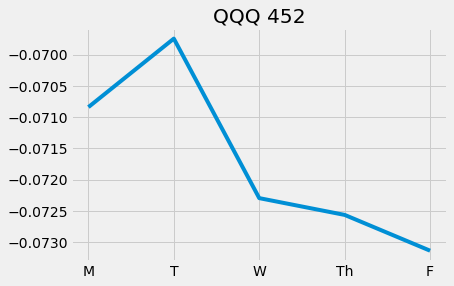

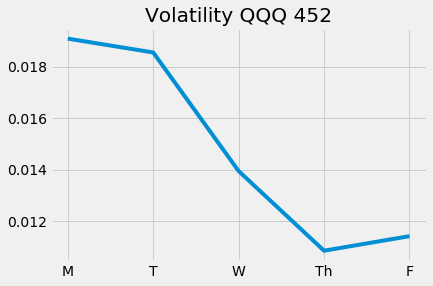

Epoch 454/5000
628/628 [==============================] - 1s 2ms/step - loss: 0.9971 - val_loss: 1.1250


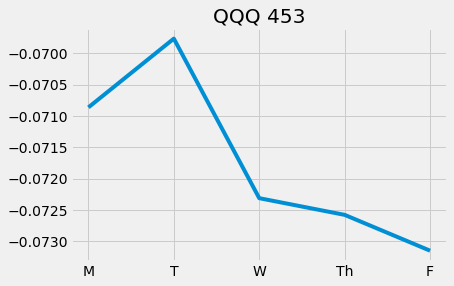

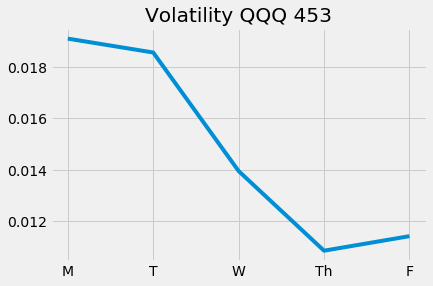

Epoch 455/5000
628/628 [==============================] - 1s 2ms/step - loss: 0.9964 - val_loss: 1.1249


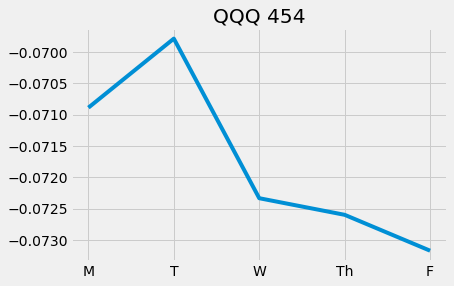

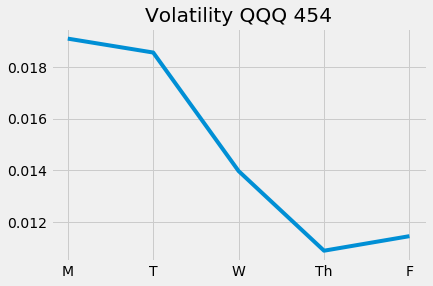

Epoch 456/5000
628/628 [==============================] - 1s 2ms/step - loss: 0.9950 - val_loss: 1.1248


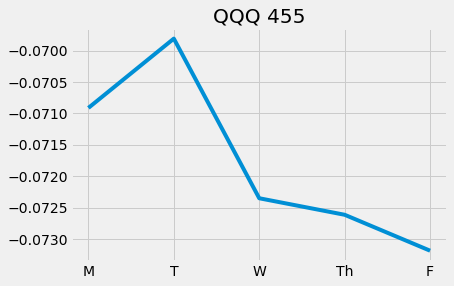

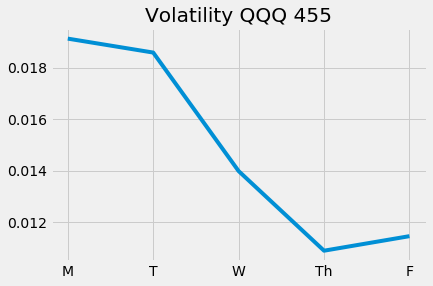

Epoch 457/5000
628/628 [==============================] - 1s 2ms/step - loss: 1.0039 - val_loss: 1.1248


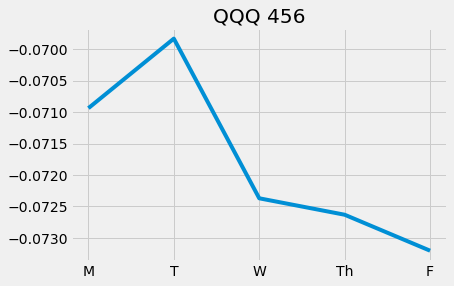

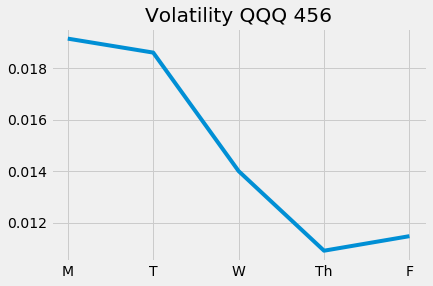

Epoch 458/5000
628/628 [==============================] - 1s 2ms/step - loss: 0.9976 - val_loss: 1.1247


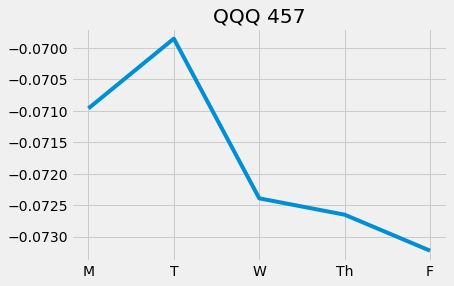

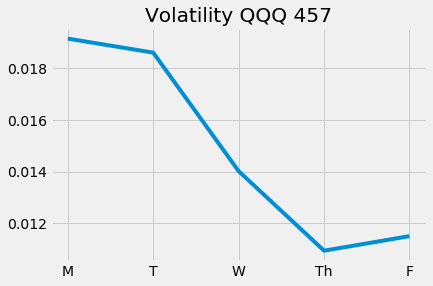

Epoch 459/5000
628/628 [==============================] - 1s 2ms/step - loss: 1.0004 - val_loss: 1.1246


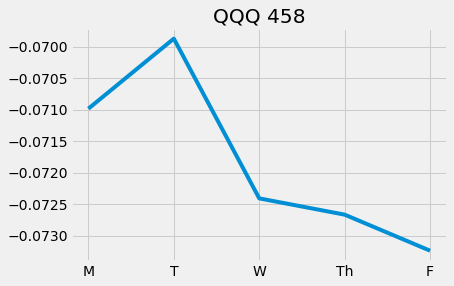

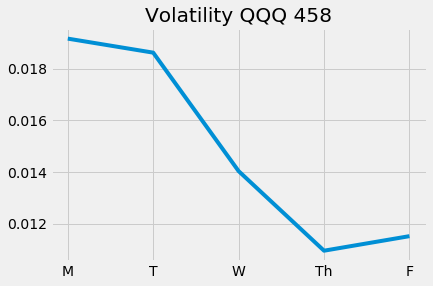

Epoch 460/5000
628/628 [==============================] - 1s 2ms/step - loss: 0.9940 - val_loss: 1.1245

Epoch 00460: ReduceLROnPlateau reducing learning rate to 7.275957959772868e-15.


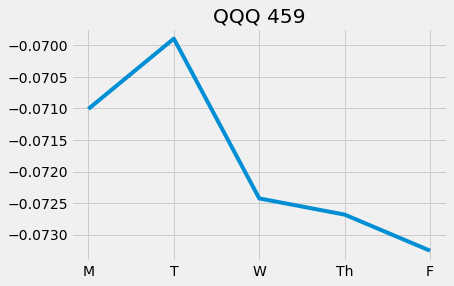

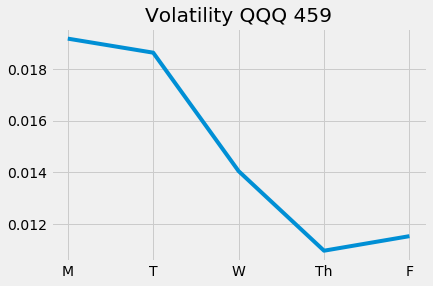

Epoch 461/5000
628/628 [==============================] - 1s 2ms/step - loss: 0.9937 - val_loss: 1.1244


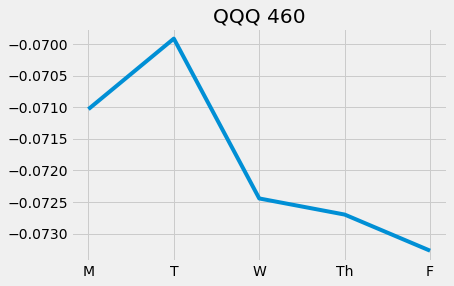

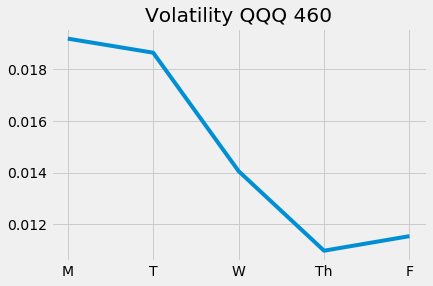

Epoch 462/5000
628/628 [==============================] - 1s 2ms/step - loss: 0.9977 - val_loss: 1.1243


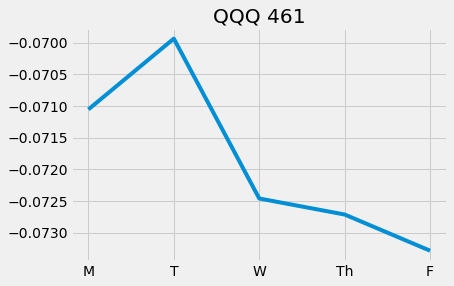

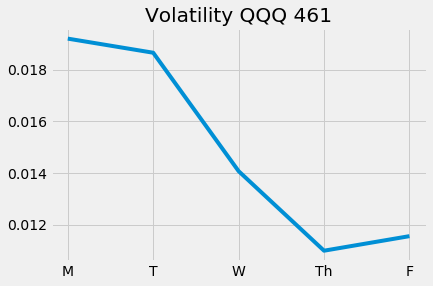

Epoch 463/5000
628/628 [==============================] - 1s 2ms/step - loss: 0.9980 - val_loss: 1.1243


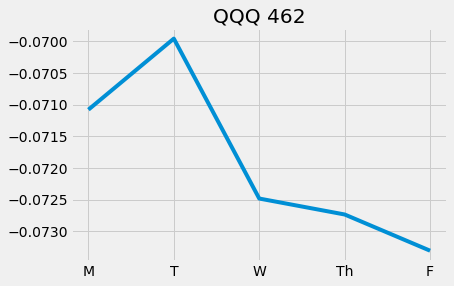

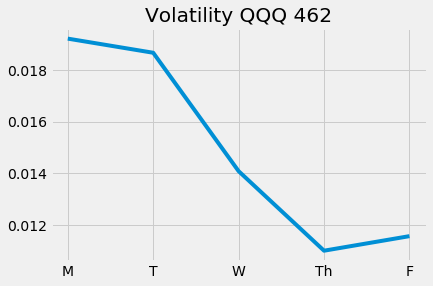

Epoch 464/5000
628/628 [==============================] - 1s 2ms/step - loss: 0.9995 - val_loss: 1.1242


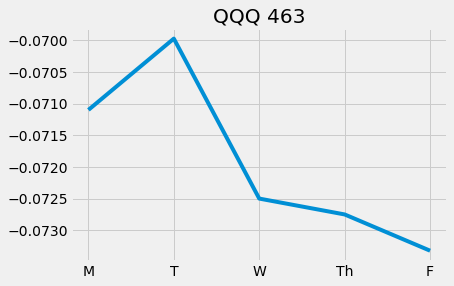

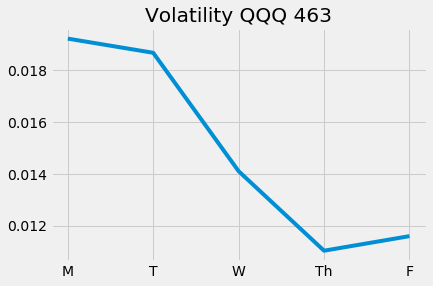

Epoch 465/5000
628/628 [==============================] - 1s 2ms/step - loss: 0.9968 - val_loss: 1.1241


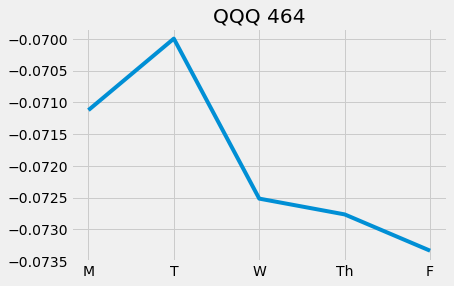

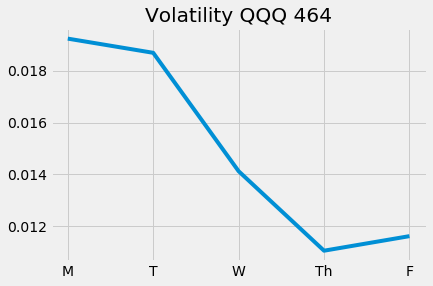

Epoch 466/5000
628/628 [==============================] - 1s 2ms/step - loss: 0.9950 - val_loss: 1.1240

Epoch 00466: ReduceLROnPlateau reducing learning rate to 3.637978979886434e-15.


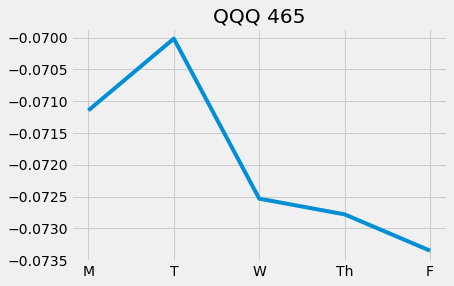

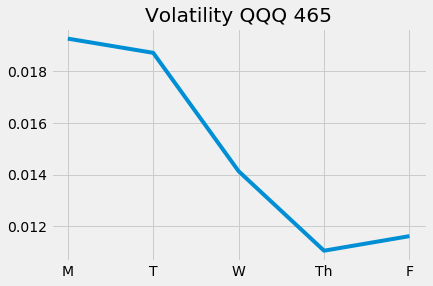

Epoch 467/5000
628/628 [==============================] - 1s 2ms/step - loss: 0.9973 - val_loss: 1.1240


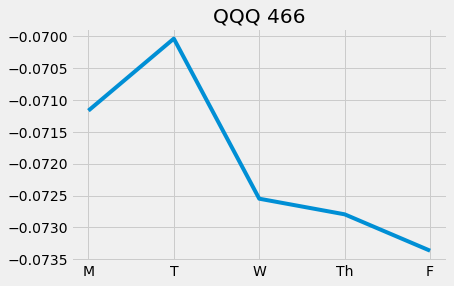

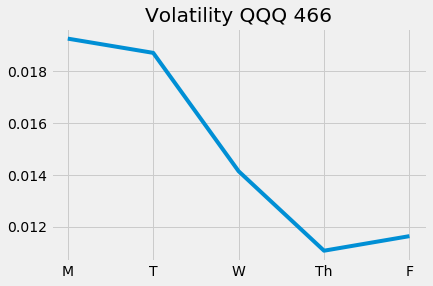

Epoch 468/5000
628/628 [==============================] - 1s 2ms/step - loss: 0.9938 - val_loss: 1.1239


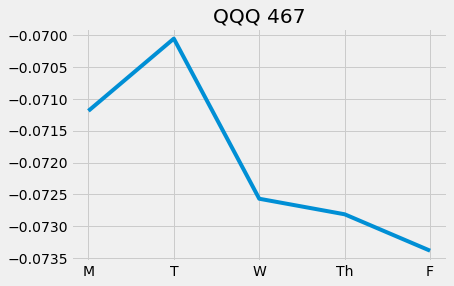

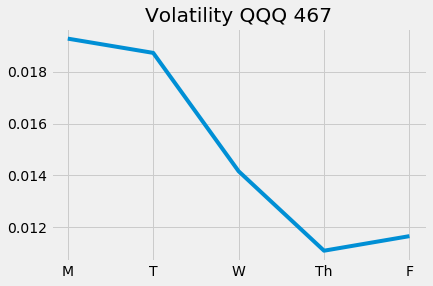

Epoch 469/5000
628/628 [==============================] - 1s 2ms/step - loss: 0.9964 - val_loss: 1.1238


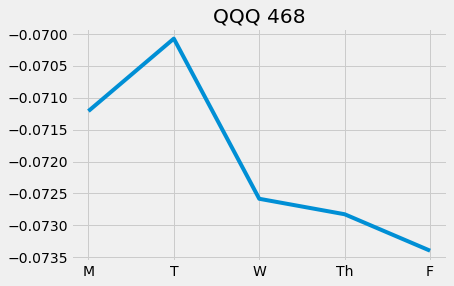

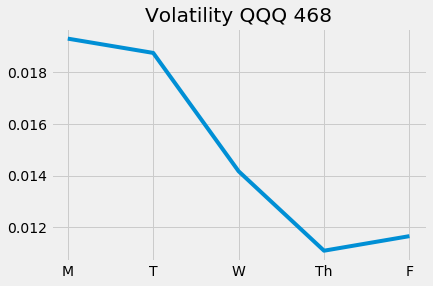

Epoch 470/5000
628/628 [==============================] - 1s 2ms/step - loss: 0.9979 - val_loss: 1.1237


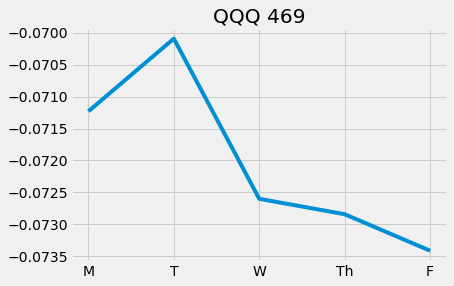

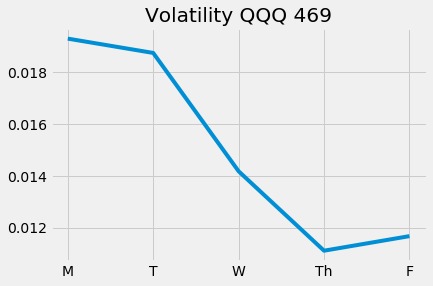

Epoch 471/5000
628/628 [==============================] - 1s 2ms/step - loss: 0.9910 - val_loss: 1.1237


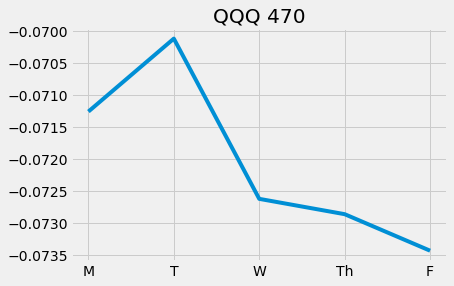

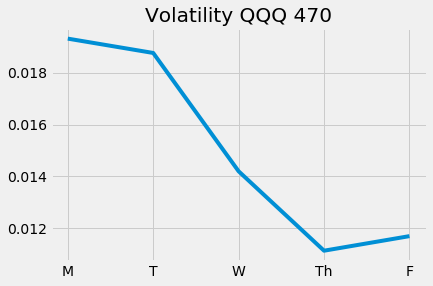

Epoch 472/5000
628/628 [==============================] - 1s 2ms/step - loss: 1.0025 - val_loss: 1.1236


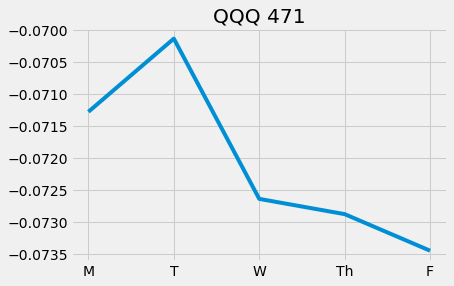

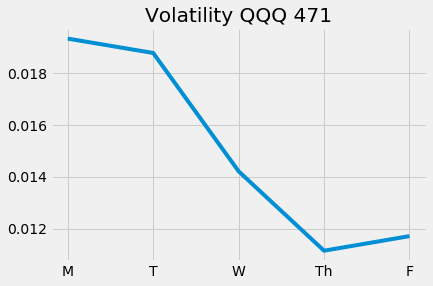

Epoch 473/5000
628/628 [==============================] - 1s 2ms/step - loss: 0.9924 - val_loss: 1.1235


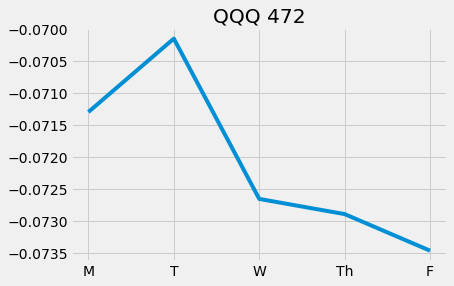

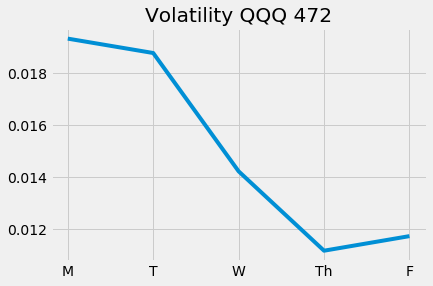

Epoch 474/5000
628/628 [==============================] - 1s 2ms/step - loss: 0.9945 - val_loss: 1.1234


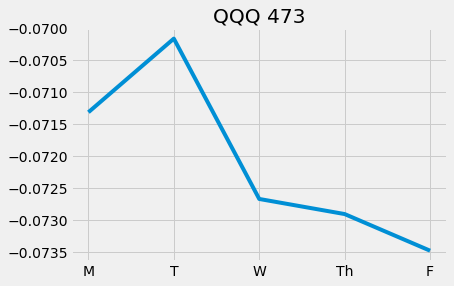

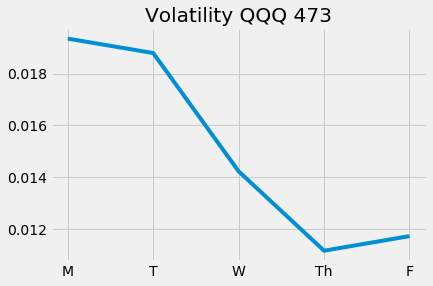

Epoch 475/5000
628/628 [==============================] - 1s 2ms/step - loss: 0.9919 - val_loss: 1.1234

Epoch 00475: ReduceLROnPlateau reducing learning rate to 1.818989489943217e-15.


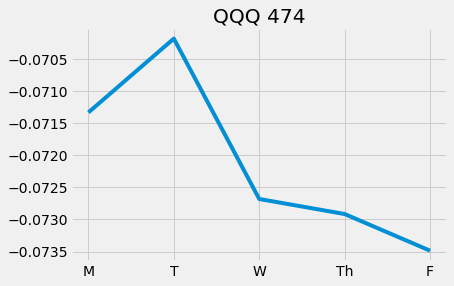

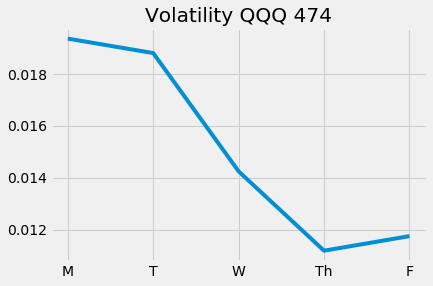

Epoch 476/5000
628/628 [==============================] - 1s 2ms/step - loss: 0.9936 - val_loss: 1.1233


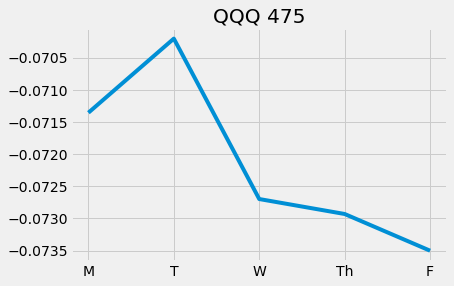

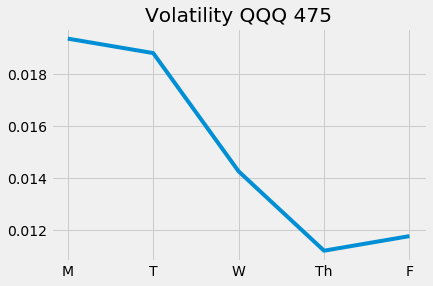

Epoch 477/5000
628/628 [==============================] - 1s 2ms/step - loss: 0.9996 - val_loss: 1.1232


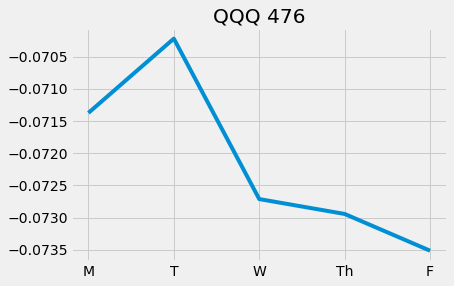

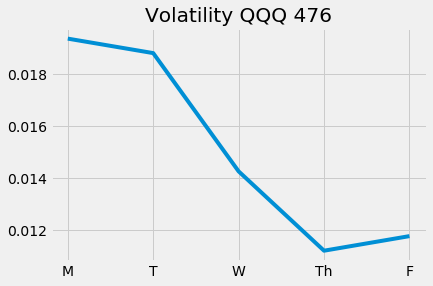

Epoch 478/5000
628/628 [==============================] - 1s 2ms/step - loss: 0.9888 - val_loss: 1.1232


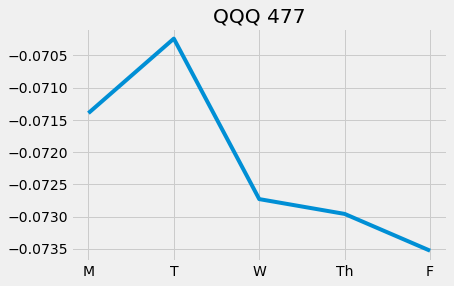

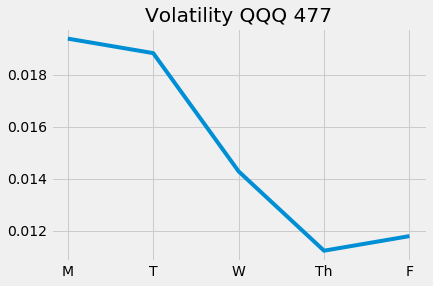

Epoch 479/5000
628/628 [==============================] - 1s 2ms/step - loss: 0.9960 - val_loss: 1.1231


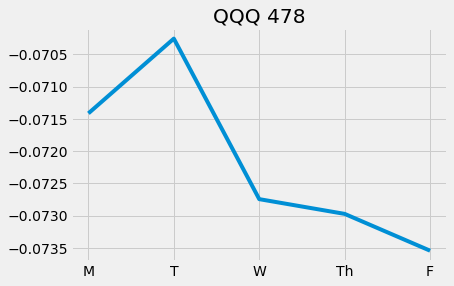

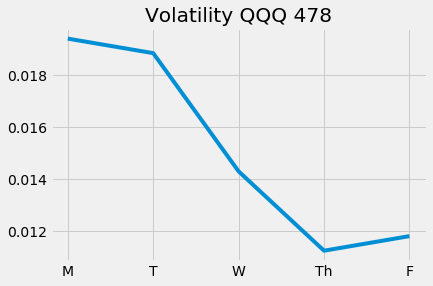

Epoch 480/5000
628/628 [==============================] - 1s 2ms/step - loss: 1.0034 - val_loss: 1.1230


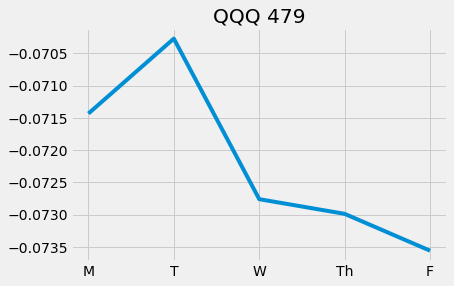

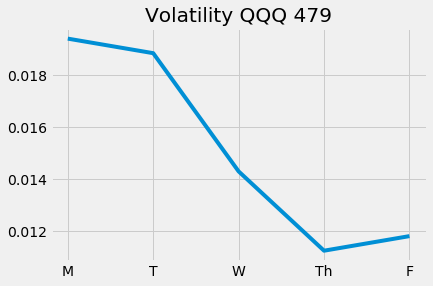

Epoch 481/5000
628/628 [==============================] - 1s 2ms/step - loss: 0.9912 - val_loss: 1.1230

Epoch 00481: ReduceLROnPlateau reducing learning rate to 9.094947449716085e-16.


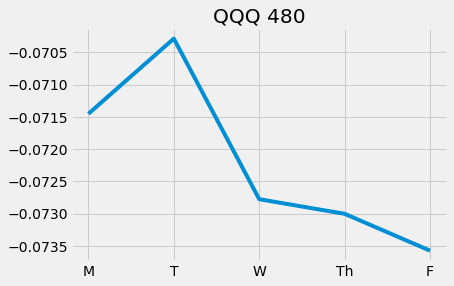

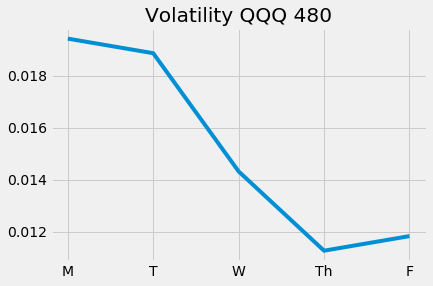

Epoch 482/5000
628/628 [==============================] - 1s 2ms/step - loss: 0.9993 - val_loss: 1.1229


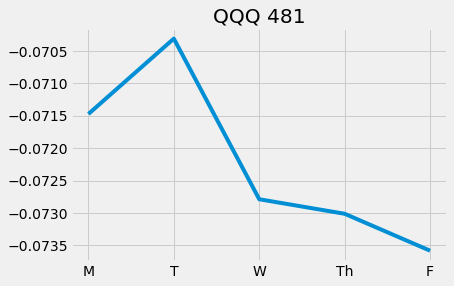

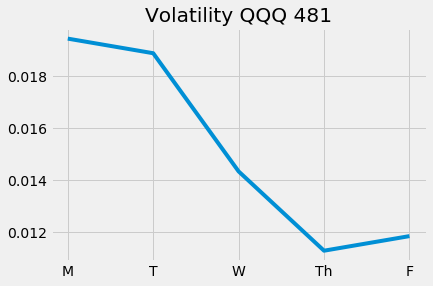

Epoch 483/5000
628/628 [==============================] - 1s 2ms/step - loss: 0.9987 - val_loss: 1.1228


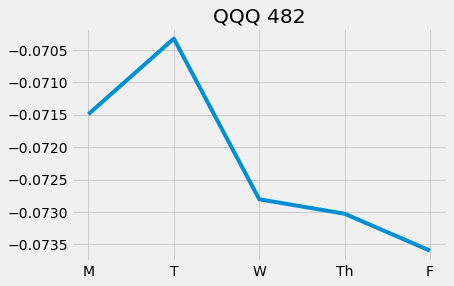

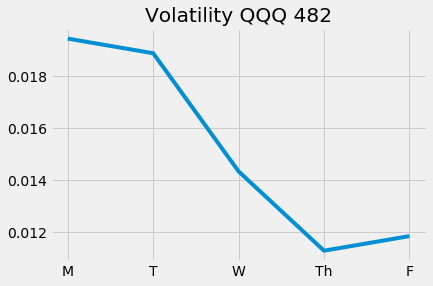

Epoch 484/5000
628/628 [==============================] - 1s 2ms/step - loss: 0.9904 - val_loss: 1.1228


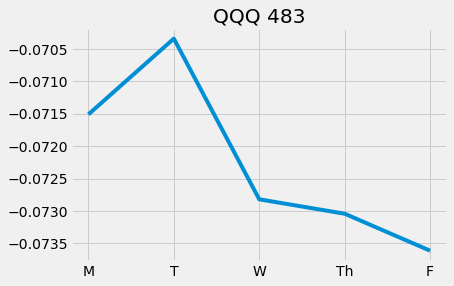

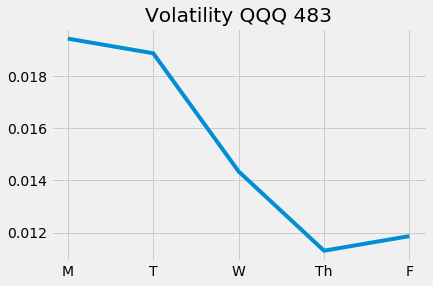

Epoch 485/5000
628/628 [==============================] - 1s 2ms/step - loss: 0.9967 - val_loss: 1.1227


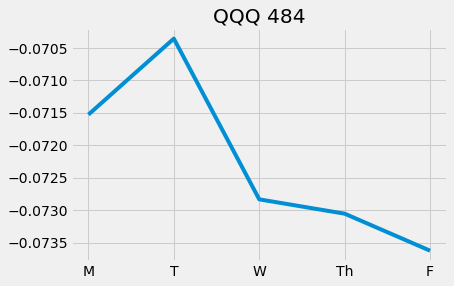

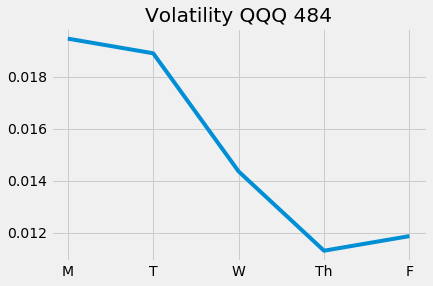

Epoch 486/5000
628/628 [==============================] - 1s 2ms/step - loss: 1.0017 - val_loss: 1.1227


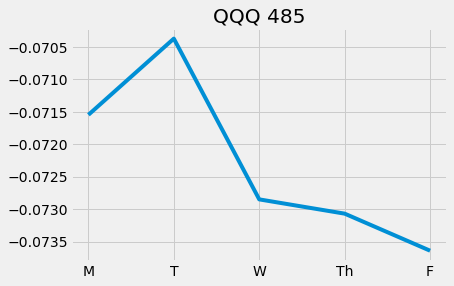

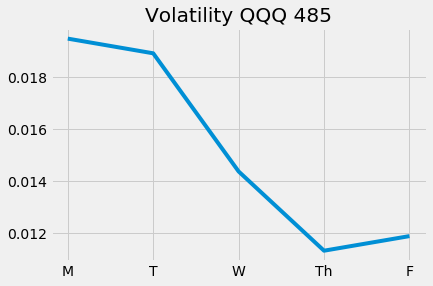

Epoch 487/5000
628/628 [==============================] - 1s 2ms/step - loss: 0.9998 - val_loss: 1.1226


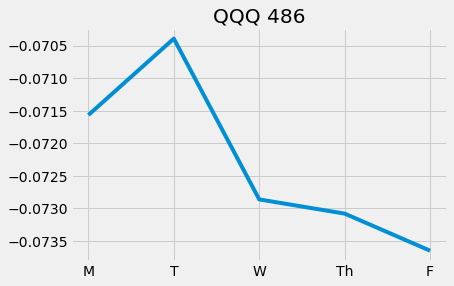

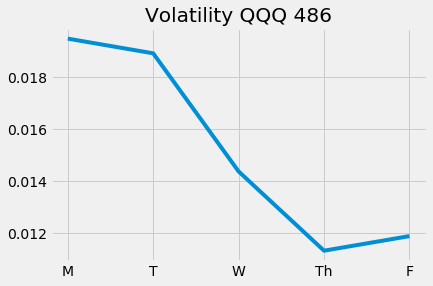

Epoch 488/5000
628/628 [==============================] - 1s 2ms/step - loss: 0.9988 - val_loss: 1.1225


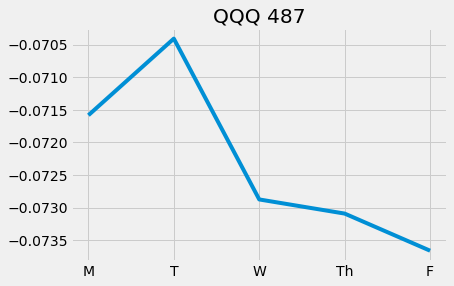

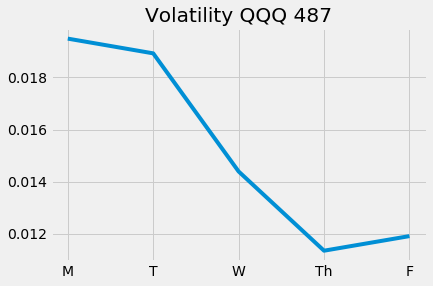

Epoch 489/5000
628/628 [==============================] - 1s 2ms/step - loss: 0.9992 - val_loss: 1.1225


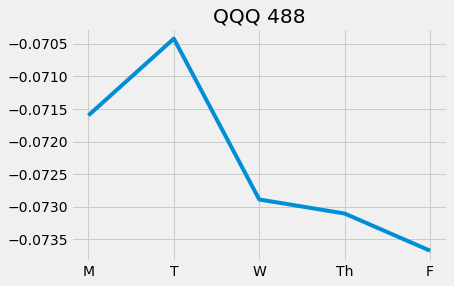

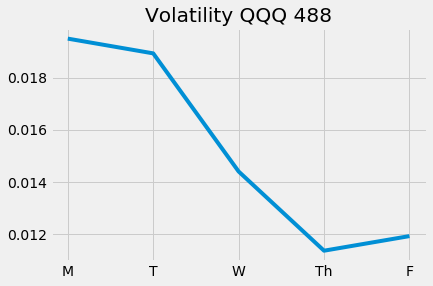

Epoch 490/5000
628/628 [==============================] - 1s 2ms/step - loss: 0.9949 - val_loss: 1.1224

Epoch 00490: ReduceLROnPlateau reducing learning rate to 4.547473724858043e-16.


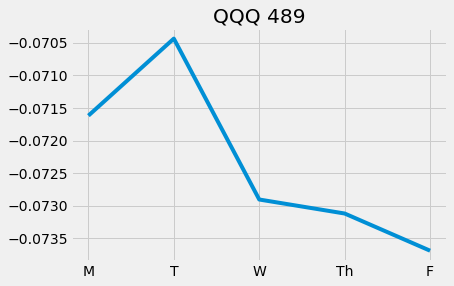

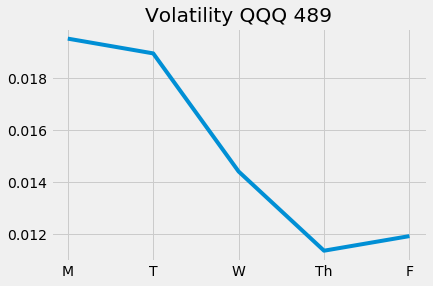

Epoch 491/5000
628/628 [==============================] - 1s 2ms/step - loss: 0.9998 - val_loss: 1.1224


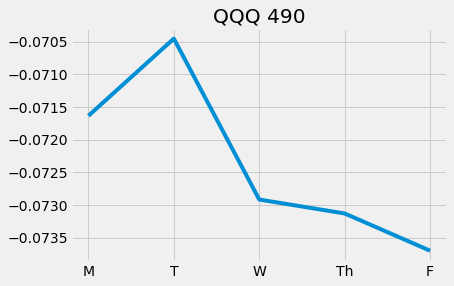

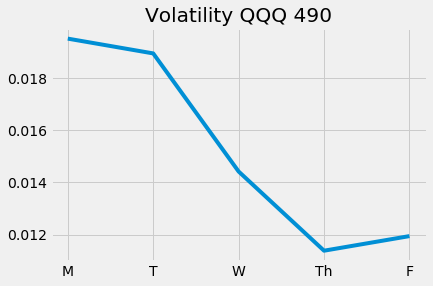

Epoch 492/5000
628/628 [==============================] - 1s 2ms/step - loss: 0.9990 - val_loss: 1.1223


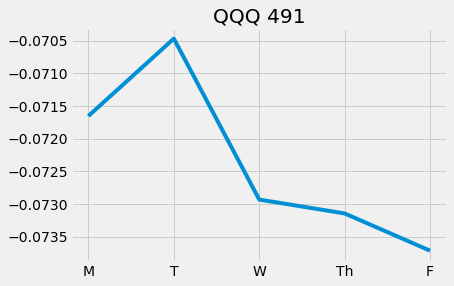

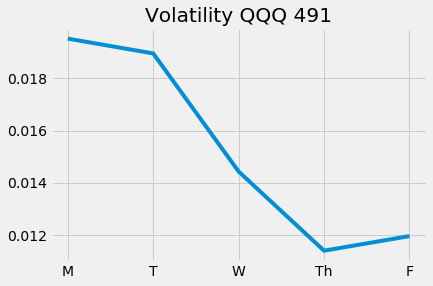

Epoch 493/5000
628/628 [==============================] - 1s 2ms/step - loss: 0.9922 - val_loss: 1.1222


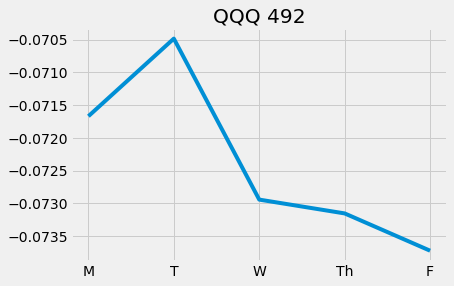

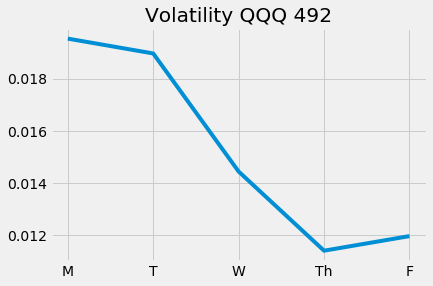

Epoch 494/5000
628/628 [==============================] - 1s 2ms/step - loss: 0.9959 - val_loss: 1.1222


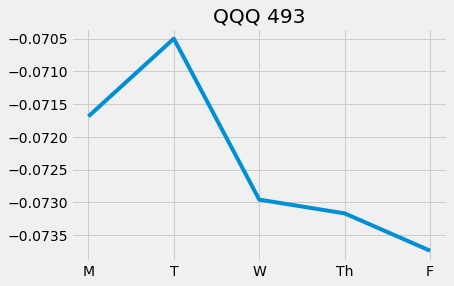

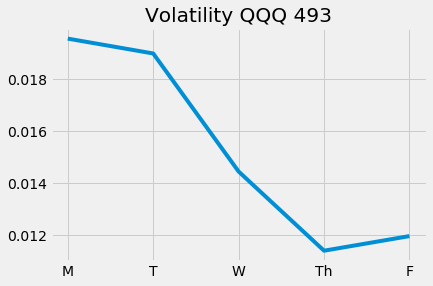

Epoch 495/5000
628/628 [==============================] - 1s 2ms/step - loss: 0.9972 - val_loss: 1.1221


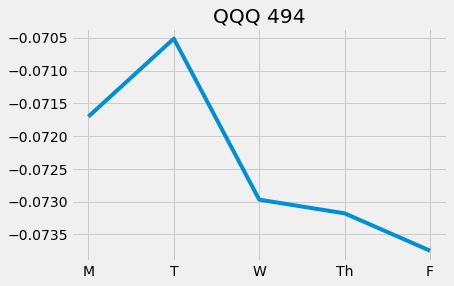

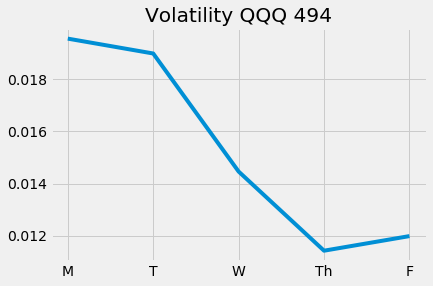

Epoch 496/5000
628/628 [==============================] - 1s 2ms/step - loss: 0.9941 - val_loss: 1.1221

Epoch 00496: ReduceLROnPlateau reducing learning rate to 2.2737368624290214e-16.


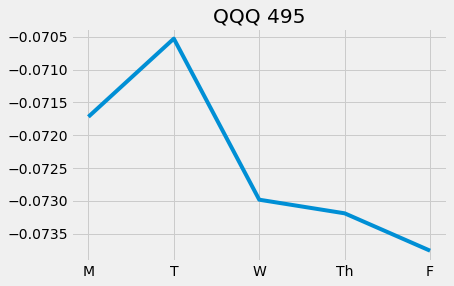

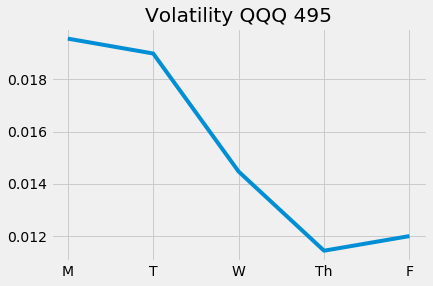

Epoch 497/5000
628/628 [==============================] - 1s 2ms/step - loss: 0.9963 - val_loss: 1.1220


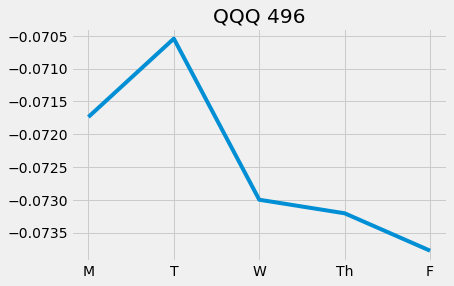

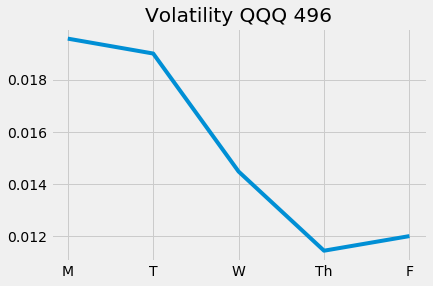

Epoch 498/5000
628/628 [==============================] - 1s 2ms/step - loss: 1.0017 - val_loss: 1.1220


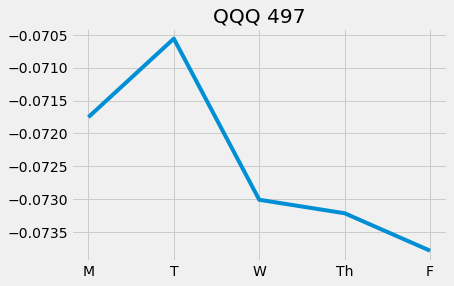

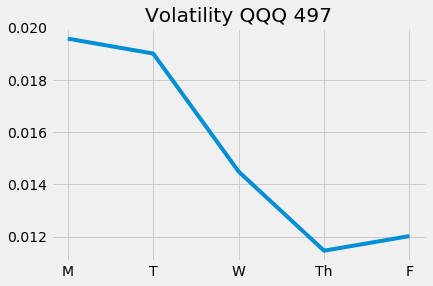

Epoch 499/5000
628/628 [==============================] - 1s 2ms/step - loss: 0.9989 - val_loss: 1.1219


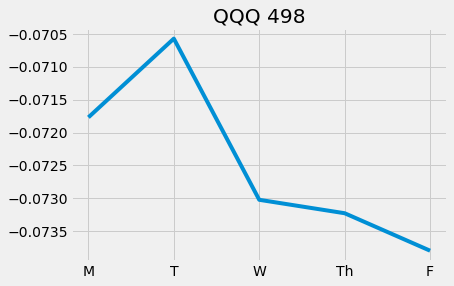

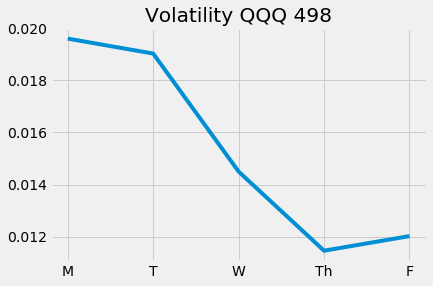

Epoch 500/5000
628/628 [==============================] - 1s 2ms/step - loss: 0.9922 - val_loss: 1.1219


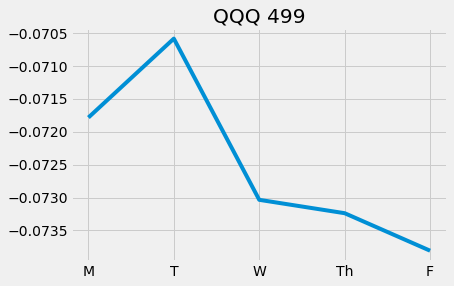

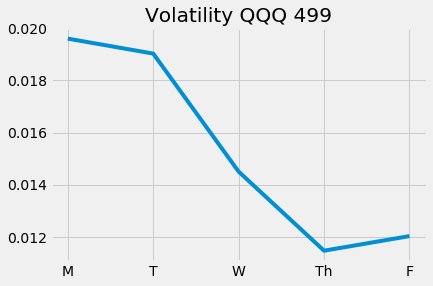

Epoch 501/5000
628/628 [==============================] - 1s 2ms/step - loss: 0.9953 - val_loss: 1.1218


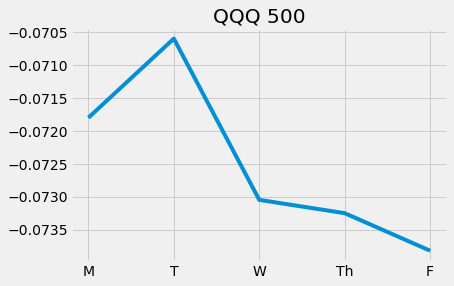

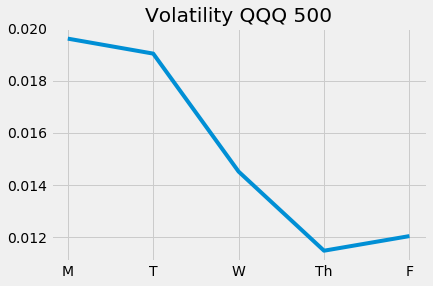

Epoch 502/5000
628/628 [==============================] - 1s 2ms/step - loss: 0.9987 - val_loss: 1.1218


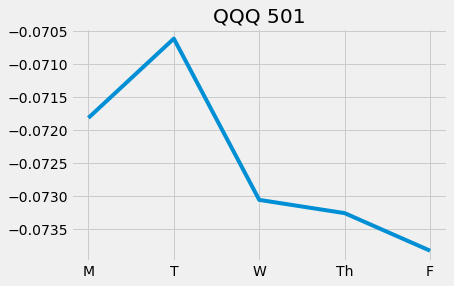

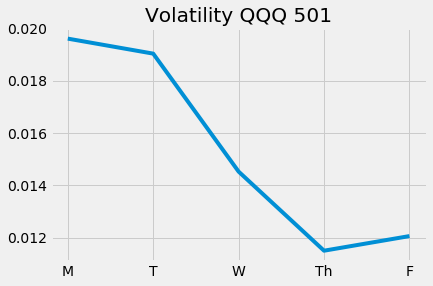

Epoch 503/5000
628/628 [==============================] - 1s 2ms/step - loss: 0.9972 - val_loss: 1.1217


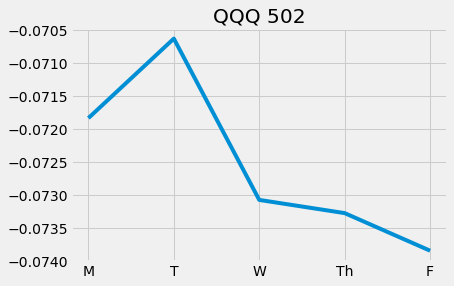

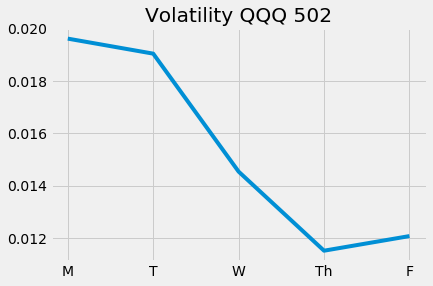

Epoch 504/5000
628/628 [==============================] - 1s 2ms/step - loss: 0.9965 - val_loss: 1.1217


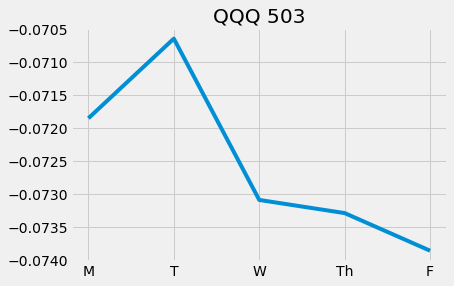

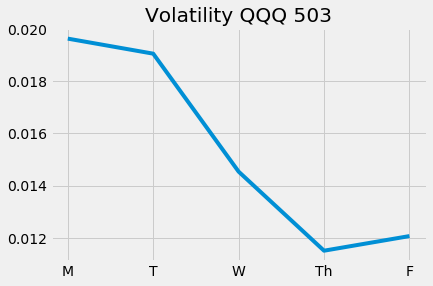

Epoch 505/5000
628/628 [==============================] - 1s 2ms/step - loss: 0.9995 - val_loss: 1.1216

Epoch 00505: ReduceLROnPlateau reducing learning rate to 1.1368684312145107e-16.


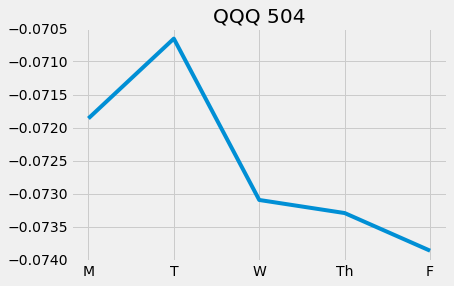

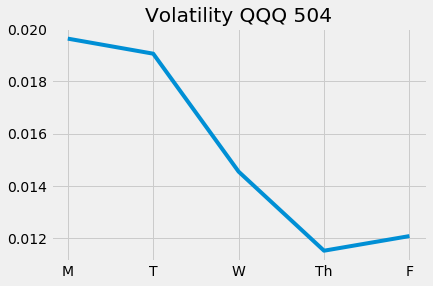

Epoch 506/5000
628/628 [==============================] - 1s 2ms/step - loss: 0.9955 - val_loss: 1.1216


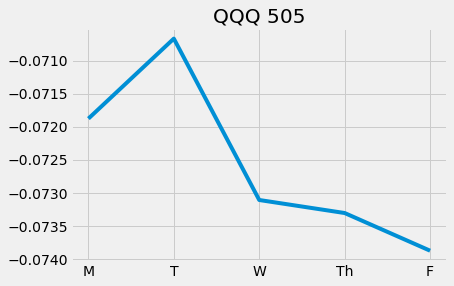

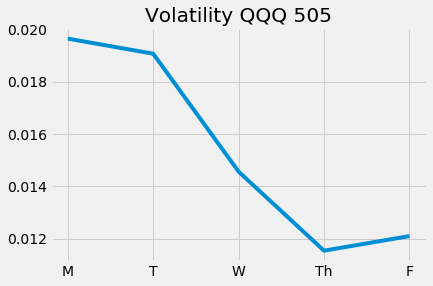

Epoch 507/5000
628/628 [==============================] - 1s 2ms/step - loss: 0.9922 - val_loss: 1.1215


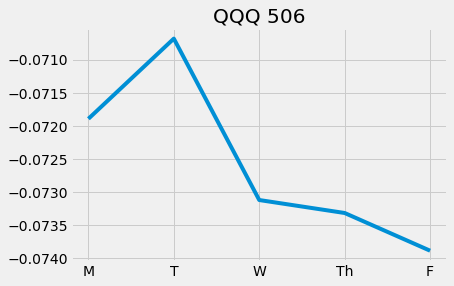

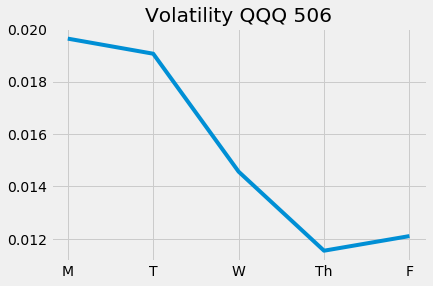

Epoch 508/5000
628/628 [==============================] - 1s 2ms/step - loss: 0.9935 - val_loss: 1.1215


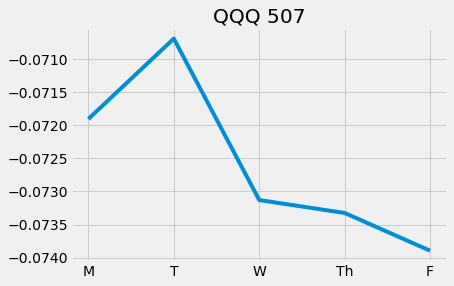

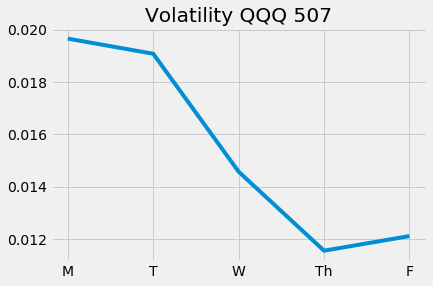

Epoch 509/5000
628/628 [==============================] - 1s 2ms/step - loss: 0.9960 - val_loss: 1.1214


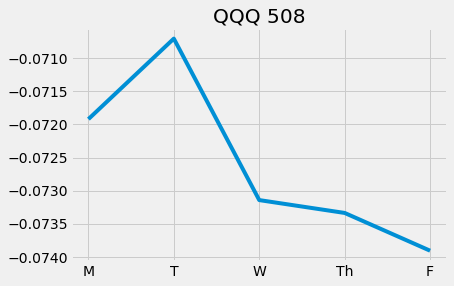

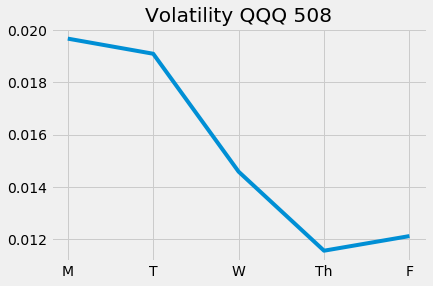

Epoch 510/5000
628/628 [==============================] - 1s 2ms/step - loss: 0.9986 - val_loss: 1.1214


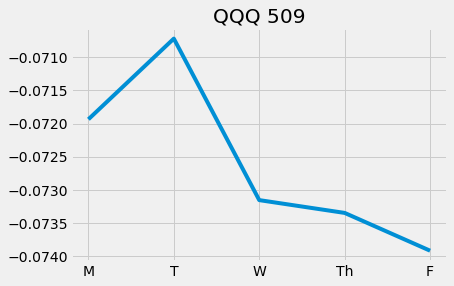

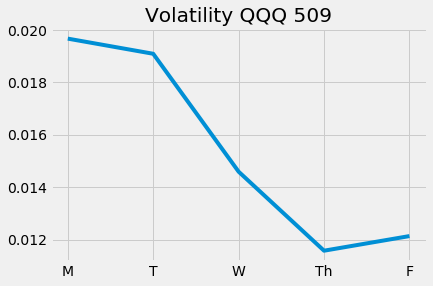

Epoch 511/5000
628/628 [==============================] - 1s 2ms/step - loss: 0.9954 - val_loss: 1.1213

Epoch 00511: ReduceLROnPlateau reducing learning rate to 5.684342156072553e-17.


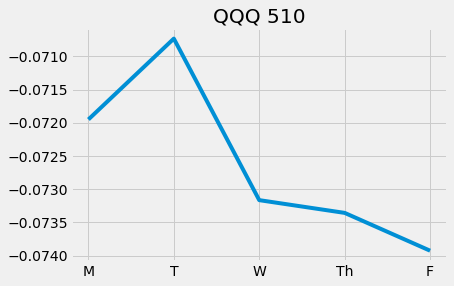

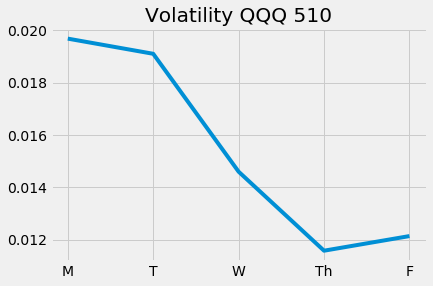

Epoch 512/5000
628/628 [==============================] - 1s 2ms/step - loss: 0.9872 - val_loss: 1.1213


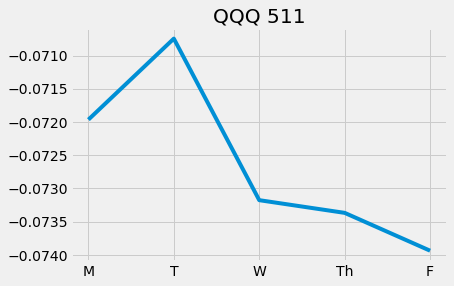

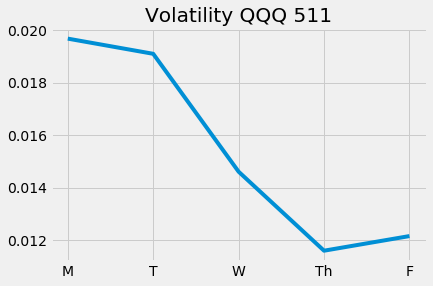

Epoch 513/5000
628/628 [==============================] - 1s 2ms/step - loss: 0.9957 - val_loss: 1.1212


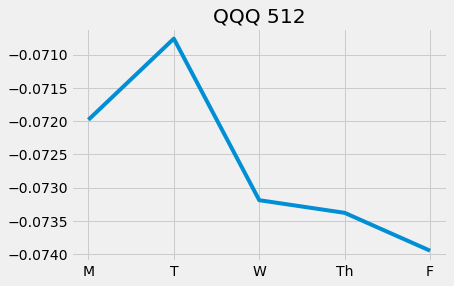

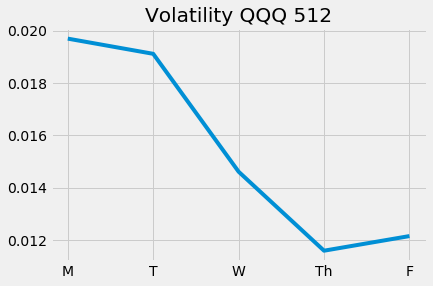

Epoch 514/5000
628/628 [==============================] - 1s 2ms/step - loss: 0.9973 - val_loss: 1.1212


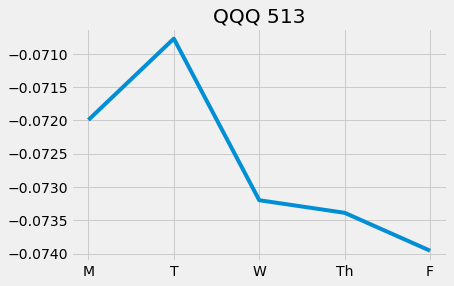

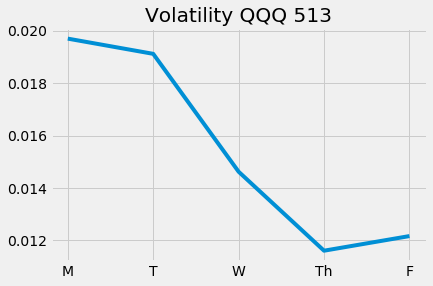

Epoch 515/5000
628/628 [==============================] - 1s 2ms/step - loss: 0.9933 - val_loss: 1.1211


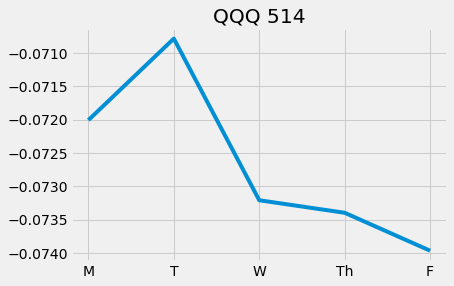

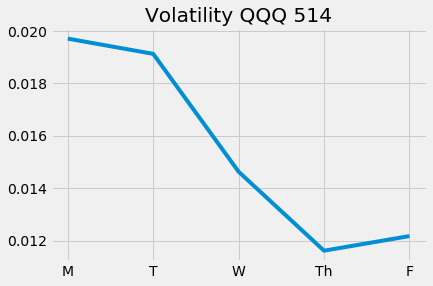

Epoch 516/5000
628/628 [==============================] - 1s 2ms/step - loss: 1.0065 - val_loss: 1.1211


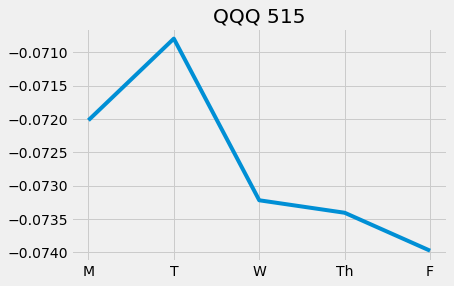

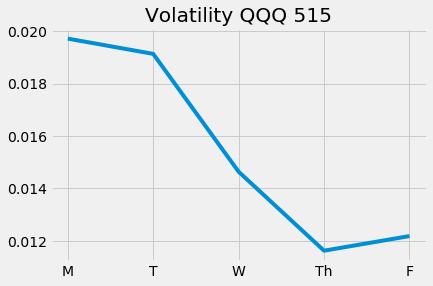

Epoch 517/5000
628/628 [==============================] - 1s 2ms/step - loss: 0.9957 - val_loss: 1.1211


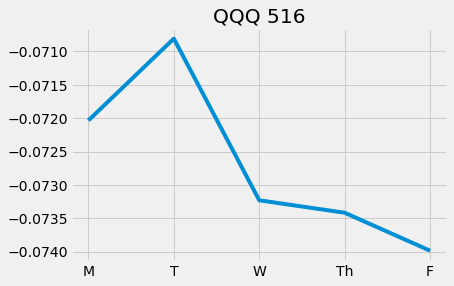

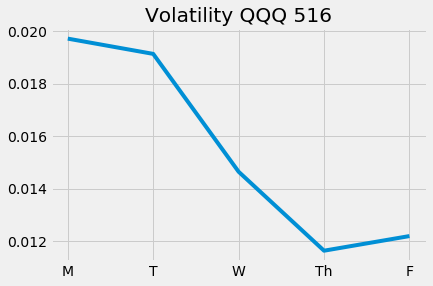

Epoch 518/5000
628/628 [==============================] - 1s 2ms/step - loss: 0.9938 - val_loss: 1.1210


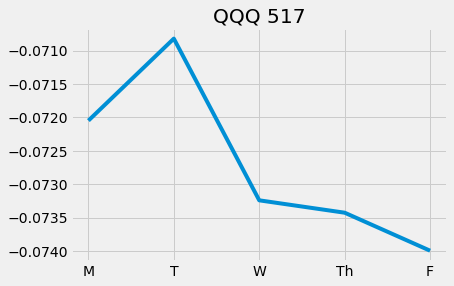

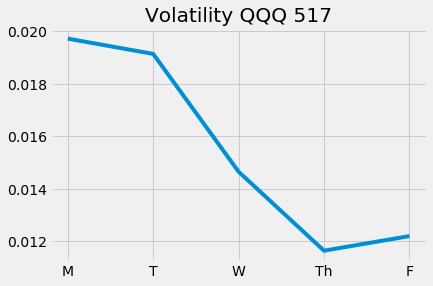

Epoch 519/5000
628/628 [==============================] - 1s 2ms/step - loss: 0.9967 - val_loss: 1.1210


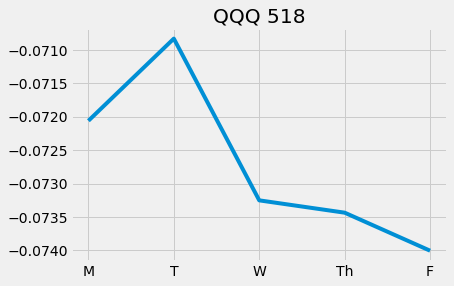

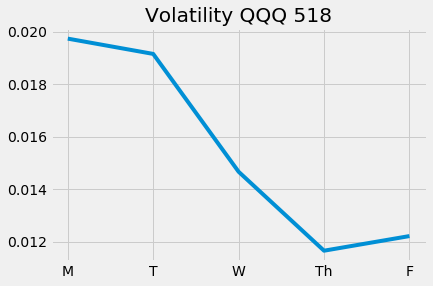

Epoch 520/5000
628/628 [==============================] - 1s 2ms/step - loss: 0.9949 - val_loss: 1.1209

Epoch 00520: ReduceLROnPlateau reducing learning rate to 2.842171078036277e-17.


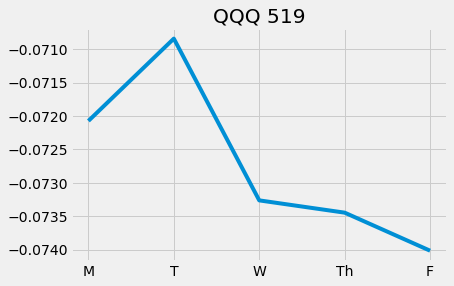

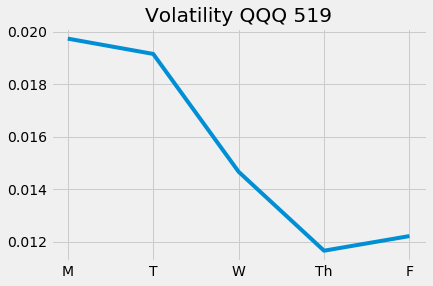

Epoch 521/5000
628/628 [==============================] - 1s 2ms/step - loss: 0.9965 - val_loss: 1.1209


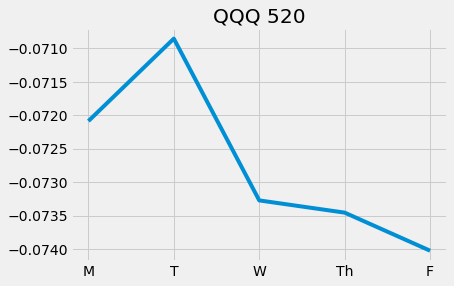

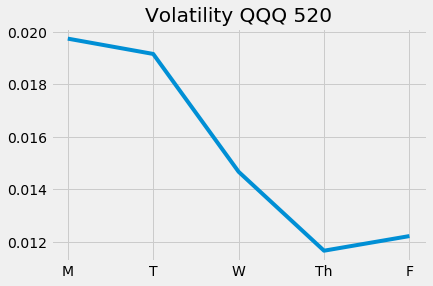

Epoch 522/5000
628/628 [==============================] - 1s 2ms/step - loss: 1.0003 - val_loss: 1.1208


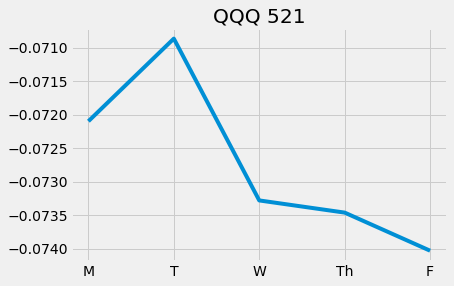

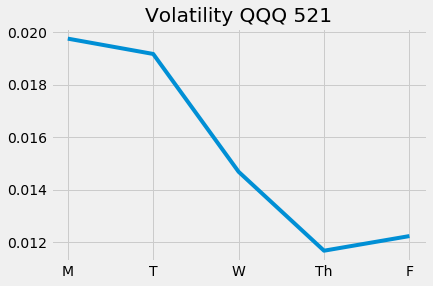

Epoch 523/5000
628/628 [==============================] - 1s 2ms/step - loss: 0.9971 - val_loss: 1.1208


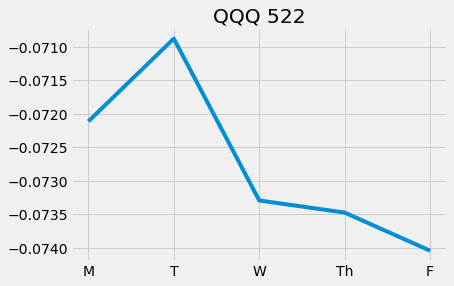

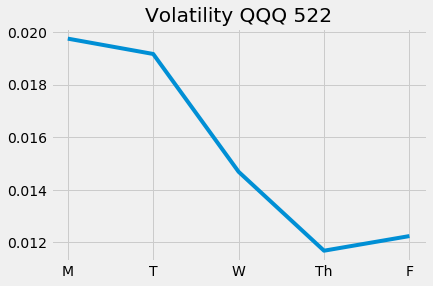

Epoch 524/5000
628/628 [==============================] - 1s 2ms/step - loss: 0.9968 - val_loss: 1.1208


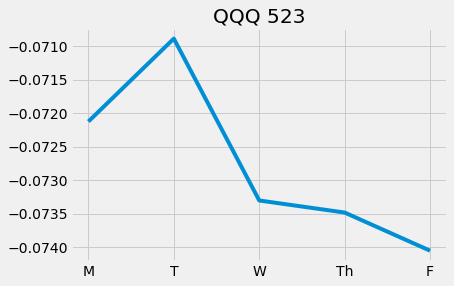

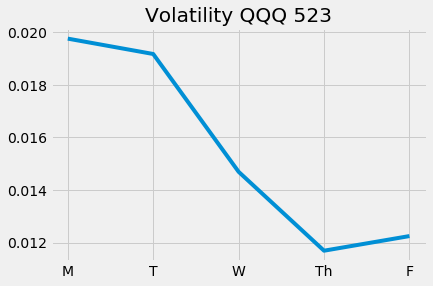

Epoch 525/5000
628/628 [==============================] - 1s 2ms/step - loss: 0.9964 - val_loss: 1.1207


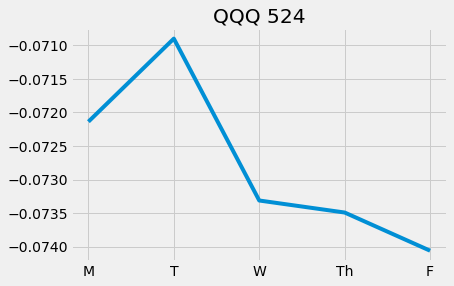

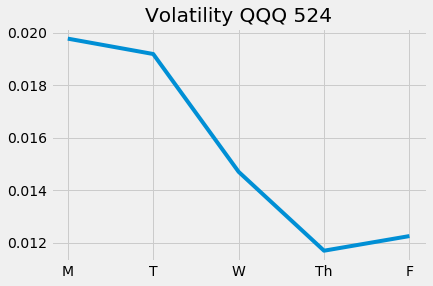

Epoch 526/5000
628/628 [==============================] - 1s 2ms/step - loss: 1.0008 - val_loss: 1.1207


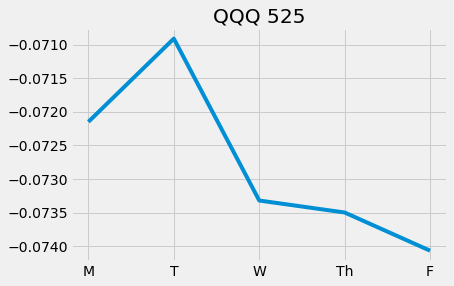

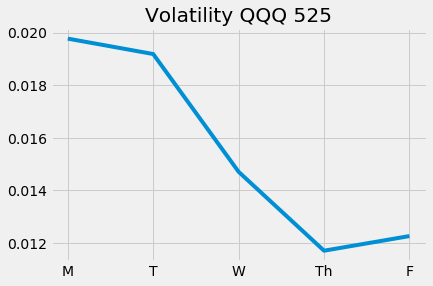

Epoch 527/5000
628/628 [==============================] - 1s 2ms/step - loss: 0.9945 - val_loss: 1.1206

Epoch 00527: ReduceLROnPlateau reducing learning rate to 1.4210855390181384e-17.


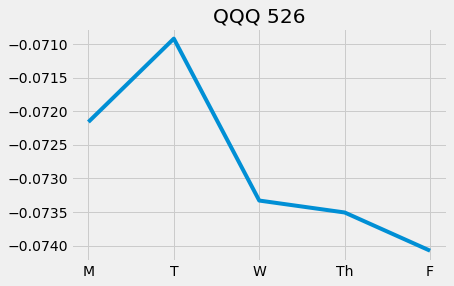

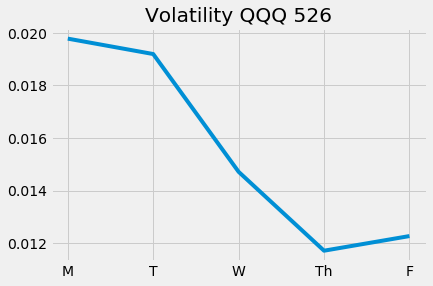

Epoch 528/5000
628/628 [==============================] - 1s 2ms/step - loss: 0.9979 - val_loss: 1.1206


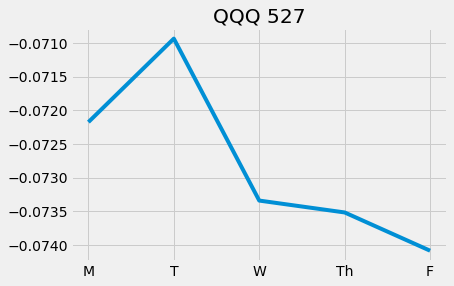

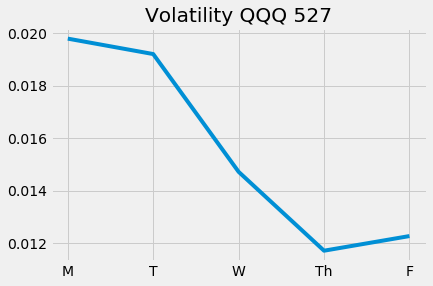

Epoch 529/5000
628/628 [==============================] - 1s 2ms/step - loss: 0.9906 - val_loss: 1.1206


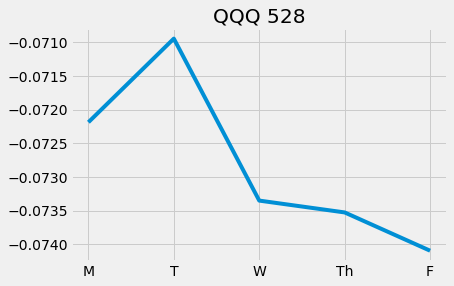

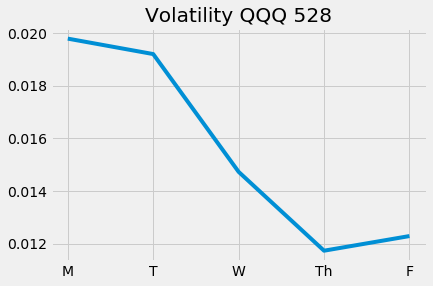

Epoch 530/5000
628/628 [==============================] - 1s 2ms/step - loss: 0.9979 - val_loss: 1.1205


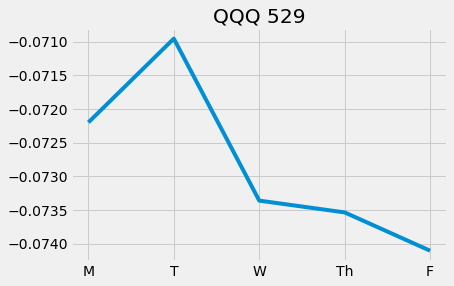

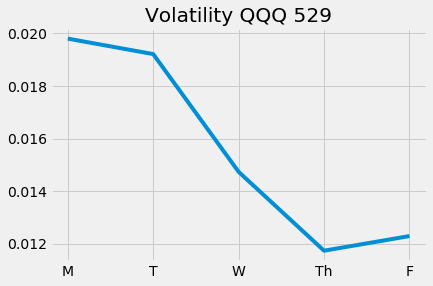

Epoch 531/5000
628/628 [==============================] - 1s 2ms/step - loss: 0.9928 - val_loss: 1.1205


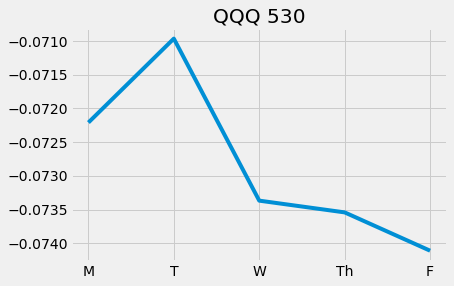

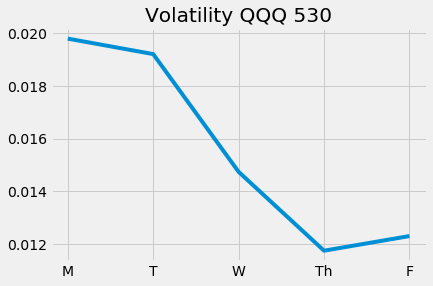

Epoch 532/5000
628/628 [==============================] - 1s 2ms/step - loss: 0.9925 - val_loss: 1.1205


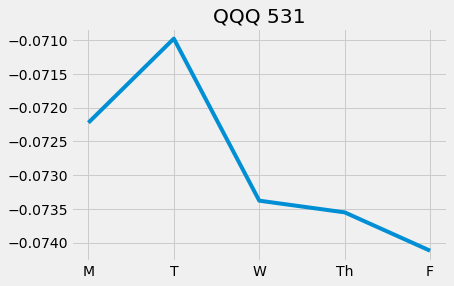

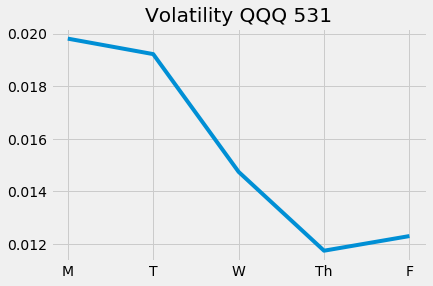

Epoch 533/5000
628/628 [==============================] - 1s 2ms/step - loss: 0.9993 - val_loss: 1.1204


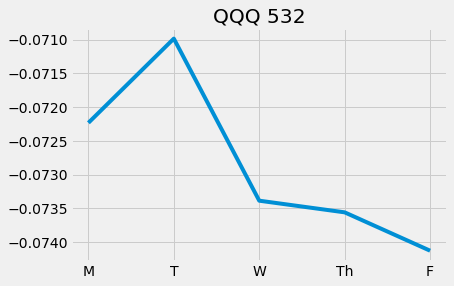

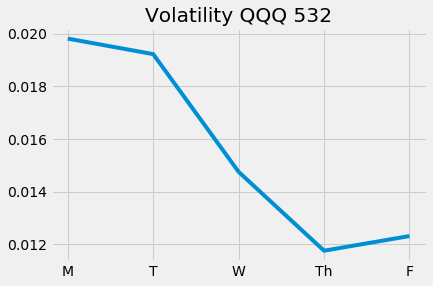

Epoch 534/5000
628/628 [==============================] - 1s 2ms/step - loss: 0.9940 - val_loss: 1.1204


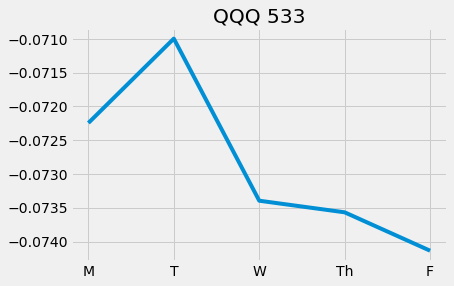

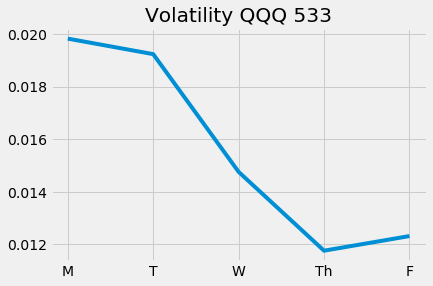

Epoch 535/5000
628/628 [==============================] - 1s 2ms/step - loss: 0.9938 - val_loss: 1.1203

Epoch 00535: ReduceLROnPlateau reducing learning rate to 7.105427695090692e-18.


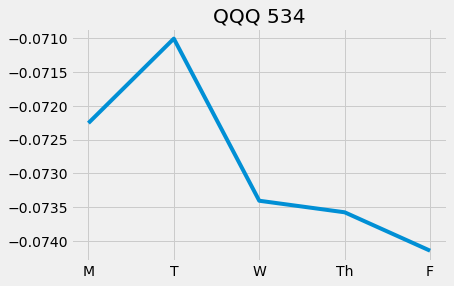

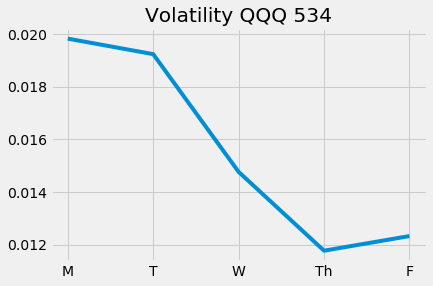

Epoch 536/5000
628/628 [==============================] - 1s 2ms/step - loss: 1.0010 - val_loss: 1.1203


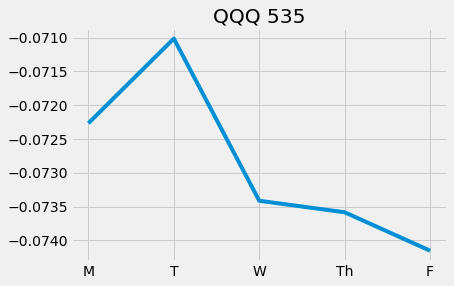

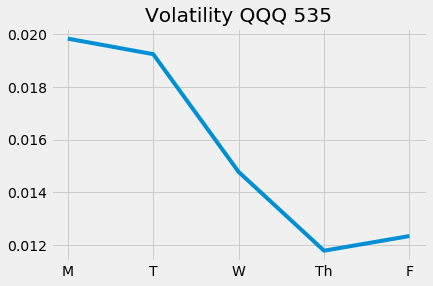

Epoch 537/5000
628/628 [==============================] - 1s 2ms/step - loss: 0.9966 - val_loss: 1.1203


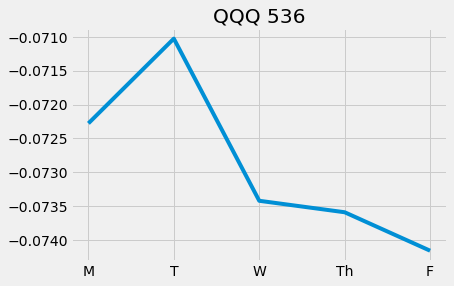

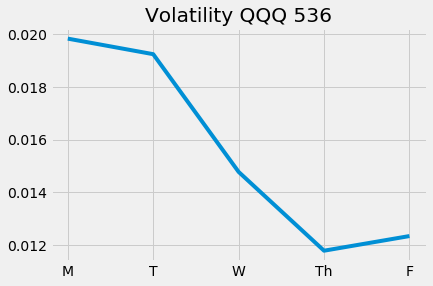

Epoch 538/5000
628/628 [==============================] - 1s 2ms/step - loss: 0.9999 - val_loss: 1.1202


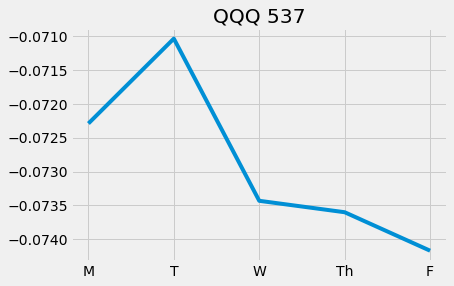

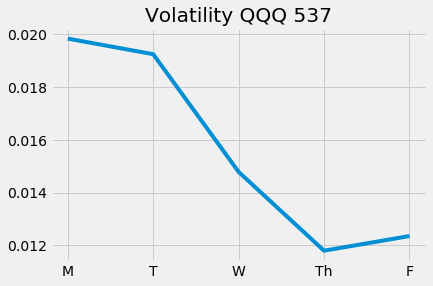

Epoch 539/5000
628/628 [==============================] - 1s 2ms/step - loss: 0.9991 - val_loss: 1.1202


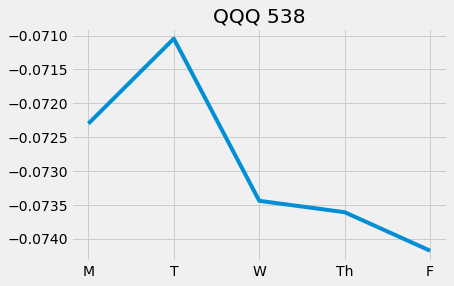

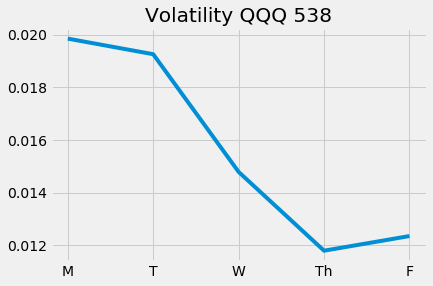

Epoch 540/5000
628/628 [==============================] - 1s 2ms/step - loss: 0.9978 - val_loss: 1.1202


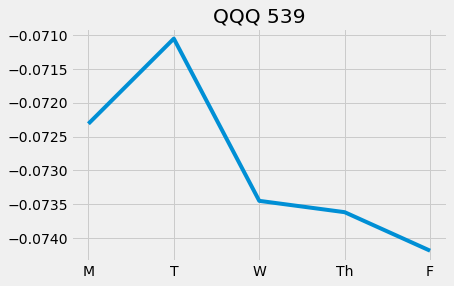

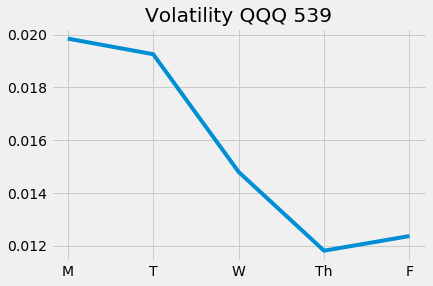

Epoch 541/5000
628/628 [==============================] - 1s 2ms/step - loss: 1.0005 - val_loss: 1.1201


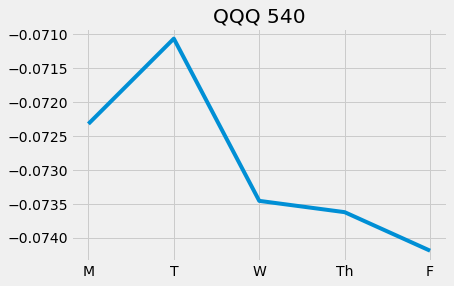

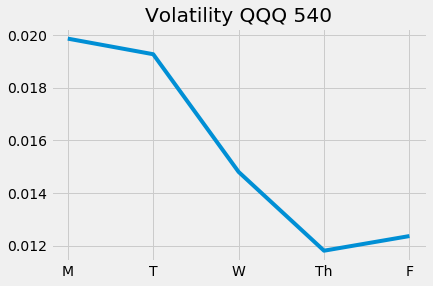

Epoch 542/5000
628/628 [==============================] - 1s 2ms/step - loss: 0.9982 - val_loss: 1.1201

Epoch 00542: ReduceLROnPlateau reducing learning rate to 3.552713847545346e-18.


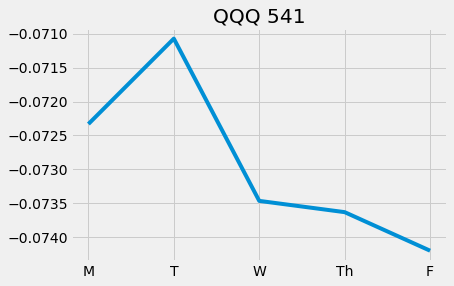

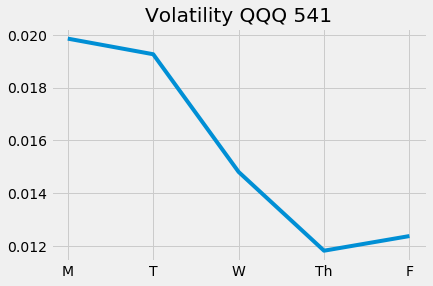

Epoch 543/5000
628/628 [==============================] - 1s 2ms/step - loss: 1.0033 - val_loss: 1.1201


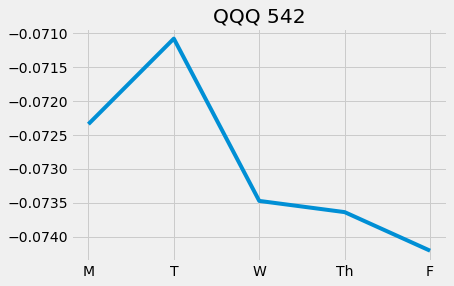

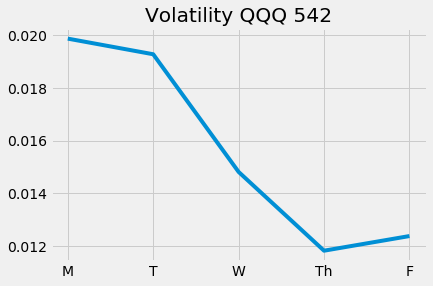

Epoch 544/5000
628/628 [==============================] - 1s 2ms/step - loss: 1.0001 - val_loss: 1.1200


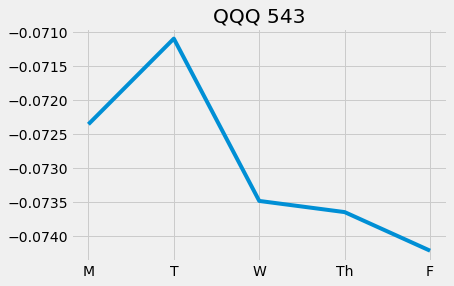

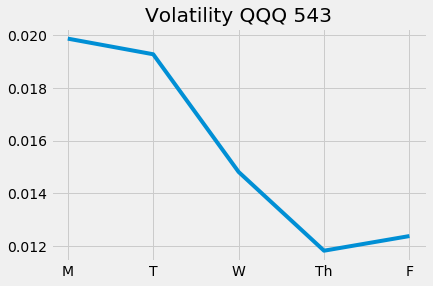

Epoch 545/5000
628/628 [==============================] - 1s 2ms/step - loss: 0.9940 - val_loss: 1.1200


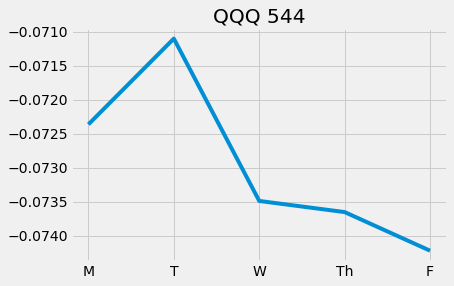

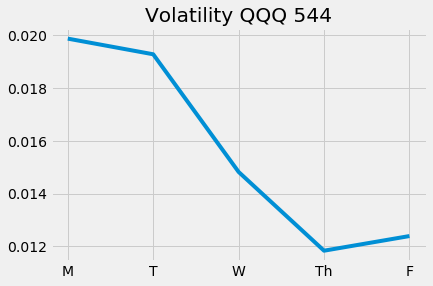

Epoch 546/5000
628/628 [==============================] - 1s 2ms/step - loss: 0.9976 - val_loss: 1.1200


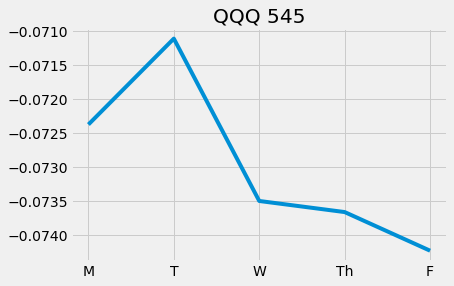

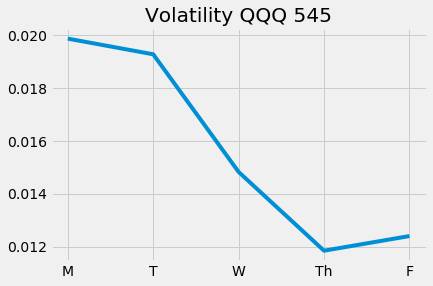

Epoch 547/5000
628/628 [==============================] - 1s 2ms/step - loss: 0.9988 - val_loss: 1.1199


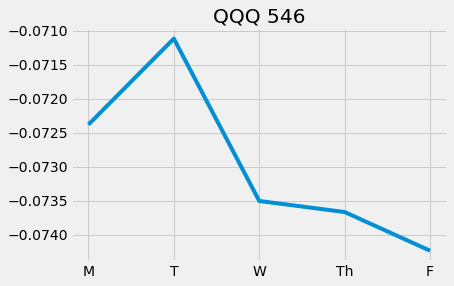

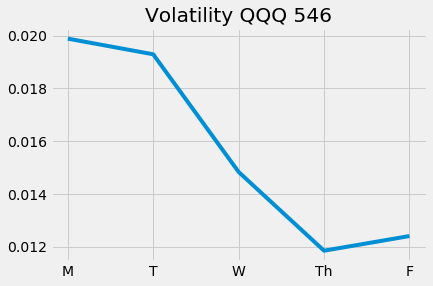

Epoch 548/5000
628/628 [==============================] - 1s 2ms/step - loss: 0.9951 - val_loss: 1.1199


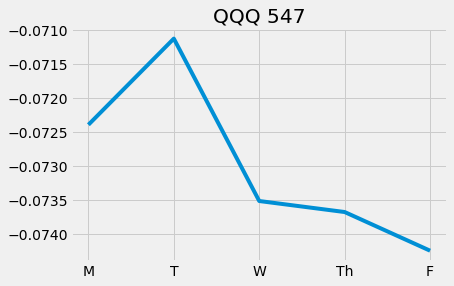

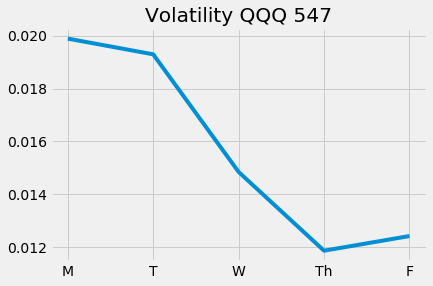

Epoch 549/5000
628/628 [==============================] - 1s 2ms/step - loss: 0.9997 - val_loss: 1.1199


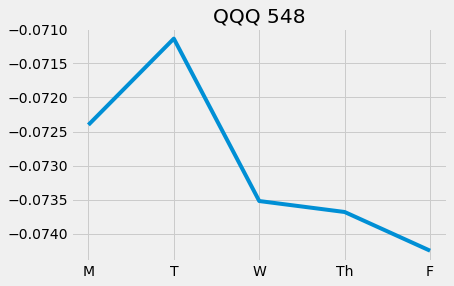

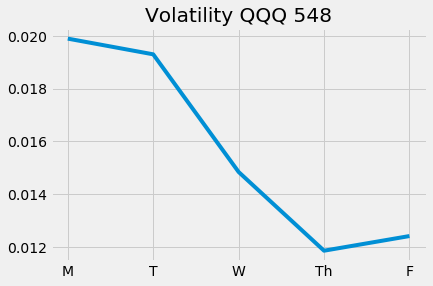

Epoch 550/5000
628/628 [==============================] - 1s 2ms/step - loss: 1.0002 - val_loss: 1.1198

Epoch 00550: ReduceLROnPlateau reducing learning rate to 1.776356923772673e-18.


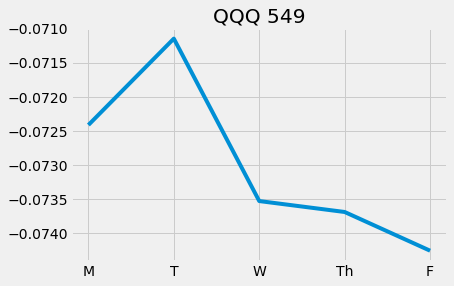

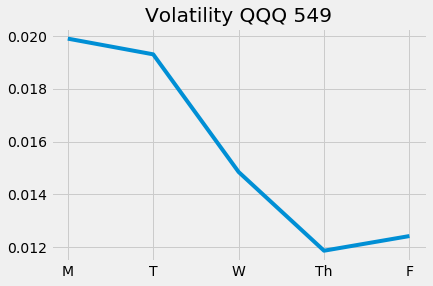

Epoch 551/5000
628/628 [==============================] - 1s 2ms/step - loss: 1.0000 - val_loss: 1.1198


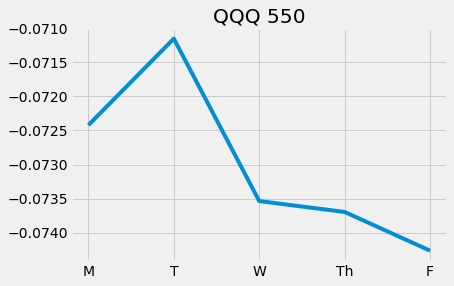

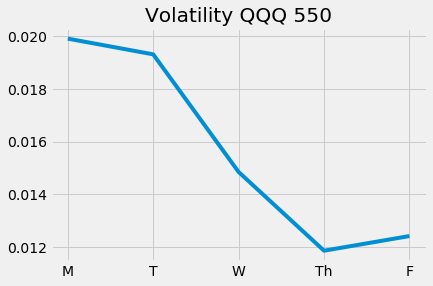

Epoch 552/5000
628/628 [==============================] - 1s 2ms/step - loss: 0.9934 - val_loss: 1.1198


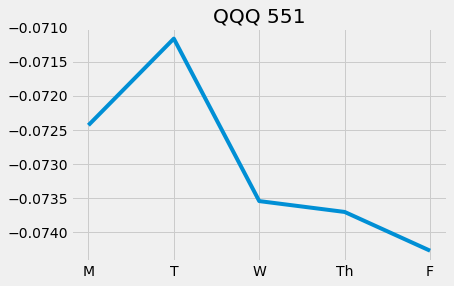

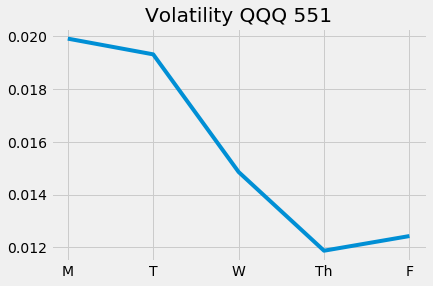

Epoch 553/5000
628/628 [==============================] - 1s 2ms/step - loss: 0.9957 - val_loss: 1.1198


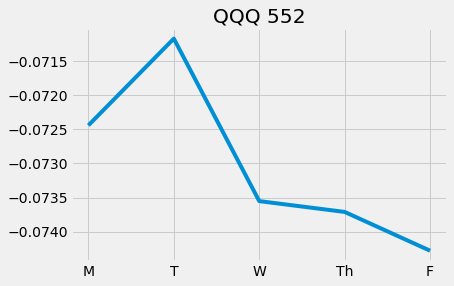

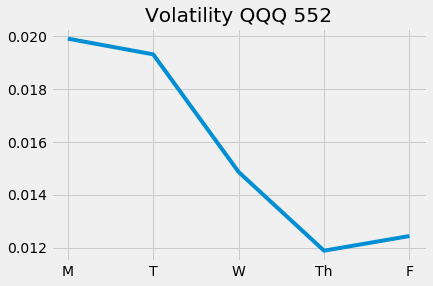

Epoch 554/5000
628/628 [==============================] - 1s 2ms/step - loss: 1.0016 - val_loss: 1.1197


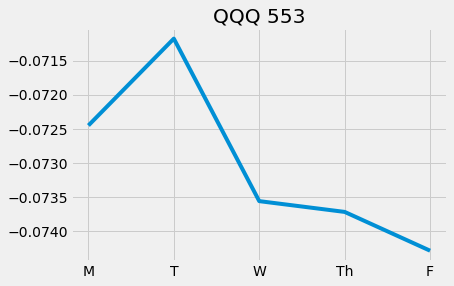

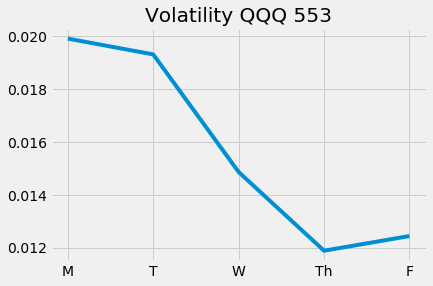

Epoch 555/5000
628/628 [==============================] - 1s 2ms/step - loss: 0.9961 - val_loss: 1.1197


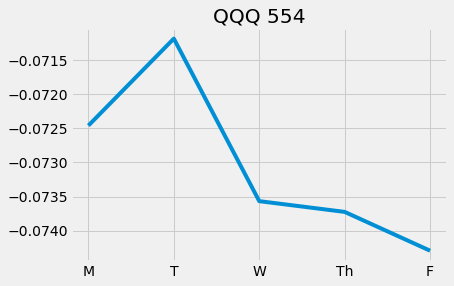

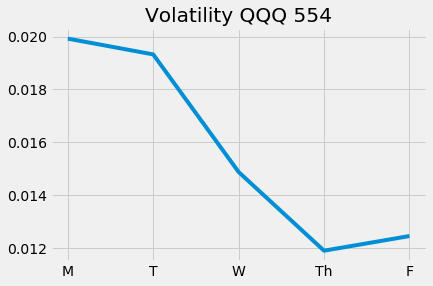

Epoch 556/5000
628/628 [==============================] - 1s 2ms/step - loss: 0.9985 - val_loss: 1.1197


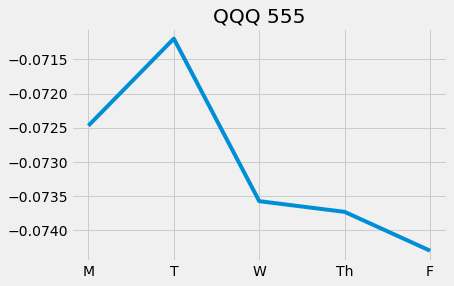

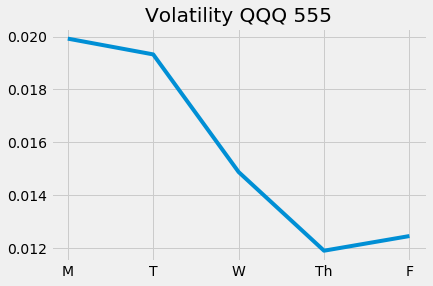

Epoch 557/5000
628/628 [==============================] - 1s 2ms/step - loss: 0.9935 - val_loss: 1.1196

Epoch 00557: ReduceLROnPlateau reducing learning rate to 8.881784618863365e-19.


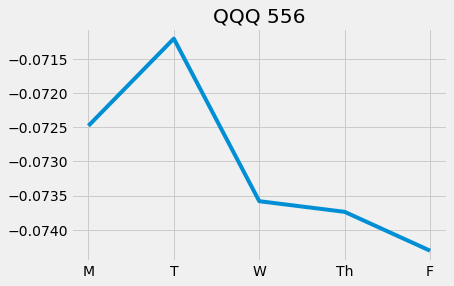

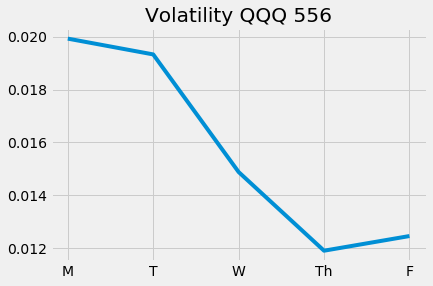

Epoch 558/5000
628/628 [==============================] - 1s 2ms/step - loss: 0.9933 - val_loss: 1.1196


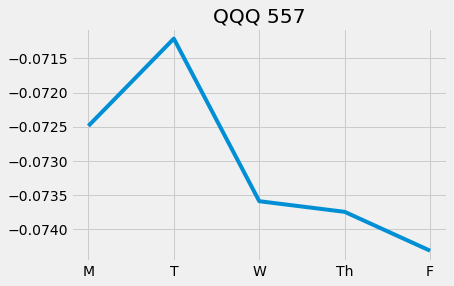

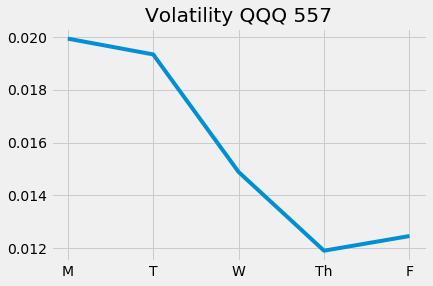

Epoch 559/5000
628/628 [==============================] - 1s 2ms/step - loss: 0.9969 - val_loss: 1.1196


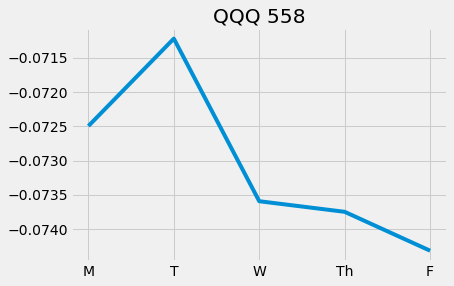

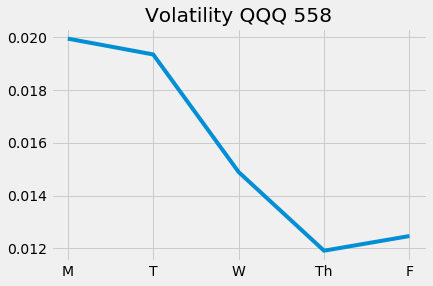

Epoch 560/5000
628/628 [==============================] - 1s 2ms/step - loss: 1.0014 - val_loss: 1.1196


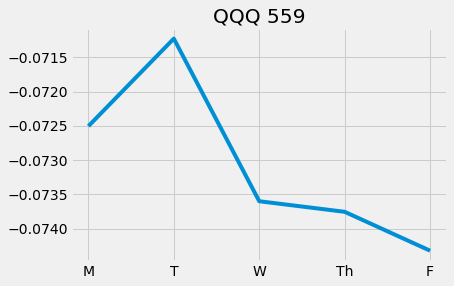

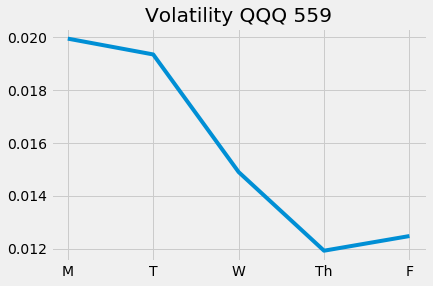

Epoch 561/5000
628/628 [==============================] - 1s 2ms/step - loss: 1.0013 - val_loss: 1.1195


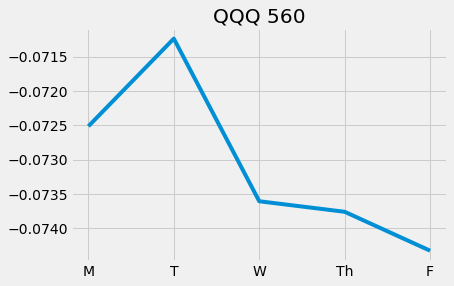

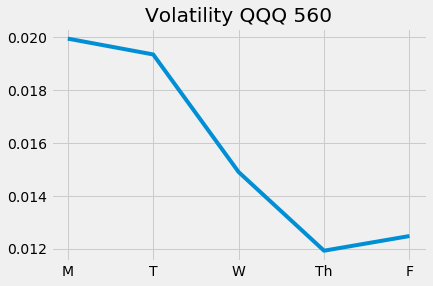

Epoch 562/5000
628/628 [==============================] - 1s 2ms/step - loss: 0.9971 - val_loss: 1.1195


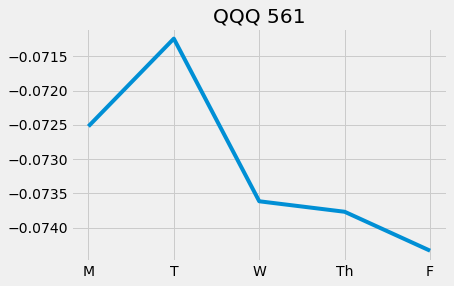

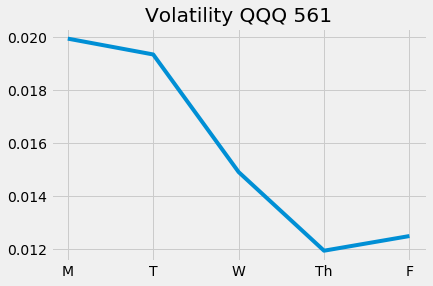

Epoch 563/5000
628/628 [==============================] - 1s 2ms/step - loss: 0.9937 - val_loss: 1.1195


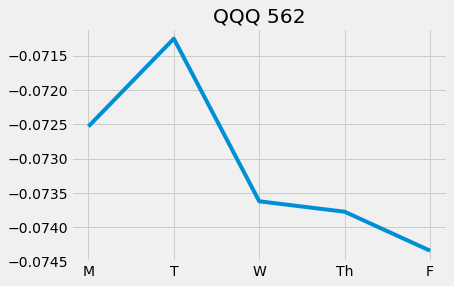

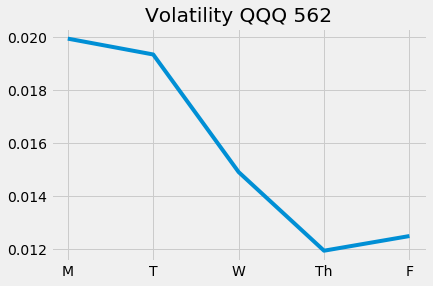

Epoch 564/5000
628/628 [==============================] - 1s 2ms/step - loss: 0.9958 - val_loss: 1.1195


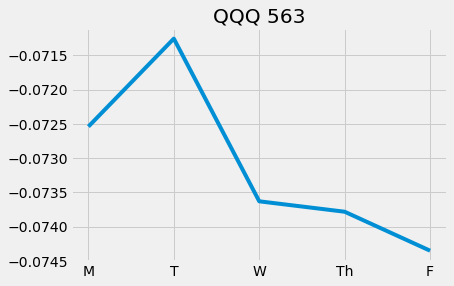

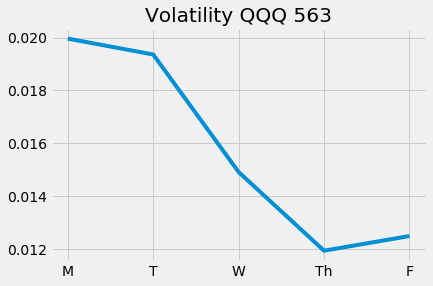

Epoch 565/5000
628/628 [==============================] - 1s 2ms/step - loss: 0.9987 - val_loss: 1.1194

Epoch 00565: ReduceLROnPlateau reducing learning rate to 4.440892309431682e-19.


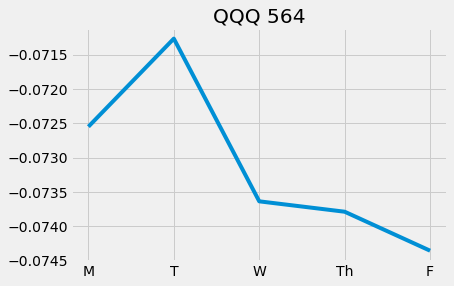

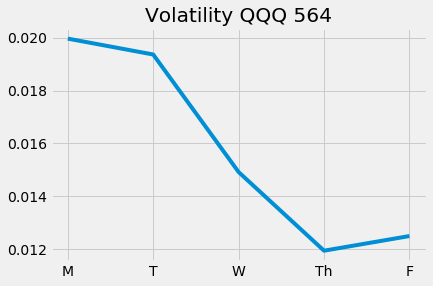

Epoch 566/5000
628/628 [==============================] - 1s 2ms/step - loss: 0.9962 - val_loss: 1.1194


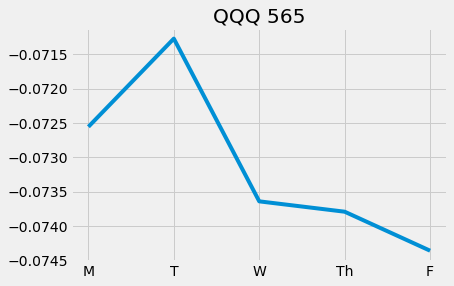

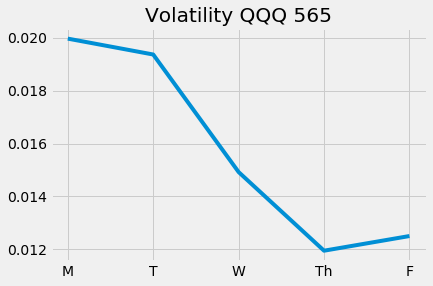

Epoch 567/5000
628/628 [==============================] - 1s 2ms/step - loss: 0.9955 - val_loss: 1.1194


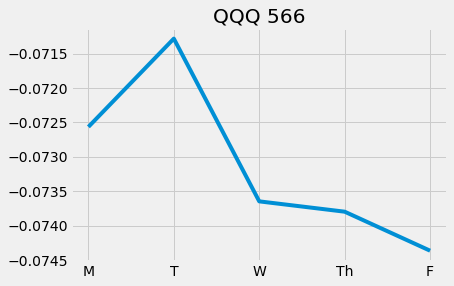

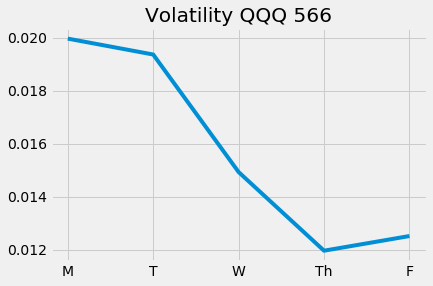

Epoch 568/5000
628/628 [==============================] - 1s 2ms/step - loss: 0.9979 - val_loss: 1.1193


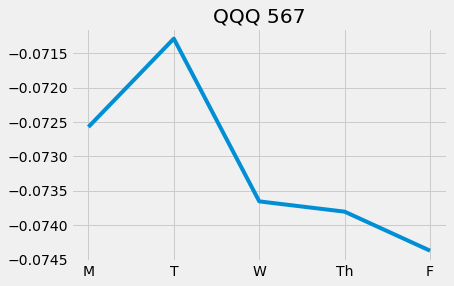

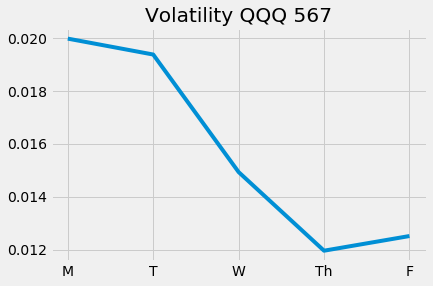

Epoch 569/5000
628/628 [==============================] - 1s 2ms/step - loss: 0.9895 - val_loss: 1.1193


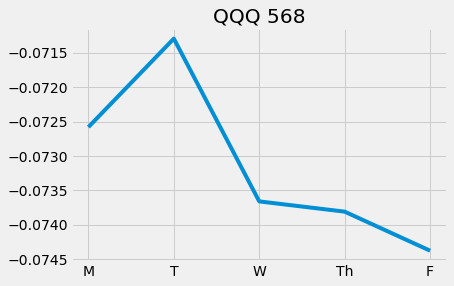

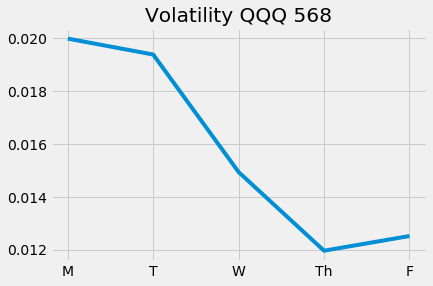

Epoch 570/5000
628/628 [==============================] - 1s 2ms/step - loss: 0.9981 - val_loss: 1.1193


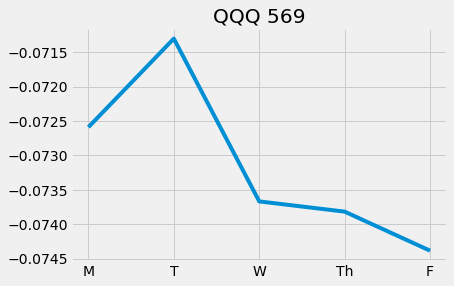

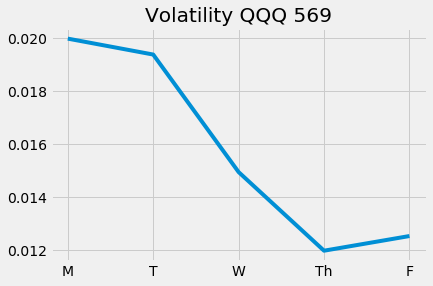

Epoch 571/5000
628/628 [==============================] - 1s 2ms/step - loss: 1.0001 - val_loss: 1.1193


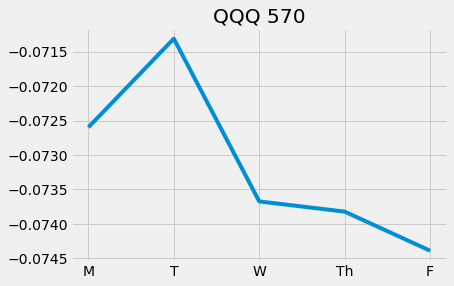

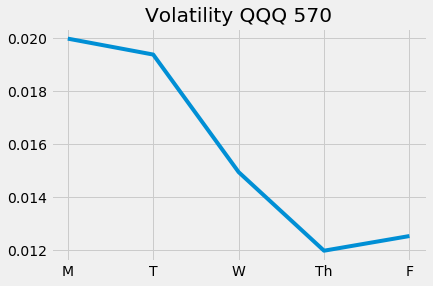

Epoch 572/5000
628/628 [==============================] - 1s 2ms/step - loss: 0.9991 - val_loss: 1.1192

Epoch 00572: ReduceLROnPlateau reducing learning rate to 2.220446154715841e-19.


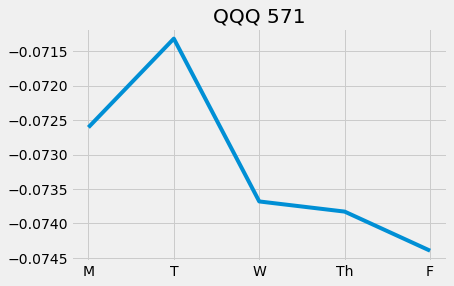

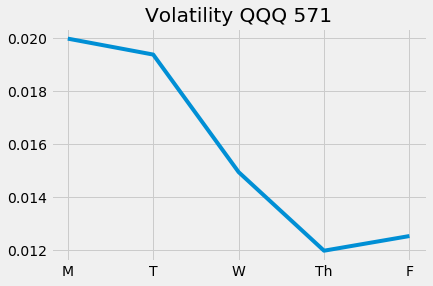

Epoch 573/5000
628/628 [==============================] - 1s 2ms/step - loss: 0.9942 - val_loss: 1.1192


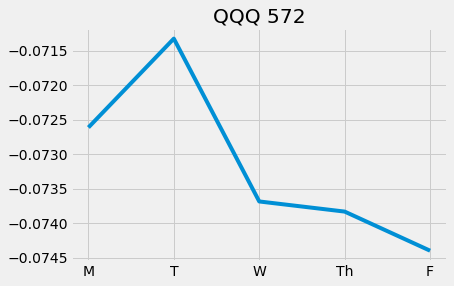

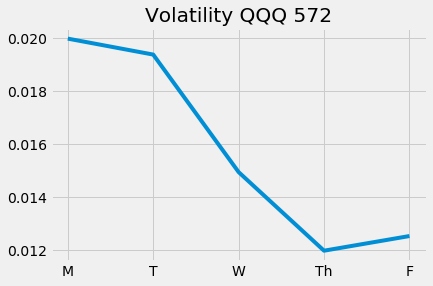

Epoch 574/5000
628/628 [==============================] - 1s 2ms/step - loss: 0.9974 - val_loss: 1.1192


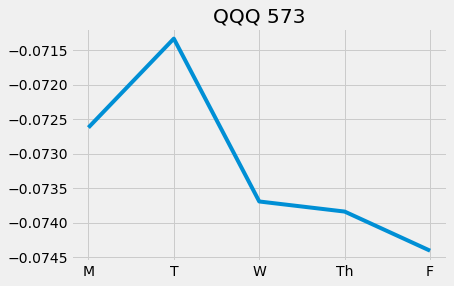

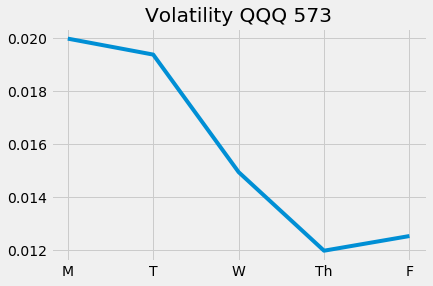

Epoch 575/5000
628/628 [==============================] - 1s 2ms/step - loss: 0.9964 - val_loss: 1.1192


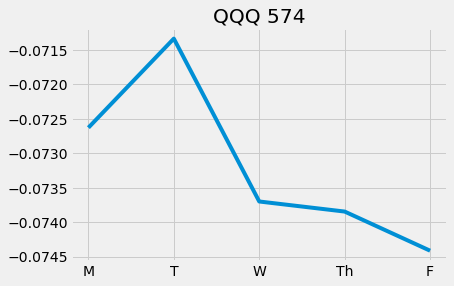

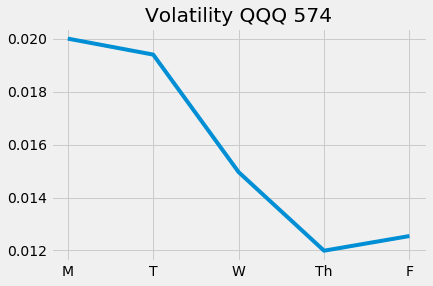

Epoch 576/5000
628/628 [==============================] - 1s 2ms/step - loss: 1.0000 - val_loss: 1.1192


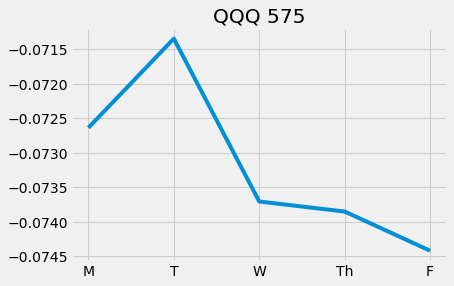

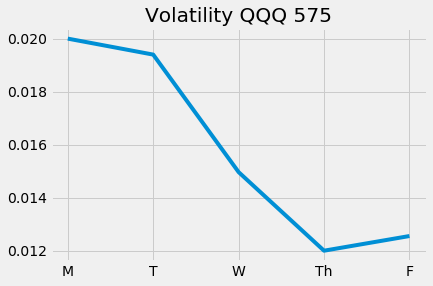

Epoch 577/5000
628/628 [==============================] - 1s 2ms/step - loss: 0.9945 - val_loss: 1.1191


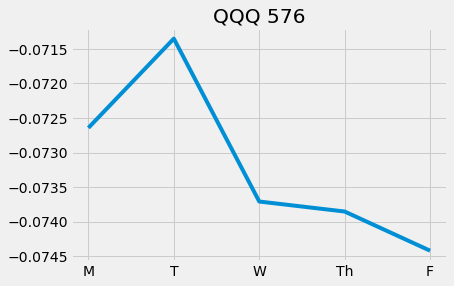

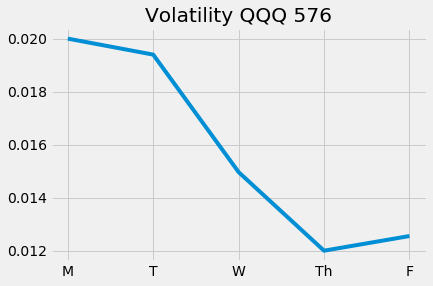

Epoch 578/5000
628/628 [==============================] - 1s 2ms/step - loss: 1.0018 - val_loss: 1.1191


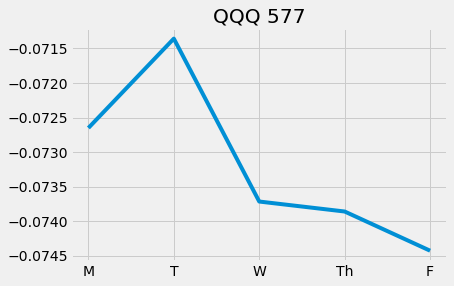

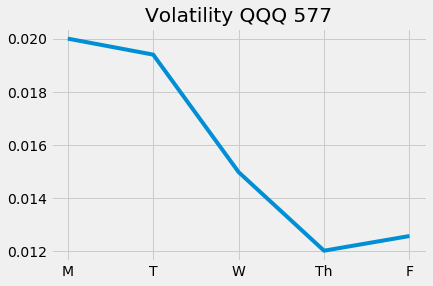

Epoch 579/5000
628/628 [==============================] - 1s 2ms/step - loss: 0.9909 - val_loss: 1.1191


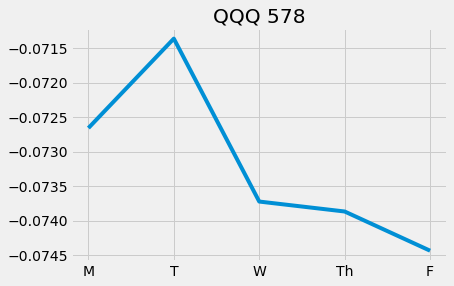

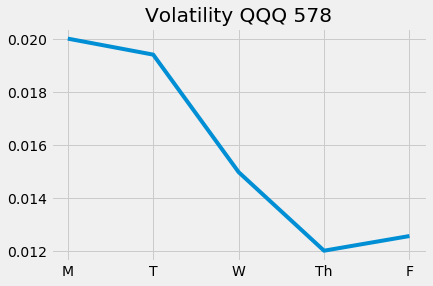

Epoch 580/5000
628/628 [==============================] - 1s 2ms/step - loss: 0.9974 - val_loss: 1.1191

Epoch 00580: ReduceLROnPlateau reducing learning rate to 1.1102230773579206e-19.


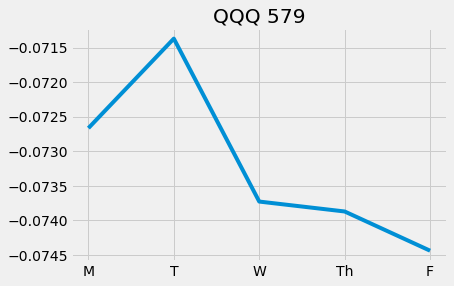

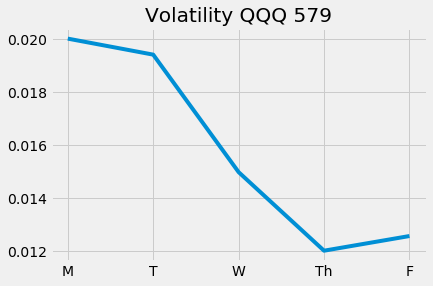

Epoch 581/5000
628/628 [==============================] - 1s 2ms/step - loss: 0.9953 - val_loss: 1.1190


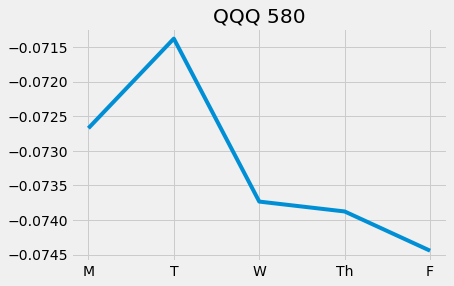

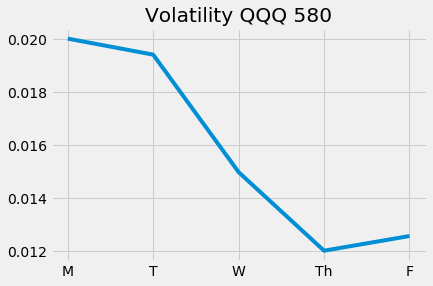

Epoch 582/5000
628/628 [==============================] - 1s 2ms/step - loss: 0.9947 - val_loss: 1.1190


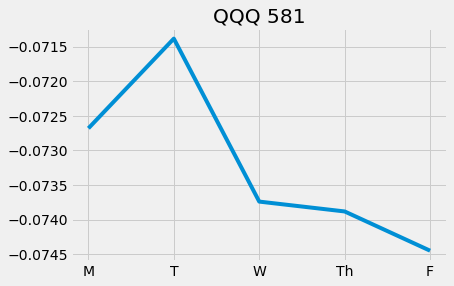

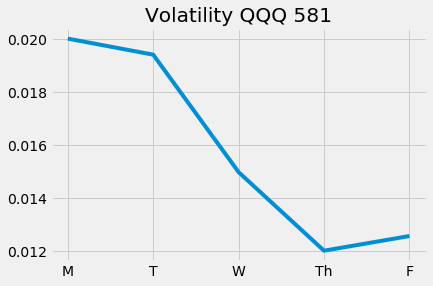

Epoch 583/5000
628/628 [==============================] - 1s 2ms/step - loss: 0.9973 - val_loss: 1.1190


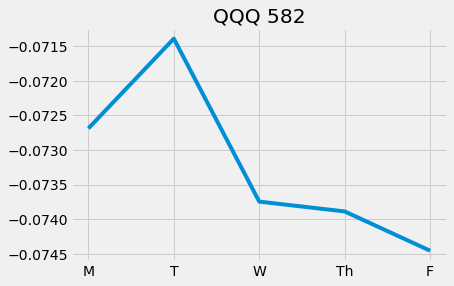

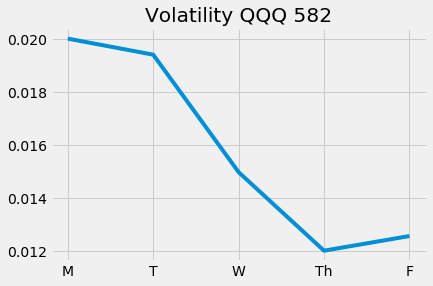

Epoch 584/5000
628/628 [==============================] - 1s 2ms/step - loss: 0.9973 - val_loss: 1.1190


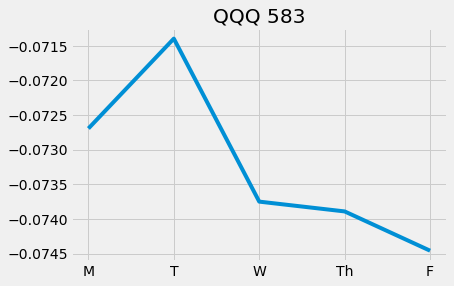

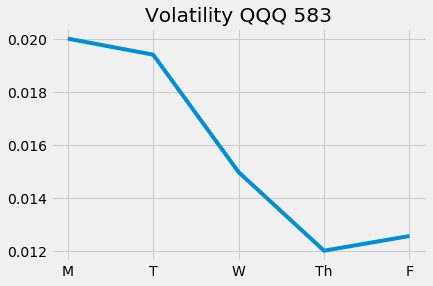

Epoch 585/5000
628/628 [==============================] - 1s 2ms/step - loss: 0.9951 - val_loss: 1.1190


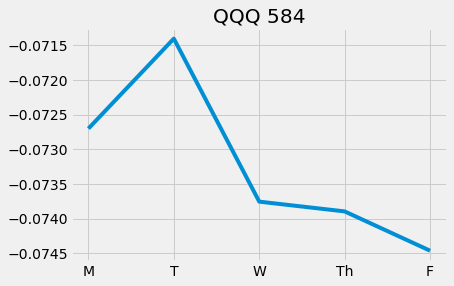

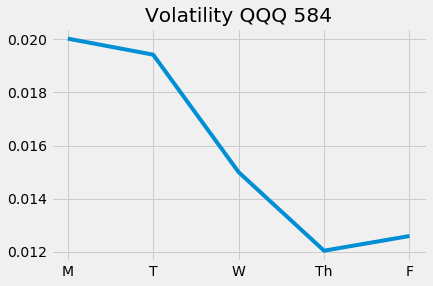

Epoch 586/5000
628/628 [==============================] - 2s 3ms/step - loss: 0.9985 - val_loss: 1.1189


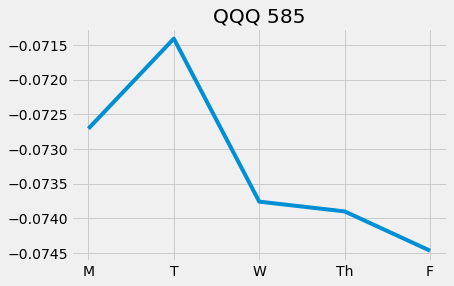

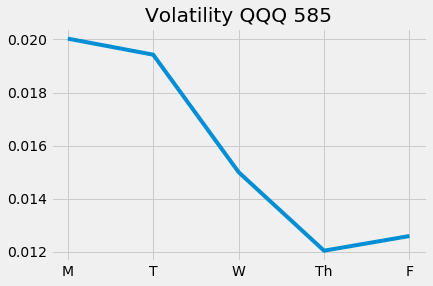

Epoch 587/5000
628/628 [==============================] - 1s 2ms/step - loss: 0.9990 - val_loss: 1.1189

Epoch 00587: ReduceLROnPlateau reducing learning rate to 5.551115386789603e-20.


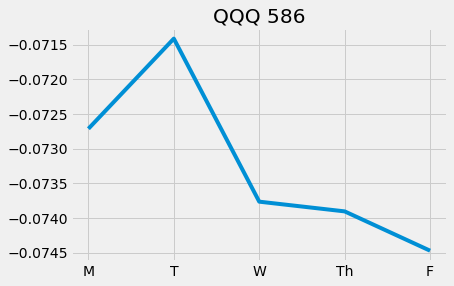

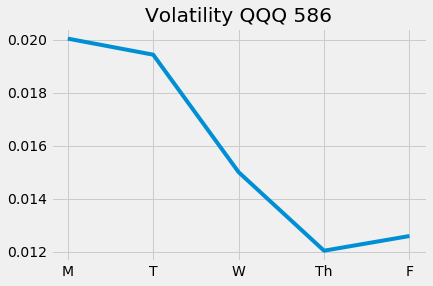

Epoch 588/5000
628/628 [==============================] - 1s 2ms/step - loss: 0.9946 - val_loss: 1.1189


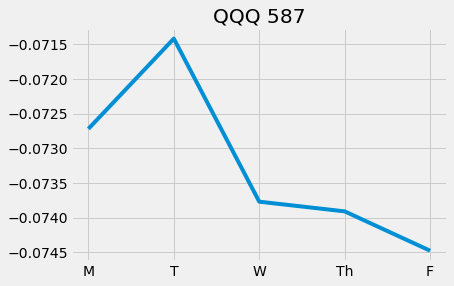

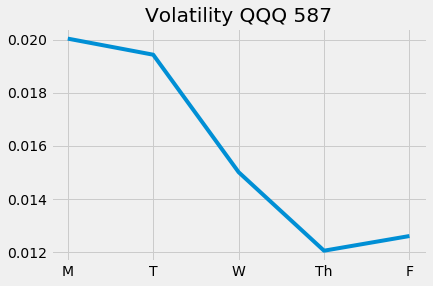

Epoch 589/5000
628/628 [==============================] - 1s 2ms/step - loss: 0.9979 - val_loss: 1.1189


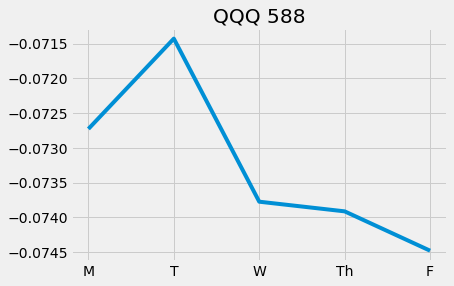

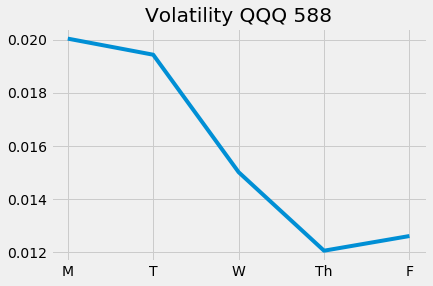

Epoch 590/5000
628/628 [==============================] - 1s 2ms/step - loss: 0.9940 - val_loss: 1.1189


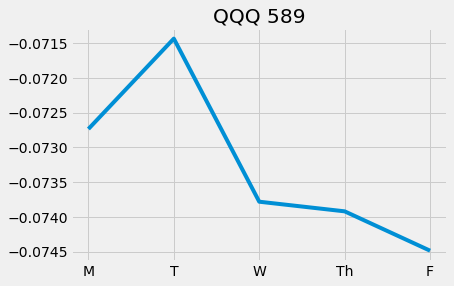

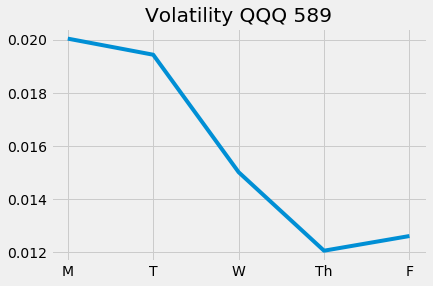

Epoch 591/5000
628/628 [==============================] - 1s 2ms/step - loss: 0.9962 - val_loss: 1.1188


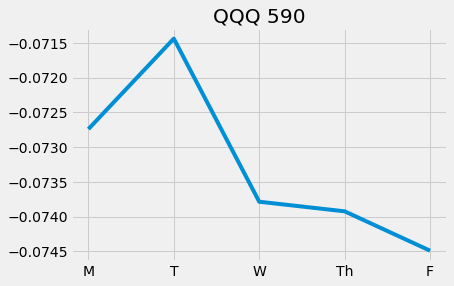

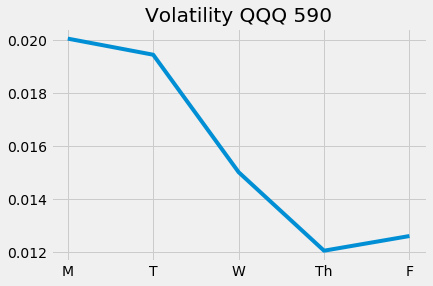

Epoch 592/5000
628/628 [==============================] - 1s 2ms/step - loss: 0.9955 - val_loss: 1.1188


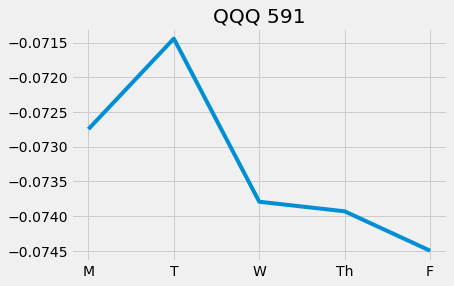

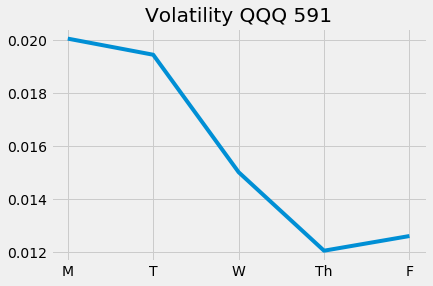

Epoch 593/5000
628/628 [==============================] - 1s 2ms/step - loss: 0.9925 - val_loss: 1.1188


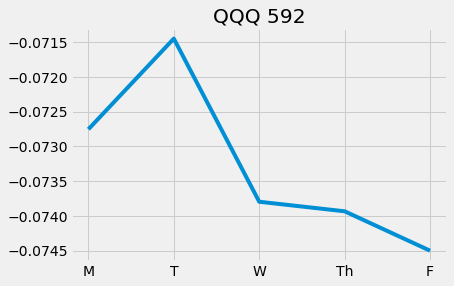

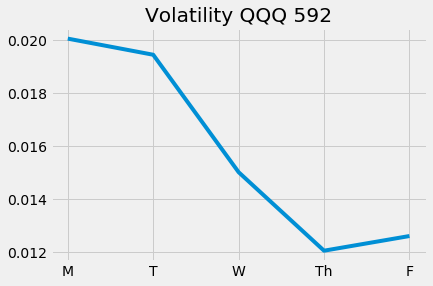

Epoch 594/5000
628/628 [==============================] - 1s 2ms/step - loss: 0.9986 - val_loss: 1.1188


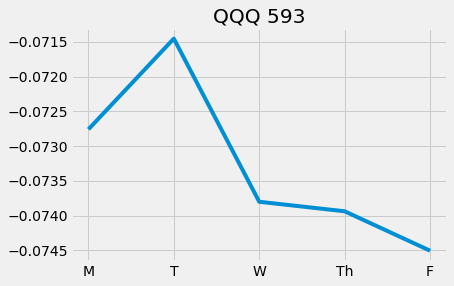

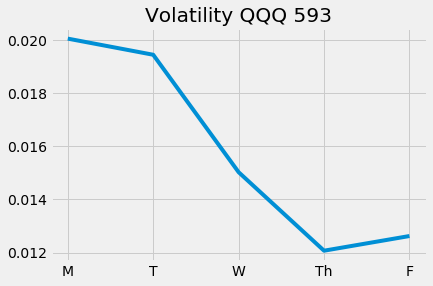

Epoch 595/5000
628/628 [==============================] - 1s 2ms/step - loss: 0.9949 - val_loss: 1.1188

Epoch 00595: ReduceLROnPlateau reducing learning rate to 2.7755576933948015e-20.


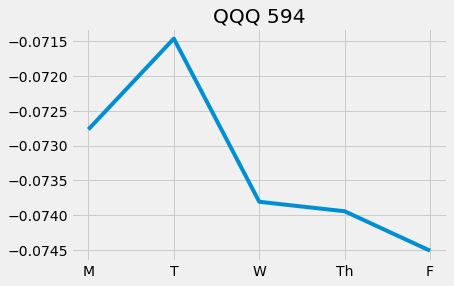

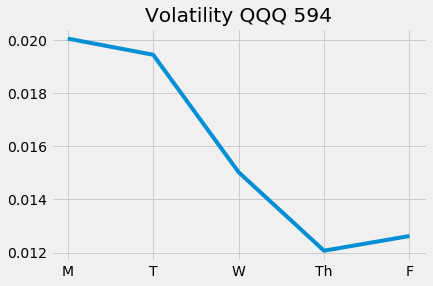

Epoch 596/5000
628/628 [==============================] - 1s 2ms/step - loss: 0.9886 - val_loss: 1.1187


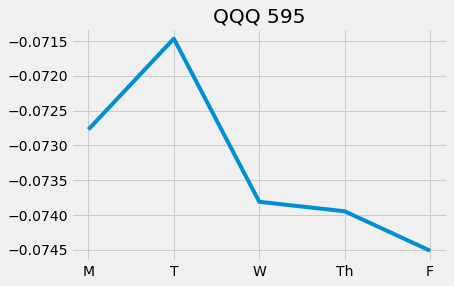

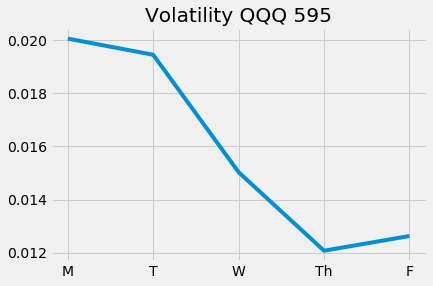

Epoch 597/5000
628/628 [==============================] - 1s 2ms/step - loss: 0.9994 - val_loss: 1.1187


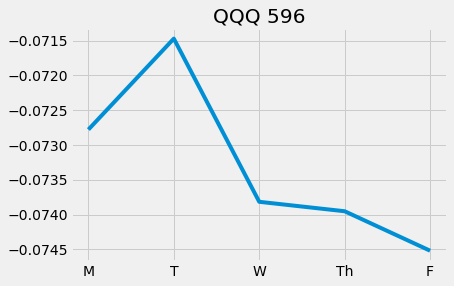

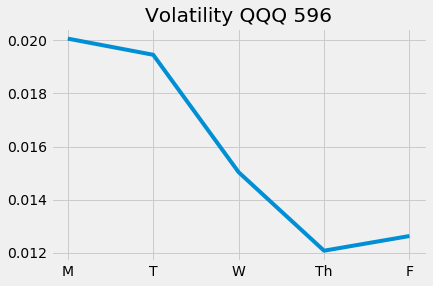

Epoch 598/5000
628/628 [==============================] - 1s 2ms/step - loss: 0.9979 - val_loss: 1.1187


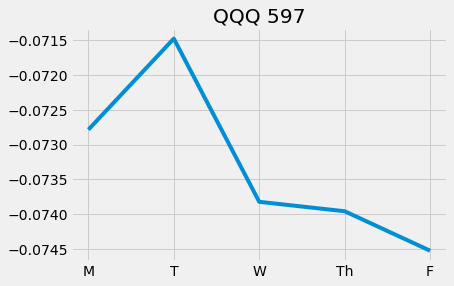

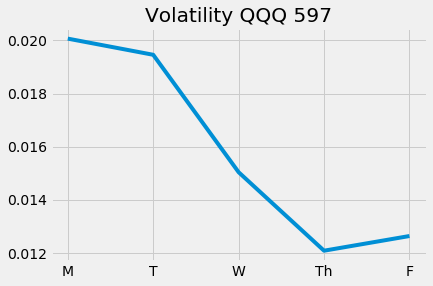

Epoch 599/5000
628/628 [==============================] - 1s 2ms/step - loss: 0.9964 - val_loss: 1.1187


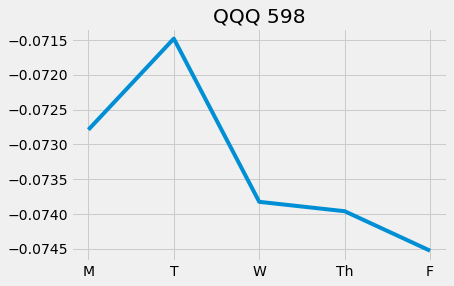

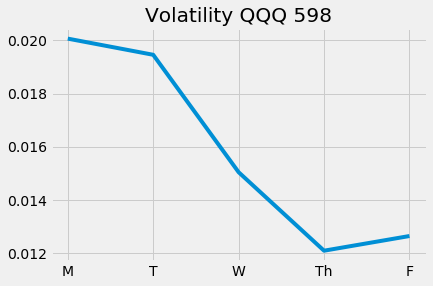

Epoch 600/5000
628/628 [==============================] - 1s 2ms/step - loss: 0.9943 - val_loss: 1.1187


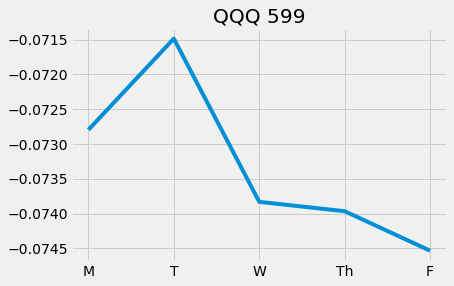

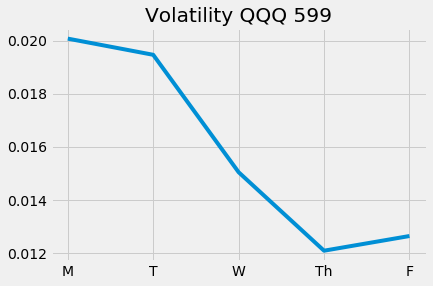

Epoch 601/5000
628/628 [==============================] - 1s 2ms/step - loss: 0.9967 - val_loss: 1.1186


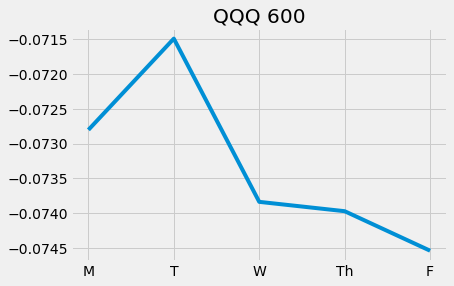

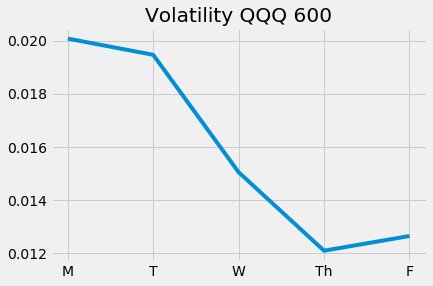

Epoch 602/5000
628/628 [==============================] - 1s 2ms/step - loss: 0.9923 - val_loss: 1.1186

Epoch 00602: ReduceLROnPlateau reducing learning rate to 1.3877788466974007e-20.


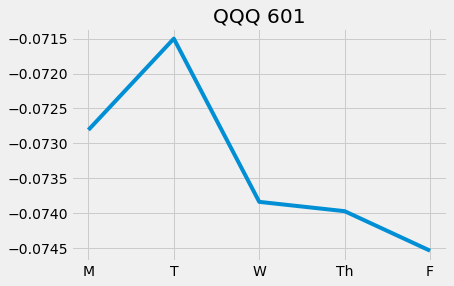

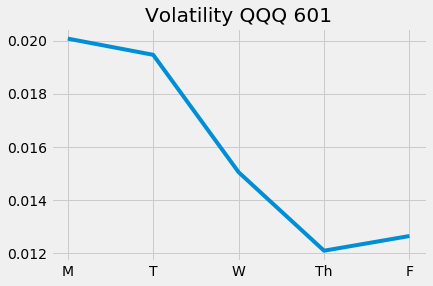

Epoch 603/5000
628/628 [==============================] - 1s 2ms/step - loss: 1.0005 - val_loss: 1.1186


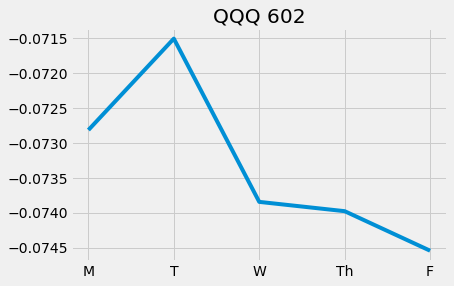

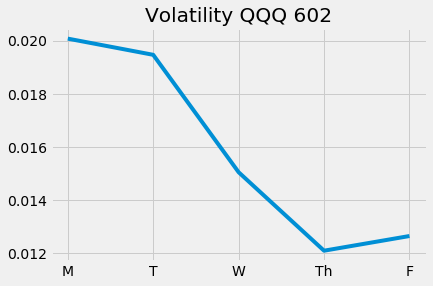

Epoch 604/5000
628/628 [==============================] - 1s 2ms/step - loss: 0.9950 - val_loss: 1.1186


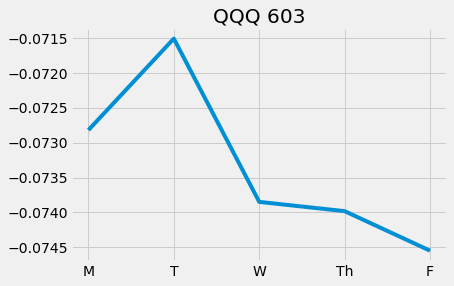

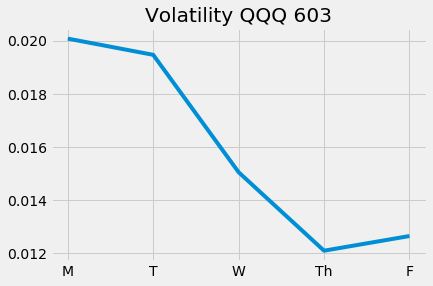

Epoch 605/5000
628/628 [==============================] - 1s 2ms/step - loss: 0.9990 - val_loss: 1.1186


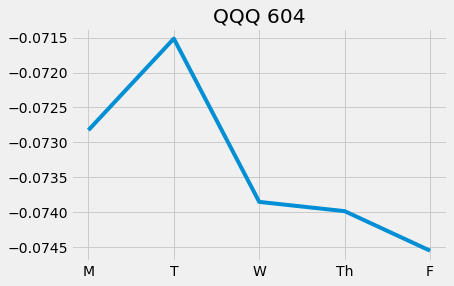

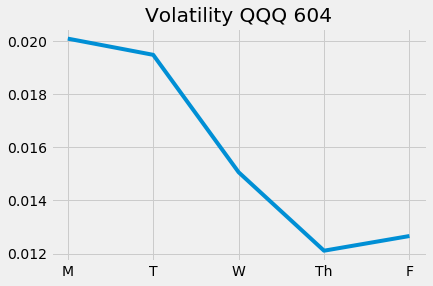

Epoch 606/5000
628/628 [==============================] - 2s 2ms/step - loss: 0.9946 - val_loss: 1.1186


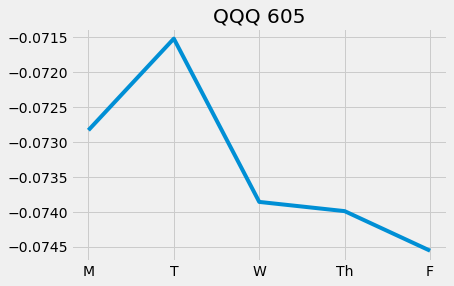

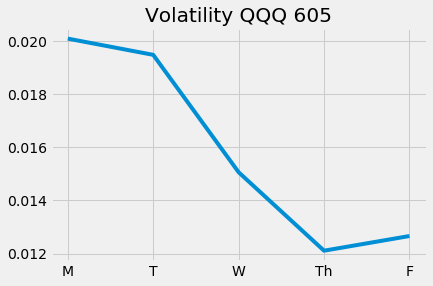

Epoch 607/5000
628/628 [==============================] - 2s 3ms/step - loss: 0.9977 - val_loss: 1.1185


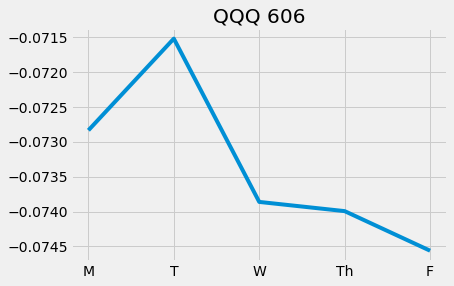

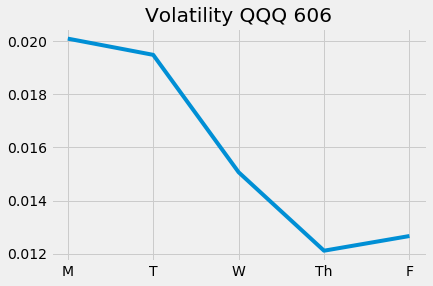

Epoch 608/5000
628/628 [==============================] - 1s 2ms/step - loss: 0.9936 - val_loss: 1.1185


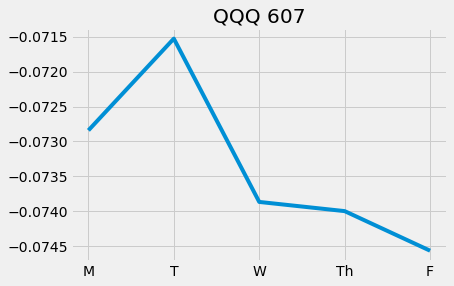

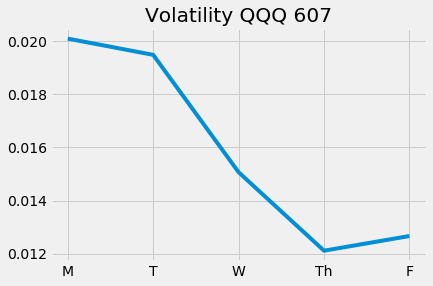

Epoch 609/5000
628/628 [==============================] - 2s 3ms/step - loss: 0.9956 - val_loss: 1.1185


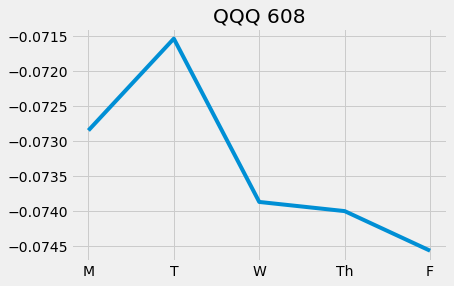

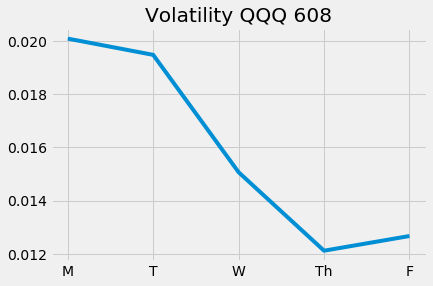

Epoch 610/5000
628/628 [==============================] - 2s 3ms/step - loss: 0.9958 - val_loss: 1.1185

Epoch 00610: ReduceLROnPlateau reducing learning rate to 6.938894233487004e-21.


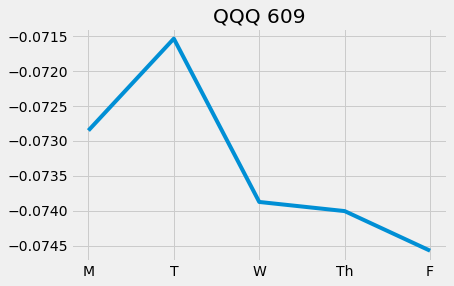

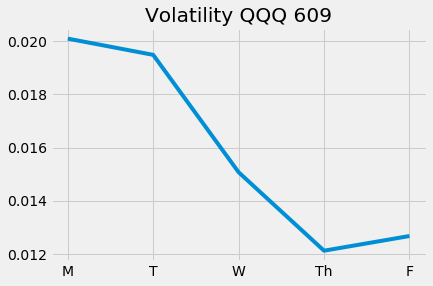

Epoch 611/5000
628/628 [==============================] - 2s 3ms/step - loss: 0.9956 - val_loss: 1.1185


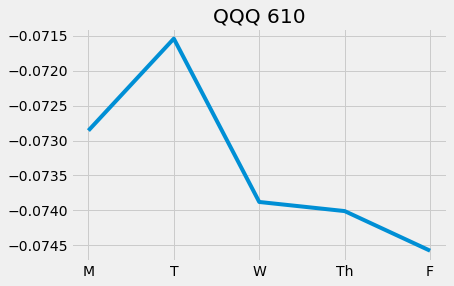

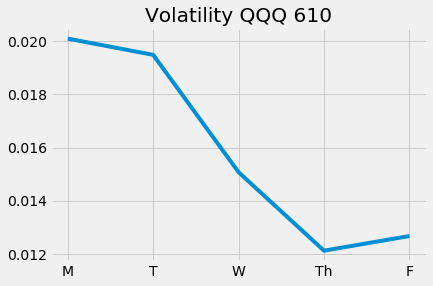

Epoch 612/5000
628/628 [==============================] - 1s 2ms/step - loss: 0.9992 - val_loss: 1.1185


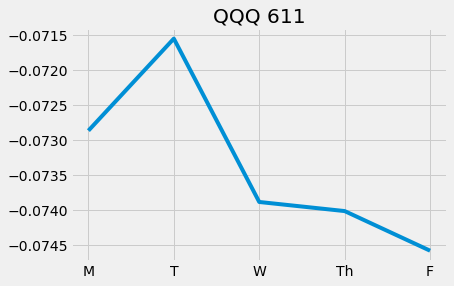

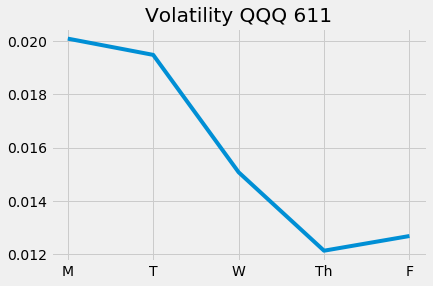

Epoch 613/5000
628/628 [==============================] - 1s 2ms/step - loss: 0.9984 - val_loss: 1.1184


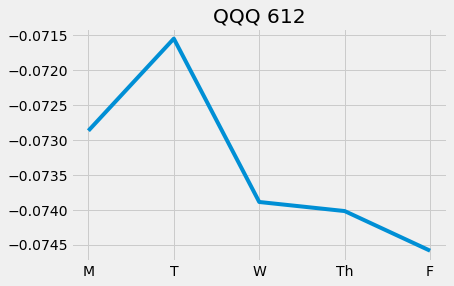

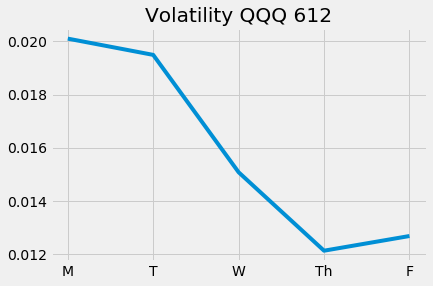

Epoch 614/5000
628/628 [==============================] - 2s 3ms/step - loss: 0.9974 - val_loss: 1.1184


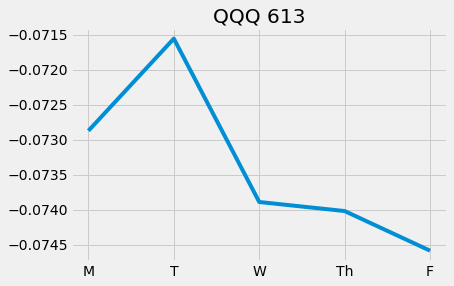

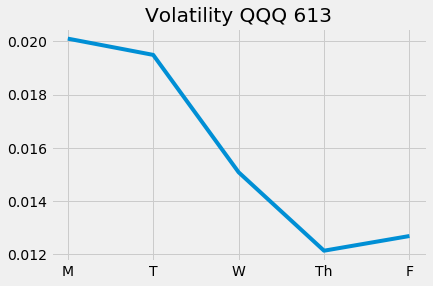

Epoch 615/5000
628/628 [==============================] - 1s 2ms/step - loss: 0.9960 - val_loss: 1.1184


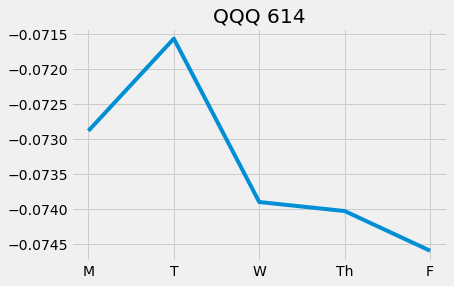

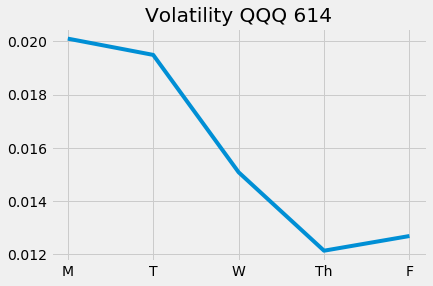

Epoch 616/5000
628/628 [==============================] - 1s 2ms/step - loss: 0.9960 - val_loss: 1.1184


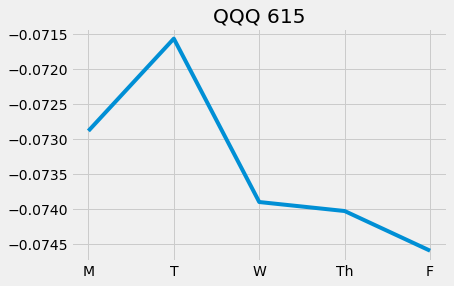

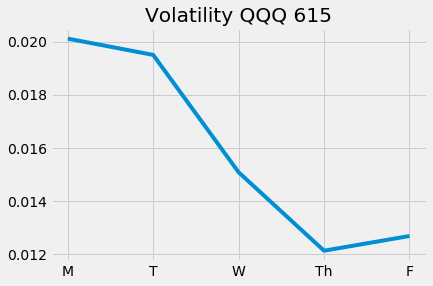

Epoch 617/5000
628/628 [==============================] - 1s 2ms/step - loss: 1.0008 - val_loss: 1.1184

Epoch 00617: ReduceLROnPlateau reducing learning rate to 3.469447116743502e-21.


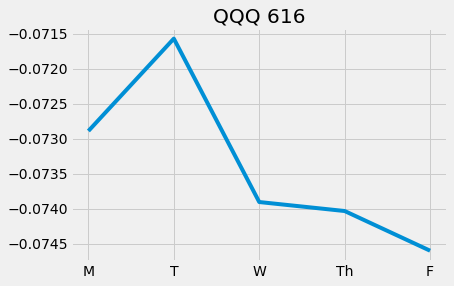

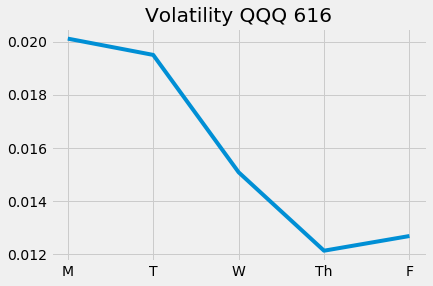

Epoch 618/5000
628/628 [==============================] - 1s 2ms/step - loss: 0.9980 - val_loss: 1.1184


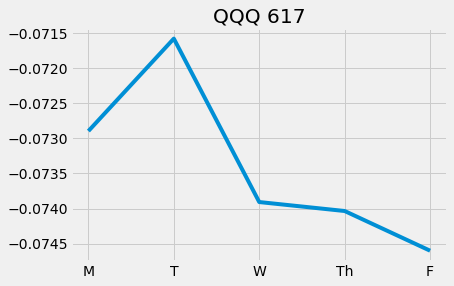

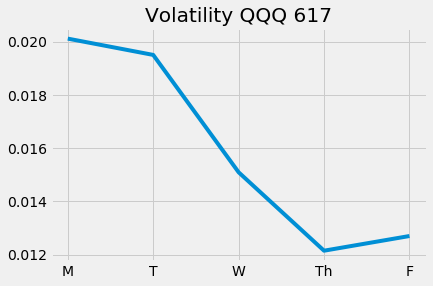

Epoch 619/5000
628/628 [==============================] - 2s 3ms/step - loss: 0.9949 - val_loss: 1.1184


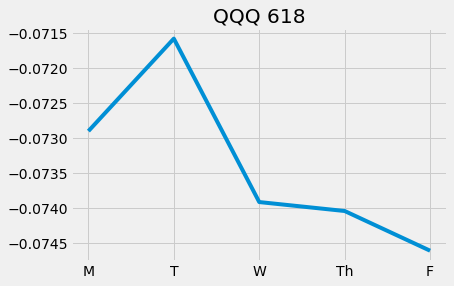

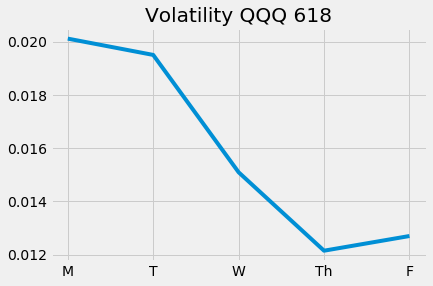

Epoch 620/5000
628/628 [==============================] - 1s 2ms/step - loss: 0.9964 - val_loss: 1.1183


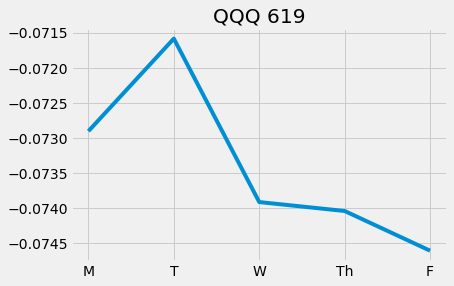

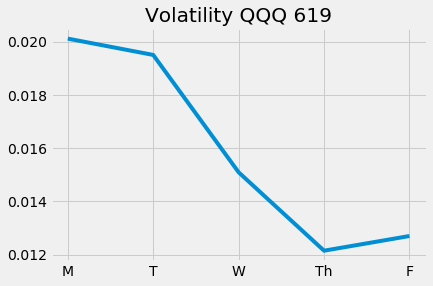

Epoch 621/5000
628/628 [==============================] - 1s 2ms/step - loss: 1.0062 - val_loss: 1.1183


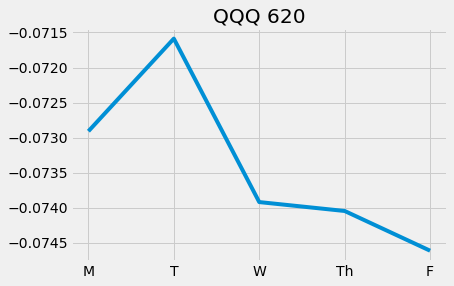

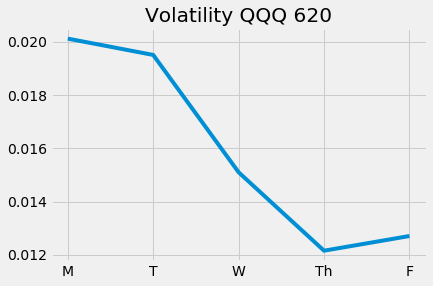

Epoch 622/5000
628/628 [==============================] - 1s 2ms/step - loss: 1.0029 - val_loss: 1.1183


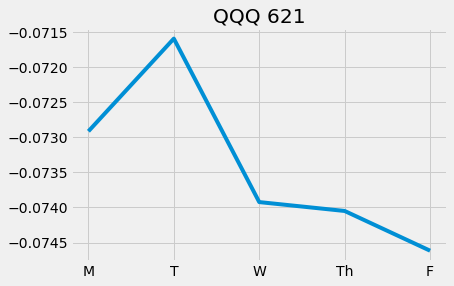

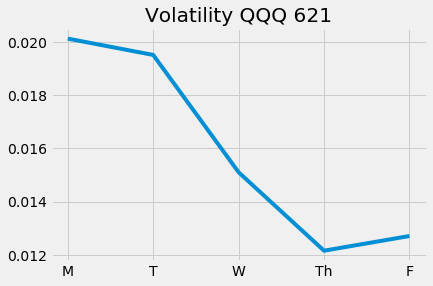

Epoch 623/5000
628/628 [==============================] - 1s 2ms/step - loss: 0.9953 - val_loss: 1.1183


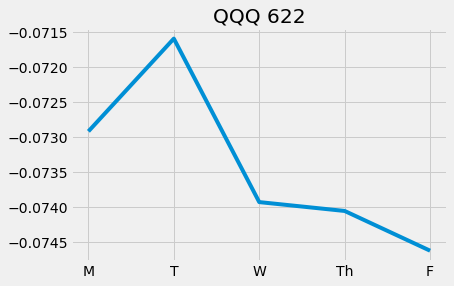

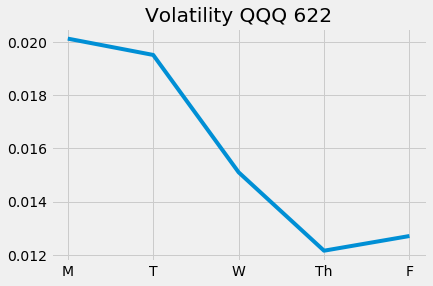

Epoch 624/5000
628/628 [==============================] - 1s 2ms/step - loss: 0.9928 - val_loss: 1.1183


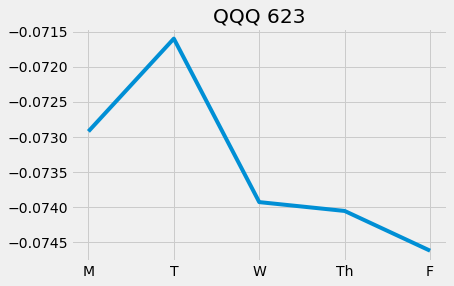

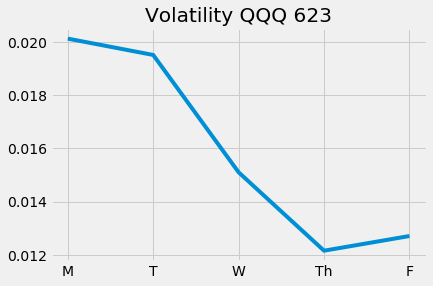

Epoch 625/5000
628/628 [==============================] - 1s 2ms/step - loss: 0.9938 - val_loss: 1.1183

Epoch 00625: ReduceLROnPlateau reducing learning rate to 1.734723558371751e-21.


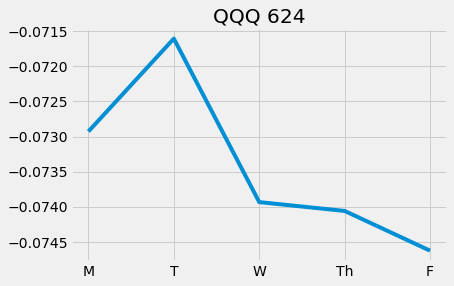

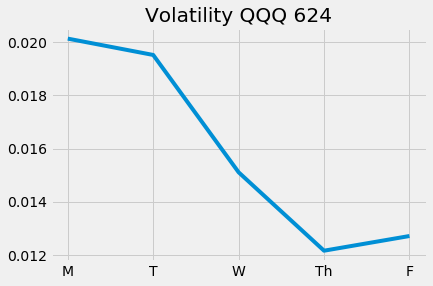

Epoch 626/5000
628/628 [==============================] - 1s 2ms/step - loss: 0.9962 - val_loss: 1.1183


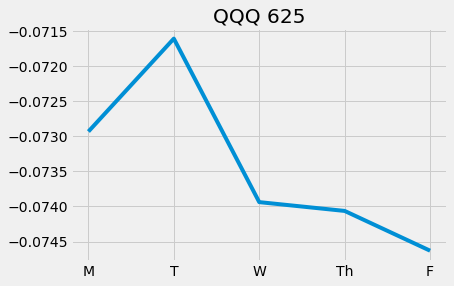

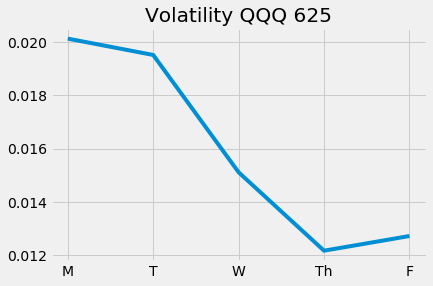

Epoch 627/5000
628/628 [==============================] - 1s 2ms/step - loss: 0.9907 - val_loss: 1.1182


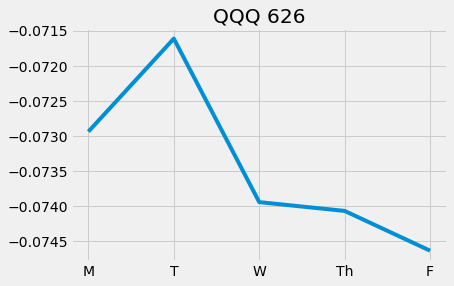

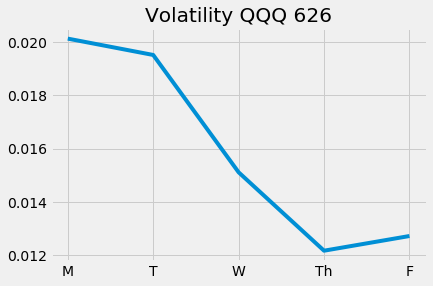

Epoch 628/5000
628/628 [==============================] - 1s 2ms/step - loss: 0.9926 - val_loss: 1.1182


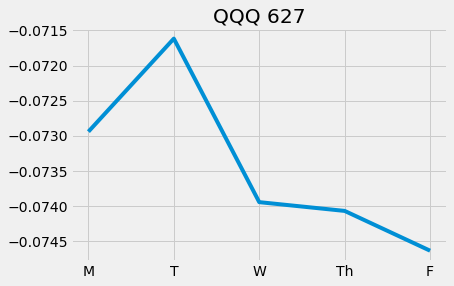

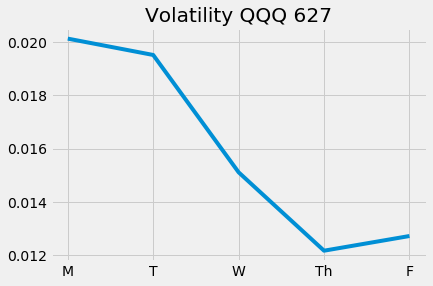

Epoch 629/5000
628/628 [==============================] - 1s 2ms/step - loss: 0.9971 - val_loss: 1.1182


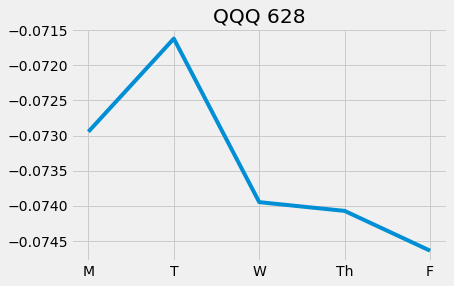

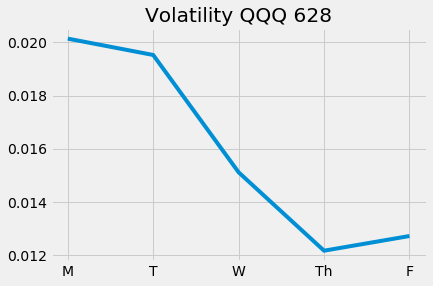

Epoch 630/5000
628/628 [==============================] - 1s 2ms/step - loss: 0.9962 - val_loss: 1.1182


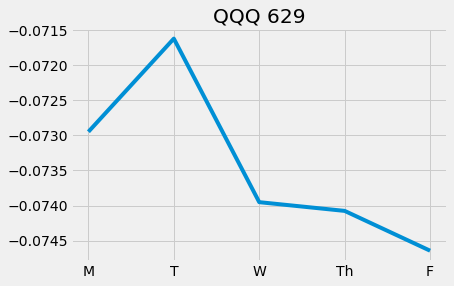

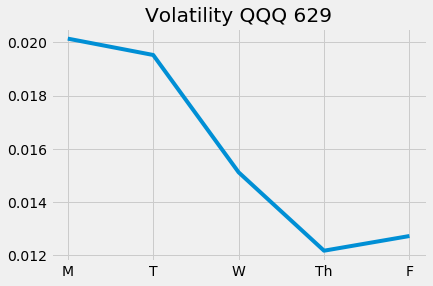

Epoch 631/5000
628/628 [==============================] - 1s 2ms/step - loss: 0.9999 - val_loss: 1.1182


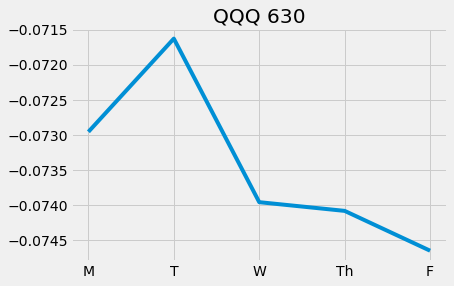

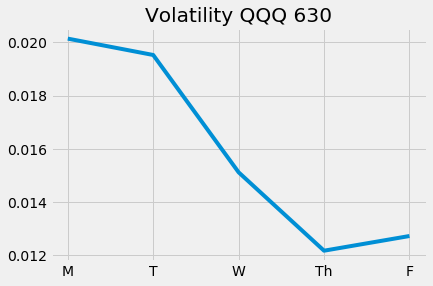

Epoch 632/5000
628/628 [==============================] - 1s 2ms/step - loss: 0.9957 - val_loss: 1.1182

Epoch 00632: ReduceLROnPlateau reducing learning rate to 8.673617791858755e-22.


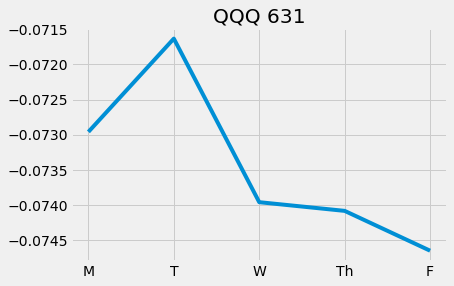

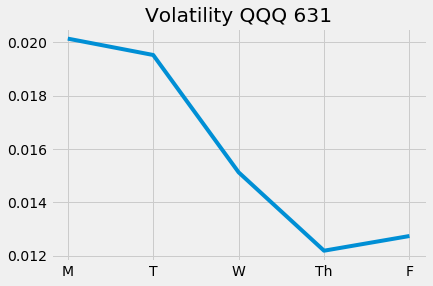

Epoch 633/5000
628/628 [==============================] - 1s 2ms/step - loss: 0.9992 - val_loss: 1.1182


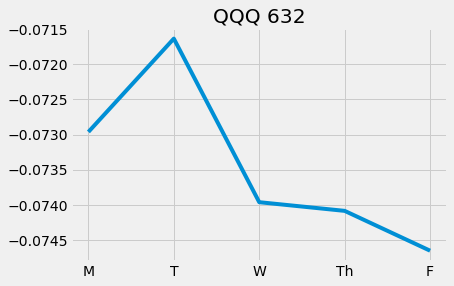

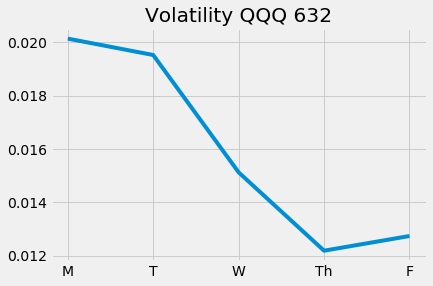

Epoch 634/5000
628/628 [==============================] - 1s 2ms/step - loss: 0.9987 - val_loss: 1.1182


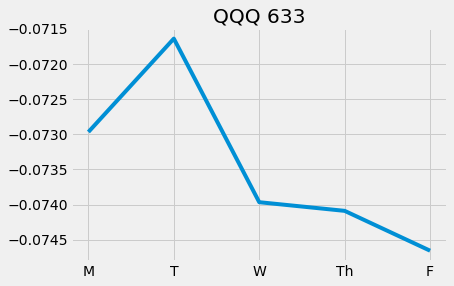

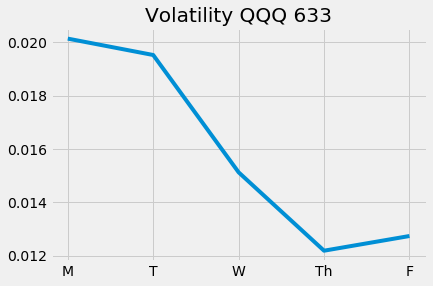

Epoch 635/5000
628/628 [==============================] - 1s 2ms/step - loss: 0.9920 - val_loss: 1.1181


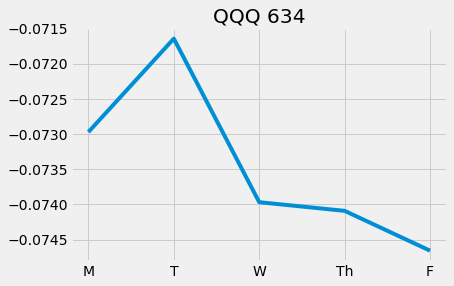

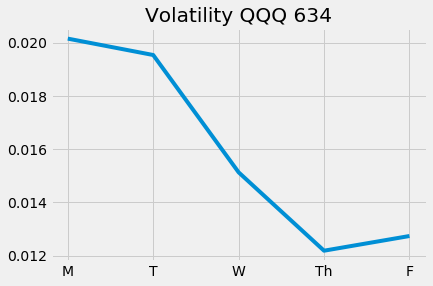

Epoch 636/5000
628/628 [==============================] - 1s 2ms/step - loss: 0.9945 - val_loss: 1.1181


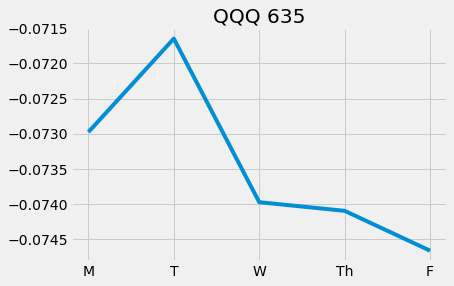

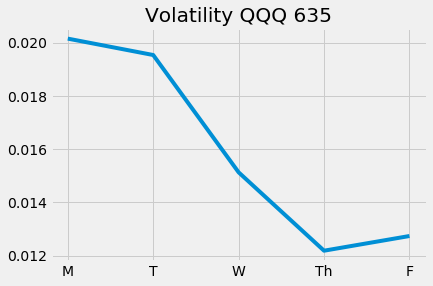

Epoch 637/5000
628/628 [==============================] - 1s 2ms/step - loss: 0.9987 - val_loss: 1.1181


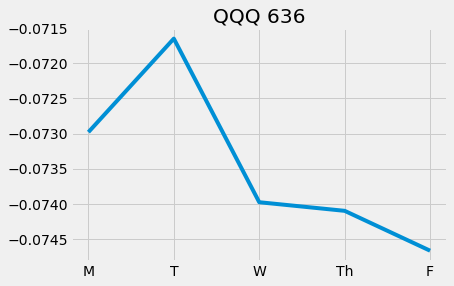

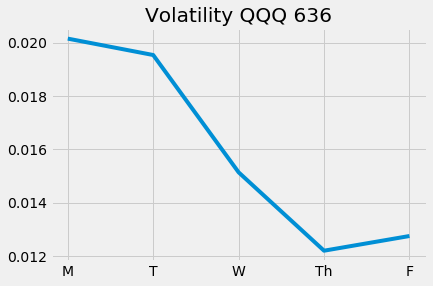

Epoch 638/5000
628/628 [==============================] - 1s 2ms/step - loss: 1.0003 - val_loss: 1.1181


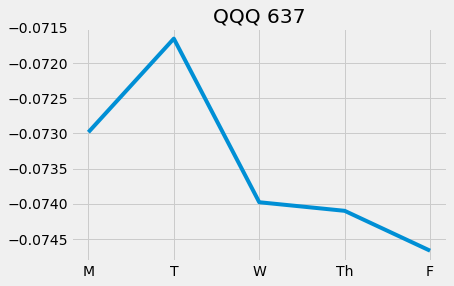

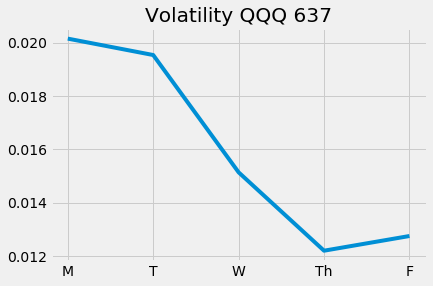

Epoch 639/5000
628/628 [==============================] - 1s 2ms/step - loss: 1.0063 - val_loss: 1.1181


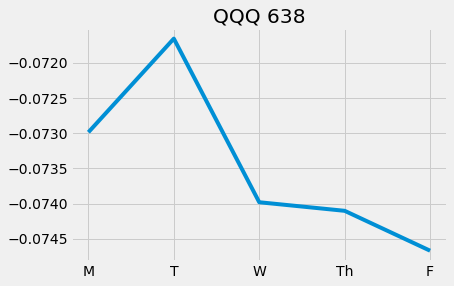

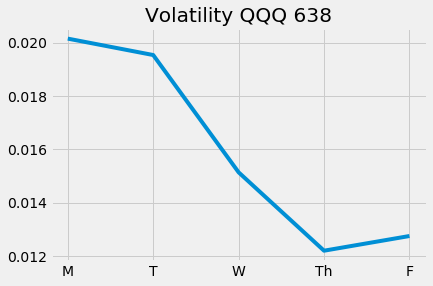

Epoch 640/5000
628/628 [==============================] - 1s 2ms/step - loss: 0.9922 - val_loss: 1.1181

Epoch 00640: ReduceLROnPlateau reducing learning rate to 4.336808895929377e-22.


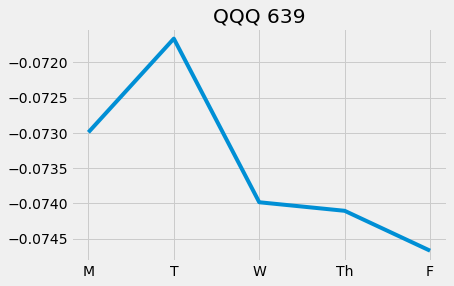

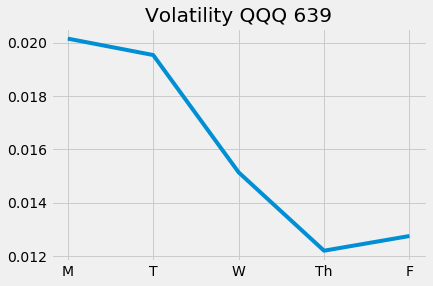

Epoch 641/5000
628/628 [==============================] - 1s 2ms/step - loss: 0.9904 - val_loss: 1.1181


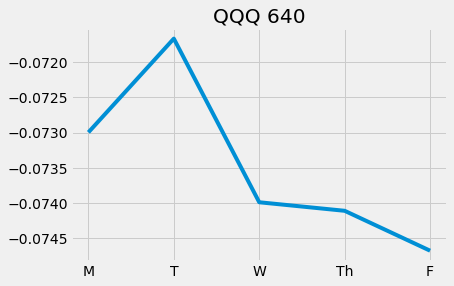

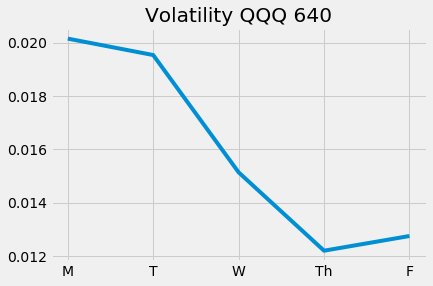

Epoch 642/5000
628/628 [==============================] - 1s 2ms/step - loss: 0.9961 - val_loss: 1.1181


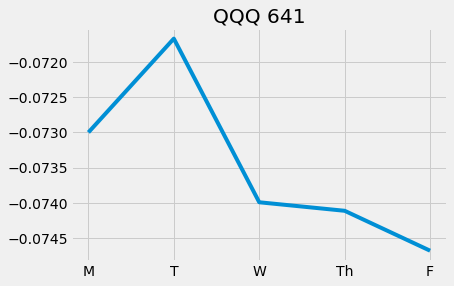

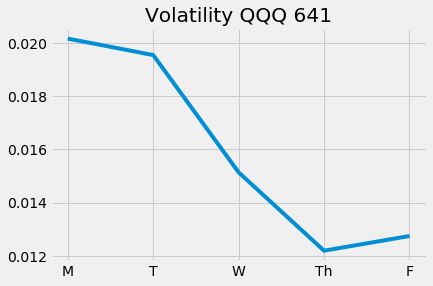

Epoch 643/5000
628/628 [==============================] - 1s 2ms/step - loss: 0.9954 - val_loss: 1.1180


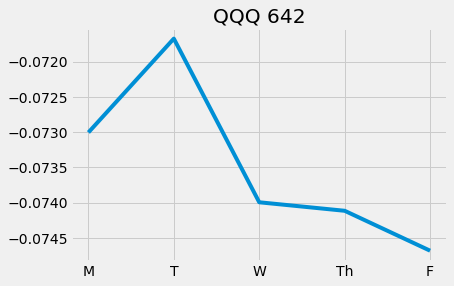

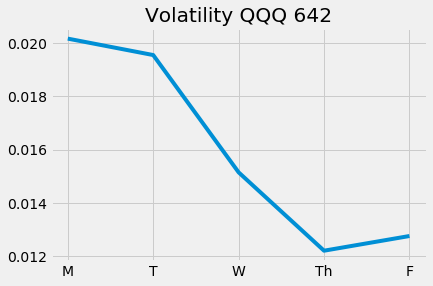

Epoch 644/5000
628/628 [==============================] - 1s 2ms/step - loss: 1.0006 - val_loss: 1.1180


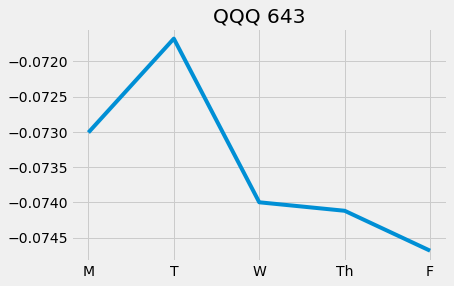

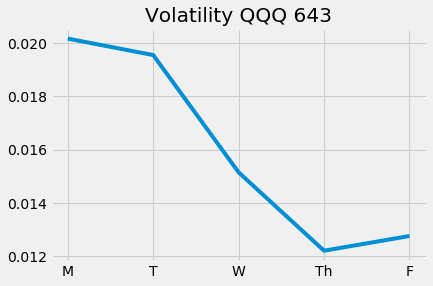

Epoch 645/5000
628/628 [==============================] - 1s 2ms/step - loss: 0.9989 - val_loss: 1.1180


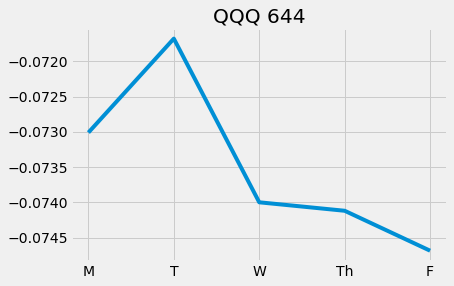

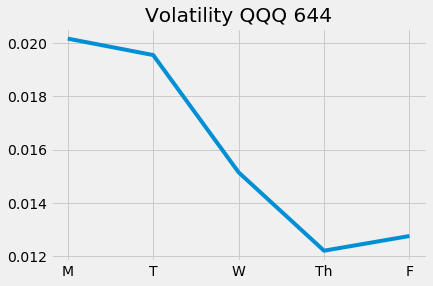

Epoch 646/5000
628/628 [==============================] - 1s 2ms/step - loss: 1.0001 - val_loss: 1.1180


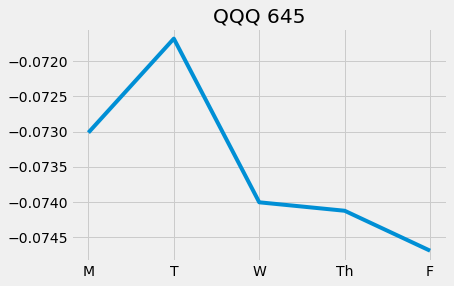

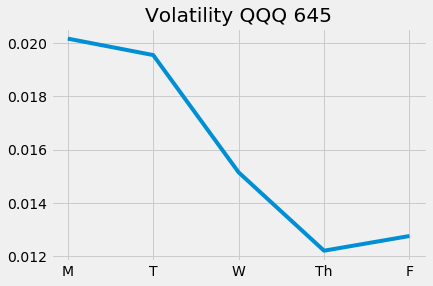

Epoch 647/5000
628/628 [==============================] - 1s 2ms/step - loss: 0.9937 - val_loss: 1.1180

Epoch 00647: ReduceLROnPlateau reducing learning rate to 2.1684044479646887e-22.


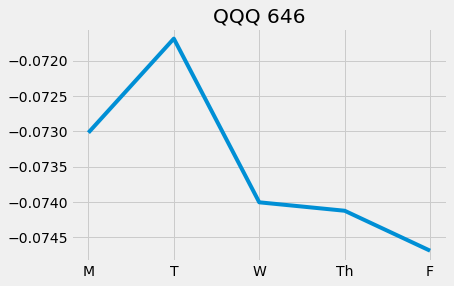

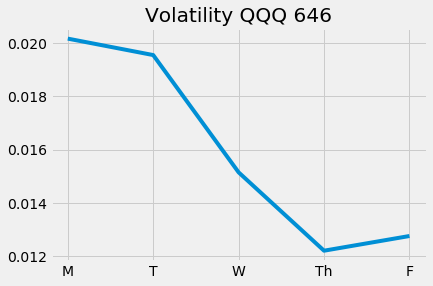

Epoch 648/5000
628/628 [==============================] - 1s 2ms/step - loss: 0.9936 - val_loss: 1.1180


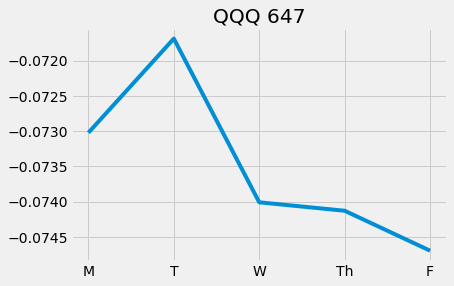

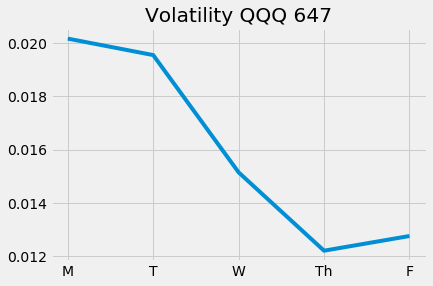

Epoch 649/5000
628/628 [==============================] - 1s 2ms/step - loss: 0.9977 - val_loss: 1.1180


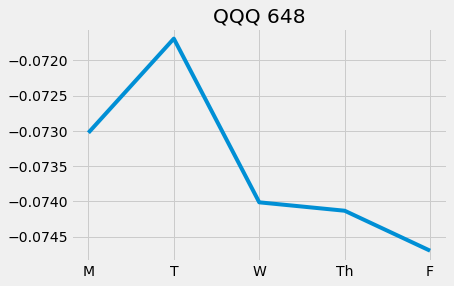

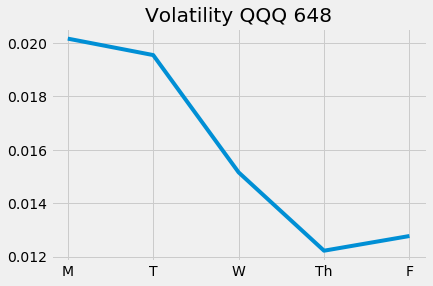

Epoch 650/5000
628/628 [==============================] - 2s 2ms/step - loss: 0.9936 - val_loss: 1.1180


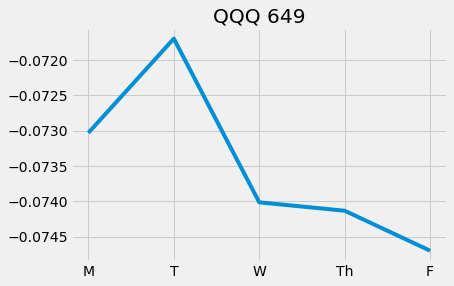

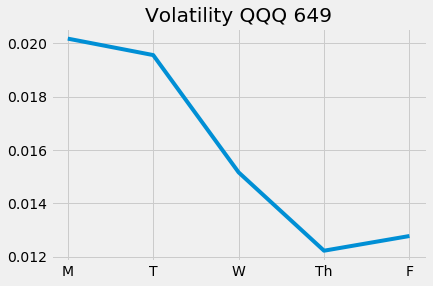

Epoch 651/5000
628/628 [==============================] - 2s 3ms/step - loss: 0.9953 - val_loss: 1.1180


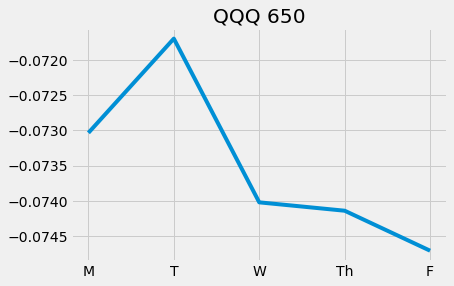

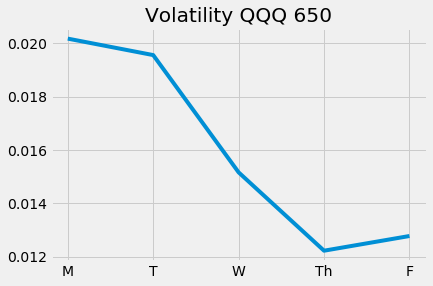

Epoch 652/5000
628/628 [==============================] - 1s 2ms/step - loss: 1.0014 - val_loss: 1.1179


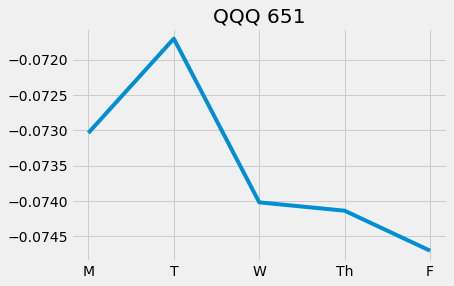

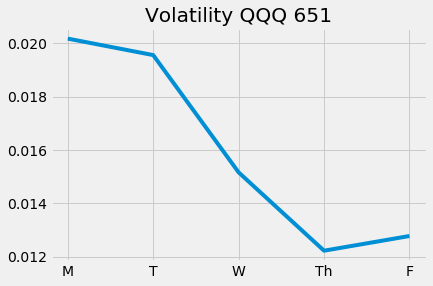

Epoch 653/5000
628/628 [==============================] - 2s 2ms/step - loss: 0.9991 - val_loss: 1.1179


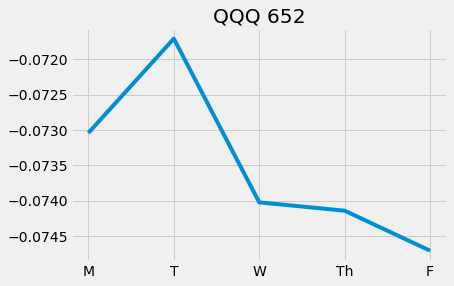

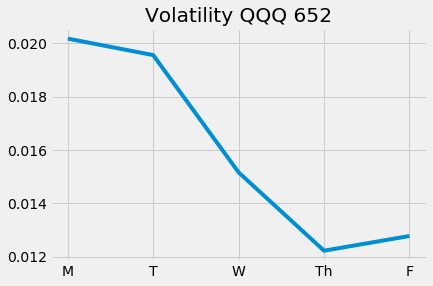

Epoch 654/5000
628/628 [==============================] - 1s 2ms/step - loss: 0.9983 - val_loss: 1.1179


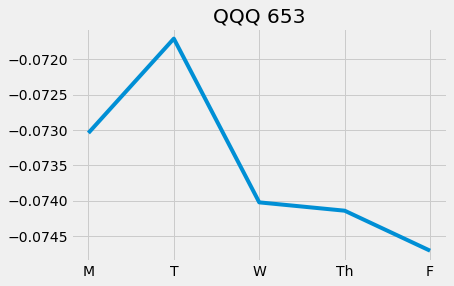

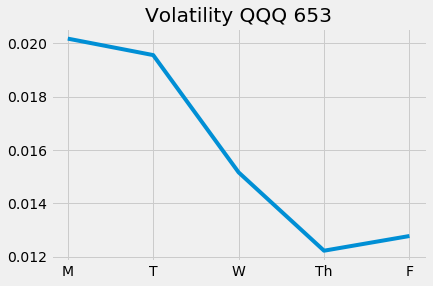

Epoch 655/5000
628/628 [==============================] - 2s 3ms/step - loss: 1.0032 - val_loss: 1.1179

Epoch 00655: ReduceLROnPlateau reducing learning rate to 1.0842022239823443e-22.


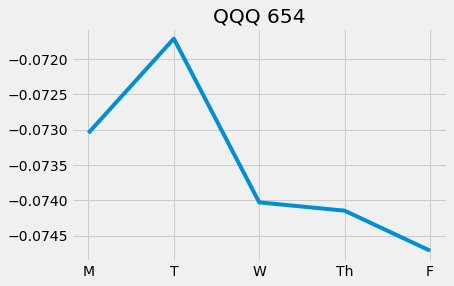

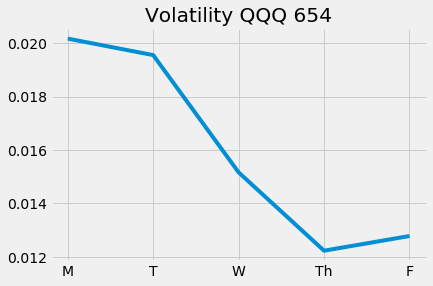

Epoch 656/5000
628/628 [==============================] - 1s 2ms/step - loss: 1.0025 - val_loss: 1.1179


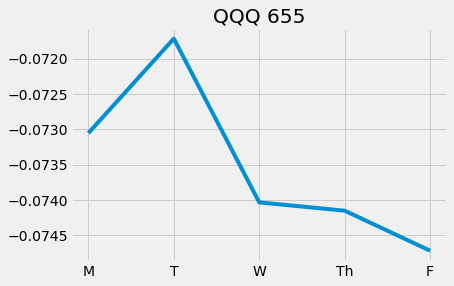

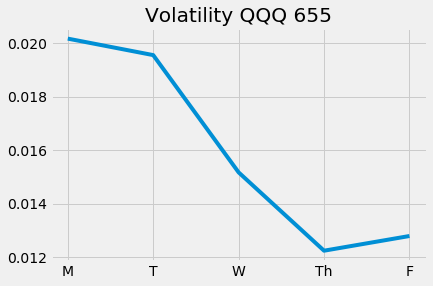

Epoch 657/5000
628/628 [==============================] - 1s 2ms/step - loss: 0.9961 - val_loss: 1.1179


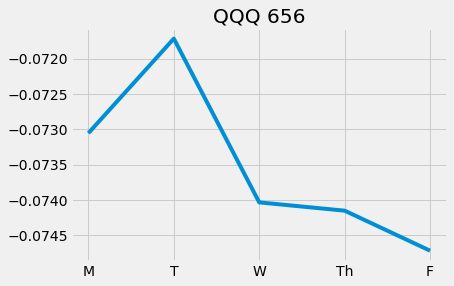

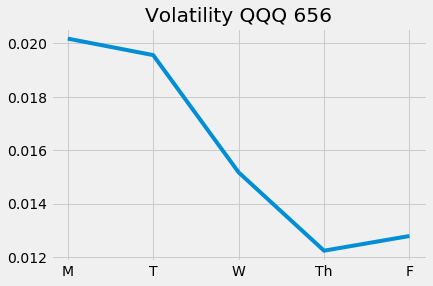

Epoch 658/5000
628/628 [==============================] - 1s 2ms/step - loss: 0.9990 - val_loss: 1.1179


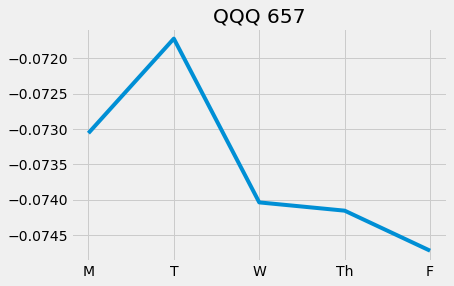

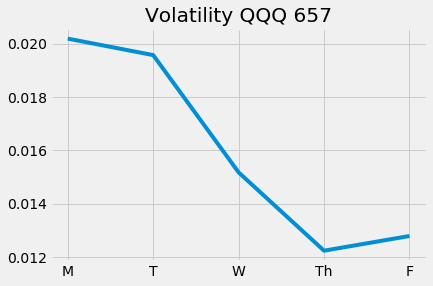

Epoch 659/5000
628/628 [==============================] - 1s 2ms/step - loss: 0.9936 - val_loss: 1.1179


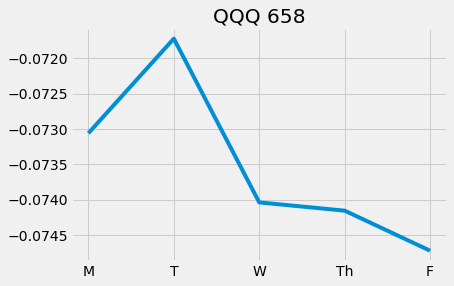

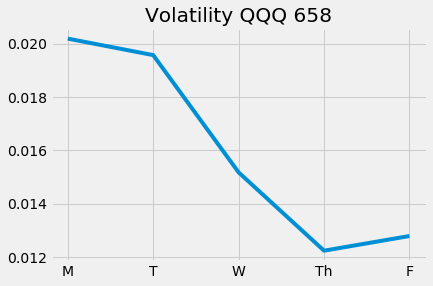

Epoch 660/5000
628/628 [==============================] - 2s 3ms/step - loss: 0.9938 - val_loss: 1.1179


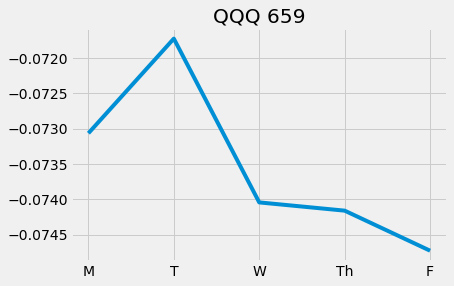

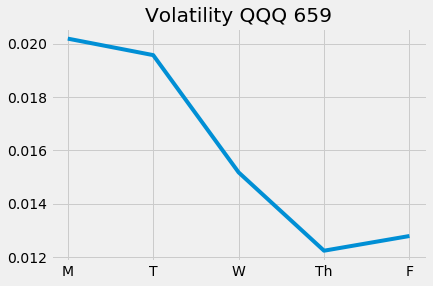

Epoch 661/5000
628/628 [==============================] - 2s 3ms/step - loss: 0.9958 - val_loss: 1.1179


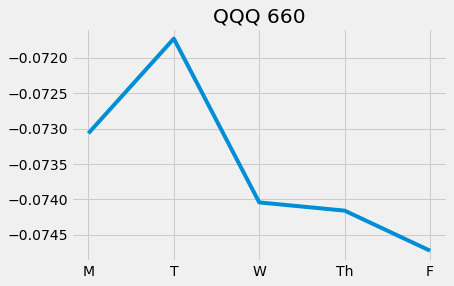

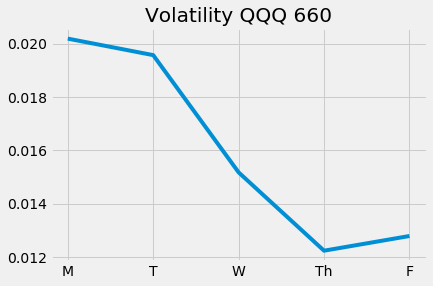

Epoch 662/5000
628/628 [==============================] - 1s 2ms/step - loss: 0.9964 - val_loss: 1.1178

Epoch 00662: ReduceLROnPlateau reducing learning rate to 5.421011119911722e-23.


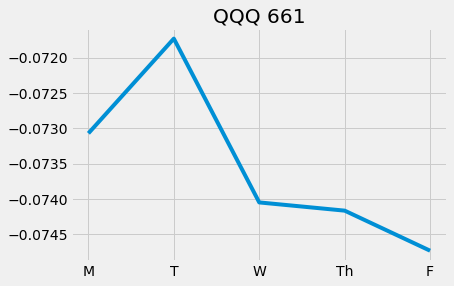

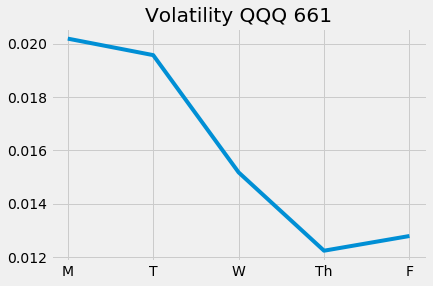

Epoch 663/5000
628/628 [==============================] - 2s 3ms/step - loss: 0.9966 - val_loss: 1.1178


KeyboardInterrupt: 

In [105]:
model = keras.models.load_model('./models/'+MODELNAME+'_best.hdf5')
VALIDATIONSIZE = 0.10
EPOCHS = 5000
reduce_lr_loss = ReduceLROnPlateau(monitor='val_loss', factor=0.5, patience=15, verbose=1, epsilon=1e-4, mode='min')
reduce_lr_loss_training = ReduceLROnPlateau(monitor='loss', factor=0.5, patience=15, verbose=1, epsilon=1e-4, mode='min')
history = model.fit(
    x_train,
    y_train,
    batch_size=1024,
    nb_epoch=EPOCHS,
    validation_split=VALIDATIONSIZE,
    callbacks = [reduce_lr_loss, mcp_save, tbrd, reduce_lr_loss_training, testmodelcb],
    shuffle=True)

In [111]:
best_model = keras.models.load_model('./models/'+MODELNAME+'_best.hdf5') 

In [112]:
# 5 refers to days of data. 5 days worth. each 1 row has 36 features
days = 5

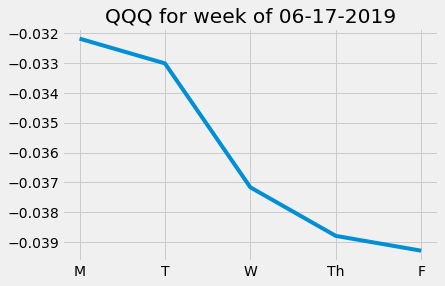

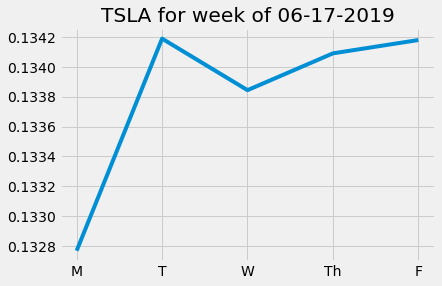

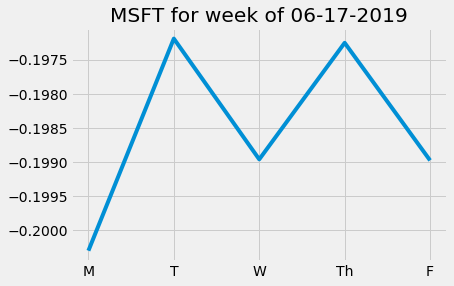

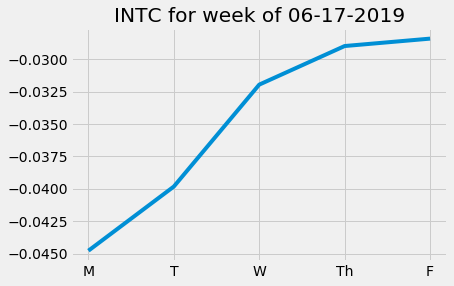

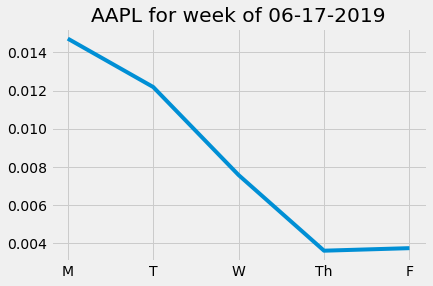

...

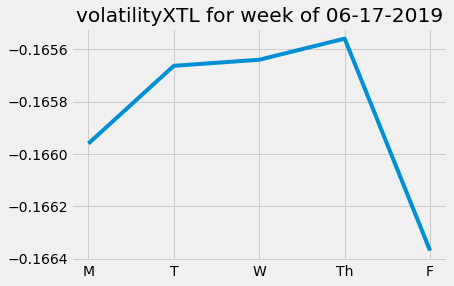

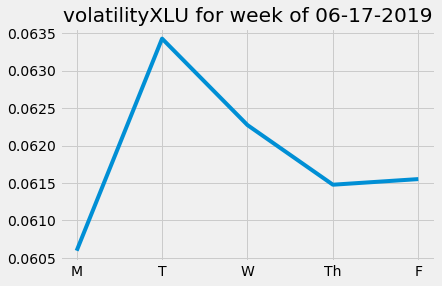

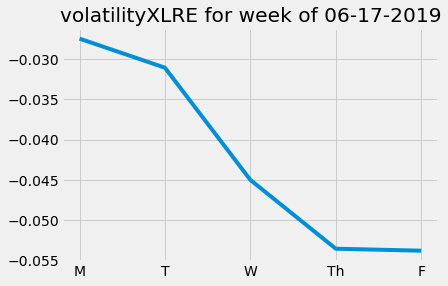

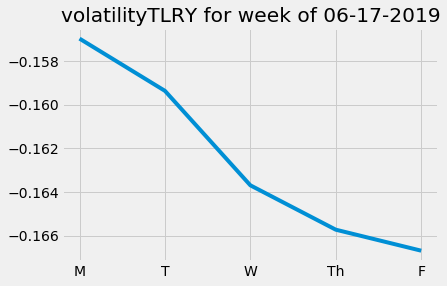

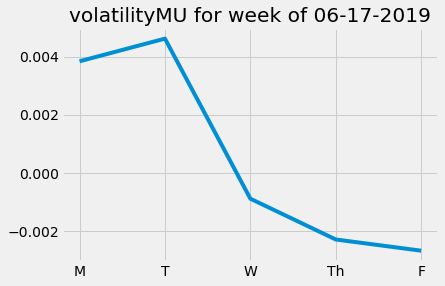

In [113]:
for t in list(ticker_lookup.keys()):
    plt.style.use('fivethirtyeight')
    plt.title(str(t)+" for week of "+"06-17-2019")
    plt.plot([i[ticker_lookup[t]] for i in best_model.predict(np.reshape(data[-days:], (days, 1, data.shape[1])))])
    plt.xticks(np.arange(5), ('M', 'T', 'W', 'Th', 'F'))
    if "volatility" in t:
        plt.savefig('../reports/'+t.split("volatility")[1]+'_volatility_prediction.png')
    else:
        plt.savefig('../reports/'+t+'_prediction.png')
    plt.show()

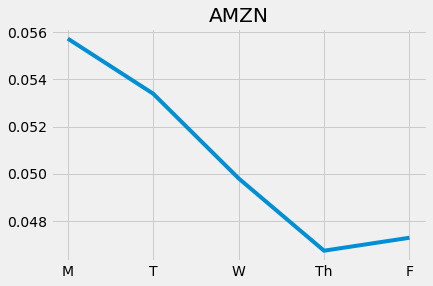

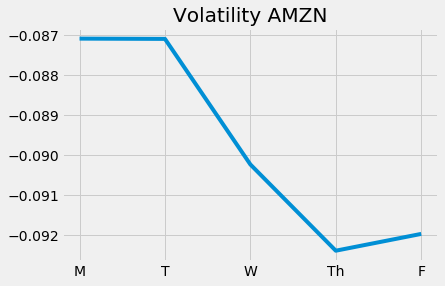

In [118]:
t = "AMZN"
plt.style.use('fivethirtyeight')
plt.title(t)
plt.plot([i[ticker_lookup[t]] for i in best_model.predict(np.reshape(data[-days:], (days, 1, data.shape[1])))])
plt.xticks(np.arange(5), ('M', 'T', 'W', 'Th', 'F'))
plt.show()

plt.title("Volatility "+t)
plt.plot([i[ticker_lookup["volatility"+t]] for i in best_model.predict(np.reshape(data[-days:], (days, 1, data.shape[1])))])
plt.xticks(np.arange(5), ('M', 'T', 'W', 'Th', 'F'))
plt.show()

In [79]:
def maxProfit(prices, n, k): 
      
    # Bottom-up DP approach 
    profit = [[0 for i in range(k + 1)] 
                 for j in range(n)] 
      
    # Profit is zero for the first 
    # day and for zero transactions 
    for i in range(1, n): 
          
        for j in range(1, k + 1): 
            max_so_far = 0
              
            for l in range(i): 
                max_so_far = max(max_so_far, prices[i] -
                            prices[l] + profit[l][j - 1]) 
                              
            profit[i][j] = max(profit[i - 1][j], max_so_far) 
      
    return profit[n - 1][k] 
  
# Driver code 
k = 2
prices = [i[ticker_lookup[t]] for i in best_model.predict(np.reshape(data[-days:], (days, 1, data.shape[1])))]
n = len(prices) 
  
print("Maximum profit is:", 
       maxProfit(prices, n, k)) 

Maximum profit is: 0.012190461158752441
